In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [2]:
def createFolder(directory):
    #저장 폴더 생성
    try:
        if not os.path.exists(directory):
            os.makedirs(directory)
    except OSError:
        print('Error: Creating directory' + directory)

In [3]:
def changePath(directory):
    #데이터 폴더 선택
    current_path = os.getcwd()
    change_path = current_path+directory
    try:
        if os.path.exists(directory[1:]):
            os.chdir(change_path)
    except OSError:
        print('Error: Changing Path ' + directory)

In [4]:
def cell_separate(df, cell_cnt):
    cell_index = df.index[df['CellNo']==(cell_cnt+1)].tolist()
    df_cell = df.iloc[cell_index, :]
    newf_cell = df_cell[column_list]
    
    return newf_cell

In [5]:
# Initialization for system model.
A = 1
H = 1
Q = 0.0001
R = 0.001
# Initialization for estimation.
x_0 = 10  # 14 for book.
P_0 = 6

def _filter(z_meas, x_esti, P):
    """Kalman Filter Algorithm for One Variable."""
    # (1) Prediction.
    x_pred = A * x_esti
    P_pred = A * P * A + Q

    # (2) Kalman Gain.
    K = P_pred * H / (H * P_pred * H + R)

    # (3) Estimation.
    x_esti = x_pred + K * (z_meas - H * x_pred)

    # (4) Error Covariance.
    P = P_pred - K * H * P_pred

    return x_esti, P

def kalman_filter(df, noise_column, _filter):
    df_len = len(df)
    x_0 = df.loc[0, noise_column]
    r_meas_save = np.zeros(df_len)
    r_esti_save = np.zeros(df_len)
    
    x_esti, P = None, None
    for j in range(df_len):
        r_meas = df.loc[j, noise_column]
        if j == 0 :
            x_esti, P = x_0, P_0
        else:
            x_esti, P = _filter(r_meas, x_esti, P)
        r_meas_save[j] = r_meas
        r_esti_save[j] = x_esti
        
    df.loc[:, noise_column] = r_esti_save
    
    return df

In [6]:
def UpperLowerLimit(df):
    df_len = len(df)
    
    for i in range(df_len):
        if not i==(df_len-1):
            if not df.loc[i+1, noise_column]==None:
                error = ((df.loc[i+1, noise_column]-df.loc[i, noise_column])/df.loc[i, noise_column])
                
                if i==0:
                    fix_rate = 0
                if i>=1:
                    fix_rate = abs((df.loc[i, noise_column]-df.loc[i-1, noise_column])/df.loc[i-1, noise_column])

            if abs(error)>=0.2:
                if error < 0:
                    df.loc[i+1, noise_column] = df.loc[i, noise_column]*(1-fix_rate)
                if error > 0:
                    df.loc[i+1, noise_column] = df.loc[i, noise_column]*(1+fix_rate)
                    
    return df

In [7]:
if __name__ =='__main__':
    print('생성 폴더 이름 : ')
    folder_name = input()
    print('plot 폴더 이름 : ')
    plt_folder_name = input()
    createFolder(folder_name)
    createFolder(plt_folder_name)
    current_path = os.getcwd()
    print(current_path)
    print('셀분리 데이터 폴더 입력(\ 포함)')
    data_folder_path = input()
    changePath(data_folder_path) #상하제한 수정할 데이터 폴더로 이동
    print(os.getcwd())

생성 폴더 이름 : 
realtest
plot 폴더 이름 : 
realplot
F:\Personal\BatteryDatasetImplementation-master\omona\work010
셀분리 데이터 폴더 입력(\ 포함)
\testdata2
F:\Personal\BatteryDatasetImplementation-master\omona\work010\testdata2


In [8]:
    print('셀 교체 diff offset(20):')
    diff_offset = int(input())
    print('셀 교체 y_offset(5):')
    y_offset = int(input())
    print('셀 교체 x_offset(15):')
    x_offset = int(input())
    print('셀 교체 total_error_offset(12):')
    total_error_offset = int(input())
    print('데이터 파일 선택 경로 전체:1 선택:0 :')
    data_select = input()
    print('칼만필터 적용 여부 yes:1 no:0 :')
    KF = int(input())
    print('상하제한 적용 여부 yes:1 no:0 :')
    ULL = int(input())

셀 교체 diff offset(20):
20
셀 교체 y_offset(5):
5
셀 교체 x_offset(15):
15
셀 교체 total_error_offset(12):
12
데이터 파일 선택 경로 전체:1 선택:0 :
1
칼만필터 적용 여부 yes:1 no:0 :
1
상하제한 적용 여부 yes:1 no:0 :
0


In [9]:
    if data_select == '1':
        file_list = os.listdir(os.getcwd())
        print(file_list)
    if data_select == '0':
        print(*os.listdir(os.getcwd()), sep='\n')
        print('SELECT DATA FILE : ')
        file_list = []
        select_file = input()
        file_list.append(select_file)
        print(file_list)

['m2_s2_bank_01c70366fc4e1a439e0b4516698baadf__site_40ab7c891c559b478e96f8bb5c682ca0.csv', 'm2_s2_bank_add448e4063ae94cbec3c1f86f62fb2c__site_3471ad4b4665ee47a6a824c7bbc7911b.csv', 'm2_s2_bank_b52ed68c11136d45b8ce552e5f1d588a__site_40ab7c891c559b478e96f8bb5c682ca0.csv', 'm2_s2_bank_b57ba6527158fa4095578709fab0e24b__site_3471ad4b4665ee47a6a824c7bbc7911b.csv']


In [10]:
    file_count = len(file_list)
    print(file_count)
    save_path = current_path + '\\' + folder_name
    print('SAVE PATH  ' + save_path)
    plt_save_path = current_path + '\\' + plt_folder_name
    print('PLT  PATH  ' + plt_save_path)
    current_path = os.getcwd()
    print('DATA PATH  ' + current_path)

4
SAVE PATH  F:\Personal\BatteryDatasetImplementation-master\omona\work010\realtest
PLT  PATH  F:\Personal\BatteryDatasetImplementation-master\omona\work010\realplot
DATA PATH  F:\Personal\BatteryDatasetImplementation-master\omona\work010\testdata2


In [11]:
    noise_column = 'ResistValue'
    column_list = ['KeyTime', 'ResistValue', 'VoltValue', 'TempValue']

m2_s2_bank_01c70366fc4e1a439e0b4516698baadf__site_40ab7c891c559b478e96f8bb5c682ca0
df_len_cnt: 184  H: 10  Total error: 10 Error check:  820.5136469282239 True
******CHANGE TIMES
ch_times :  [185] ch_num :  1 Resist :  0.578636700254674
df_len_cnt: 185  H: 10  Total error: 20 Error check:  62.491742285282555 True
******CHANGE TIMES
CHECK TIMES
[None, 185, None]
adf
185
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.181000       4.47       17.3
1    2020-02-15 14:02     0.180000       4.47       17.7
2     2020-02-16 2:01     0.182095       4.47       17.2
3    2020-02-16 14:00     0.182827       4.47       18.1
4     2020-02-17 2:00     0.180274       4.47       18.0
..                ...          ...        ...        ...
180   2020-07-02 4:58     0.589033       4.47       17.8
181  2020-07-02 16:57     0.587943       4.47       18.1
182   2020-07-03 4:57     0.587418       4.47       17.8
183  2020-07-03 13:10     0.591088       4.46       18.6
1

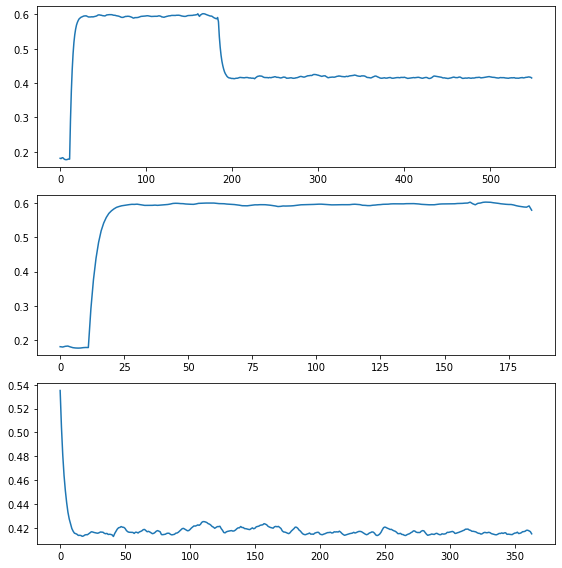

df_len_cnt: 182  H: 10  Total error: 10 Error check:  10537.556177048824 True
******CHANGE TIMES
ch_times :  [183] ch_num :  1 Resist :  0.5967784504777015
CHECK TIMES
[None, 183, None]
adf
183
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.409000       4.49      -20.0
1    2020-02-15 14:02     0.409000       4.48      -20.0
2     2020-02-16 2:01     0.410571       4.48      -20.0
3    2020-02-16 14:00     0.413041       4.48      -20.0
4     2020-02-17 2:00     0.413680       4.48      -20.0
..                ...          ...        ...        ...
178  2020-07-01 16:58     0.595924       4.47      -20.0
179   2020-07-02 4:58     0.596755       4.48      -20.0
180  2020-07-02 16:57     0.597091       4.47      -20.0
181   2020-07-03 4:57     0.597067       4.47      -20.0
182  2020-07-03 13:10     0.596778       4.47      -20.0

[183 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:17     0.5633

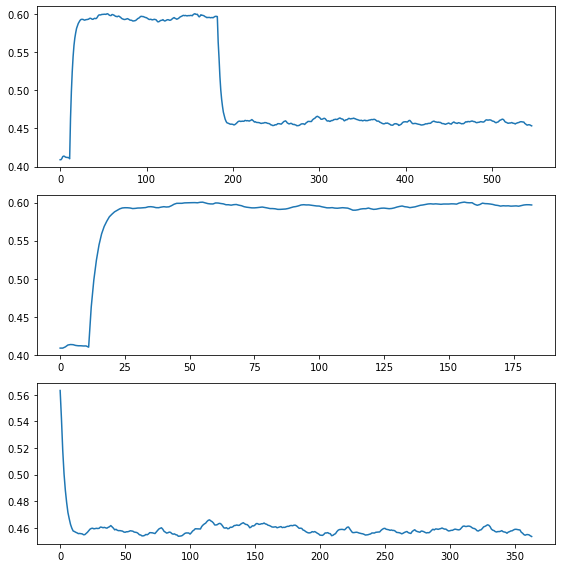

df_len_cnt: 182  H: 10  Total error: 10 Error check:  3121.1919772369097 True
******CHANGE TIMES
ch_times :  [183] ch_num :  1 Resist :  0.5949183346042106
CHECK TIMES
[None, 183, None]
adf
183
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.379000       4.45      -20.0
1    2020-02-15 14:02     0.379000       4.47      -20.0
2     2020-02-16 2:01     0.378476       4.47      -20.0
3    2020-02-16 14:00     0.378677       4.46      -20.0
4     2020-02-17 2:00     0.378783       4.47      -20.0
..                ...          ...        ...        ...
178  2020-07-01 16:58     0.599202       4.47      -20.0
179   2020-07-02 4:58     0.599147       4.47      -20.0
180  2020-07-02 16:57     0.598027       4.47      -20.0
181   2020-07-03 4:57     0.597479       4.46      -20.0
182  2020-07-03 13:10     0.594918       4.46      -20.0

[183 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:17     0.5568

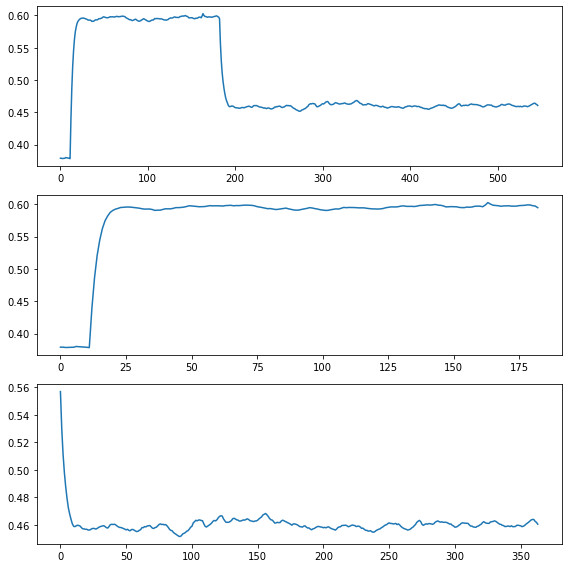

df_len_cnt: 182  H: 10  Total error: 10 Error check:  419.60060215255294 True
******CHANGE TIMES
ch_times :  [183] ch_num :  1 Resist :  0.5860275194447196
CHECK TIMES
[None, 183, None]
adf
183
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.394000       4.48      -20.0
1    2020-02-15 14:02     0.393000       4.47      -20.0
2     2020-02-16 2:01     0.393524       4.47      -20.0
3    2020-02-16 14:00     0.393707       4.47      -20.0
4     2020-02-17 2:00     0.392498       4.47      -20.0
..                ...          ...        ...        ...
178   2020-07-02 4:58     0.603825       4.47      -20.0
179  2020-07-02 16:57     0.603062       4.47      -20.0
180   2020-07-03 4:57     0.603856       4.47      -20.0
181  2020-07-03 13:10     0.607137       4.47      -20.0
182  2020-07-03 13:17     0.586028       4.47      -20.0

[183 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:25     0.5498

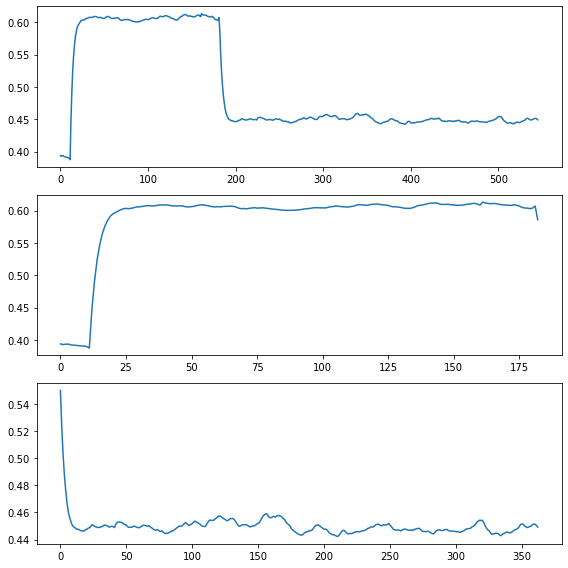

df_len_cnt: 181  H: 10  Total error: 10 Error check:  4756.677398076631 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.6067553613741966
df_len_cnt: 182  H: 10  Total error: 20 Error check:  101.80850277303435 True
******CHANGE TIMES
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.320000       4.47      -20.0
1    2020-02-15 14:02     0.322000       4.48      -20.0
2     2020-02-16 2:01     0.323047       4.48      -20.0
3    2020-02-16 14:00     0.322645       4.48      -20.0
4     2020-02-17 2:00     0.321782       4.48      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.606919       4.48      -20.0
178   2020-07-02 4:58     0.606400       4.48      -20.0
179  2020-07-02 16:57     0.605211       4.48      -20.0
180   2020-07-03 4:57     0.604074       4.48      -20.0
181  2020-07-03 13:10     0.606755       4.48      -20.0

[182 rows x 4 columns]
ad

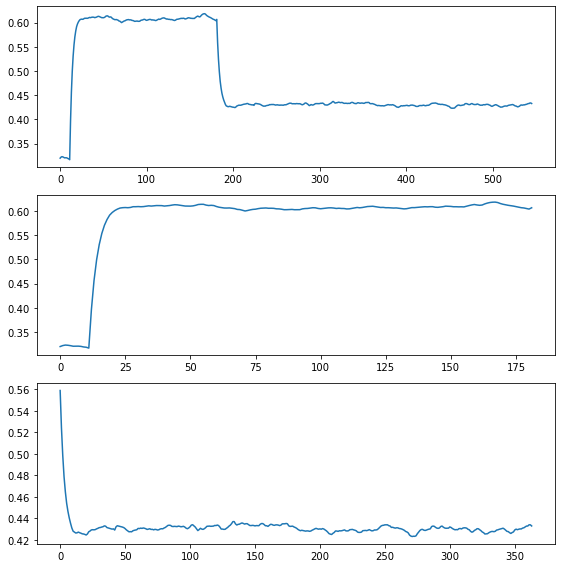

df_len_cnt: 182  H: 10  Total error: 10 Error check:  837.9404158647844 True
******CHANGE TIMES
ch_times :  [183] ch_num :  1 Resist :  0.5977019077690103
df_len_cnt: 183  H: 10  Total error: 20 Error check:  72.73393778774168 True
******CHANGE TIMES
CHECK TIMES
[None, 183, None]
adf
183
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.343000       4.47      -20.0
1    2020-02-15 14:02     0.341000       4.47      -20.0
2     2020-02-16 2:01     0.342048       4.47      -20.0
3    2020-02-16 14:00     0.341645       4.48      -20.0
4     2020-02-17 2:00     0.340456       4.46      -20.0
..                ...          ...        ...        ...
178   2020-07-02 4:58     0.607702       4.46      -20.0
179  2020-07-02 16:57     0.606162       4.47      -20.0
180   2020-07-03 4:57     0.605308       4.47      -20.0
181  2020-07-03 13:10     0.606845       4.46      -20.0
182  2020-07-03 13:17     0.597702       4.47      -20.0

[183 rows x 4 columns]
adf

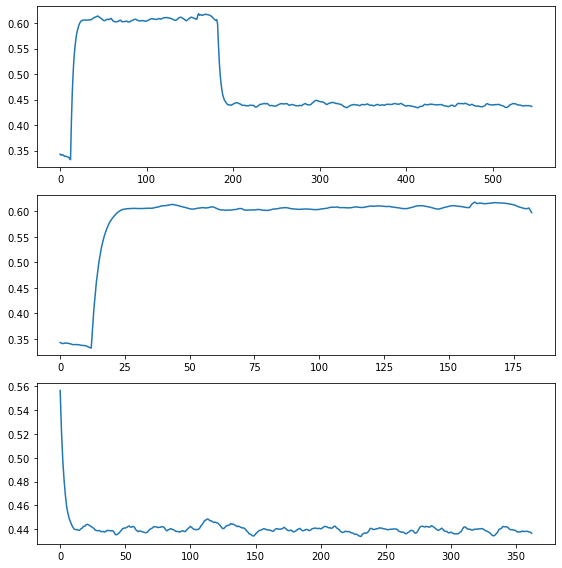

df_len_cnt: 181  H: 10  Total error: 9 Error check:  4910.278304073503 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.6347836823470686
df_len_cnt: 182  H: 10  Total error: 20 Error check:  351.4392804083813 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 11 Error check:  386.2873002739997 True
******CHANGE TIMES
df_len_cnt: 184  H: 10  Total error: 20 Error check:  32.09715602246091 True
******CHANGE TIMES
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.375000       4.46      -20.0
1    2020-02-15 14:02     0.375000       4.47      -20.0
2     2020-02-16 2:01     0.374476       4.47      -20.0
3    2020-02-16 14:00     0.374293       4.47      -20.0
4     2020-02-17 2:00     0.374198       4.47      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.632264       4.47      -20.0
178   2020-07-02 4:58     0.630572       4.47      -20.0
179  20

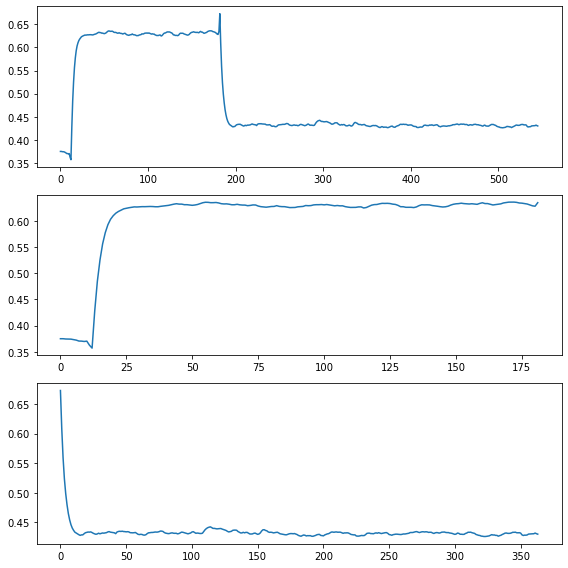

df_len_cnt: 181  H: 10  Total error: 9 Error check:  10731.740543464563 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.6210447360155017
df_len_cnt: 182  H: 10  Total error: 19 Error check:  390.07714754750174 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 11 Error check:  269.96822815649887 True
******CHANGE TIMES
df_len_cnt: 184  H: 10  Total error: 20 Error check:  32.17128875227813 True
******CHANGE TIMES
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.389000       4.46      -20.0
1    2020-02-15 14:02     0.386000       4.46      -20.0
2     2020-02-16 2:01     0.386000       4.47      -20.0
3    2020-02-16 14:00     0.386384       4.45      -20.0
4     2020-02-17 2:00     0.387238       4.45      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.620414       4.45      -20.0
178   2020-07-02 4:58     0.619491       4.45      -20.0
179 

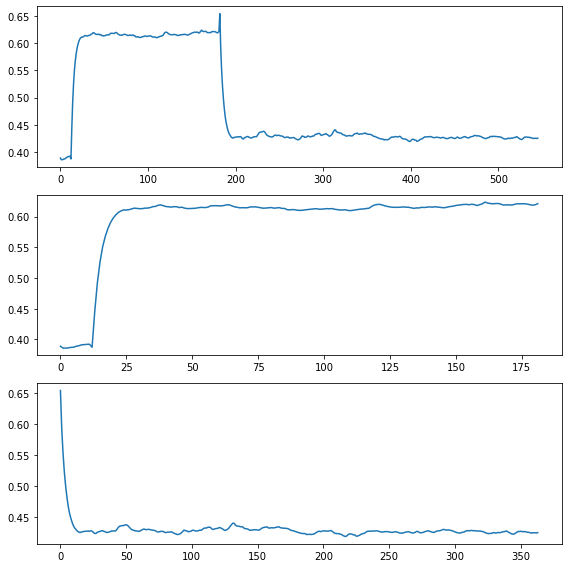

df_len_cnt: 181  H: 10  Total error: 10 Error check:  3061.17608961388 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.6078718490825148
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.375000       4.46      -20.0
1    2020-02-15 14:02     0.376000       4.48      -20.0
2     2020-02-16 2:01     0.377047       4.47      -20.0
3    2020-02-16 14:00     0.377029       4.47      -20.0
4     2020-02-17 2:00     0.377998       4.47      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.603870       4.47      -20.0
178   2020-07-02 4:58     0.605256       4.47      -20.0
179  2020-07-02 16:57     0.605457       4.48      -20.0
180   2020-07-03 4:57     0.605603       4.48      -20.0
181  2020-07-03 13:10     0.607872       4.48      -20.0

[182 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:17     0.497142

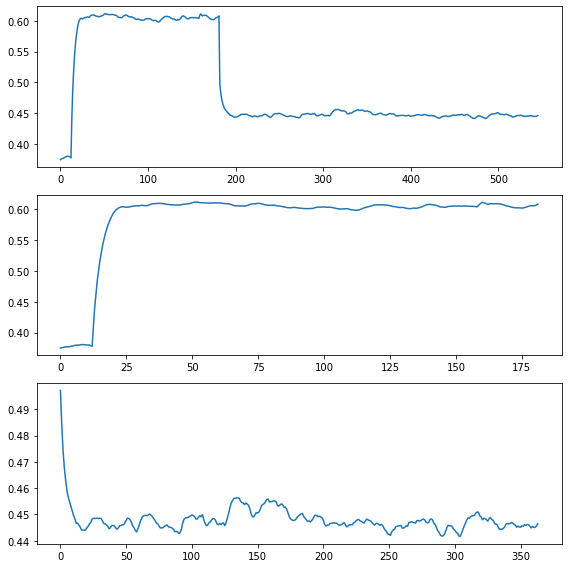

df_len_cnt: 181  H: 10  Total error: 10 Error check:  3383.10911344782 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.5922753322663306
df_len_cnt: 182  H: 10  Total error: 20 Error check:  57.32985802780879 True
******CHANGE TIMES
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.334000       4.46      -20.0
1    2020-02-15 14:02     0.335000       4.47      -20.0
2     2020-02-16 2:01     0.334476       4.46      -20.0
3    2020-02-16 14:00     0.333525       4.46      -20.0
4     2020-02-17 2:00     0.332701       4.46      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.594029       4.46      -20.0
178   2020-07-02 4:58     0.594291       4.46      -20.0
179  2020-07-02 16:57     0.593942       4.45      -20.0
180   2020-07-03 4:57     0.594228       4.46      -20.0
181  2020-07-03 13:10     0.592275       4.46      -20.0

[182 rows x 4 columns]
adf


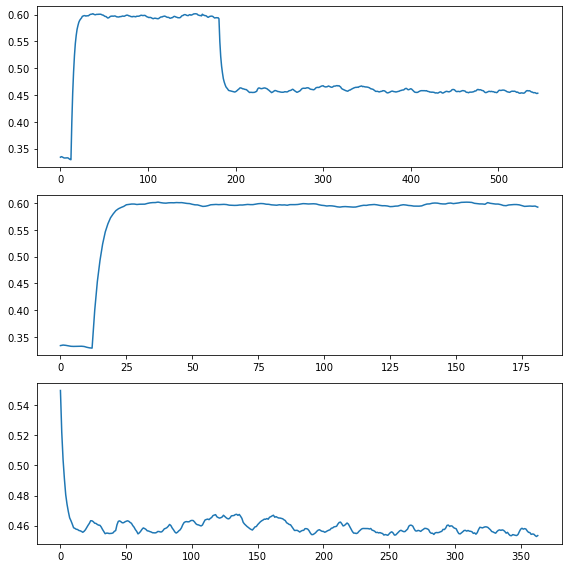

df_len_cnt: 181  H: 10  Total error: 10 Error check:  2701.729585125735 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.6003687144937188
df_len_cnt: 182  H: 10  Total error: 20 Error check:  33.08127964258391 True
******CHANGE TIMES
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.344000       4.46      -20.0
1    2020-02-15 14:02     0.342000       4.46      -20.0
2     2020-02-16 2:01     0.340953       4.48      -20.0
3    2020-02-16 14:00     0.341739       4.48      -20.0
4     2020-02-17 2:00     0.341498       4.47      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.603045       4.47      -20.0
178   2020-07-02 4:58     0.603033       4.47      -20.0
179  2020-07-02 16:57     0.602214       4.48      -20.0
180   2020-07-03 4:57     0.601616       4.48      -20.0
181  2020-07-03 13:10     0.600369       4.47      -20.0

[182 rows x 4 columns]
adf

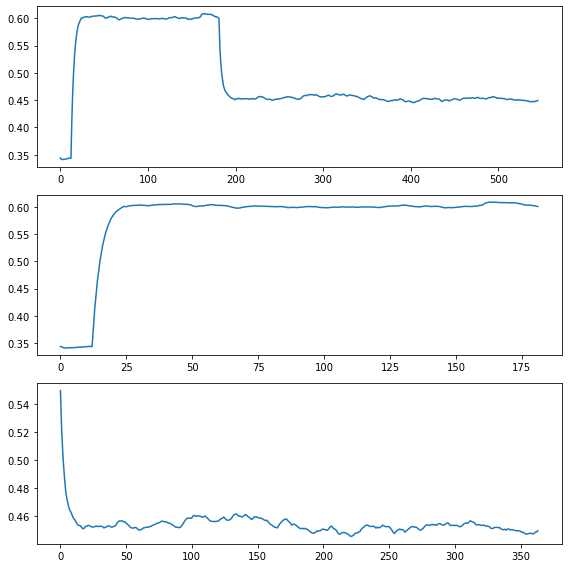

df_len_cnt: 181  H: 10  Total error: 9 Error check:  1266.921474553227 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.5978441411297948
df_len_cnt: 182  H: 10  Total error: 20 Error check:  223.61782677016126 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 11 Error check:  521.9671102217236 True
******CHANGE TIMES
df_len_cnt: 184  H: 10  Total error: 20 Error check:  45.19607793243734 True
******CHANGE TIMES
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.384000       4.46      -20.0
1    2020-02-15 14:02     0.385000       4.46      -20.0
2     2020-02-16 2:01     0.382905       4.45      -20.0
3    2020-02-16 14:00     0.383710       4.46      -20.0
4     2020-02-17 2:00     0.384457       4.46      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.603622       4.45      -20.0
178   2020-07-02 4:58     0.603454       4.47      -20.0
179  2

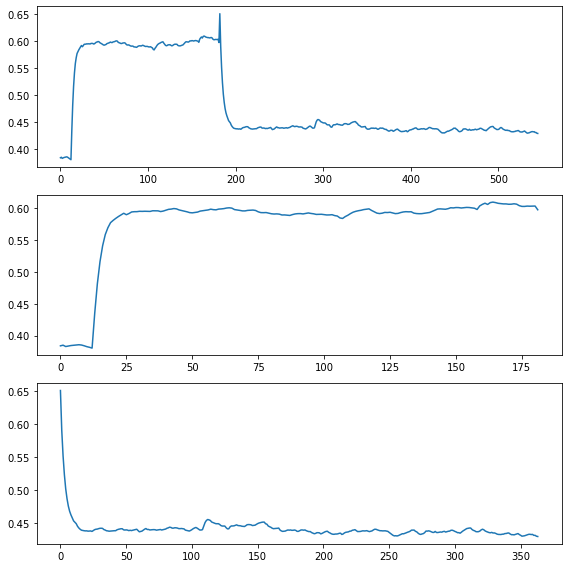

df_len_cnt: 181  H: 10  Total error: 10 Error check:  6308.564467560695 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.5967791923679473
df_len_cnt: 182  H: 10  Total error: 20 Error check:  146.24450761966435 True
******CHANGE TIMES
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.378000       4.47       16.8
1    2020-02-15 14:02     0.379000       4.46       17.0
2     2020-02-16 2:01     0.379000       4.47       16.7
3    2020-02-16 14:00     0.379000       4.46       17.4
4     2020-02-17 2:00     0.380305       4.47       17.5
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.598796       4.46       17.7
178   2020-07-02 4:58     0.600202       4.46       17.4
179  2020-07-02 16:57     0.600958       4.46       17.7
180   2020-07-03 4:57     0.601509       4.46       17.5
181  2020-07-03 13:10     0.596779       4.46       18.1

[182 rows x 4 columns]
ad

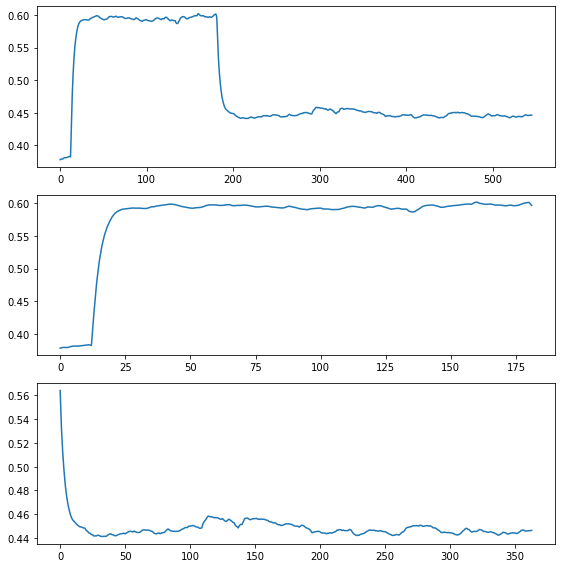

df_len_cnt: 181  H: 10  Total error: 10 Error check:  3794.6779731567162 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.5836772624071093
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.411000       4.47      -20.0
1    2020-02-15 14:02     0.412000       4.48      -20.0
2     2020-02-16 2:01     0.410952       4.47      -20.0
3    2020-02-16 14:00     0.410587       4.47      -20.0
4     2020-02-17 2:00     0.410721       4.47      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.587239       4.48      -20.0
178   2020-07-02 4:58     0.587715       4.47      -20.0
179  2020-07-02 16:57     0.586711       4.47      -20.0
180   2020-07-03 4:57     0.586519       4.47      -20.0
181  2020-07-03 13:10     0.583677       4.46      -20.0

[182 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:17     0.5351

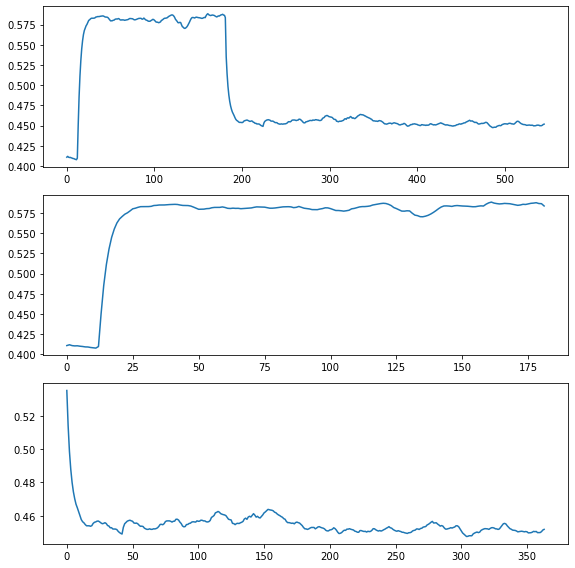

df_len_cnt: 181  H: 10  Total error: 10 Error check:  5024.495575807852 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.5914272844129714
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.339000       4.45      -20.0
1    2020-02-15 14:02     0.342999       4.47      -20.0
2     2020-02-16 2:01     0.341428       4.47      -20.0
3    2020-02-16 14:00     0.339343       4.47      -20.0
4     2020-02-17 2:00     0.337274       4.46      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.592398       4.46      -20.0
178   2020-07-02 4:58     0.592561       4.46      -20.0
179  2020-07-02 16:57     0.592679       4.46      -20.0
180   2020-07-03 4:57     0.591956       4.46      -20.0
181  2020-07-03 13:10     0.591427       4.47      -20.0

[182 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:17     0.54862

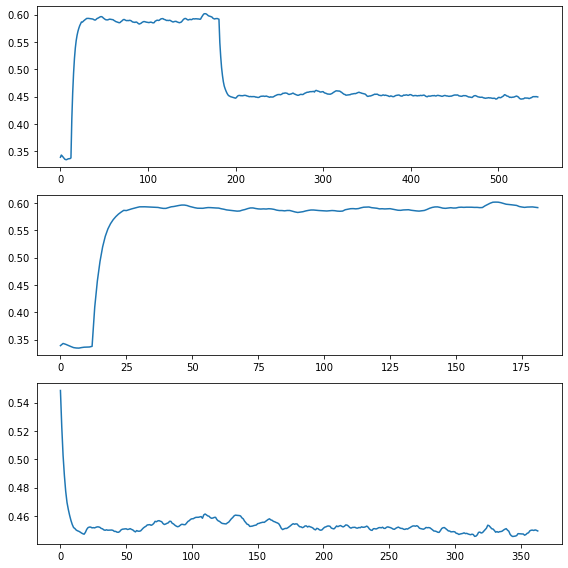

df_len_cnt: 181  H: 10  Total error: 10 Error check:  3776.7635515972806 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.5828832967736834
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.376000       4.45      -20.0
1    2020-02-15 14:02     0.377000       4.46      -20.0
2     2020-02-16 2:01     0.376476       4.45      -20.0
3    2020-02-16 14:00     0.375909       4.46      -20.0
4     2020-02-17 2:00     0.375939       4.46      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.585671       4.46      -20.0
178   2020-07-02 4:58     0.584409       4.46      -20.0
179  2020-07-02 16:57     0.584028       4.47      -20.0
180   2020-07-03 4:57     0.583210       4.46      -20.0
181  2020-07-03 13:10     0.582883       4.45      -20.0

[182 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:17     0.5507

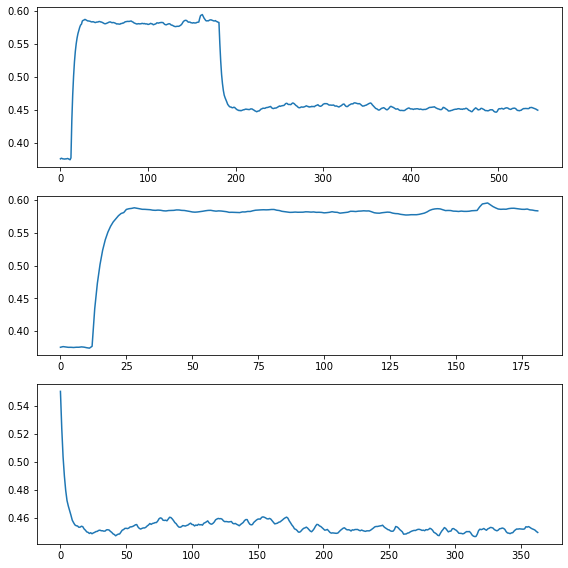

df_len_cnt: 181  H: 10  Total error: 10 Error check:  10740.370484686047 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.5813476045107
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.401000       4.47      -20.0
1    2020-02-15 14:02     0.401000       4.47      -20.0
2     2020-02-16 2:01     0.401524       4.47      -20.0
3    2020-02-16 14:00     0.402091       4.47      -20.0
4     2020-02-17 2:00     0.402714       4.48      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.581528       4.47      -20.0
178   2020-07-02 4:58     0.581926       4.47      -20.0
179  2020-07-02 16:57     0.583297       4.47      -20.0
180   2020-07-03 4:57     0.585918       4.48      -20.0
181  2020-07-03 13:10     0.581348       4.47      -20.0

[182 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:17     0.539920 

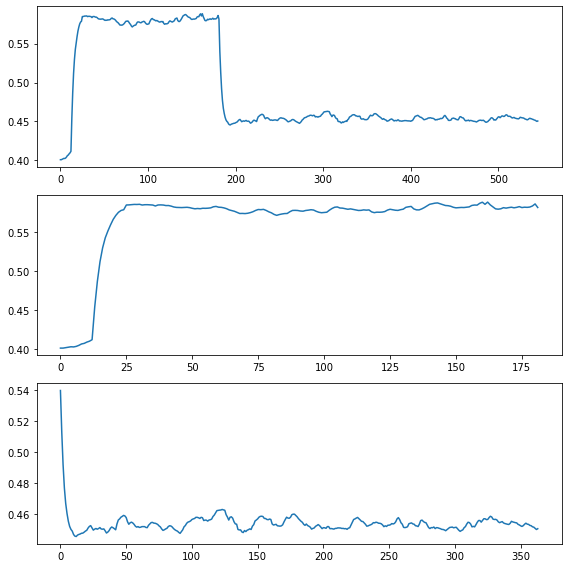

df_len_cnt: 182  H: 10  Total error: 10 Error check:  493.6231592552649 True
******CHANGE TIMES
ch_times :  [183] ch_num :  1 Resist :  0.5826986789283558
CHECK TIMES
[None, 183, None]
adf
183
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.420000       4.48      -20.0
1    2020-02-15 14:02     0.419000       4.48      -20.0
2     2020-02-16 2:01     0.419524       4.47      -20.0
3    2020-02-16 14:00     0.419707       4.48      -20.0
4     2020-02-17 2:00     0.420129       4.47      -20.0
..                ...          ...        ...        ...
178   2020-07-02 4:58     0.599646       4.47      -20.0
179  2020-07-02 16:57     0.599741       4.48      -20.0
180   2020-07-03 4:57     0.599541       4.47      -20.0
181  2020-07-03 13:10     0.594802       4.48      -20.0
182  2020-07-03 13:17     0.582699       4.48      -20.0

[183 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:25     0.55144

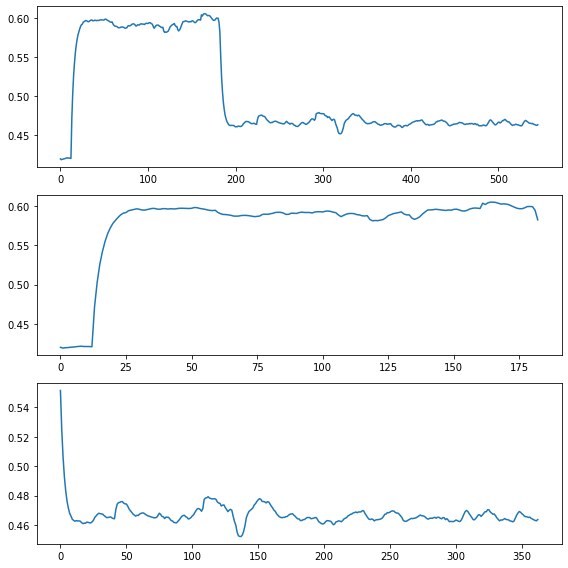

df_len_cnt: 181  H: 10  Total error: 8 Error check:  2413.3525274119074 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.6029013596444217
df_len_cnt: 182  H: 10  Total error: 20 Error check:  180.44284864181023 True
******CHANGE TIMES
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.390000       4.46      -20.0
1    2020-02-15 14:02     0.390000       4.46      -20.0
2     2020-02-16 2:01     0.392095       4.46      -20.0
3    2020-02-16 14:00     0.392827       4.46      -20.0
4     2020-02-17 2:00     0.393862       4.47      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.604533       4.47      -20.0
178   2020-07-02 4:58     0.603578       4.47      -20.0
179  2020-07-02 16:57     0.603692       4.46      -20.0
180   2020-07-03 4:57     0.603235       4.47      -20.0
181  2020-07-03 13:10     0.602901       4.46      -20.0

[182 rows x 4 columns]
ad

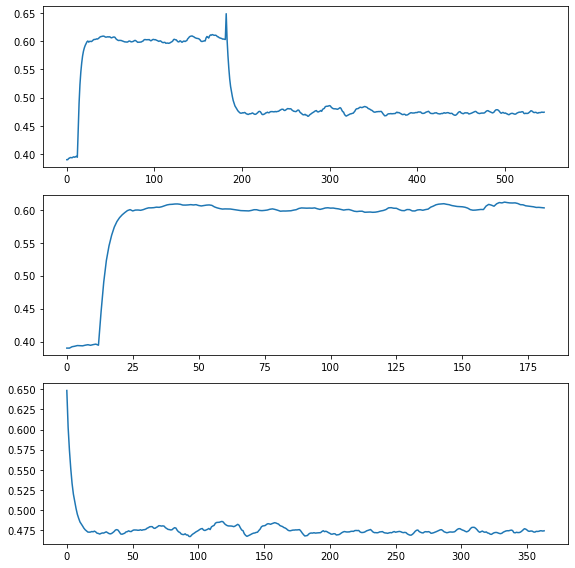

df_len_cnt: 181  H: 10  Total error: 10 Error check:  4307.34465857841 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.6023391483270099
df_len_cnt: 182  H: 10  Total error: 20 Error check:  106.34780830435659 True
******CHANGE TIMES
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.337000       4.49      -20.0
1    2020-02-15 14:02     0.338000       4.48      -20.0
2     2020-02-16 2:01     0.339571       4.49      -20.0
3    2020-02-16 14:00     0.339352       4.48      -20.0
4     2020-02-17 2:00     0.339237       4.49      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.604828       4.48      -20.0
178   2020-07-02 4:58     0.605145       4.49      -20.0
179  2020-07-02 16:57     0.604295       4.48      -20.0
180   2020-07-03 4:57     0.603945       4.49      -20.0
181  2020-07-03 13:10     0.602339       4.48      -20.0

[182 rows x 4 columns]
adf

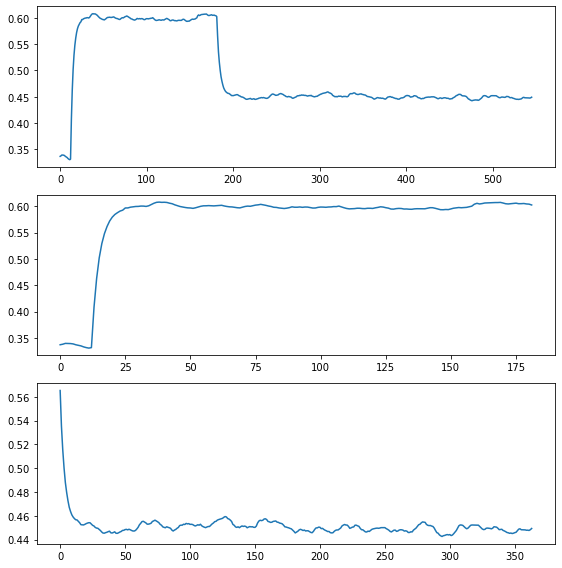

df_len_cnt: 181  H: 10  Total error: 10 Error check:  11541.760503462932 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.5970362262683866
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.337000       4.47      -20.0
1    2020-02-15 14:02     0.337000       4.46      -20.0
2     2020-02-16 2:01     0.337000       4.46      -20.0
3    2020-02-16 14:00     0.335848       4.45      -20.0
4     2020-02-17 2:00     0.335897       4.46      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.595964       4.45      -20.0
178   2020-07-02 4:58     0.595703       4.46      -20.0
179  2020-07-02 16:57     0.596054       4.45      -20.0
180   2020-07-03 4:57     0.596309       4.46      -20.0
181  2020-07-03 13:10     0.597036       4.46      -20.0

[182 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:17     0.5502

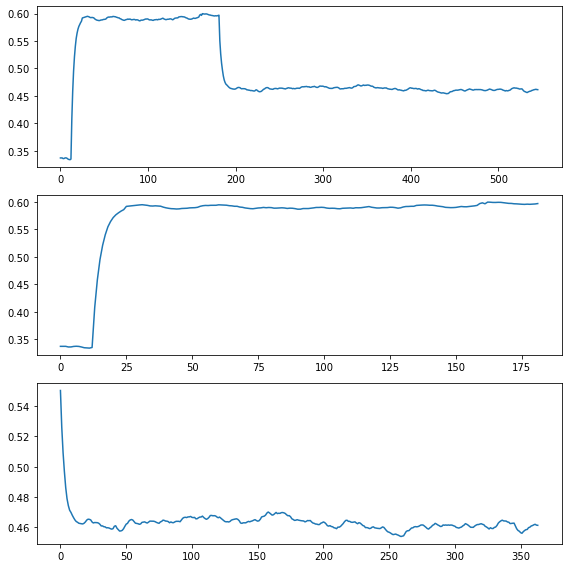

df_len_cnt: 181  H: 10  Total error: 10 Error check:  6541.049022502632 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.6021052091506067
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.357000       4.47      -20.0
1    2020-02-15 14:02     0.359000       4.46      -20.0
2     2020-02-16 2:01     0.356905       4.47      -20.0
3    2020-02-16 14:00     0.356941       4.48      -20.0
4     2020-02-17 2:00     0.356634       4.47      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.605917       4.47      -20.0
178   2020-07-02 4:58     0.604588       4.47      -20.0
179  2020-07-02 16:57     0.603349       4.47      -20.0
180   2020-07-03 4:57     0.603255       4.47      -20.0
181  2020-07-03 13:10     0.602105       4.47      -20.0

[182 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:17     0.47726

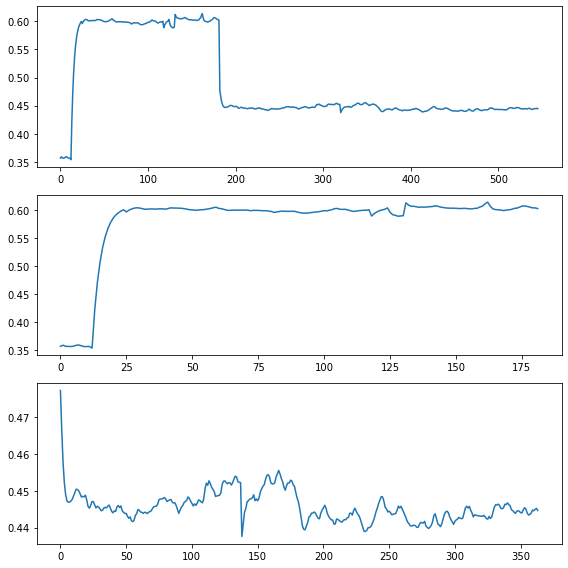

df_len_cnt: 181  H: 10  Total error: 9 Error check:  7069.249775722114 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.6115299903701059
df_len_cnt: 182  H: 10  Total error: 20 Error check:  72.4201964703919 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 20 Error check:  206.20094237106588 True
******CHANGE TIMES
df_len_cnt: 184  H: 10  Total error: 12 Error check:  308.48773598450776 True
******CHANGE TIMES
df_len_cnt: 185  H: 10  Total error: 20 Error check:  16.49788772303386 False
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.408000       4.46      -20.0
1    2020-02-15 14:02     0.409000       4.47      -20.0
2     2020-02-16 2:01     0.410047       4.47      -20.0
3    2020-02-16 14:00     0.410413       4.46      -20.0
4     2020-02-17 2:00     0.409626       4.46      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.612005       4

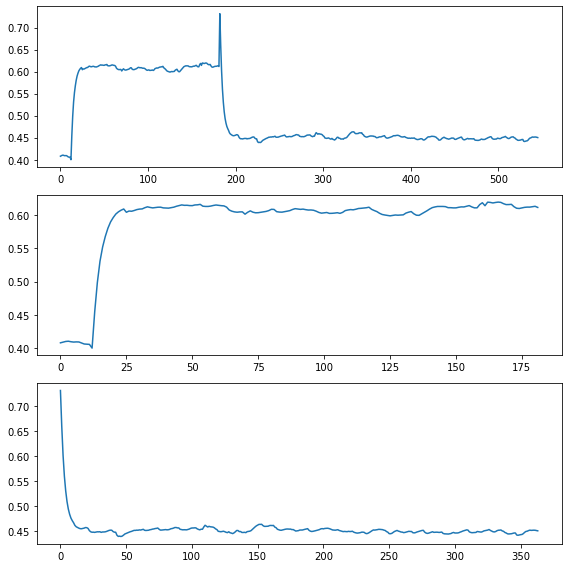

df_len_cnt: 181  H: 10  Total error: 8 Error check:  3542.0856567099017 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.5933496954981226
df_len_cnt: 182  H: 10  Total error: 20 Error check:  37.966123715058956 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 20 Error check:  101.88600330361403 True
******CHANGE TIMES
df_len_cnt: 184  H: 10  Total error: 12 Error check:  224.74277641808777 True
******CHANGE TIMES
df_len_cnt: 185  H: 10  Total error: 13 Error check:  69.83417787989832 True
******CHANGE TIMES
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.418000       4.48      -20.0
1    2020-02-15 14:02     0.420000       4.48      -20.0
2     2020-02-16 2:01     0.420524       4.49      -20.0
3    2020-02-16 14:00     0.421091       4.48      -20.0
4     2020-02-17 2:00     0.421714       4.47      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58

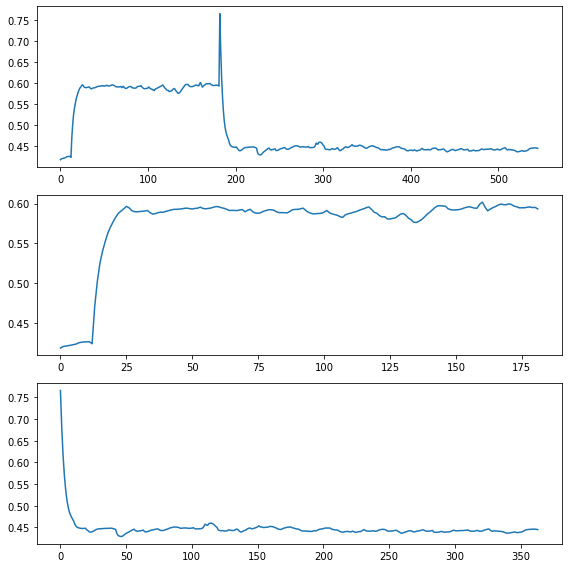

df_len_cnt: 180  H: 10  Total error: 10 Error check:  2868.0417956074252 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.5963819205880101
df_len_cnt: 181  H: 10  Total error: 20 Error check:  148.8135222723548 True
******CHANGE TIMES
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.349000       4.48       17.1
1    2020-02-15 14:02     0.347000       4.48       17.4
2     2020-02-16 2:01     0.347524       4.50       17.1
3    2020-02-16 14:00     0.348859       4.48       17.8
4     2020-02-17 2:00     0.351515       4.50       17.8
..                ...          ...        ...        ...
176  2020-07-01 16:58     0.594021       4.47       18.0
177   2020-07-02 4:58     0.594015       4.46       17.8
178  2020-07-02 16:57     0.594551       4.48       18.1
179   2020-07-03 4:57     0.594673       4.48       18.0
180  2020-07-03 13:10     0.596382       4.46       18.6

[181 rows x 4 columns]
ad

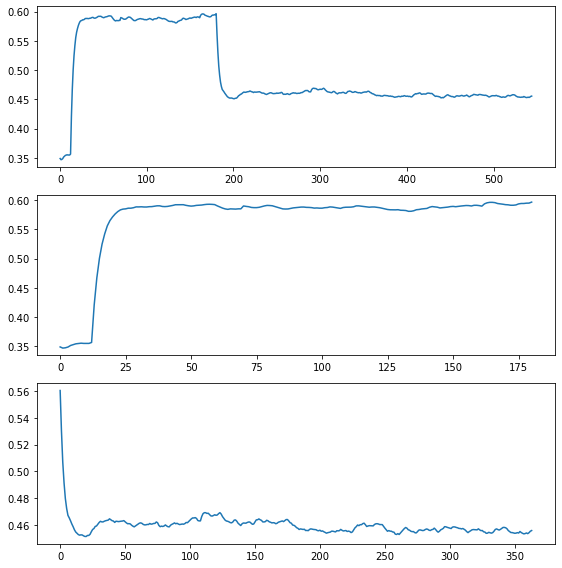

df_len_cnt: 180  H: 10  Total error: 10 Error check:  2934.006956488033 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.6135509597321079
df_len_cnt: 181  H: 10  Total error: 20 Error check:  73.52741751717893 True
******CHANGE TIMES
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.376000       4.47      -20.0
1    2020-02-15 14:02     0.374000       4.48      -20.0
2     2020-02-16 2:01     0.373476       4.46      -20.0
3    2020-02-16 14:00     0.373293       4.47      -20.0
4     2020-02-17 2:00     0.373198       4.47      -20.0
..                ...          ...        ...        ...
176  2020-07-01 16:58     0.613921       4.47      -20.0
177   2020-07-02 4:58     0.614753       4.47      -20.0
178  2020-07-02 16:57     0.615090       4.47      -20.0
179   2020-07-03 4:57     0.615606       4.46      -20.0
180  2020-07-03 13:10     0.613551       4.47      -20.0

[181 rows x 4 columns]
adf

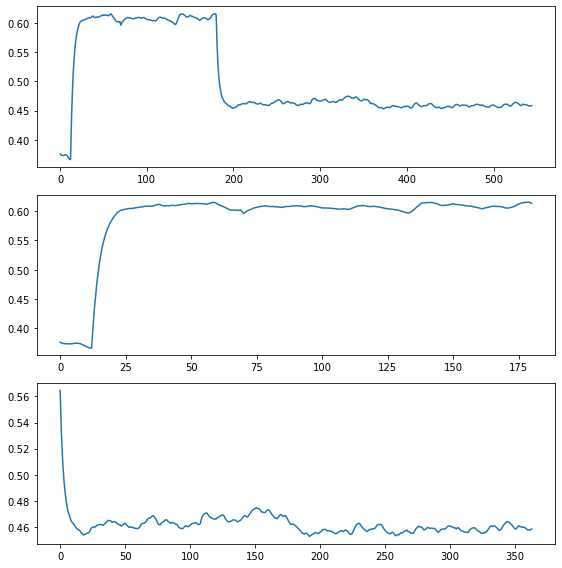

df_len_cnt: 180  H: 10  Total error: 9 Error check:  3405.6169360650565 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.5934224919771558
df_len_cnt: 181  H: 10  Total error: 20 Error check:  53.33118033993255 True
******CHANGE TIMES
df_len_cnt: 182  H: 10  Total error: 20 Error check:  156.88318422266389 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 12 Error check:  358.9845591743735 True
******CHANGE TIMES
df_len_cnt: 184  H: 10  Total error: 20 Error check:  11.719579133992632 False
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.405000       4.47      -20.0
1    2020-02-15 14:02     0.406000       4.47      -20.0
2     2020-02-16 2:01     0.408619       4.47      -20.0
3    2020-02-16 14:00     0.410302       4.47      -20.0
4     2020-02-17 2:00     0.409551       4.47      -20.0
..                ...          ...        ...        ...
176  2020-07-01 16:58     0.593058      

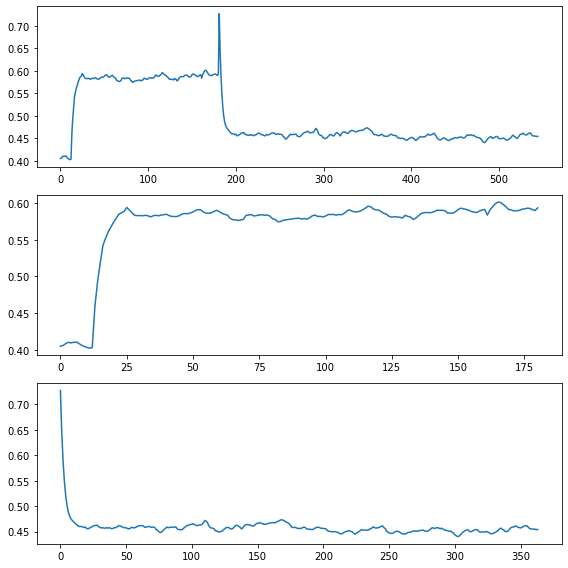

df_len_cnt: 180  H: 10  Total error: 9 Error check:  2293.6016136991493 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.6127175053529191
df_len_cnt: 181  H: 10  Total error: 20 Error check:  221.7161260274838 True
******CHANGE TIMES
df_len_cnt: 182  H: 10  Total error: 11 Error check:  594.6431357362889 True
******CHANGE TIMES
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.384000       4.49      -20.0
1    2020-02-15 14:02     0.385000       4.50      -20.0
2     2020-02-16 2:01     0.386571       4.49      -20.0
3    2020-02-16 14:00     0.388273       4.49      -20.0
4     2020-02-17 2:00     0.388184       4.50      -20.0
..                ...          ...        ...        ...
176  2020-07-01 16:58     0.611332       4.49      -20.0
177   2020-07-02 4:58     0.612593       4.51      -20.0
178  2020-07-02 16:57     0.612703       4.50      -20.0
179   2020-07-03 4:57     0.612243       4.50

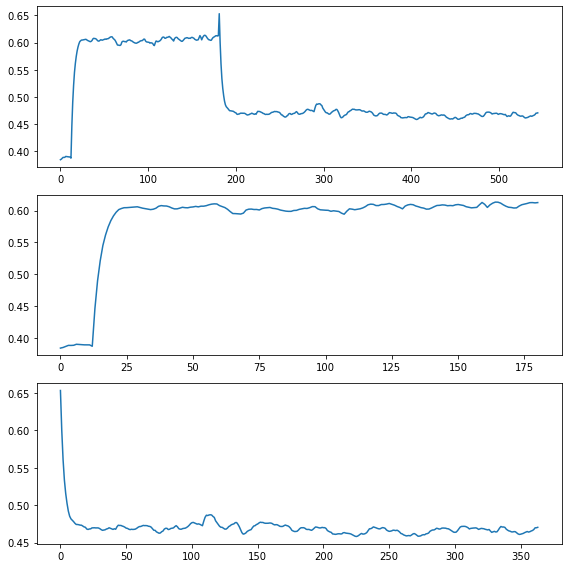

df_len_cnt: 180  H: 10  Total error: 9 Error check:  1460.159992006549 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.6228638080354728
df_len_cnt: 181  H: 10  Total error: 20 Error check:  66.07020695241842 True
******CHANGE TIMES
df_len_cnt: 182  H: 10  Total error: 20 Error check:  212.3609431186737 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 12 Error check:  253.7343794782475 True
******CHANGE TIMES
df_len_cnt: 184  H: 10  Total error: 20 Error check:  10.36821089919634 False
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.364000       4.48      -20.0
1    2020-02-15 14:02     0.365000       4.49      -20.0
2     2020-02-16 2:01     0.367095       4.48      -20.0
3    2020-02-16 14:00     0.369363       4.48      -20.0
4     2020-02-17 2:00     0.370224       4.48      -20.0
..                ...          ...        ...        ...
176  2020-07-01 16:58     0.619475       4.

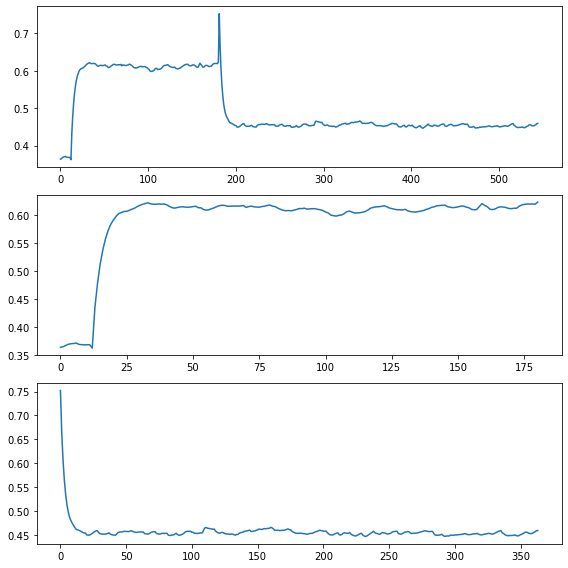

df_len_cnt: 181  H: 10  Total error: 10 Error check:  3856.9065713836862 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.6026976077554792
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.314000       4.48      -20.0
1    2020-02-15 14:02     0.316000       4.49      -20.0
2     2020-02-16 2:01     0.315476       4.49      -20.0
3    2020-02-16 14:00     0.316061       4.48      -20.0
4     2020-02-17 2:00     0.314737       4.48      -20.0
..                ...          ...        ...        ...
177   2020-07-02 4:58     0.603913       4.48      -20.0
178  2020-07-02 16:57     0.600965       4.48      -20.0
179   2020-07-03 4:57     0.600704       4.48      -20.0
180  2020-07-03 13:10     0.605917       4.47      -20.0
181  2020-07-03 13:17     0.602698       4.48      -20.0

[182 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:25     0.5557

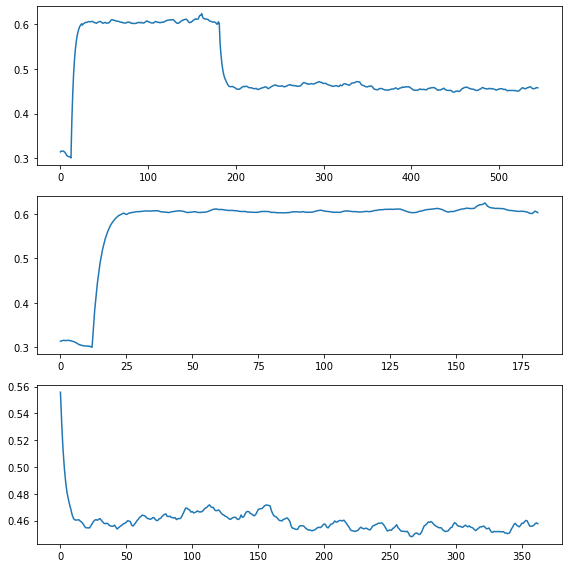

df_len_cnt: 181  H: 10  Total error: 10 Error check:  8506.282176089004 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.6042629588303572
df_len_cnt: 182  H: 10  Total error: 20 Error check:  72.0460962296077 True
******CHANGE TIMES
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.320000       4.49      -20.0
1    2020-02-15 14:02     0.325999       4.50      -20.0
2     2020-02-16 2:01     0.328618       4.50      -20.0
3    2020-02-16 14:00     0.330302       4.50      -20.0
4     2020-02-17 2:00     0.330203       4.49      -20.0
..                ...          ...        ...        ...
177   2020-07-02 4:58     0.604661       4.49      -20.0
178  2020-07-02 16:57     0.605022       4.50      -20.0
179   2020-07-03 4:57     0.606097       4.48      -20.0
180  2020-07-03 13:10     0.607692       4.49      -20.0
181  2020-07-03 13:17     0.604263       4.49      -20.0

[182 rows x 4 columns]
adf


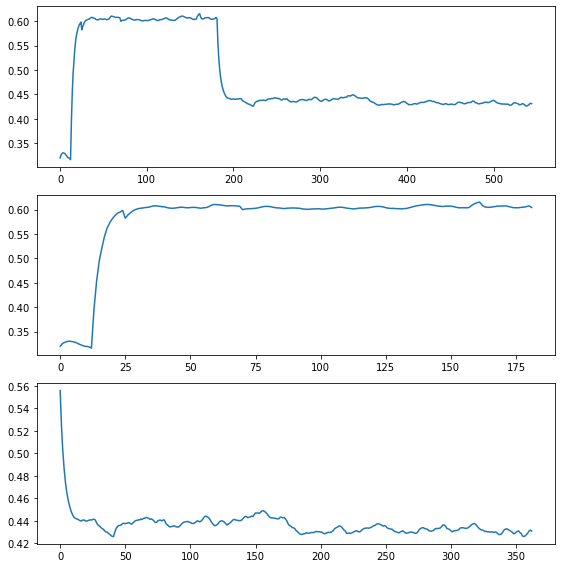

df_len_cnt: 180  H: 10  Total error: 9 Error check:  3525.191642528737 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.5850247798271698
df_len_cnt: 181  H: 10  Total error: 20 Error check:  36.58186894511778 True
******CHANGE TIMES
df_len_cnt: 182  H: 10  Total error: 20 Error check:  96.74551426756616 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 12 Error check:  215.84735416397893 True
******CHANGE TIMES
df_len_cnt: 184  H: 10  Total error: 19 Error check:  60.56292706231409 True
******CHANGE TIMES
df_len_cnt: 185  H: 10  Total error: 20 Error check:  26.387344052244593 True
******CHANGE TIMES
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.402000       4.48      -20.0
1    2020-02-15 14:02     0.408999       4.47      -20.0
2     2020-02-16 2:01     0.408999       4.47      -20.0
3    2020-02-16 14:00     0.409000       4.48      -20.0
4     2020-02-17 2:00     0.407695       

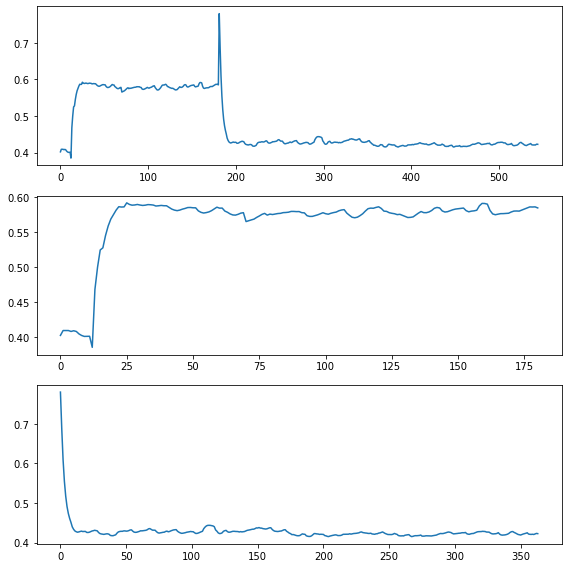

df_len_cnt: 180  H: 10  Total error: 8 Error check:  2438.588879669056 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.5311424501554421
df_len_cnt: 181  H: 10  Total error: 20 Error check:  44.613424649268104 True
******CHANGE TIMES
df_len_cnt: 182  H: 10  Total error: 20 Error check:  116.89665210300997 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 12 Error check:  295.19724147881925 True
******CHANGE TIMES
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.377000       4.48      -20.0
1    2020-02-15 14:02     0.380000       4.48      -20.0
2     2020-02-16 2:01     0.380524       4.48      -20.0
3    2020-02-16 14:00     0.380707       4.49      -20.0
4     2020-02-17 2:00     0.380150       4.49      -20.0
..                ...          ...        ...        ...
176  2020-07-01 16:58     0.530317       4.48      -20.0
177   2020-07-02 4:58     0.531042       4.49      -20.0
178 

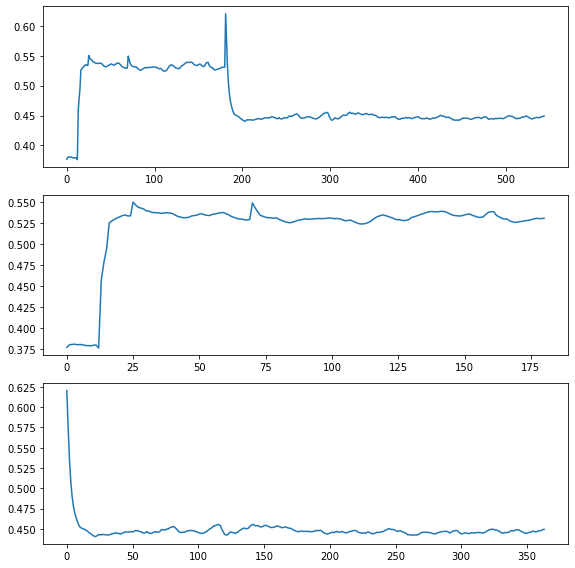

df_len_cnt: 180  H: 10  Total error: 9 Error check:  3096.9789633556557 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.6041454477445158
df_len_cnt: 181  H: 10  Total error: 20 Error check:  41.252947966004186 True
******CHANGE TIMES
df_len_cnt: 182  H: 10  Total error: 20 Error check:  107.33967048768898 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 12 Error check:  256.95051753774317 True
******CHANGE TIMES
df_len_cnt: 184  H: 10  Total error: 20 Error check:  38.189949664908184 True
******CHANGE TIMES
df_len_cnt: 185  H: 10  Total error: 20 Error check:  37.354968746006826 True
******CHANGE TIMES
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.375000       4.46      -20.0
1    2020-02-15 14:02     0.378000       4.46      -20.0
2     2020-02-16 2:01     0.377476       4.46      -20.0
3    2020-02-16 14:00     0.352323       4.46      -20.0
4     2020-02-17 2:00     0.362004   

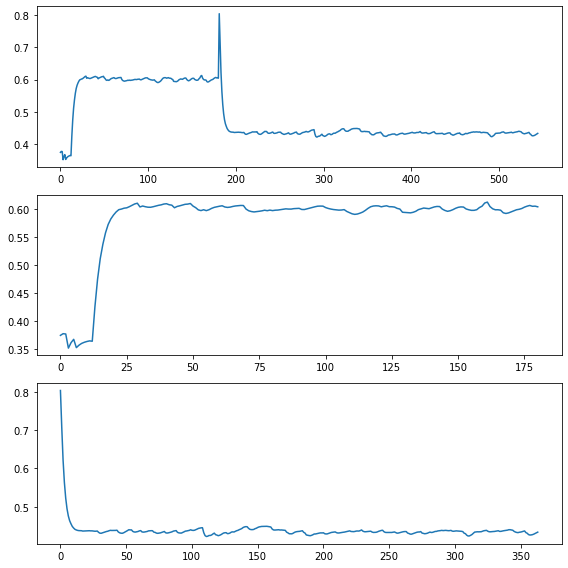

df_len_cnt: 180  H: 10  Total error: 10 Error check:  2934.300784409125 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.587729332513547
df_len_cnt: 181  H: 10  Total error: 20 Error check:  171.3518768319234 True
******CHANGE TIMES
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.316000       4.46      -20.0
1    2020-02-15 14:02     0.313000       4.46      -20.0
2     2020-02-16 2:01     0.312476       4.46      -20.0
3    2020-02-16 14:00     0.336111       4.47      -20.0
4     2020-02-17 2:00     0.328245       4.46      -20.0
..                ...          ...        ...        ...
176  2020-07-01 16:58     0.589025       4.47      -20.0
177   2020-07-02 4:58     0.589018       4.47      -20.0
178  2020-07-02 16:57     0.589013       4.47      -20.0
179   2020-07-03 4:57     0.588740       4.46      -20.0
180  2020-07-03 13:10     0.587729       4.46      -20.0

[181 rows x 4 columns]
adf


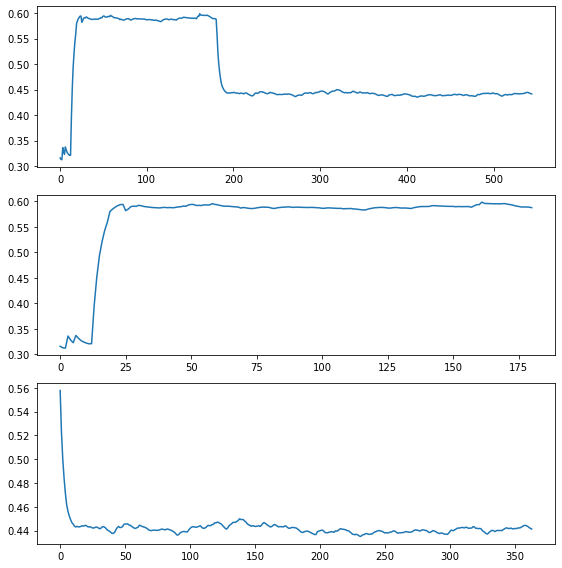

df_len_cnt: 181  H: 10  Total error: 10 Error check:  1177.86661826975 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.6031722618823384
df_len_cnt: 182  H: 10  Total error: 20 Error check:  149.84749567215596 True
******CHANGE TIMES
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.368000       4.47      -20.0
1    2020-02-15 14:02     0.413992       4.45       17.0
2     2020-02-16 2:01     0.390950       4.48      -20.0
3    2020-02-16 14:00     0.397116       4.46       17.4
4     2020-02-17 2:00     0.389249       4.48      -20.0
..                ...          ...        ...        ...
177   2020-07-02 4:58     0.593943       4.48      -20.0
178  2020-07-02 16:57     0.592608       4.48      -20.0
179   2020-07-03 4:57     0.592714       4.48      -20.0
180  2020-07-03 13:10     0.596573       4.48      -20.0
181  2020-07-03 13:17     0.603172       4.47      -20.0

[182 rows x 4 columns]
adf

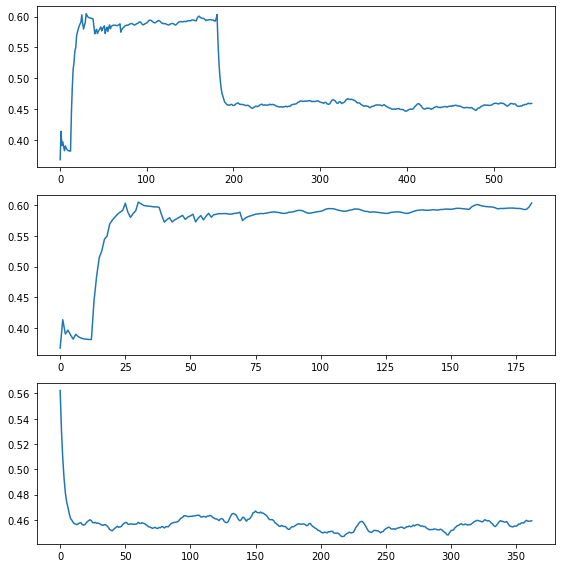

df_len_cnt: 180  H: 10  Total error: 8 Error check:  1954.6340398921686 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.5620983560425281
df_len_cnt: 181  H: 10  Total error: 20 Error check:  9.995184580402725 False
df_len_cnt: 182  H: 10  Total error: 20 Error check:  37.17315089641996 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 20 Error check:  64.54374859403292 True
******CHANGE TIMES
df_len_cnt: 184  H: 10  Total error: 13 Error check:  71.42998404582188 True
******CHANGE TIMES
df_len_cnt: 185  H: 10  Total error: 14 Error check:  10.386572167769376 False
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.417000       4.45       16.7
1    2020-02-15 14:02     0.384005       4.47      -20.0
2     2020-02-16 2:01     0.398144       4.45       16.7
3    2020-02-16 14:00     0.391943       4.50      -20.0
4     2020-02-17 2:00     0.388699       4.48      -20.0
..                ..

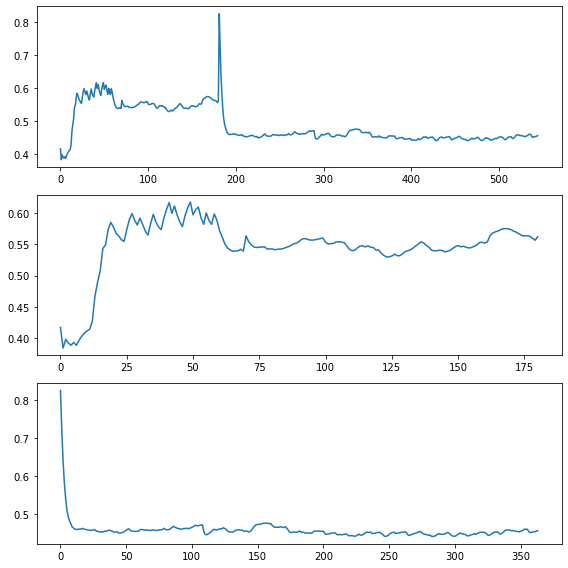

df_len_cnt: 180  H: 10  Total error: 9 Error check:  1879.3369361714117 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.6359866449459111
df_len_cnt: 181  H: 10  Total error: 20 Error check:  31.79344156270687 True
******CHANGE TIMES
df_len_cnt: 182  H: 10  Total error: 20 Error check:  85.86404714785661 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 19 Error check:  173.34395398642013 True
******CHANGE TIMES
df_len_cnt: 184  H: 10  Total error: 13 Error check:  106.7877160761504 True
******CHANGE TIMES
df_len_cnt: 185  H: 10  Total error: 20 Error check:  13.54964455860584 False
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.383000       4.46      -20.0
1    2020-02-15 14:02     0.385000       4.51      -20.0
2     2020-02-16 2:01     0.382905       4.47      -20.0
3    2020-02-16 14:00     0.363350       4.48      -20.0
4     2020-02-17 2:00     0.370086       4.52      -20.0
..

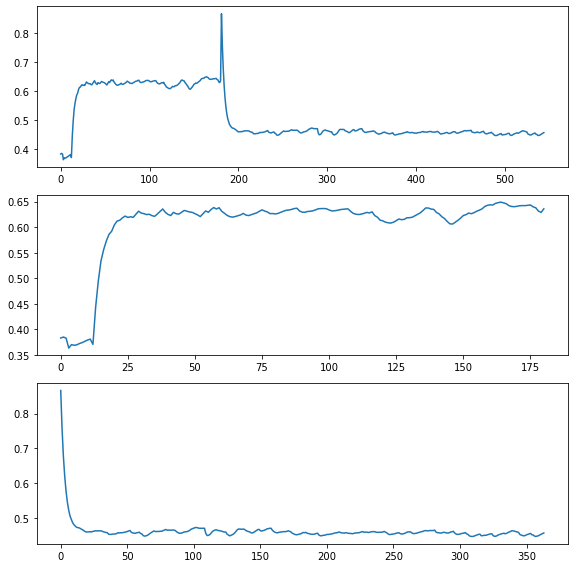

df_len_cnt: 180  H: 10  Total error: 10 Error check:  5126.795119815911 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.6249687457100143
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.385000       4.50      -20.0
1    2020-02-15 14:02     0.328009       4.50      -20.0
2     2020-02-16 2:01     0.329052       4.49      -20.0
3    2020-02-16 14:00     0.330569       4.50      -20.0
4     2020-02-17 2:00     0.331688       4.48      -20.0
..                ...          ...        ...        ...
176  2020-07-01 16:58     0.627926       4.50      -20.0
177   2020-07-02 4:58     0.627135       4.49      -20.0
178  2020-07-02 16:57     0.624667       4.48      -20.0
179   2020-07-03 4:57     0.624217       4.49      -20.0
180  2020-07-03 13:10     0.624969       4.50      -20.0

[181 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:17     0.53339

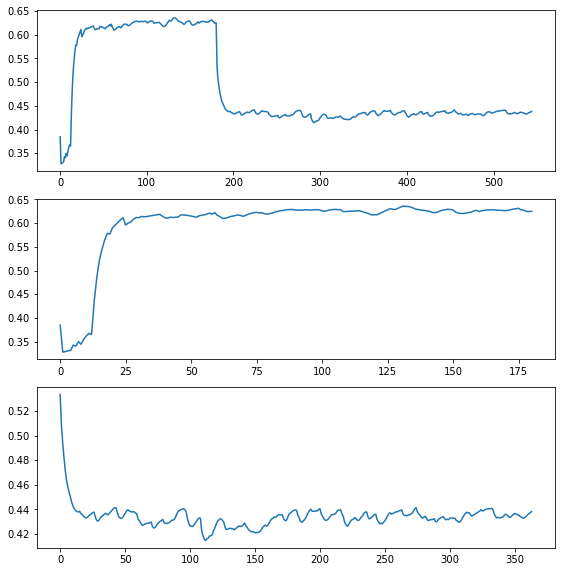

df_len_cnt: 180  H: 10  Total error: 10 Error check:  9725.756773289402 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.6155341185771677
df_len_cnt: 182  H: 10  Total error: 20 Error check:  23.540705050738588 True
******CHANGE TIMES
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.325000       4.49      -20.0
1    2020-02-15 14:02     0.334998       4.50      -20.0
2     2020-02-16 2:01     0.334999       4.50      -20.0
3    2020-02-16 14:00     0.351134       4.48      -20.0
4     2020-02-17 2:00     0.345218       4.50      -20.0
..                ...          ...        ...        ...
176  2020-07-01 16:58     0.614300       4.48      -20.0
177   2020-07-02 4:58     0.613948       4.49      -20.0
178  2020-07-02 16:57     0.613152       4.49      -20.0
179   2020-07-03 4:57     0.612030       4.49      -20.0
180  2020-07-03 13:10     0.615534       4.48      -20.0

[181 rows x 4 columns]
ad

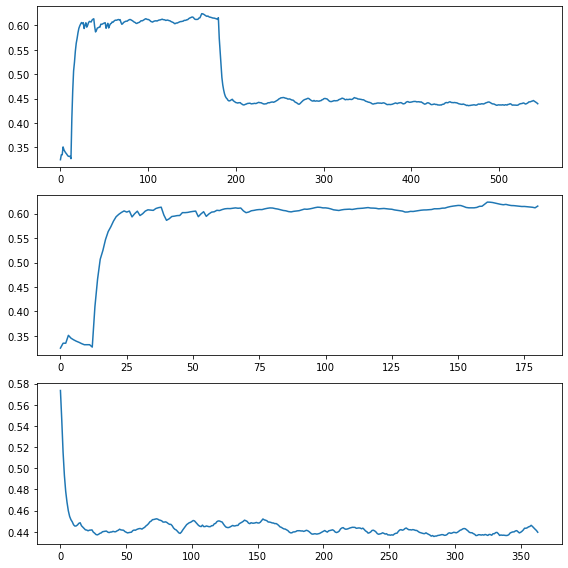

df_len_cnt: 180  H: 10  Total error: 10 Error check:  12051.112138488696 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.6049296063540848
df_len_cnt: 181  H: 10  Total error: 20 Error check:  41.0003103443206 True
******CHANGE TIMES
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.333000       4.49      -20.0
1    2020-02-15 14:02     0.372993       4.49      -20.0
2     2020-02-16 2:01     0.374044       4.49      -20.0
3    2020-02-16 14:00     0.369802       4.50      -20.0
4     2020-02-17 2:00     0.370845       4.49      -20.0
..                ...          ...        ...        ...
176  2020-07-01 16:58     0.606829       4.50      -20.0
177   2020-07-02 4:58     0.606335       4.50      -20.0
178  2020-07-02 16:57     0.605704       4.50      -20.0
179   2020-07-03 4:57     0.604163       4.50      -20.0
180  2020-07-03 13:10     0.604930       4.50      -20.0

[181 rows x 4 columns]
adf

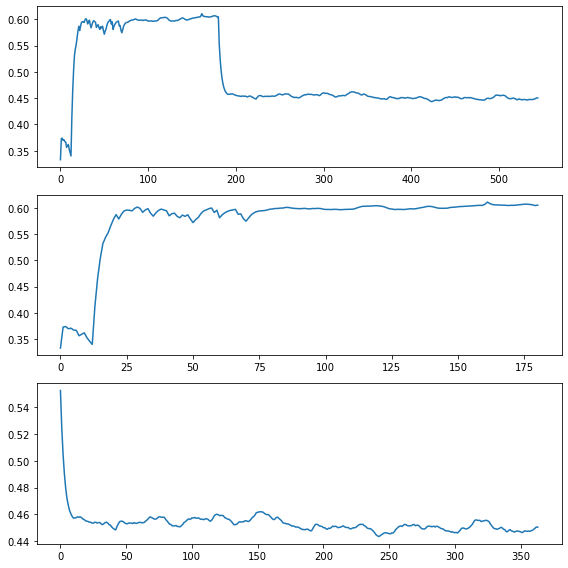

df_len_cnt: 180  H: 10  Total error: 8 Error check:  2907.4563905761966 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.5705357854009979
df_len_cnt: 181  H: 10  Total error: 20 Error check:  13.143441698694284 False
df_len_cnt: 182  H: 10  Total error: 20 Error check:  44.76821637519478 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 20 Error check:  81.6222558267793 True
******CHANGE TIMES
df_len_cnt: 184  H: 10  Total error: 13 Error check:  104.17579231938703 True
******CHANGE TIMES
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.364000       4.49      -20.0
1    2020-02-15 14:02     0.364000       4.49      -20.0
2     2020-02-16 2:01     0.365048       4.49      -20.0
3    2020-02-16 14:00     0.379243       4.47      -20.0
4     2020-02-17 2:00     0.374270       4.49      -20.0
..                ...          ...        ...        ...
176  2020-07-01 16:58     0.569971       

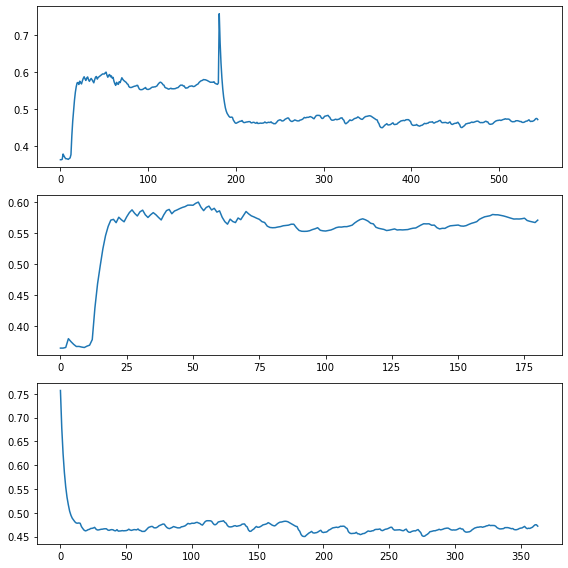

df_len_cnt: 179  H: 10  Total error: 10 Error check:  4576.152411049152 True
******CHANGE TIMES
ch_times :  [180] ch_num :  1 Resist :  0.599002905016707
CHECK TIMES
[None, 180, None]
adf
180
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.362000       4.49      -20.0
1    2020-02-15 14:02     0.401993       4.48      -20.0
2     2020-02-16 2:01     0.402521       4.48      -20.0
3    2020-02-16 14:00     0.364290       4.47      -20.0
4     2020-02-17 2:00     0.376918       4.48      -20.0
..                ...          ...        ...        ...
175  2020-07-01 16:58     0.599411       4.49      -20.0
176   2020-07-02 4:58     0.598490       4.48      -20.0
177  2020-07-02 16:57     0.598087       4.48      -20.0
178   2020-07-03 4:57     0.597523       4.49      -20.0
179  2020-07-03 13:10     0.599003       4.49      -20.0

[180 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:25     0.562261

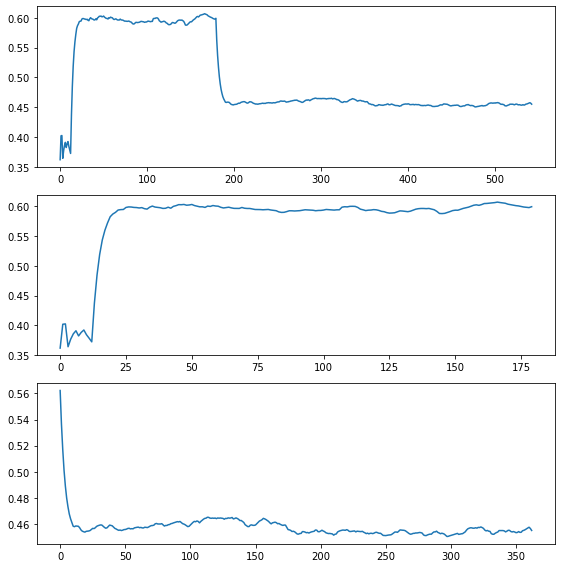

df_len_cnt: 179  H: 10  Total error: 10 Error check:  7029.763489593413 True
******CHANGE TIMES
ch_times :  [180] ch_num :  1 Resist :  0.6026053422385051
df_len_cnt: 180  H: 10  Total error: 20 Error check:  107.91603949414328 True
******CHANGE TIMES
CHECK TIMES
[None, 180, None]
adf
180
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.398000       4.47      -20.0
1    2020-02-15 14:02     0.307015       4.47      -20.0
2     2020-02-16 2:01     0.307007       4.47      -20.0
3    2020-02-16 14:00     0.323523       4.48      -20.0
4     2020-02-17 2:00     0.316176       4.47      -20.0
..                ...          ...        ...        ...
175  2020-07-01 16:58     0.603439       4.47      -20.0
176   2020-07-02 4:58     0.603050       4.47      -20.0
177  2020-07-02 16:57     0.602766       4.48      -20.0
178   2020-07-03 4:57     0.602829       4.48      -20.0
179  2020-07-03 13:10     0.602605       4.48      -20.0

[180 rows x 4 columns]
ad

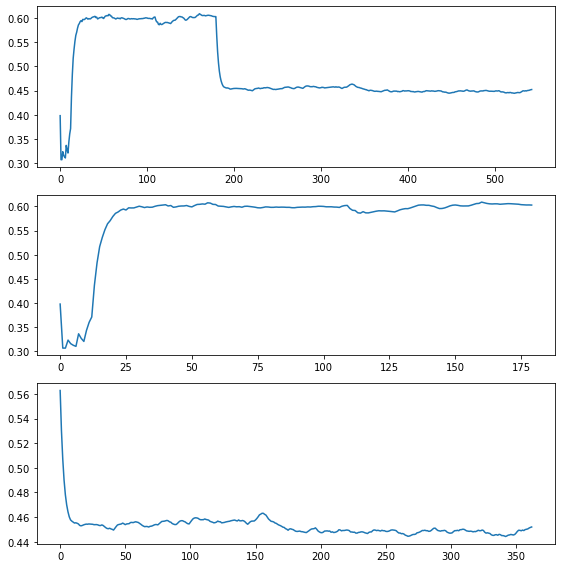

df_len_cnt: 16  H: 10  Total error: 19 Error check:  53.02258501891297 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.5151523385488198
df_len_cnt: 179  H: 10  Total error: 10 Error check:  3526.254464717777 True
******CHANGE TIMES
ch_times :  [17, 180] ch_num :  2 Resist :  0.5944451147370395
df_len_cnt: 180  H: 10  Total error: 20 Error check:  77.5952857662243 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 180, None]
adf
17
             KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-15 2:02     0.304000       4.48      -20.0
1   2020-02-15 14:02     0.351992       4.48      -20.0
2    2020-02-16 2:01     0.353568       4.48      -20.0
3   2020-02-16 14:00     0.384850       4.44      -20.0
4    2020-02-17 2:00     0.373481       4.49      -20.0
5   2020-02-17 13:59     0.365866       4.49      -20.0
6    2020-02-18 1:59     0.362483       4.48      -20.0
7   2020-02-18 13:58     0.345944       4.46      -20.0
8    2020-02-19 1:57     0.347880       4.50    

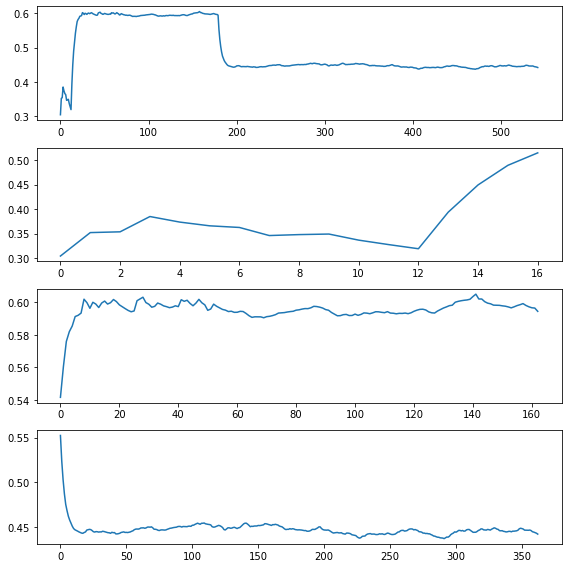

df_len_cnt: 179  H: 10  Total error: 10 Error check:  23870.04652541585 True
******CHANGE TIMES
ch_times :  [180] ch_num :  1 Resist :  0.6131219018642237
CHECK TIMES
[None, 180, None]
adf
180
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.350000       4.49      -20.0
1    2020-02-15 14:02     0.428987       4.44      -20.0
2     2020-02-16 2:01     0.430565       4.45      -20.0
3    2020-02-16 14:00     0.324707       4.48      -20.0
4     2020-02-17 2:00     0.341439       4.46      -20.0
..                ...          ...        ...        ...
175  2020-07-01 16:58     0.612590       4.49      -20.0
176   2020-07-02 4:58     0.612431       4.50      -20.0
177  2020-07-02 16:57     0.612585       4.48      -20.0
178   2020-07-03 4:57     0.612427       4.48      -20.0
179  2020-07-03 13:10     0.613122       4.48      -20.0

[180 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:25     0.57229

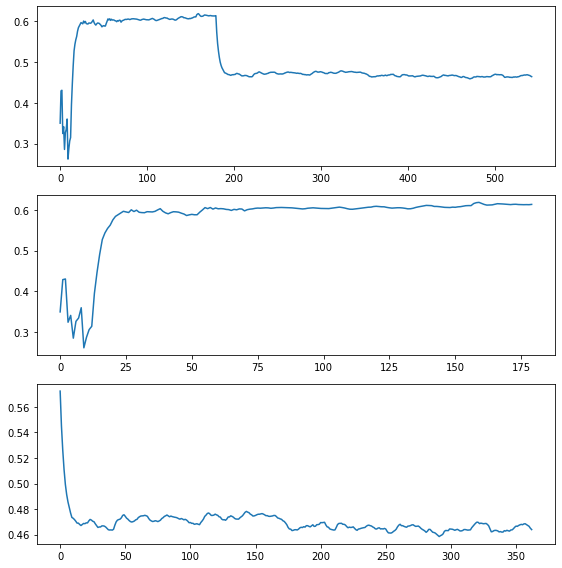

df_len_cnt: 16  H: 10  Total error: 19 Error check:  73.26080655742543 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.5183402475005444
df_len_cnt: 179  H: 10  Total error: 10 Error check:  3030.663914100287 True
******CHANGE TIMES
ch_times :  [17, 180] ch_num :  2 Resist :  0.5944913340499427
CHECK TIMES
[None, 17, 180, None]
adf
17
             KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-15 2:02     0.428000       4.45      -20.0
1   2020-02-15 14:02     0.150046       4.48      -20.0
2    2020-02-16 2:01     0.266299       4.45      -20.0
3   2020-02-16 14:00     0.164001       4.47       17.9
4    2020-02-17 2:00     0.214237       4.47      -20.0
5   2020-02-17 13:59     0.150214       4.46       18.3
6    2020-02-18 1:59     0.152434       4.50      -20.0
7   2020-02-18 13:58     0.153147       4.48      -20.0
8    2020-02-19 1:57     0.154204       4.48      -20.0
9   2020-02-19 13:57     0.212982       4.45      -20.0
10   2020-02-20 1:56     0.2715

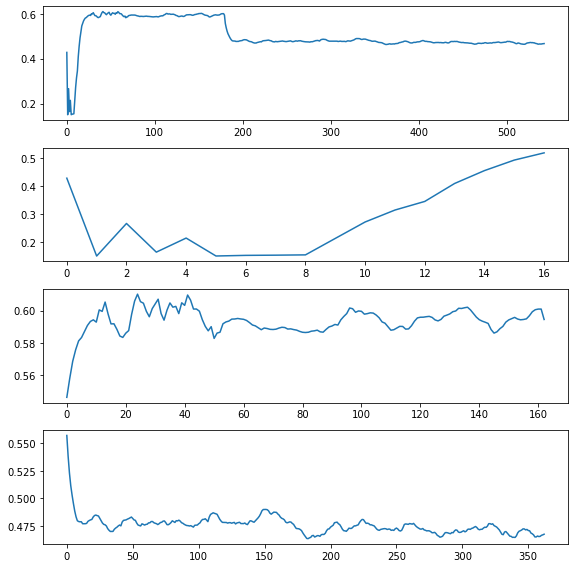

df_len_cnt: 16  H: 10  Total error: 20 Error check:  59.76134829502616 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.48060411910703443
df_len_cnt: 17  H: 10  Total error: 20 Error check:  68.81414189305518 True
******CHANGE TIMES
CHECK TIMES
[None, 17, None]
adf
17
             KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-15 2:02     0.147000       4.48      -20.0
1   2020-02-15 14:02     0.000024       4.47       17.1
2    2020-02-16 2:01     0.168142       4.47      -20.0
3   2020-02-16 14:00     0.247607       4.45      -20.0
4    2020-02-17 2:00     0.284597       4.48      -20.0
5   2020-02-17 13:59     0.311016       4.44      -20.0
6    2020-02-18 1:59     0.222338       4.47       18.2
7   2020-02-18 13:58     0.160518       4.45       18.7
8    2020-02-19 1:57     0.217712       4.43      -20.0
9   2020-02-19 13:57     0.245300       4.47      -20.0
10   2020-02-20 1:56     0.221070       4.48      -20.0
11  2020-02-20 13:40     0.203450       4.4

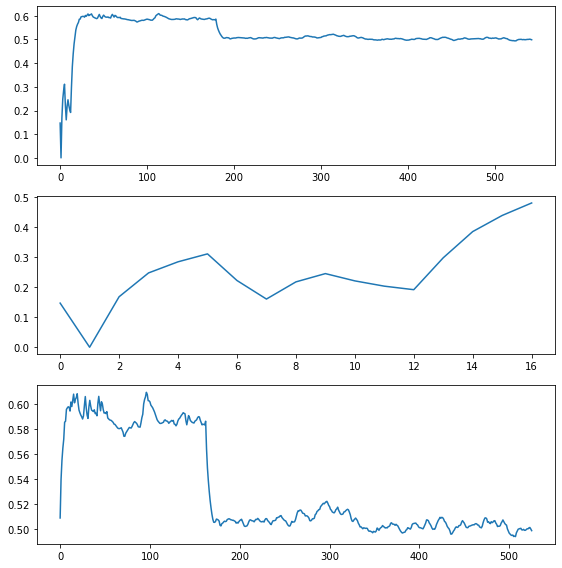

df_len_cnt: 184  H: 10  Total error: 10 Error check:  2187.4406424670183 True
******CHANGE TIMES
ch_times :  [185] ch_num :  1 Resist :  0.617161090166025
CHECK TIMES
[None, 185, None]
adf
185
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.000000       4.47       17.0
1    2020-02-15 14:02     0.366939       4.44      -20.0
2     2020-02-16 2:01     0.365923       4.48      -20.0
3    2020-02-16 14:00     0.347514       4.47      -20.0
4     2020-02-17 2:00     0.357132       4.45      -20.0
..                ...          ...        ...        ...
180   2020-07-02 4:58     0.618871       4.47       17.7
181  2020-07-02 16:57     0.621337       4.47       17.9
182   2020-07-03 4:57     0.622867       4.46       17.8
183  2020-07-03 13:10     0.624254       4.46       18.3
184  2020-07-03 13:17     0.617161       4.46       18.3

[185 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:25     0.58064

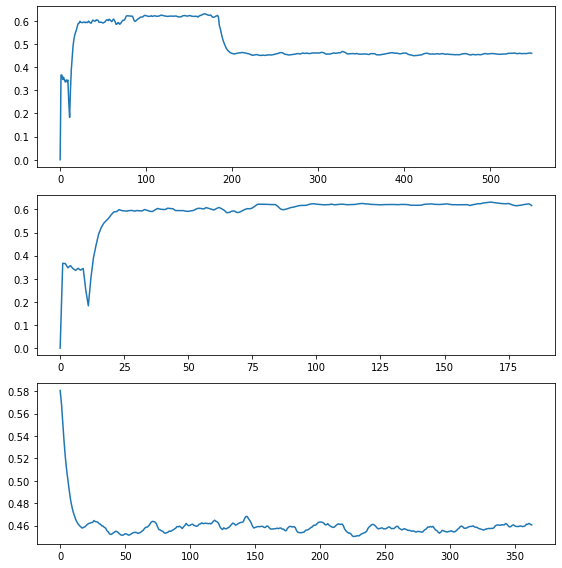

df_len_cnt: 182  H: 10  Total error: 10 Error check:  2194.321234504821 True
******CHANGE TIMES
ch_times :  [183] ch_num :  1 Resist :  0.5984337365763479
df_len_cnt: 183  H: 10  Total error: 20 Error check:  103.60129097597192 True
******CHANGE TIMES
CHECK TIMES
[None, 183, None]
adf
183
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.367000       4.44      -20.0
1    2020-02-15 14:02     0.364000       4.48      -20.0
2     2020-02-16 2:01     0.370809       4.45      -20.0
3    2020-02-16 14:00     0.367809       4.47      -20.0
4     2020-02-17 2:00     0.358738       4.46      -20.0
..                ...          ...        ...        ...
178  2020-07-01 16:58     0.592676       4.45      -20.0
179   2020-07-02 4:58     0.593033       4.45      -20.0
180  2020-07-02 16:57     0.593565       4.46      -20.0
181   2020-07-03 4:57     0.593412       4.44      -20.0
182  2020-07-03 13:10     0.598434       4.46      -20.0

[183 rows x 4 columns]
ad

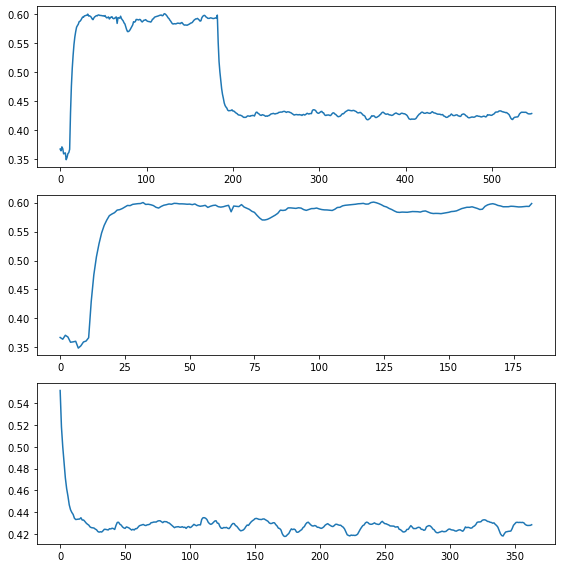

df_len_cnt: 182  H: 10  Total error: 10 Error check:  13097.156137268597 True
******CHANGE TIMES
ch_times :  [183] ch_num :  1 Resist :  0.606712170566592
CHECK TIMES
[None, 183, None]
adf
183
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.326000       4.46      -20.0
1    2020-02-15 14:02     0.376992       4.45      -20.0
2     2020-02-16 2:01     0.389043       4.47      -20.0
3    2020-02-16 14:00     0.385185       4.45      -20.0
4     2020-02-17 2:00     0.371750       4.45      -20.0
..                ...          ...        ...        ...
178  2020-07-01 16:58     0.608027       4.47      -20.0
179   2020-07-02 4:58     0.608020       4.47      -20.0
180  2020-07-02 16:57     0.607474       4.48      -20.0
181   2020-07-03 4:57     0.607346       4.47      -20.0
182  2020-07-03 13:10     0.606712       4.48      -20.0

[183 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:17     0.54951

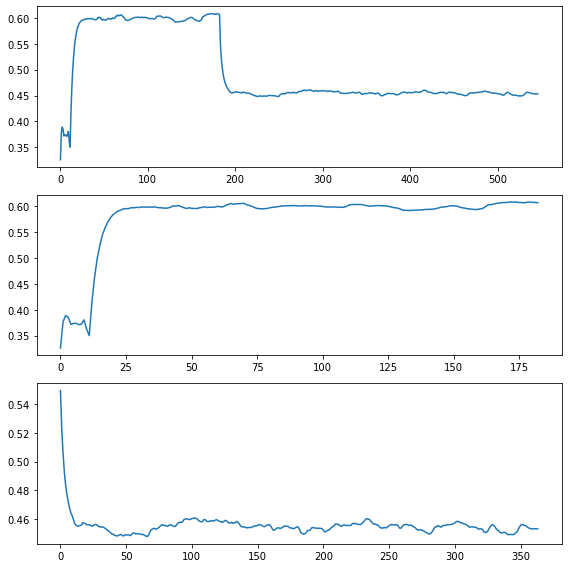

df_len_cnt: 181  H: 10  Total error: 10 Error check:  9956.902410358734 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.6077665689464733
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.367000       4.47      -20.0
1    2020-02-15 14:02     0.399995       4.46      -20.0
2     2020-02-16 2:01     0.410473       4.47      -20.0
3    2020-02-16 14:00     0.406834       4.46      -20.0
4     2020-02-17 2:00     0.399385       4.47      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.608894       4.48      -20.0
178   2020-07-02 4:58     0.608652       4.48      -20.0
179  2020-07-02 16:57     0.608206       4.48      -20.0
180   2020-07-03 4:57     0.608420       4.48      -20.0
181  2020-07-03 13:10     0.607767       4.48      -20.0

[182 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:17     0.55785

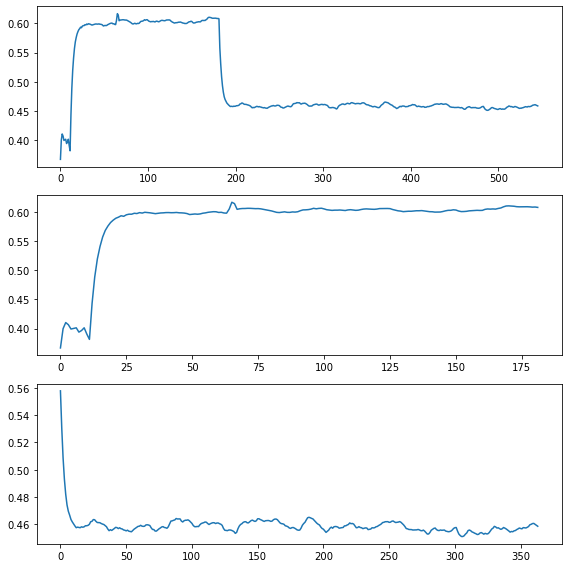

df_len_cnt: 181  H: 10  Total error: 10 Error check:  4757.627167562975 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.6060262662677873
df_len_cnt: 182  H: 10  Total error: 20 Error check:  57.703984261002994 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 20 Error check:  21.438167752240904 True
******CHANGE TIMES
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.380000       4.44      -20.0
1    2020-02-15 14:02     0.416994       4.46      -20.0
2     2020-02-16 2:01     0.375095       4.46      -20.0
3    2020-02-16 14:00     0.393114       4.47      -20.0
4     2020-02-17 2:00     0.390467       4.44      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.610644       4.45      -20.0
178   2020-07-02 4:58     0.609389       4.46      -20.0
179  2020-07-02 16:57     0.607393       4.45      -20.0
180   2020-07-03 4:57     0.605666       4.

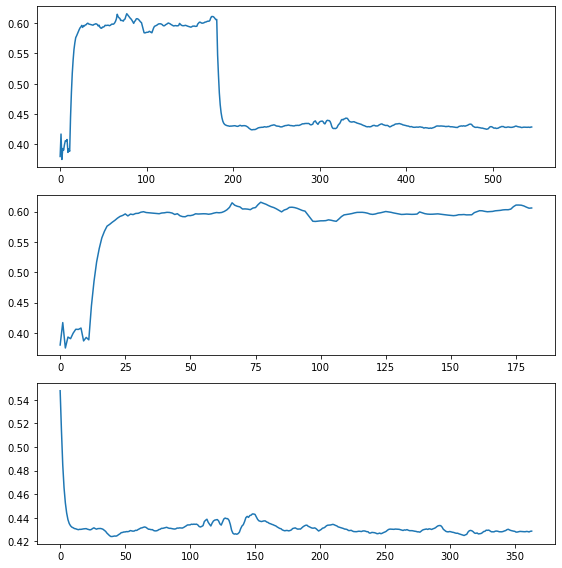

df_len_cnt: 85  H: 10  Total error: 1 Error check:  655.0536756132603 True
df_len_cnt: 181  H: 10  Total error: 10 Error check:  2558.2954493072657 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.6106368140791324
df_len_cnt: 182  H: 10  Total error: 20 Error check:  146.84519499159657 True
******CHANGE TIMES
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.401000       4.47      -20.0
1    2020-02-15 14:02     0.345009       4.44      -20.0
2     2020-02-16 2:01     0.346052       4.43      -20.0
3    2020-02-16 14:00     0.341422       4.46      -20.0
4     2020-02-17 2:00     0.356617       4.47      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.608051       4.46      -20.0
178   2020-07-02 4:58     0.608848       4.47      -20.0
179  2020-07-02 16:57     0.608619       4.46      -20.0
180   2020-07-03 4:57     0.607911       4.46      -20.0
181  20

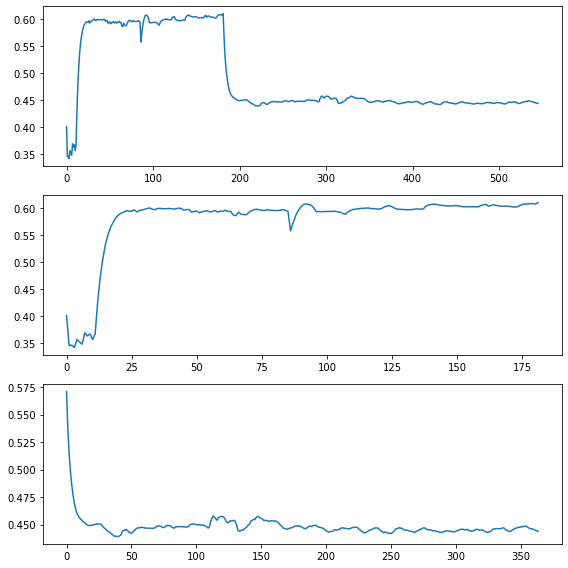

df_len_cnt: 64  H: 10  Total error: 2 Error check:  317.36731088250406 True
df_len_cnt: 181  H: 10  Total error: 8 Error check:  1937.2588595292402 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.6046438532669508
df_len_cnt: 182  H: 10  Total error: 20 Error check:  38.482193770507344 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 20 Error check:  108.35383432110109 True
******CHANGE TIMES
df_len_cnt: 184  H: 10  Total error: 12 Error check:  231.0982899253207 True
******CHANGE TIMES
df_len_cnt: 185  H: 10  Total error: 13 Error check:  109.28767455945925 True
******CHANGE TIMES
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.424000       4.46      -20.0
1    2020-02-15 14:02     0.388006       4.47      -20.0
2     2020-02-16 2:01     0.387479       4.46      -20.0
3    2020-02-16 14:00     0.371929       4.44      -20.0
4     2020-02-17 2:00     0.354989       4.47       18.1
..

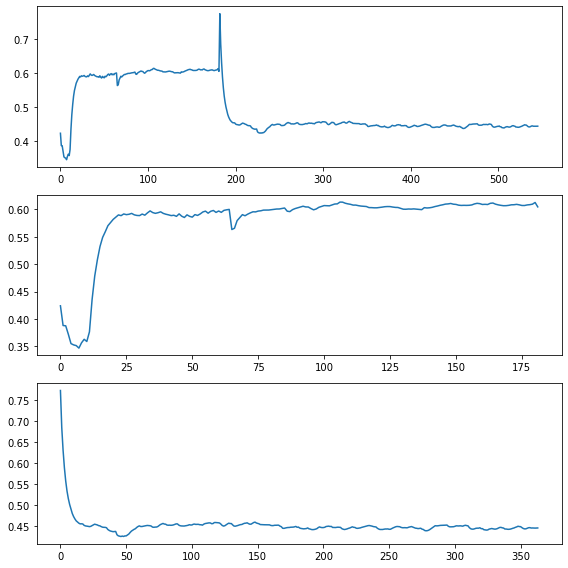

df_len_cnt: 181  H: 10  Total error: 10 Error check:  2342.1897632748614 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.60301936164252
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.339000       4.46      -20.0
1    2020-02-15 14:02     0.383993       4.44      -20.0
2     2020-02-16 2:01     0.385044       4.44      -20.0
3    2020-02-16 14:00     0.385027       4.47      -20.0
4     2020-02-17 2:00     0.376863       4.45      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.608011       4.46      -20.0
178   2020-07-02 4:58     0.606387       4.47      -20.0
179  2020-07-02 16:57     0.605202       4.47      -20.0
180   2020-07-03 4:57     0.604877       4.46      -20.0
181  2020-07-03 13:10     0.603019       4.46      -20.0

[182 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:17     0.549793

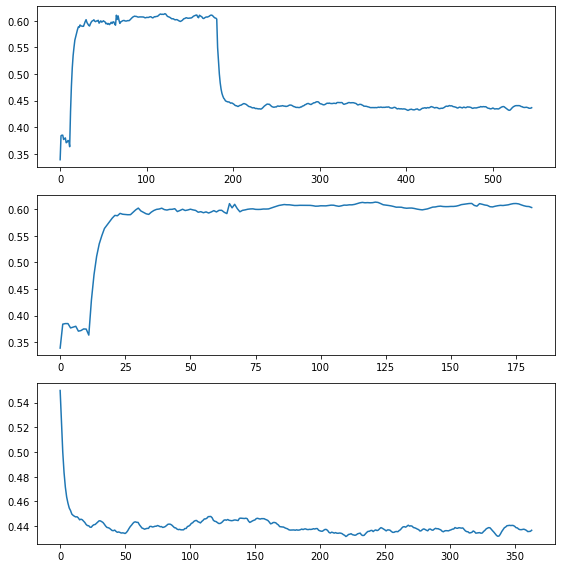

df_len_cnt: 181  H: 10  Total error: 10 Error check:  2024.8822916449135 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.5877999222697121
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.348000       4.44      -20.0
1    2020-02-15 14:02     0.385994       4.46      -20.0
2     2020-02-16 2:01     0.385473       4.47      -20.0
3    2020-02-16 14:00     0.386444       4.44      -20.0
4     2020-02-17 2:00     0.387604       4.45      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.594360       4.45      -20.0
178   2020-07-02 4:58     0.594263       4.44      -20.0
179  2020-07-02 16:57     0.593381       4.45      -20.0
180   2020-07-03 4:57     0.593278       4.45      -20.0
181  2020-07-03 13:10     0.587800       4.44      -20.0

[182 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:17     0.5259

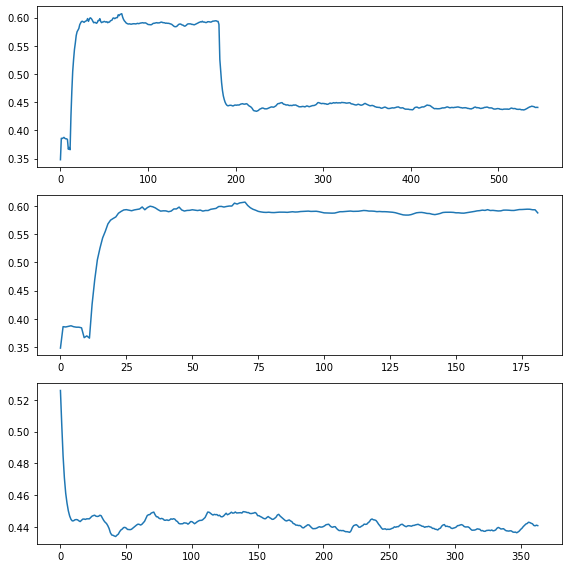

df_len_cnt: 181  H: 10  Total error: 10 Error check:  1696.0947605865504 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.5901076727117314
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.390000       4.46      -20.0
1    2020-02-15 14:02     0.319012       4.47       17.4
2     2020-02-16 2:01     0.322148       4.46       17.2
3    2020-02-16 14:00     0.347061       4.47      -20.0
4     2020-02-17 2:00     0.343453       4.46      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.591814       4.49      -20.0
178   2020-07-02 4:58     0.592135       4.47      -20.0
179  2020-07-02 16:57     0.594260       4.47      -20.0
180   2020-07-03 4:57     0.593109       4.47      -20.0
181  2020-07-03 13:10     0.590108       4.46      -20.0

[182 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:17     0.5236

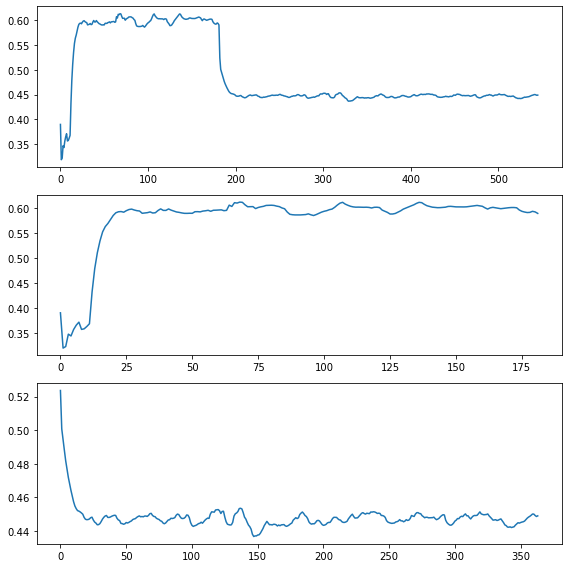

df_len_cnt: 181  H: 10  Total error: 9 Error check:  1193.477840653626 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.5924183909366222
df_len_cnt: 182  H: 10  Total error: 20 Error check:  28.01569075255299 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 20 Error check:  76.68016701550262 True
******CHANGE TIMES
df_len_cnt: 184  H: 10  Total error: 19 Error check:  158.4688802780719 True
******CHANGE TIMES
df_len_cnt: 185  H: 10  Total error: 13 Error check:  78.18725093901962 True
******CHANGE TIMES
df_len_cnt: 186  H: 10  Total error: 20 Error check:  25.95992465350585 True
******CHANGE TIMES
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.383000       4.43      -20.0
1    2020-02-15 14:02     0.364003       4.46      -20.0
2     2020-02-16 2:01     0.364002       4.46      -20.0
3    2020-02-16 14:00     0.363617       4.46      -20.0
4     2020-02-17 2:00     0.370918       4.

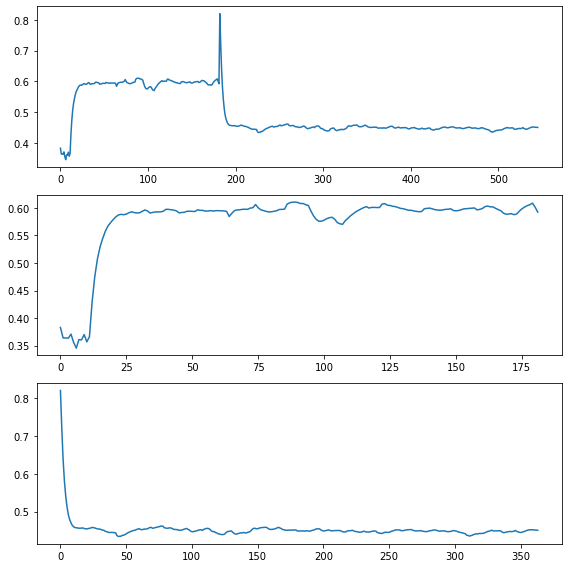

df_len_cnt: 181  H: 10  Total error: 9 Error check:  1463.9557262663927 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.5914090453542008
df_len_cnt: 182  H: 10  Total error: 20 Error check:  19.792396133933785 False
df_len_cnt: 183  H: 10  Total error: 20 Error check:  58.37220336341482 True
******CHANGE TIMES
df_len_cnt: 184  H: 10  Total error: 20 Error check:  109.41773037063736 True
******CHANGE TIMES
df_len_cnt: 185  H: 10  Total error: 13 Error check:  127.0619030023045 True
******CHANGE TIMES
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.381000       4.47      -20.0
1    2020-02-15 14:02     0.393998       4.46      -20.0
2     2020-02-16 2:01     0.399237       4.47      -20.0
3    2020-02-16 14:00     0.401067       4.47      -20.0
4     2020-02-17 2:00     0.404633       4.45      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.598500      

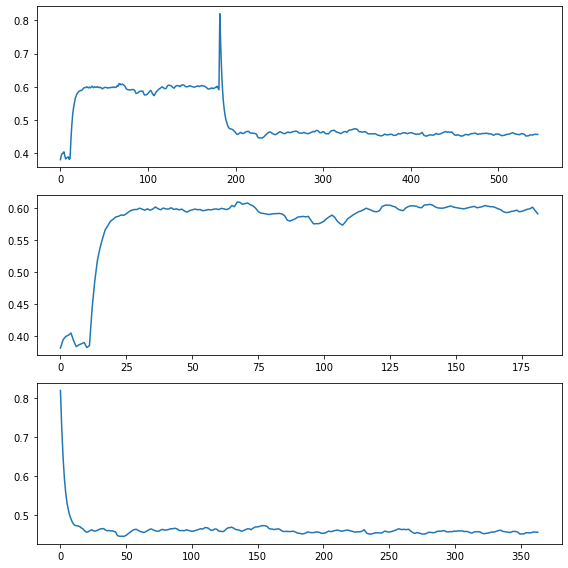

df_len_cnt: 181  H: 10  Total error: 10 Error check:  10186.236595259092 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.602614579221671
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.320000       4.48       17.2
1    2020-02-15 14:02     0.389988       4.46      -20.0
2     2020-02-16 2:01     0.392090       4.46      -20.0
3    2020-02-16 14:00     0.394360       4.46      -20.0
4     2020-02-17 2:00     0.402072       4.47      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.602623       4.47       18.2
178   2020-07-02 4:58     0.603535       4.48       18.0
179  2020-07-02 16:57     0.603661       4.48       18.1
180   2020-07-03 4:57     0.603212       4.47       18.0
181  2020-07-03 13:10     0.602615       4.47       18.5

[182 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:17     0.56381

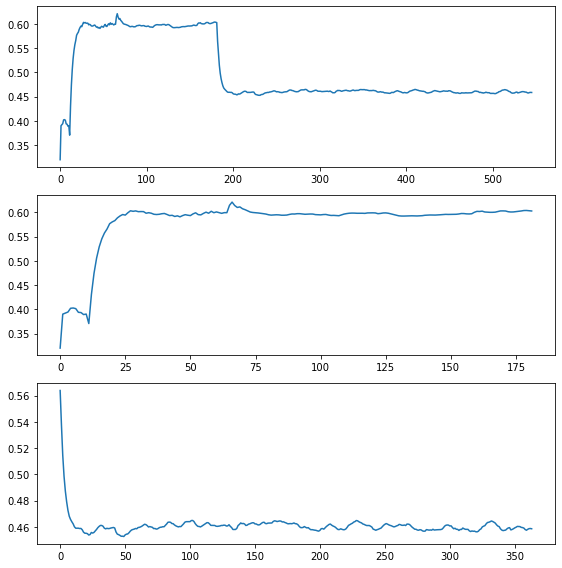

df_len_cnt: 182  H: 10  Total error: 10 Error check:  312.2675595786468 True
******CHANGE TIMES
ch_times :  [183] ch_num :  1 Resist :  0.5893531701207886
CHECK TIMES
[None, 183, None]
adf
183
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.361000       4.46      -20.0
1    2020-02-15 14:02     0.336004       4.46      -20.0
2     2020-02-16 2:01     0.364809       4.46      -20.0
3    2020-02-16 14:00     0.374871       4.46      -20.0
4     2020-02-17 2:00     0.368388       4.47      -20.0
..                ...          ...        ...        ...
178   2020-07-02 4:58     0.613378       4.47      -20.0
179  2020-07-02 16:57     0.613276       4.46      -20.0
180   2020-07-03 4:57     0.613471       4.46      -20.0
181  2020-07-03 13:10     0.612804       4.46      -20.0
182  2020-07-03 13:17     0.589353       4.47      -20.0

[183 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:25     0.55629

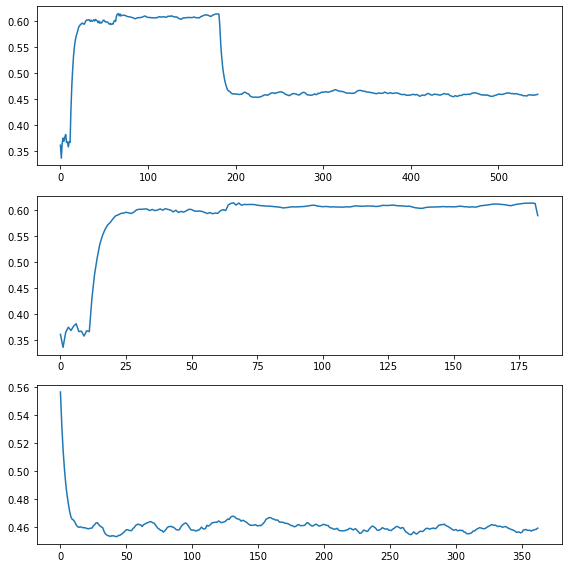

df_len_cnt: 181  H: 10  Total error: 9 Error check:  545.9419800045222 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.6213667352916161
df_len_cnt: 182  H: 10  Total error: 20 Error check:  21.104276160415537 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 20 Error check:  61.810708331398004 True
******CHANGE TIMES
df_len_cnt: 184  H: 10  Total error: 19 Error check:  121.91621885630532 True
******CHANGE TIMES
df_len_cnt: 185  H: 10  Total error: 13 Error check:  94.85995562577054 True
******CHANGE TIMES
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.400000       4.48      -20.0
1    2020-02-15 14:02     0.385002       4.46      -20.0
2     2020-02-16 2:01     0.386049       4.47      -20.0
3    2020-02-16 14:00     0.366823       4.47      -20.0
4     2020-02-17 2:00     0.360030       4.46      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58 

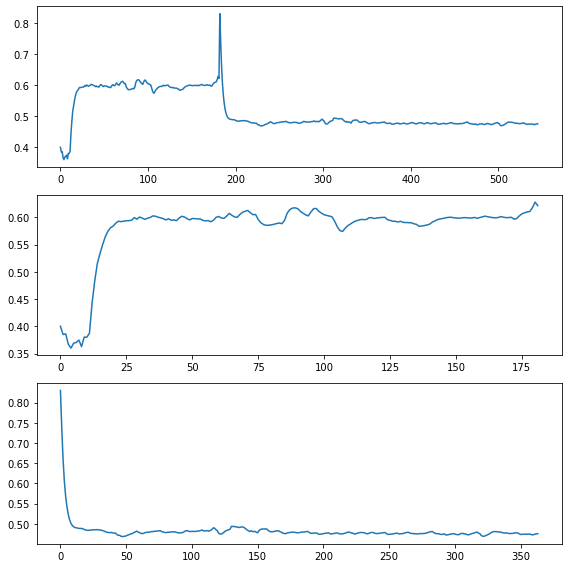

df_len_cnt: 181  H: 10  Total error: 8 Error check:  1962.783316455376 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.6078930307584913
df_len_cnt: 182  H: 10  Total error: 20 Error check:  87.75445432173959 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 12 Error check:  298.1538394813677 True
******CHANGE TIMES
df_len_cnt: 184  H: 10  Total error: 12 Error check:  145.61280863891625 True
******CHANGE TIMES
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.395000       4.46      -20.0
1    2020-02-15 14:02     0.423995       4.47      -20.0
2     2020-02-16 2:01     0.423998       4.48      -20.0
3    2020-02-16 14:00     0.409785       4.47      -20.0
4     2020-02-17 2:00     0.425513       4.49       18.2
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.610870       4.46      -20.0
178   2020-07-02 4:58     0.612526       4.46      -20.0
179  2

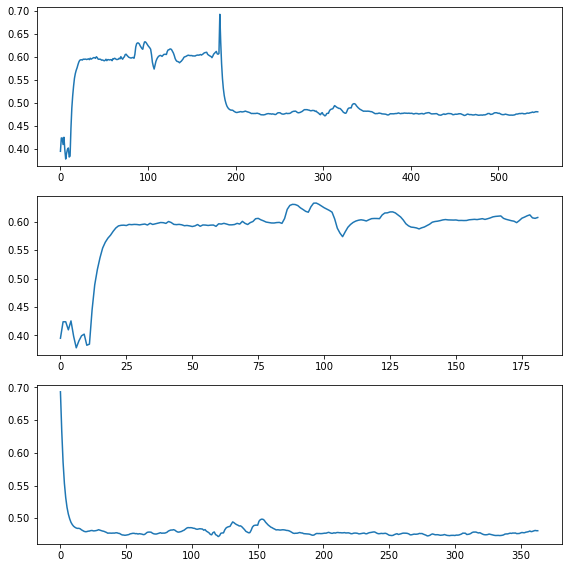

df_len_cnt: 181  H: 10  Total error: 8 Error check:  1930.9880232348833 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.6192334028487053
df_len_cnt: 182  H: 10  Total error: 20 Error check:  33.41260630978163 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 20 Error check:  92.7395228473031 True
******CHANGE TIMES
df_len_cnt: 184  H: 10  Total error: 12 Error check:  206.81997913658634 True
******CHANGE TIMES
df_len_cnt: 185  H: 10  Total error: 14 Error check:  39.088405915513526 True
******CHANGE TIMES
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.389000       4.46      -20.0
1    2020-02-15 14:02     0.410996       4.45      -20.0
2     2020-02-16 2:01     0.409427       4.45      -20.0
3    2020-02-16 14:00     0.415025       4.48      -20.0
4     2020-02-17 2:00     0.424477       4.47      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58  

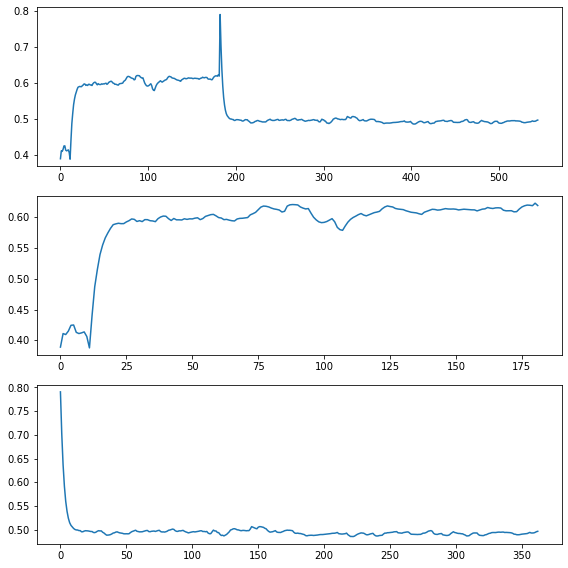

df_len_cnt: 182  H: 10  Total error: 10 Error check:  1053.282439711452 True
******CHANGE TIMES
ch_times :  [183] ch_num :  1 Resist :  0.5871550597312082
CHECK TIMES
[None, 183, None]
adf
183
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.384000       4.47      -20.0
1    2020-02-15 14:02     0.414995       4.47      -20.0
2     2020-02-16 2:01     0.415521       4.47      -20.0
3    2020-02-16 14:00     0.413016       4.45      -20.0
4     2020-02-17 2:00     0.409749       4.46      -20.0
..                ...          ...        ...        ...
178   2020-07-02 4:58     0.598431       4.47      -20.0
179  2020-07-02 16:57     0.597504       4.47      -20.0
180   2020-07-03 4:57     0.596557       4.46      -20.0
181  2020-07-03 13:10     0.594245       4.46      -20.0
182  2020-07-03 13:17     0.587155       4.46      -20.0

[183 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:25     0.54659

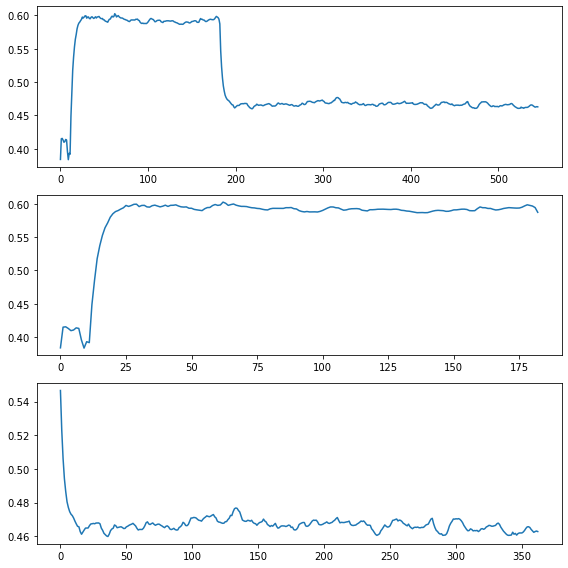

df_len_cnt: 180  H: 10  Total error: 10 Error check:  4076.631318733338 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.6014068654125966
df_len_cnt: 181  H: 10  Total error: 20 Error check:  165.5907495283141 True
******CHANGE TIMES
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.424000       4.47      -20.0
1    2020-02-15 14:02     0.355011       4.47      -20.0
2     2020-02-16 2:01     0.356577       4.48      -20.0
3    2020-02-16 14:00     0.379404       4.45      -20.0
4     2020-02-17 2:00     0.376010       4.48      -20.0
..                ...          ...        ...        ...
176  2020-07-01 16:58     0.603910       4.47      -20.0
177   2020-07-02 4:58     0.603664       4.47      -20.0
178  2020-07-02 16:57     0.602134       4.47      -20.0
179   2020-07-03 4:57     0.601557       4.47      -20.0
180  2020-07-03 13:10     0.601407       4.47      -20.0

[181 rows x 4 columns]
adf

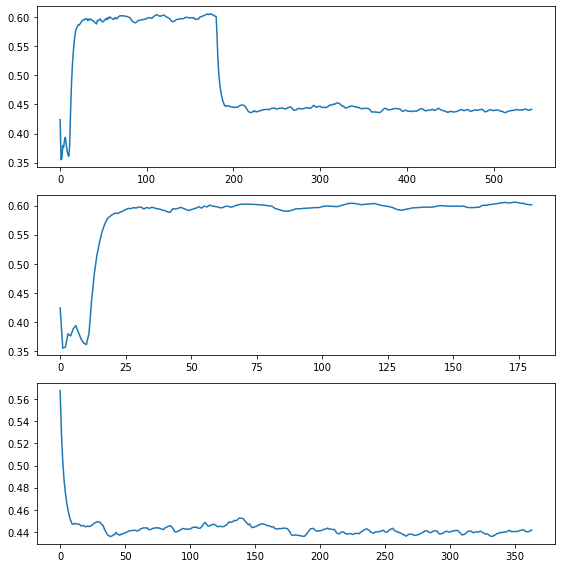

df_len_cnt: 181  H: 10  Total error: 9 Error check:  1279.3529251391124 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.5994268546806689
df_len_cnt: 182  H: 10  Total error: 20 Error check:  60.42159115030944 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 20 Error check:  175.25410192941683 True
******CHANGE TIMES
df_len_cnt: 184  H: 10  Total error: 12 Error check:  307.9290556466514 True
******CHANGE TIMES
df_len_cnt: 185  H: 10  Total error: 20 Error check:  8.092111861170617 False
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.410000       4.46      -20.0
1    2020-02-15 14:02     0.346011       4.48      -20.0
2     2020-02-16 2:01     0.345481       4.47      -20.0
3    2020-02-16 14:00     0.350290       4.48      -20.0
4     2020-02-17 2:00     0.346607       4.50      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.608183       

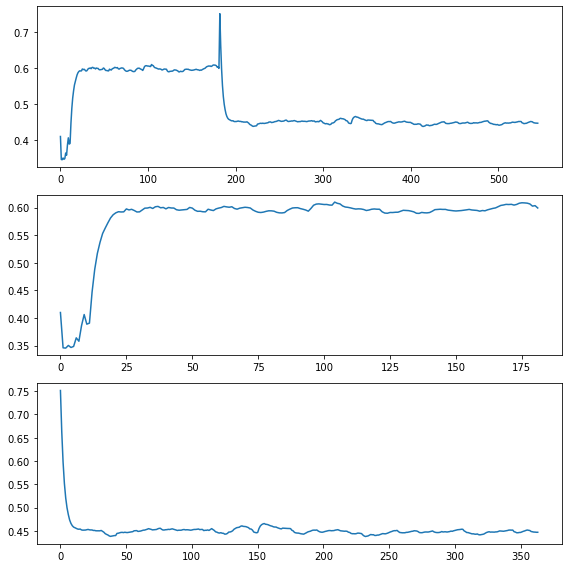

df_len_cnt: 181  H: 10  Total error: 9 Error check:  2687.3473302490916 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.6204253090858648
df_len_cnt: 182  H: 10  Total error: 20 Error check:  276.8941538414399 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 11 Error check:  500.06866501077394 True
******CHANGE TIMES
df_len_cnt: 184  H: 10  Total error: 20 Error check:  30.80280157213625 True
******CHANGE TIMES
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.418000       4.46      -20.0
1    2020-02-15 14:02     0.465992       4.49       17.4
2     2020-02-16 2:01     0.467044       4.49       17.3
3    2020-02-16 14:00     0.419776       4.48      -20.0
4     2020-02-17 2:00     0.412020       4.46      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.616274       4.46      -20.0
178   2020-07-02 4:58     0.615660       4.46      -20.0
179  

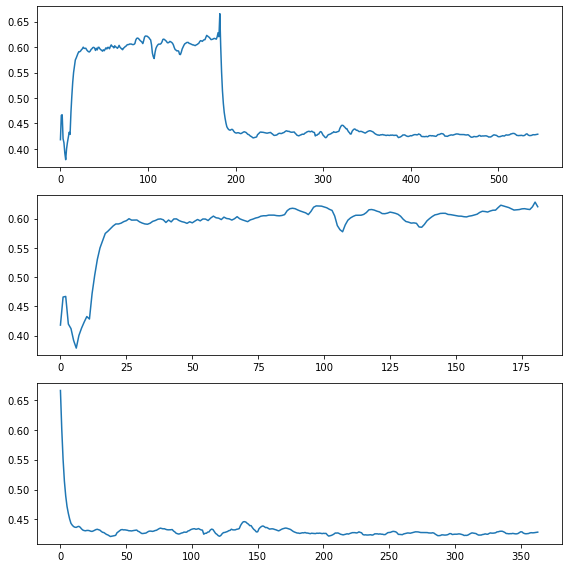

df_len_cnt: 181  H: 10  Total error: 9 Error check:  1791.2800087317046 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.621377882810164
df_len_cnt: 182  H: 10  Total error: 20 Error check:  80.0700122322003 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 20 Error check:  248.22369314621648 True
******CHANGE TIMES
df_len_cnt: 184  H: 10  Total error: 12 Error check:  226.1989272848973 True
******CHANGE TIMES
df_len_cnt: 185  H: 10  Total error: 20 Error check:  8.58492254818059 False
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.352000       4.47      -20.0
1    2020-02-15 14:02     0.449984       4.48      -20.0
2     2020-02-16 2:01     0.425375       4.45      -20.0
3    2020-02-16 14:00     0.440213       4.49       17.9
4     2020-02-17 2:00     0.430683       4.49      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.619594       4.4

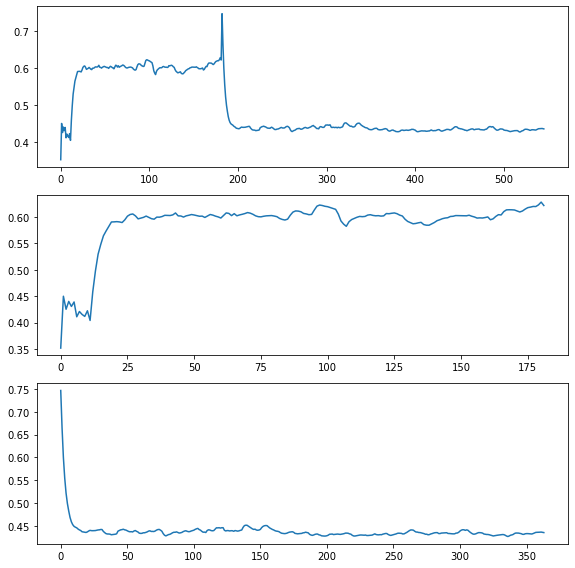

df_len_cnt: 181  H: 10  Total error: 10 Error check:  12389.325634119798 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.5999696846224345
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.343000       4.49      -20.0
1    2020-02-15 14:02     0.401990       4.46      -20.0
2     2020-02-16 2:01     0.387330       4.48      -20.0
3    2020-02-16 14:00     0.410252       4.47      -20.0
4     2020-02-17 2:00     0.394838       4.48      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.599123       4.47      -20.0
178   2020-07-02 4:58     0.599090       4.46      -20.0
179  2020-07-02 16:57     0.599066       4.48      -20.0
180   2020-07-03 4:57     0.599588       4.48      -20.0
181  2020-07-03 13:10     0.599970       4.47      -20.0

[182 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:17     0.5343

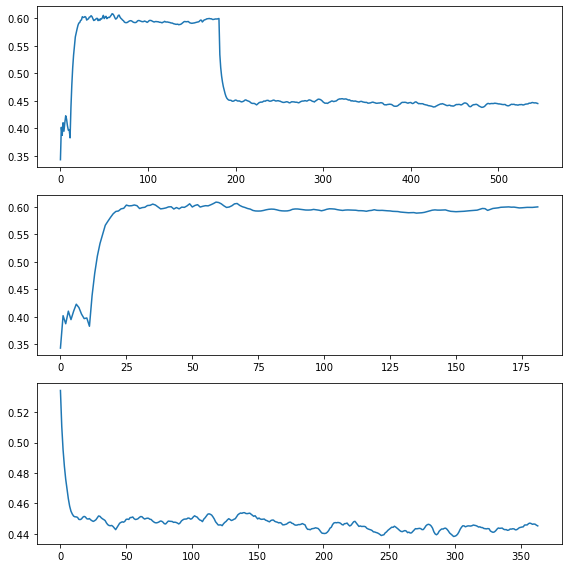

df_len_cnt: 181  H: 10  Total error: 10 Error check:  9043.91210414719 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.606952067010716
df_len_cnt: 182  H: 10  Total error: 20 Error check:  170.223876254841 True
******CHANGE TIMES
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.466000       4.49       17.3
1    2020-02-15 14:02     0.377015       4.48      -20.0
2     2020-02-16 2:01     0.359199       4.50      -20.0
3    2020-02-16 14:00     0.376409       4.46      -20.0
4     2020-02-17 2:00     0.353115       4.48      -20.0
..                ...          ...        ...        ...
177  2020-07-01 16:58     0.606124       4.48      -20.0
178   2020-07-02 4:58     0.606901       4.48      -20.0
179  2020-07-02 16:57     0.605307       4.48      -20.0
180   2020-07-03 4:57     0.603603       4.47      -20.0
181  2020-07-03 13:10     0.606952       4.48      -20.0

[182 rows x 4 columns]
adf
No

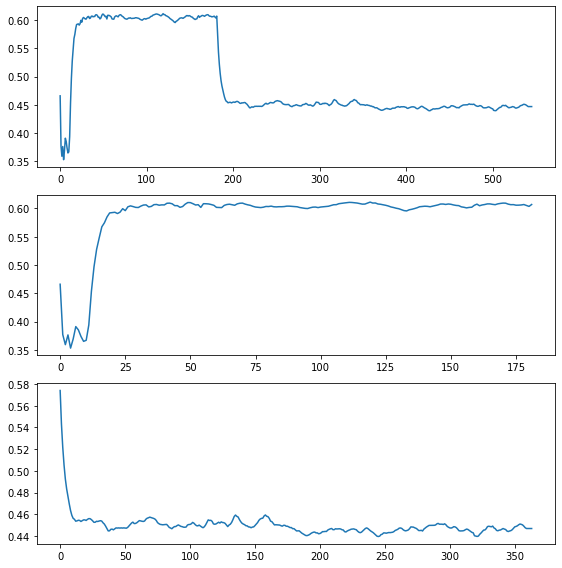

df_len_cnt: 180  H: 10  Total error: 9 Error check:  1890.4072870371074 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.6066718825414447
df_len_cnt: 181  H: 10  Total error: 20 Error check:  43.83401356787201 True
******CHANGE TIMES
df_len_cnt: 182  H: 10  Total error: 20 Error check:  122.53264386667273 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 12 Error check:  292.5813397948504 True
******CHANGE TIMES
df_len_cnt: 184  H: 10  Total error: 17 Error check:  68.10879067722155 True
******CHANGE TIMES
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.447000       4.48      -20.0
1    2020-02-15 14:02     0.344017       4.49      -20.0
2     2020-02-16 2:01     0.372292       4.47      -20.0
3    2020-02-16 14:00     0.372948       4.48      -20.0
4     2020-02-17 2:00     0.367093       4.49      -20.0
..                ...          ...        ...        ...
176  2020-07-01 16:58  

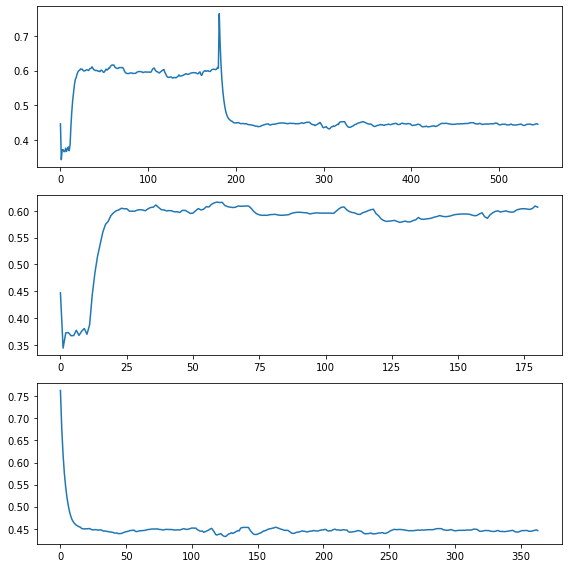

df_len_cnt: 180  H: 10  Total error: 9 Error check:  2379.495258131007 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.6264765177258396
df_len_cnt: 181  H: 10  Total error: 20 Error check:  71.8327844183491 True
******CHANGE TIMES
df_len_cnt: 182  H: 10  Total error: 20 Error check:  217.6490562605081 True
******CHANGE TIMES
df_len_cnt: 183  H: 10  Total error: 12 Error check:  361.5356883563184 True
******CHANGE TIMES
df_len_cnt: 184  H: 10  Total error: 20 Error check:  34.391891353587866 True
******CHANGE TIMES
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.403000       4.46      -20.0
1    2020-02-15 14:02     0.417998       4.49      -20.0
2     2020-02-16 2:01     0.418523       4.49      -20.0
3    2020-02-16 14:00     0.389126       4.49      -20.0
4     2020-02-17 2:00     0.393978       4.49      -20.0
..                ...          ...        ...        ...
176  2020-07-01 16:58    

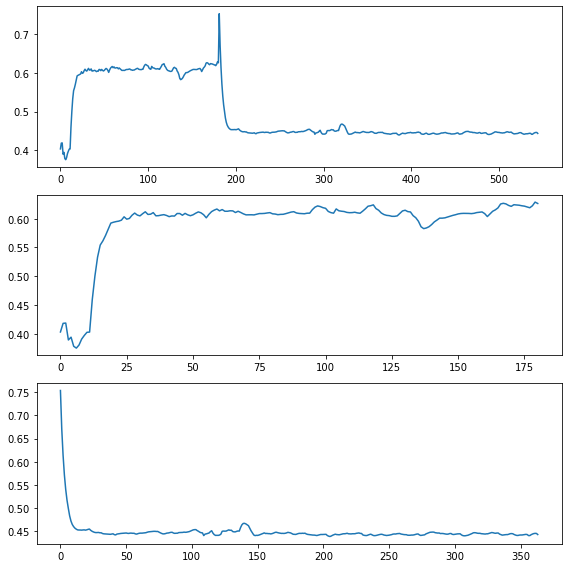

df_len_cnt: 180  H: 10  Total error: 10 Error check:  2661.8506015069706 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.6128995238183124
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.379000       4.48      -20.0
1    2020-02-15 14:02     0.361003       4.48      -20.0
2     2020-02-16 2:01     0.361001       4.48      -20.0
3    2020-02-16 14:00     0.375983       4.47      -20.0
4     2020-02-17 2:00     0.385449       4.46      -20.0
..                ...          ...        ...        ...
176  2020-07-01 16:58     0.617094       4.46      -20.0
177   2020-07-02 4:58     0.615988       4.46      -20.0
178  2020-07-02 16:57     0.615991       4.47      -20.0
179   2020-07-03 4:57     0.615453       4.46      -20.0
180  2020-07-03 13:10     0.612900       4.47      -20.0

[181 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:17     0.5029

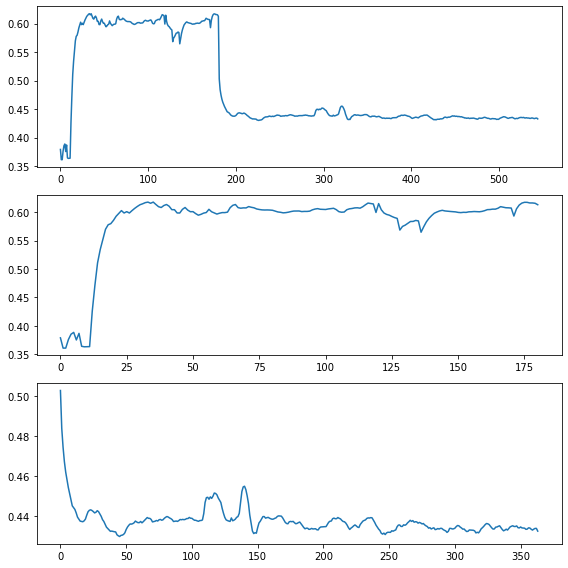

df_len_cnt: 181  H: 10  Total error: 10 Error check:  412.57528461556853 True
******CHANGE TIMES
ch_times :  [182] ch_num :  1 Resist :  0.5946303956195174
df_len_cnt: 182  H: 10  Total error: 20 Error check:  28.86747460863606 True
******CHANGE TIMES
CHECK TIMES
[None, 182, None]
adf
182
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.344000       4.49      -20.0
1    2020-02-15 14:02     0.305006       4.48      -20.0
2     2020-02-16 2:01     0.305003       4.49      -20.0
3    2020-02-16 14:00     0.348027       4.49      -20.0
4     2020-02-17 2:00     0.365960       4.46       18.4
..                ...          ...        ...        ...
177   2020-07-02 4:58     0.614928       4.48      -20.0
178  2020-07-02 16:57     0.614677       4.48      -20.0
179   2020-07-03 4:57     0.615305       4.48      -20.0
180  2020-07-03 13:10     0.615222       4.48      -20.0
181  2020-07-03 13:17     0.594630       4.48      -20.0

[182 rows x 4 columns]
ad

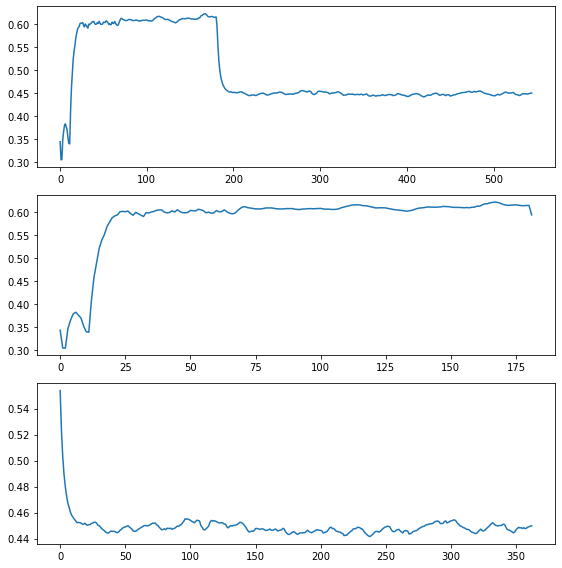

df_len_cnt: 180  H: 10  Total error: 10 Error check:  5229.608775937844 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.611495184148285
df_len_cnt: 181  H: 10  Total error: 20 Error check:  147.04982572117868 True
******CHANGE TIMES
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.400000       4.46      -20.0
1    2020-02-15 14:02     0.349008       4.50      -20.0
2     2020-02-16 2:01     0.349528       4.49      -20.0
3    2020-02-16 14:00     0.355087       4.48      -20.0
4     2020-02-17 2:00     0.345272       4.51      -20.0
..                ...          ...        ...        ...
176  2020-07-01 16:58     0.609619       4.50      -20.0
177   2020-07-02 4:58     0.609722       4.49      -20.0
178  2020-07-02 16:57     0.609257       4.50      -20.0
179   2020-07-03 4:57     0.609458       4.50      -20.0
180  2020-07-03 13:10     0.611495       4.49      -20.0

[181 rows x 4 columns]
adf

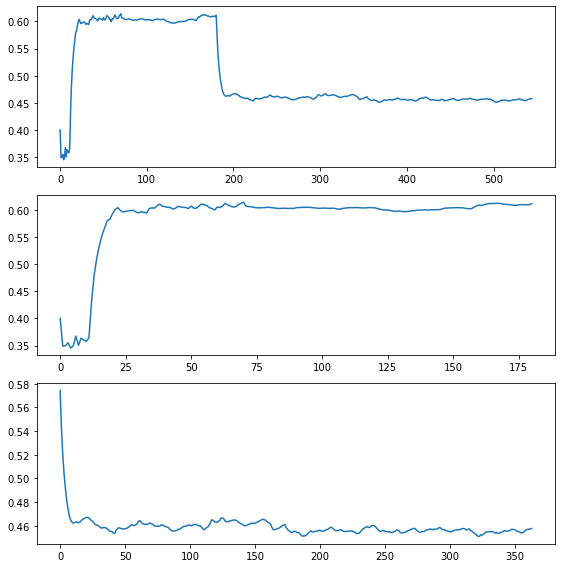

df_len_cnt: 179  H: 10  Total error: 9 Error check:  2995.194432069482 True
******CHANGE TIMES
ch_times :  [180] ch_num :  1 Resist :  0.6228559074625732
df_len_cnt: 180  H: 10  Total error: 20 Error check:  195.96850982275882 True
******CHANGE TIMES
df_len_cnt: 181  H: 10  Total error: 11 Error check:  969.5672839357368 True
******CHANGE TIMES
df_len_cnt: 182  H: 10  Total error: 20 Error check:  61.71055126667522 True
******CHANGE TIMES
CHECK TIMES
[None, 180, None]
adf
180
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.421000       4.49      -20.0
1    2020-02-15 14:02     0.405003       4.48      -20.0
2     2020-02-16 2:01     0.405001       4.49      -20.0
3    2020-02-16 14:00     0.366202       4.49      -20.0
4     2020-02-17 2:00     0.350804       4.47      -20.0
..                ...          ...        ...        ...
175  2020-07-01 16:58     0.620980       4.47      -20.0
176   2020-07-02 4:58     0.621255       4.47      -20.0
177  2

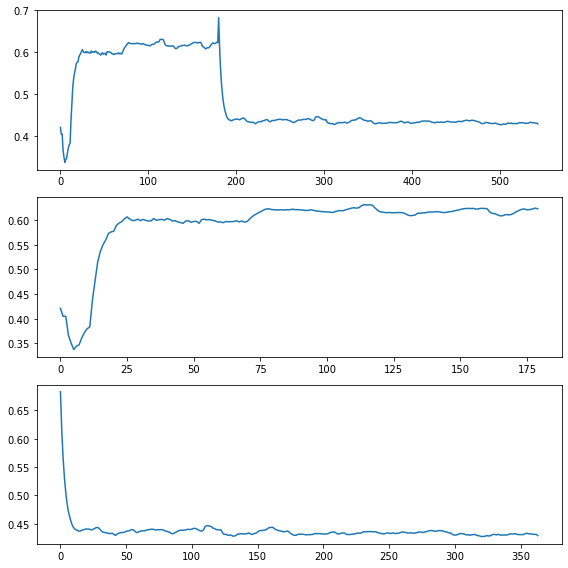

df_len_cnt: 180  H: 10  Total error: 10 Error check:  2392.7794731321196 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.6233638449184081
df_len_cnt: 181  H: 10  Total error: 20 Error check:  90.3245695968948 True
******CHANGE TIMES
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.363000       4.48      -20.0
1    2020-02-15 14:02     0.397994       4.46       17.5
2     2020-02-16 2:01     0.400092       4.47      -20.0
3    2020-02-16 14:00     0.382002       4.50      -20.0
4     2020-02-17 2:00     0.372867       4.49      -20.0
..                ...          ...        ...        ...
176   2020-07-02 4:58     0.629764       4.49      -20.0
177  2020-07-02 16:57     0.629557       4.48      -20.0
178   2020-07-03 4:57     0.629947       4.48      -20.0
179  2020-07-03 13:10     0.629421       4.48      -20.0
180  2020-07-03 13:17     0.623364       4.48      -20.0

[181 rows x 4 columns]
adf

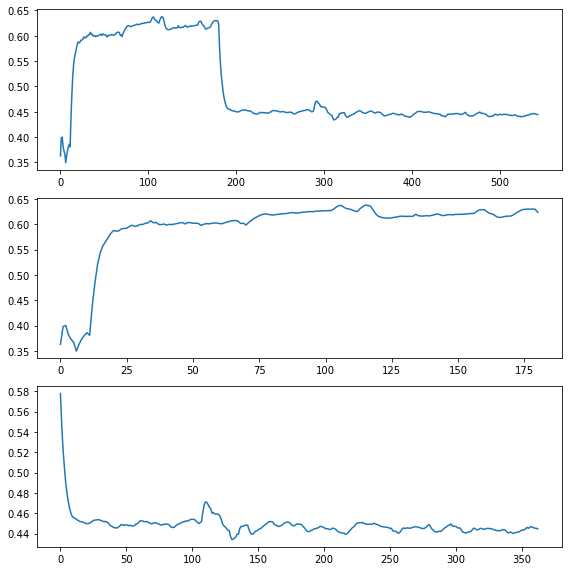

df_len_cnt: 179  H: 10  Total error: 10 Error check:  5411.103399222902 True
******CHANGE TIMES
ch_times :  [180] ch_num :  1 Resist :  0.597970981568403
df_len_cnt: 180  H: 10  Total error: 20 Error check:  158.2881674089786 True
******CHANGE TIMES
CHECK TIMES
[None, 180, None]
adf
180
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.305000       4.48      -20.0
1    2020-02-15 14:02     0.323997       4.50      -20.0
2     2020-02-16 2:01     0.363281       4.46       17.3
3    2020-02-16 14:00     0.378539       4.49      -20.0
4     2020-02-17 2:00     0.376406       4.49      -20.0
..                ...          ...        ...        ...
175  2020-07-01 16:58     0.599966       4.48      -20.0
176   2020-07-02 4:58     0.599975       4.48      -20.0
177  2020-07-02 16:57     0.600522       4.49      -20.0
178   2020-07-03 4:57     0.600921       4.48      -20.0
179  2020-07-03 13:10     0.597971       4.49      -20.0

[180 rows x 4 columns]
adf


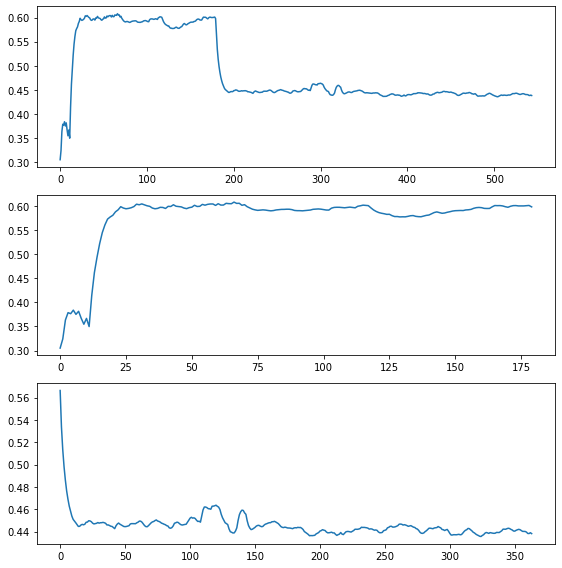

df_len_cnt: 179  H: 10  Total error: 10 Error check:  6458.247147886837 True
******CHANGE TIMES
ch_times :  [180] ch_num :  1 Resist :  0.6062176811702645
df_len_cnt: 180  H: 10  Total error: 20 Error check:  86.89063136711518 True
******CHANGE TIMES
df_len_cnt: 181  H: 10  Total error: 20 Error check:  20.072312073604877 True
******CHANGE TIMES
CHECK TIMES
[None, 180, None]
adf
180
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.353000       4.50      -20.0
1    2020-02-15 14:02     0.320005       4.48      -20.0
2     2020-02-16 2:01     0.323145       4.50      -20.0
3    2020-02-16 14:00     0.354206       4.46      -20.0
4     2020-02-17 2:00     0.361315       4.48      -20.0
..                ...          ...        ...        ...
175  2020-07-01 16:58     0.608345       4.48      -20.0
176   2020-07-02 4:58     0.608792       4.48      -20.0
177  2020-07-02 16:57     0.608848       4.48      -20.0
178   2020-07-03 4:57     0.608889       4.4

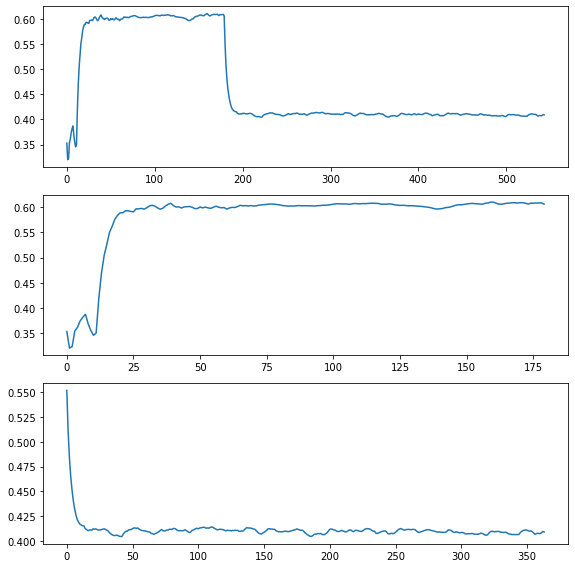

df_len_cnt: 179  H: 10  Total error: 10 Error check:  14701.894466834929 True
******CHANGE TIMES
ch_times :  [180] ch_num :  1 Resist :  0.5958080289209742
df_len_cnt: 180  H: 10  Total error: 20 Error check:  72.66010170822177 True
******CHANGE TIMES
CHECK TIMES
[None, 180, None]
adf
180
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.403000       4.49      -20.0
1    2020-02-15 14:02     0.352008       4.49      -20.0
2     2020-02-16 2:01     0.336291       4.47      -20.0
3    2020-02-16 14:00     0.360381       4.46       18.2
4     2020-02-17 2:00     0.348839       4.48      -20.0
..                ...          ...        ...        ...
175  2020-07-01 16:58     0.595861       4.50      -20.0
176   2020-07-02 4:58     0.595359       4.51      -20.0
177  2020-07-02 16:57     0.594721       4.49      -20.0
178   2020-07-03 4:57     0.594256       4.50      -20.0
179  2020-07-03 13:10     0.595808       4.49      -20.0

[180 rows x 4 columns]
ad

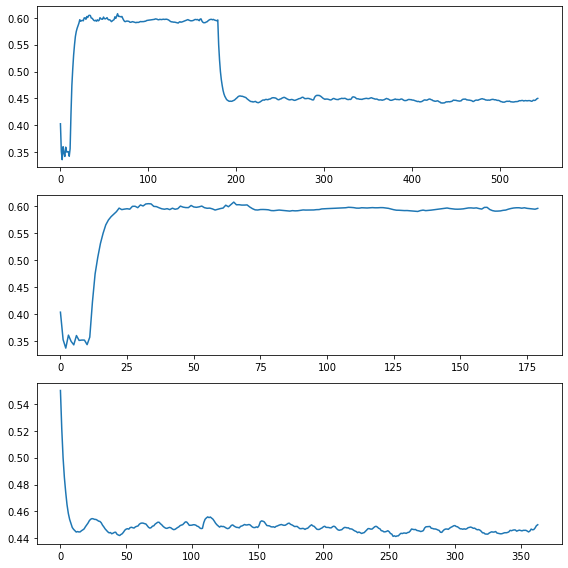

df_len_cnt: 179  H: 10  Total error: 10 Error check:  2359.5729691124393 True
******CHANGE TIMES
ch_times :  [180] ch_num :  1 Resist :  0.6164523337371994
df_len_cnt: 180  H: 10  Total error: 20 Error check:  66.01656733967229 True
******CHANGE TIMES
CHECK TIMES
[None, 180, None]
adf
180
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.405000       4.46      -20.0
1    2020-02-15 14:02     0.369006       4.49      -20.0
2     2020-02-16 2:01     0.360623       4.49      -20.0
3    2020-02-16 14:00     0.346938       4.49      -20.0
4     2020-02-17 2:00     0.349242       4.48      -20.0
..                ...          ...        ...        ...
175  2020-07-01 16:58     0.613091       4.49      -20.0
176   2020-07-02 4:58     0.613877       4.50      -20.0
177  2020-07-02 16:57     0.614450       4.49      -20.0
178   2020-07-03 4:57     0.615139       4.49      -20.0
179  2020-07-03 13:10     0.616452       4.49      -20.0

[180 rows x 4 columns]
ad

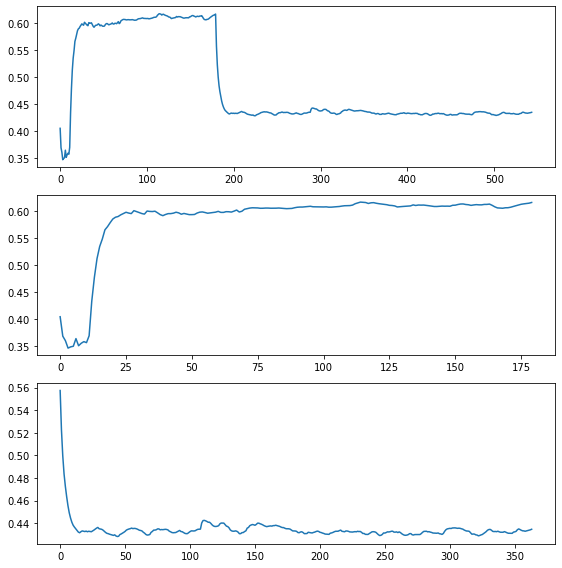

df_len_cnt: 179  H: 10  Total error: 10 Error check:  4627.828365213155 True
******CHANGE TIMES
ch_times :  [180] ch_num :  1 Resist :  0.605939096161768
df_len_cnt: 180  H: 10  Total error: 20 Error check:  212.22940514504174 True
******CHANGE TIMES
df_len_cnt: 181  H: 10  Total error: 20 Error check:  12.299801258042027 False
CHECK TIMES
[None, 180, None]
adf
180
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.403000       4.46       17.3
1    2020-02-15 14:02     0.377004       4.48      -20.0
2     2020-02-16 2:01     0.370717       4.49      -20.0
3    2020-02-16 14:00     0.351234       4.47      -20.0
4     2020-02-17 2:00     0.361270       4.48      -20.0
..                ...          ...        ...        ...
175  2020-07-01 16:58     0.603427       4.46      -20.0
176   2020-07-02 4:58     0.603582       4.46      -20.0
177  2020-07-02 16:57     0.604775       4.47      -20.0
178   2020-07-03 4:57     0.605917       4.47      -20.0
179  

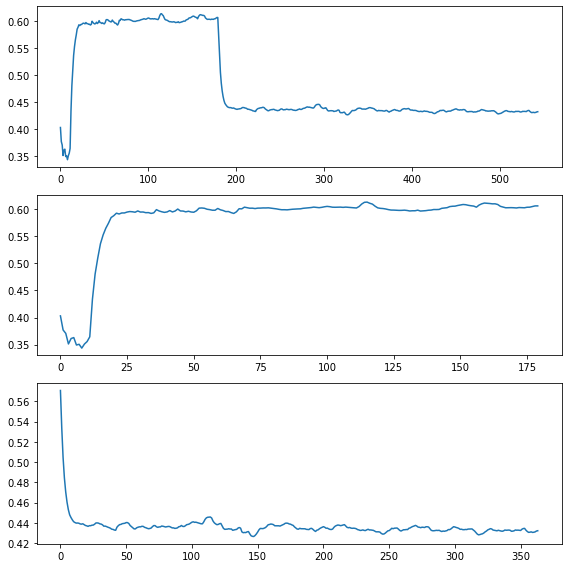

df_len_cnt: 180  H: 10  Total error: 10 Error check:  783.2364235354942 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.6283750905417342
df_len_cnt: 181  H: 10  Total error: 20 Error check:  161.04295334830996 True
******CHANGE TIMES
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.323000       4.50      -20.0
1    2020-02-15 14:02     0.326999       4.49      -20.0
2     2020-02-16 2:01     0.351093       4.48      -20.0
3    2020-02-16 14:00     0.359125       4.48      -20.0
4     2020-02-17 2:00     0.363651       4.49      -20.0
..                ...          ...        ...        ...
176   2020-07-02 4:58     0.615972       4.47       17.8
177  2020-07-02 16:57     0.615439       4.47       18.1
178   2020-07-03 4:57     0.613970       4.47       17.9
179  2020-07-03 13:10     0.613708       4.46       18.6
180  2020-07-03 13:17     0.628375       4.47       18.5

[181 rows x 4 columns]
ad

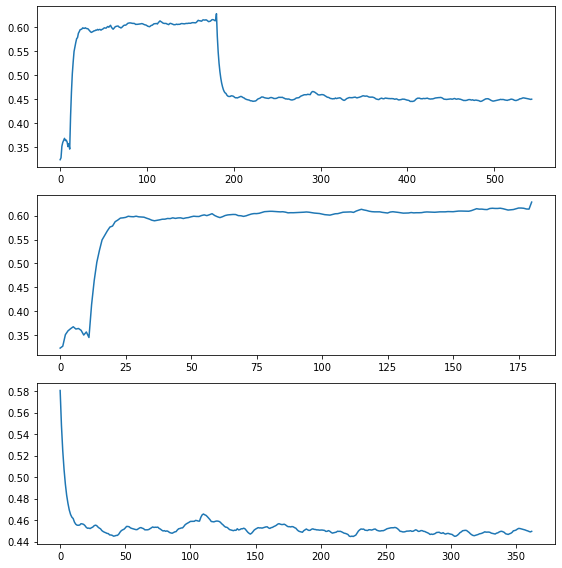

df_len_cnt: 179  H: 10  Total error: 10 Error check:  2706.684918689852 True
******CHANGE TIMES
ch_times :  [180] ch_num :  1 Resist :  0.6165737226439849
df_len_cnt: 180  H: 10  Total error: 20 Error check:  40.6911039243926 True
******CHANGE TIMES
CHECK TIMES
[None, 180, None]
adf
180
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.355000       4.48      -20.0
1    2020-02-15 14:02     0.355000       4.49      -20.0
2     2020-02-16 2:01     0.338763       4.49      -20.0
3    2020-02-16 14:00     0.352299       4.49      -20.0
4     2020-02-17 2:00     0.354811       4.43      -20.0
..                ...          ...        ...        ...
175  2020-07-01 16:58     0.621315       4.50      -20.0
176   2020-07-02 4:58     0.622311       4.50      -20.0
177  2020-07-02 16:57     0.621957       4.50      -20.0
178   2020-07-03 4:57     0.621968       4.51      -20.0
179  2020-07-03 13:10     0.616574       4.51      -20.0

[180 rows x 4 columns]
adf


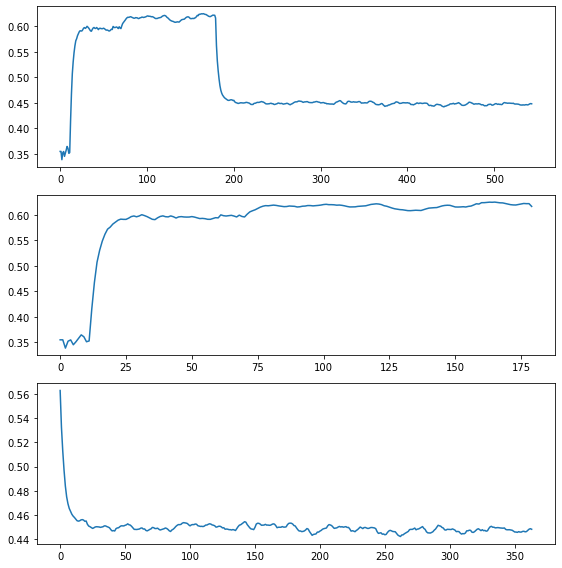

df_len_cnt: 179  H: 10  Total error: 10 Error check:  10677.486992976956 True
******CHANGE TIMES
ch_times :  [180] ch_num :  1 Resist :  0.606105329803109
df_len_cnt: 180  H: 10  Total error: 20 Error check:  49.3101941761713 True
******CHANGE TIMES
CHECK TIMES
[None, 180, None]
adf
180
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.369000       4.48      -20.0
1    2020-02-15 14:02     0.384997       4.48      -20.0
2     2020-02-16 2:01     0.366667       4.49      -20.0
3    2020-02-16 14:00     0.349508       4.48      -20.0
4     2020-02-17 2:00     0.235494       4.48      -20.0
..                ...          ...        ...        ...
175  2020-07-01 16:58     0.605131       4.49      -20.0
176   2020-07-02 4:58     0.605906       4.47      -20.0
177  2020-07-02 16:57     0.606472       4.47      -20.0
178   2020-07-03 4:57     0.606885       4.46      -20.0
179  2020-07-03 13:10     0.606105       4.47      -20.0

[180 rows x 4 columns]
adf


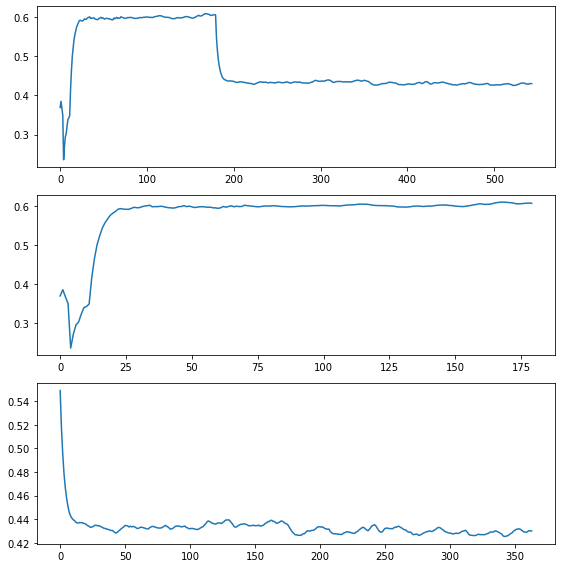

df_len_cnt: 179  H: 10  Total error: 10 Error check:  3786.125477081226 True
******CHANGE TIMES
ch_times :  [180] ch_num :  1 Resist :  0.5943397752060947
CHECK TIMES
[None, 180, None]
adf
180
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.379000       4.48      -20.0
1    2020-02-15 14:02     0.367002       4.48      -20.0
2     2020-02-16 2:01     0.374858       4.48      -20.0
3    2020-02-16 14:00     0.366461       4.49      -20.0
4     2020-02-17 2:00     0.362396       4.48      -20.0
..                ...          ...        ...        ...
175  2020-07-01 16:58     0.596706       4.49      -20.0
176   2020-07-02 4:58     0.597056       4.49      -20.0
177  2020-07-02 16:57     0.597311       4.49      -20.0
178   2020-07-03 4:57     0.596686       4.49      -20.0
179  2020-07-03 13:10     0.594340       4.50      -20.0

[180 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:17     0.49996

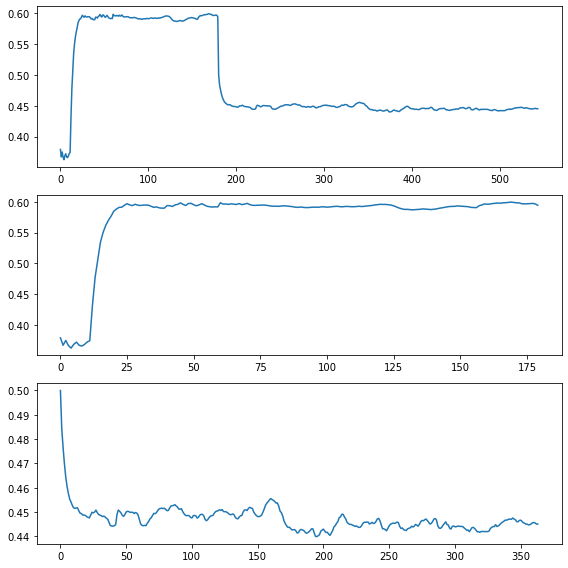

df_len_cnt: 180  H: 10  Total error: 10 Error check:  1295.3663344290326 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.6121813974068983
df_len_cnt: 181  H: 10  Total error: 20 Error check:  142.80076262716898 True
******CHANGE TIMES
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.330000       4.48      -20.0
1    2020-02-15 14:02     0.362995       4.42      -20.0
2     2020-02-16 2:01     0.364045       4.48      -20.0
3    2020-02-16 14:00     0.370558       4.48      -20.0
4     2020-02-17 2:00     0.371029       4.48      -20.0
..                ...          ...        ...        ...
176   2020-07-02 4:58     0.605121       4.49      -20.0
177  2020-07-02 16:57     0.605359       4.48      -20.0
178   2020-07-03 4:57     0.603911       4.48      -20.0
179  2020-07-03 13:10     0.604475       4.48      -20.0
180  2020-07-03 13:17     0.612181       4.48      -20.0

[181 rows x 4 columns]
a

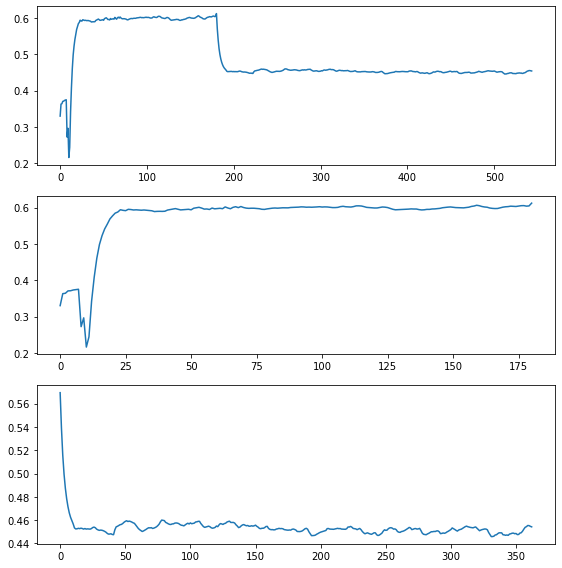

df_len_cnt: 180  H: 10  Total error: 10 Error check:  425.84670078604415 True
******CHANGE TIMES
ch_times :  [181] ch_num :  1 Resist :  0.631357316903285
df_len_cnt: 181  H: 10  Total error: 11 Error check:  250.4186740405606 True
******CHANGE TIMES
CHECK TIMES
[None, 181, None]
adf
181
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.356000       4.47      -20.0
1    2020-02-15 14:02     0.000059       4.47      -20.0
2     2020-02-16 2:01     0.189634       4.43      -20.0
3    2020-02-16 14:00     0.259305       4.48      -20.0
4     2020-02-17 2:00     0.297373       4.48      -20.0
..                ...          ...        ...        ...
176   2020-07-02 4:58     0.605436       4.49      -20.0
177  2020-07-02 16:57     0.605858       4.49      -20.0
178   2020-07-03 4:57     0.606437       4.49      -20.0
179  2020-07-03 13:10     0.606319       4.48      -20.0
180  2020-07-03 13:17     0.631357       4.49      -20.0

[181 rows x 4 columns]
adf

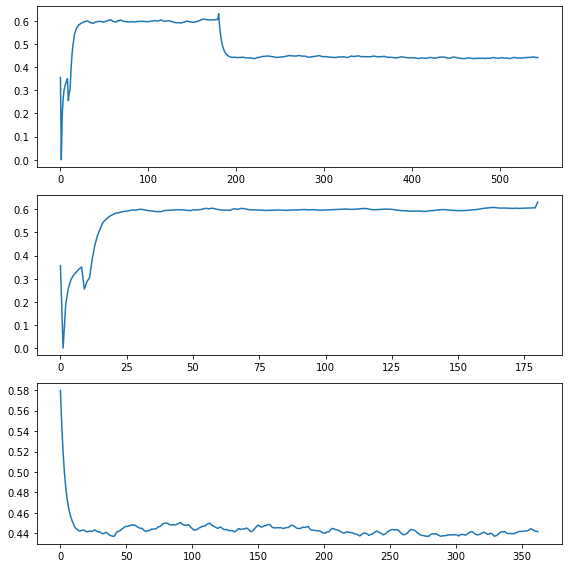

df_len_cnt: 178  H: 10  Total error: 10 Error check:  3120.244330192595 True
******CHANGE TIMES
ch_times :  [179] ch_num :  1 Resist :  0.613297188467872
CHECK TIMES
[None, 179, None]
adf
179
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.361000       4.42      -20.0
1    2020-02-15 14:02     0.327006       4.48      -20.0
2     2020-02-16 2:01     0.155729       4.48      -20.0
3    2020-02-16 14:00     0.095906       4.48      -20.0
4     2020-02-17 2:00     0.170640       4.48      -20.0
..                ...          ...        ...        ...
174  2020-07-01 16:58     0.616477       4.49      -20.0
175   2020-07-02 4:58     0.617159       4.49      -20.0
176  2020-07-02 16:57     0.617656       4.49      -20.0
177   2020-07-03 4:57     0.617479       4.49      -20.0
178  2020-07-03 13:10     0.613297       4.49      -20.0

[179 rows x 4 columns]
adf
None
              KeyTime  ResistValue  VoltValue  TempValue
0    2020-07-03 13:25     0.570532

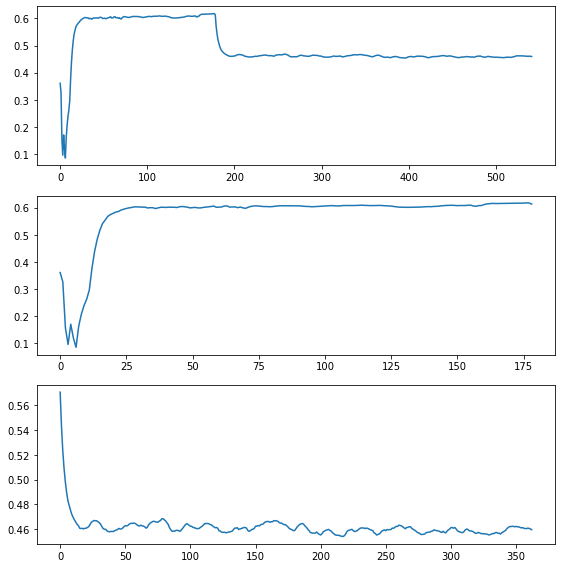

df_len_cnt: 178  H: 10  Total error: 10 Error check:  1792.6001388539066 True
******CHANGE TIMES
ch_times :  [179] ch_num :  1 Resist :  0.6045995933423263
df_len_cnt: 179  H: 10  Total error: 20 Error check:  63.088986871095685 True
******CHANGE TIMES
CHECK TIMES
[None, 179, None]
adf
179
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.000000       4.47      -20.0
1    2020-02-15 14:02     0.354941       4.49      -20.0
2     2020-02-16 2:01     0.352353       4.49      -20.0
3    2020-02-16 14:00     0.352602       4.49      -20.0
4     2020-02-17 2:00     0.353058       4.49      -20.0
..                ...          ...        ...        ...
174  2020-07-01 16:58     0.609603       4.49      -20.0
175   2020-07-02 4:58     0.609170       4.50      -20.0
176  2020-07-02 16:57     0.608854       4.48      -20.0
177   2020-07-03 4:57     0.608893       4.49      -20.0
178  2020-07-03 13:10     0.604600       4.49      -20.0

[179 rows x 4 columns]
a

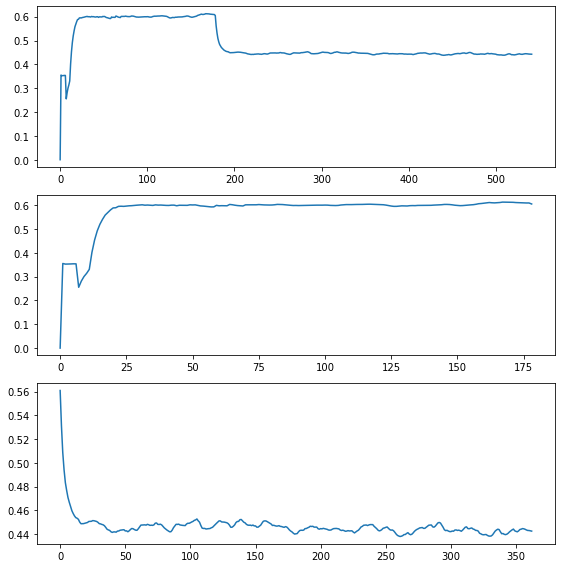

df_len_cnt: 178  H: 10  Total error: 10 Error check:  19670.188790958848 True
******CHANGE TIMES
ch_times :  [179] ch_num :  1 Resist :  0.6039049889033794
df_len_cnt: 179  H: 10  Total error: 20 Error check:  112.81503699932588 True
******CHANGE TIMES
CHECK TIMES
[None, 179, None]
adf
179
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.385000       4.49      -20.0
1    2020-02-15 14:02     0.385000       4.48      -20.0
2     2020-02-16 2:01     0.383429       4.49      -20.0
3    2020-02-16 14:00     0.382496       4.47      -20.0
4     2020-02-17 2:00     0.382334       4.47      -20.0
..                ...          ...        ...        ...
174  2020-07-01 16:58     0.604542       4.48      -20.0
175   2020-07-02 4:58     0.604126       4.49      -20.0
176  2020-07-02 16:57     0.603822       4.48      -20.0
177   2020-07-03 4:57     0.603870       4.48      -20.0
178  2020-07-03 13:10     0.603905       4.48      -20.0

[179 rows x 4 columns]
a

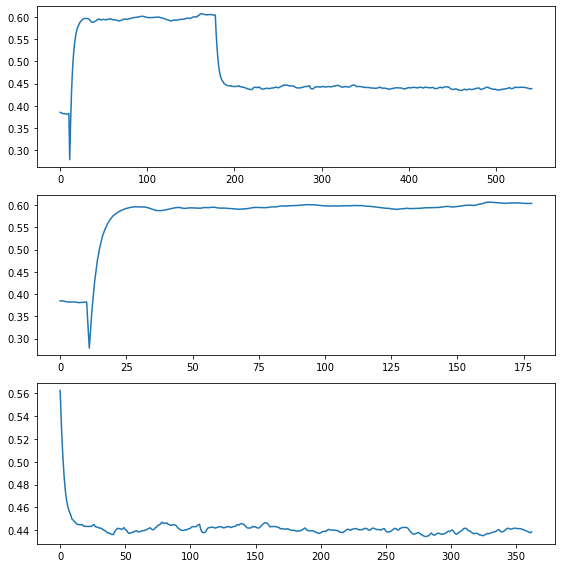

df_len_cnt: 178  H: 10  Total error: 10 Error check:  3121.146681387754 True
******CHANGE TIMES
ch_times :  [179] ch_num :  1 Resist :  0.5983469767066469
df_len_cnt: 179  H: 10  Total error: 20 Error check:  104.42452080956039 True
******CHANGE TIMES
CHECK TIMES
[None, 179, None]
adf
179
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.370000       4.49      -20.0
1    2020-02-15 14:02     0.367000       4.48      -20.0
2     2020-02-16 2:01     0.365953       4.48      -20.0
3    2020-02-16 14:00     0.367892       4.48      -20.0
4     2020-02-17 2:00     0.369558       4.48      -20.0
..                ...          ...        ...        ...
174  2020-07-01 16:58     0.602224       4.49      -20.0
175   2020-07-02 4:58     0.601353       4.49      -20.0
176  2020-07-02 16:57     0.600447       4.50      -20.0
177   2020-07-03 4:57     0.600326       4.49      -20.0
178  2020-07-03 13:10     0.598347       4.49      -20.0

[179 rows x 4 columns]
ad

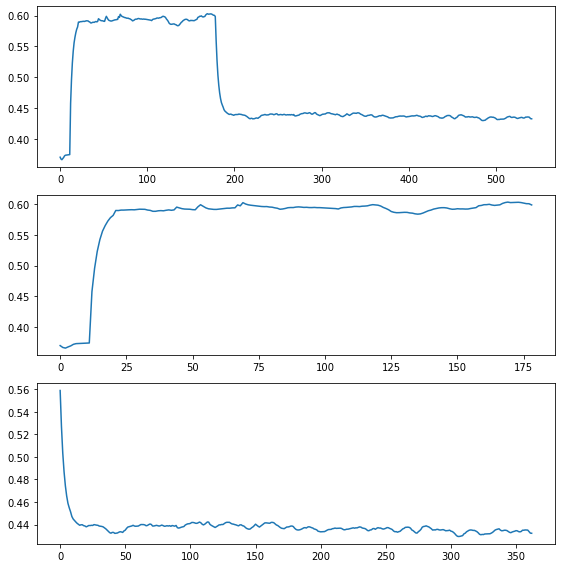

df_len_cnt: 178  H: 10  Total error: 10 Error check:  3348.7376292554927 True
******CHANGE TIMES
ch_times :  [179] ch_num :  1 Resist :  0.5980758688335943
df_len_cnt: 179  H: 10  Total error: 20 Error check:  100.89082669763042 True
******CHANGE TIMES
CHECK TIMES
[None, 179, None]
adf
179
              KeyTime  ResistValue  VoltValue  TempValue
0     2020-02-15 2:02     0.361000       4.43      -20.0
1    2020-02-15 14:02     0.363000       4.43      -20.0
2     2020-02-16 2:01     0.362476       4.43      -20.0
3    2020-02-16 14:00     0.362293       4.43      -20.0
4     2020-02-17 2:00     0.361545       4.43      -20.0
..                ...          ...        ...        ...
174  2020-07-01 16:58     0.600316       4.42      -20.0
175   2020-07-02 4:58     0.599960       4.42      -20.0
176  2020-07-02 16:57     0.599431       4.42      -20.0
177   2020-07-03 4:57     0.599585       4.42      -20.0
178  2020-07-03 13:10     0.598076       4.43      -20.0

[179 rows x 4 columns]
a

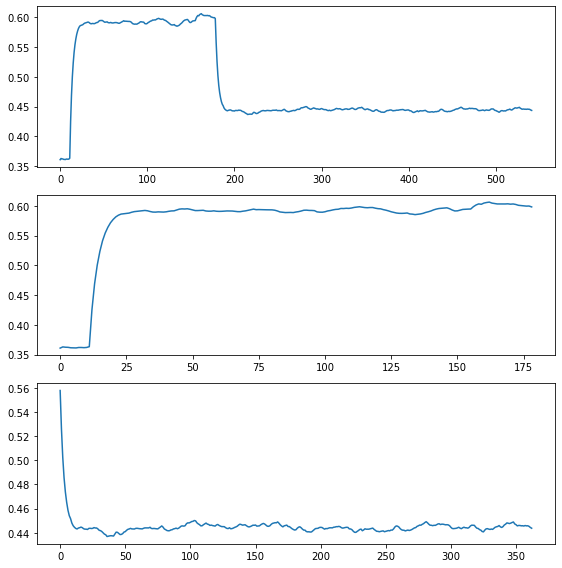

df_len_cnt: 16  H: 10  Total error: 20 Error check:  75.72277123926116 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.49035941498640584
df_len_cnt: 178  H: 10  Total error: 10 Error check:  15955.123949267903 True
******CHANGE TIMES
ch_times :  [17, 179] ch_num :  2 Resist :  0.6185456886976729
df_len_cnt: 179  H: 10  Total error: 20 Error check:  103.08234216208628 True
******CHANGE TIMES
df_len_cnt: 180  H: 10  Total error: 20 Error check:  9.223954249213097 False
CHECK TIMES
[None, 17, 179, None]
adf
17
             KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-15 2:02     0.000000       4.47      -20.0
1   2020-02-15 14:02     0.000000       4.47      -20.0
2    2020-02-16 2:01     0.000000       4.47      -20.0
3   2020-02-16 14:00     0.000000       4.48      -20.0
4    2020-02-17 2:00     0.000000       4.47      -20.0
5   2020-02-17 13:59     0.000000       4.46      -20.0
6    2020-02-18 1:59     0.000000       4.47      -20.0
7   2020-02-18 13:58  

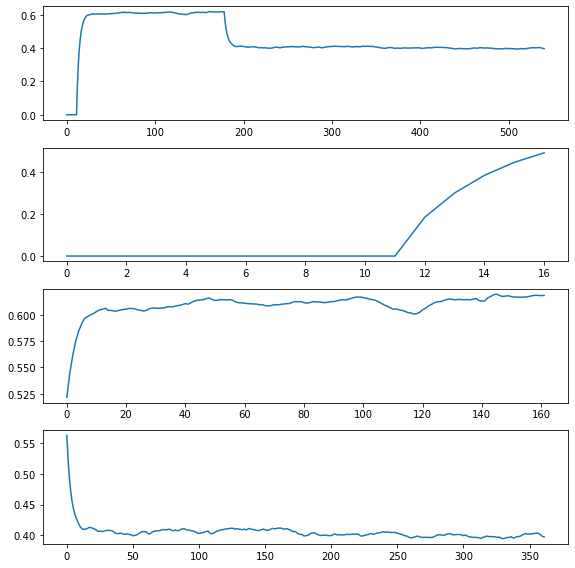

m2_s2_bank_add448e4063ae94cbec3c1f86f62fb2c__site_3471ad4b4665ee47a6a824c7bbc7911b
df_len_cnt: 218  H: 10  Total error: 10 Error check:  8944.780483716133 True
******CHANGE TIMES
ch_times :  [219] ch_num :  1 Resist :  0.3650426220671473
df_len_cnt: 220  H: 10  Total error: 11 Error check:  75.81271606781287 True
******CHANGE TIMES
CHECK TIMES
[None, 219, None]
adf
219
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.359000       4.47       25.4
1    2020-02-15 04:05:35     0.360000       4.47       25.3
2    2020-02-15 16:04:41     0.360000       4.48       25.3
3    2020-02-16 04:03:44     0.359616       4.48       25.5
4    2020-02-16 16:02:52     0.359089       4.47       25.5
..                   ...          ...        ...        ...
214  2020-06-29 16:58:43     0.364355       4.47       25.1
215  2020-06-30 04:58:17     0.365070       4.48       25.1
216  2020-06-30 16:57:51     0.365861       4.47       25.3
217  2020-07-01 04:57:12    

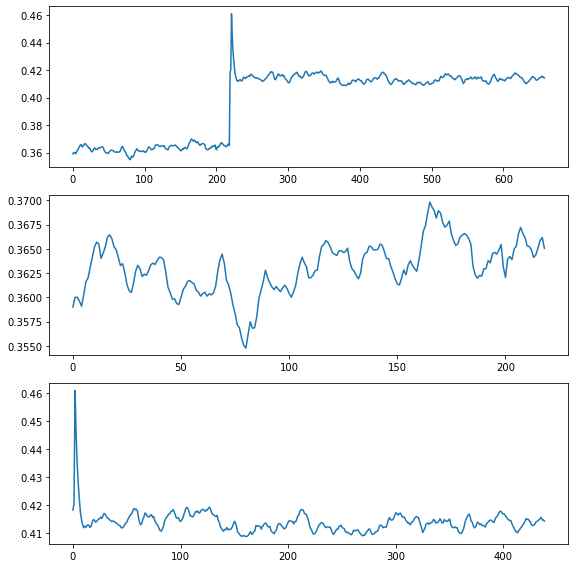

df_len_cnt: 216  H: 10  Total error: 10 Error check:  919.6443351494165 True
******CHANGE TIMES
ch_times :  [217] ch_num :  1 Resist :  0.39016122839045786
CHECK TIMES
[None, 217, None]
adf
217
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.378000       4.45      -20.0
1    2020-02-15 04:05:35     0.379000       4.46      -20.0
2    2020-02-15 16:04:41     0.376905       4.45      -20.0
3    2020-02-16 04:03:44     0.378478       4.46      -20.0
4    2020-02-16 16:02:52     0.379301       4.46      -20.0
..                   ...          ...        ...        ...
212  2020-06-29 16:58:43     0.385971       4.44      -20.0
213  2020-06-30 04:58:17     0.386519       4.44      -20.0
214  2020-06-30 16:57:51     0.388000       4.44      -20.0
215  2020-07-01 04:57:12     0.388000       4.46      -20.0
216  2020-07-01 11:53:27     0.390161       4.45      -20.0

[217 rows x 4 columns]
adf
None
                 KeyTime  ResistValue  VoltValue  Tem

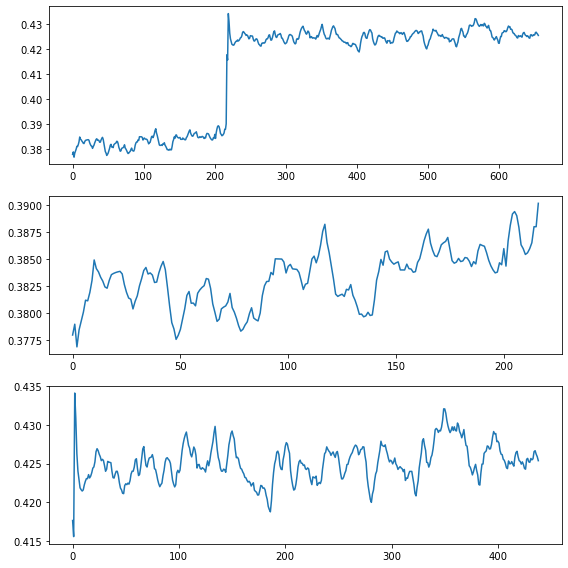

CHECK TIMES
[None, None]
adf
None
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.375000       4.45      -20.0
1    2020-02-15 04:05:35     0.371001       4.45      -20.0
2    2020-02-15 16:04:41     0.370477       4.46      -20.0
3    2020-02-16 04:03:44     0.369909       4.46      -20.0
4    2020-02-16 16:02:52     0.369939       4.45      -20.0
..                   ...          ...        ...        ...
650  2021-02-01 08:51:45     0.420418       4.46      -20.0
651  2021-02-01 20:51:10     0.420575       4.46      -20.0
652  2021-02-02 08:50:36     0.420420       4.46      -20.0
653  2021-02-02 20:50:08     0.419766       4.47      -20.0
654  2021-02-03 08:49:36     0.419559       4.46      -20.0

[655 rows x 4 columns]


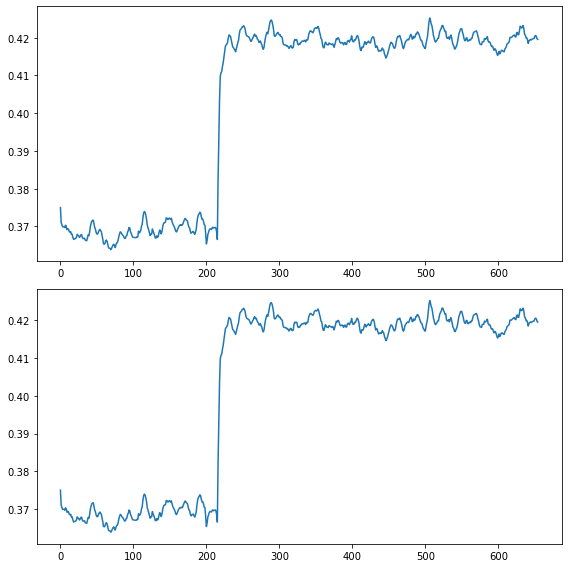

df_len_cnt: 215  H: 10  Total error: 10 Error check:  5033.911814510513 True
******CHANGE TIMES
ch_times :  [216] ch_num :  1 Resist :  0.3674051204060628
df_len_cnt: 217  H: 10  Total error: 10 Error check:  55.12979196564829 True
******CHANGE TIMES
CHECK TIMES
[None, 216, None]
adf
216
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.377000       4.50      -20.0
1    2020-02-15 04:05:35     0.374000       4.49      -20.0
2    2020-02-15 16:04:41     0.371905       4.48      -20.0
3    2020-02-16 04:03:44     0.371557       4.48      -20.0
4    2020-02-16 16:02:52     0.372028       4.47      -20.0
..                   ...          ...        ...        ...
211  2020-06-29 16:58:43     0.367957       4.46      -20.0
212  2020-06-30 04:58:17     0.368509       4.47      -20.0
213  2020-06-30 16:57:51     0.368912       4.47      -20.0
214  2020-07-01 04:57:12     0.368666       4.46      -20.0
215  2020-07-01 11:53:27     0.367405       4.46   

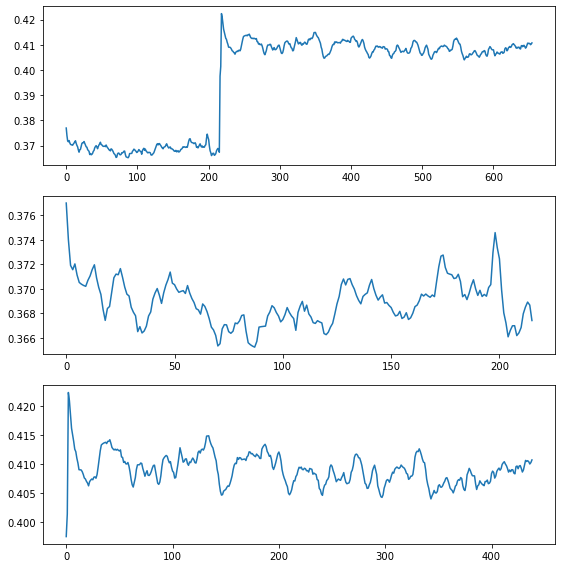

df_len_cnt: 215  H: 10  Total error: 10 Error check:  1805.2541280412174 True
******CHANGE TIMES
ch_times :  [216] ch_num :  1 Resist :  0.37242798614927347
CHECK TIMES
[None, 216, None]
adf
216
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.369000       4.46      -20.0
1    2020-02-15 04:05:35     0.368000       4.48      -20.0
2    2020-02-15 16:04:41     0.366953       4.46      -20.0
3    2020-02-16 04:03:44     0.367355       4.46      -20.0
4    2020-02-16 16:02:52     0.368544       4.47      -20.0
..                   ...          ...        ...        ...
211  2020-06-29 16:58:43     0.372217       4.47      -20.0
212  2020-06-30 04:58:17     0.371888       4.46      -20.0
213  2020-06-30 16:57:51     0.371378       4.47      -20.0
214  2020-07-01 04:57:12     0.370736       4.47      -20.0
215  2020-07-01 11:53:27     0.372428       4.47      -20.0

[216 rows x 4 columns]
adf
None
                 KeyTime  ResistValue  VoltValue  Te

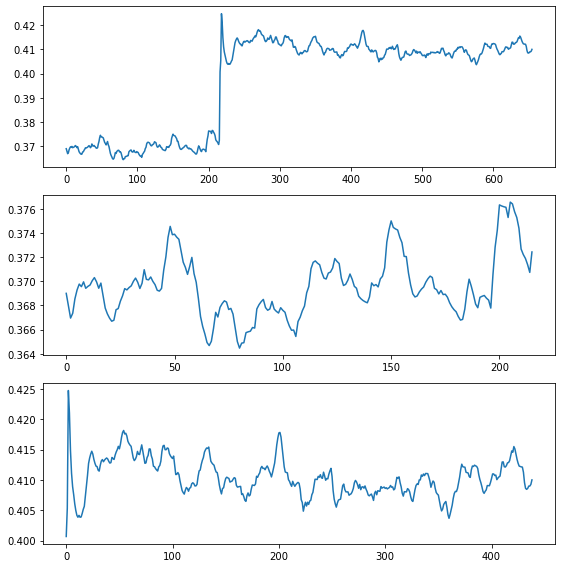

df_len_cnt: 215  H: 10  Total error: 10 Error check:  1720.505049433305 True
******CHANGE TIMES
ch_times :  [216] ch_num :  1 Resist :  0.3656855370827248
df_len_cnt: 217  H: 10  Total error: 11 Error check:  72.68795172294307 True
******CHANGE TIMES
CHECK TIMES
[None, 216, None]
adf
216
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.362000       4.47      -20.0
1    2020-02-15 04:05:35     0.365999       4.49      -20.0
2    2020-02-15 16:04:41     0.363905       4.48      -20.0
3    2020-02-16 04:03:44     0.363173       4.47      -20.0
4    2020-02-16 16:02:52     0.363443       4.47      -20.0
..                   ...          ...        ...        ...
211  2020-06-29 16:58:43     0.366101       4.47      -20.0
212  2020-06-30 04:58:17     0.366074       4.48      -20.0
213  2020-06-30 16:57:51     0.366054       4.47      -20.0
214  2020-07-01 04:57:12     0.366309       4.48      -20.0
215  2020-07-01 11:53:27     0.365686       4.47   

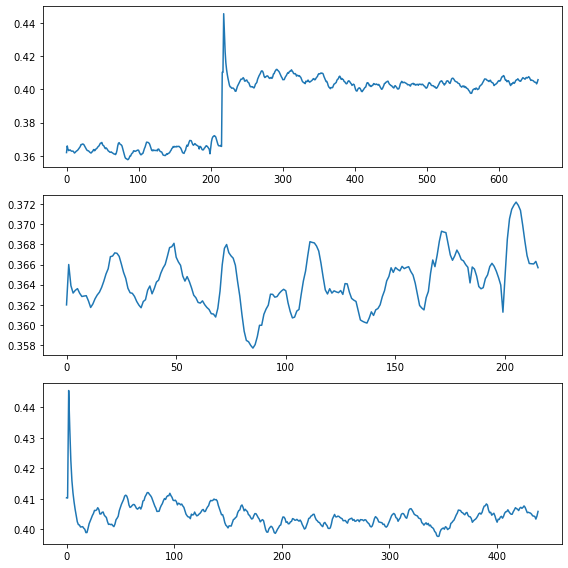

df_len_cnt: 215  H: 10  Total error: 10 Error check:  7783.41821642242 True
******CHANGE TIMES
ch_times :  [216] ch_num :  1 Resist :  0.38298339775582135
df_len_cnt: 217  H: 10  Total error: 13 Error check:  62.87855645894518 True
******CHANGE TIMES
CHECK TIMES
[None, 216, None]
adf
216
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.387000       4.51      -20.0
1    2020-02-15 04:05:35     0.395999       4.50      -20.0
2    2020-02-15 16:04:41     0.391809       4.50      -20.0
3    2020-02-16 04:03:44     0.389578       4.49      -20.0
4    2020-02-16 16:02:52     0.389063       4.51      -20.0
..                   ...          ...        ...        ...
211  2020-06-29 16:58:43     0.381180       4.50      -20.0
212  2020-06-30 04:58:17     0.382212       4.52      -20.0
213  2020-06-30 16:57:51     0.382695       4.50      -20.0
214  2020-07-01 04:57:12     0.382237       4.51      -20.0
215  2020-07-01 11:53:27     0.382983       4.50   

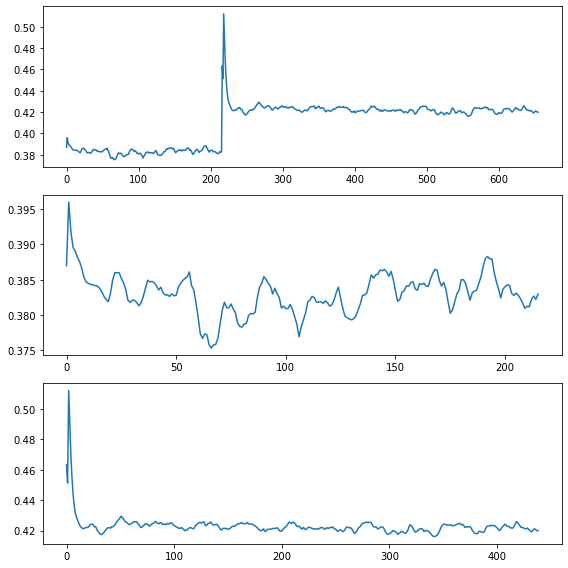

df_len_cnt: 215  H: 10  Total error: 10 Error check:  3553.5832023510843 True
******CHANGE TIMES
ch_times :  [216] ch_num :  1 Resist :  0.35985208425471066
df_len_cnt: 217  H: 10  Total error: 12 Error check:  73.29319061520002 True
******CHANGE TIMES
CHECK TIMES
[None, 216, None]
adf
216
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.358000       4.44      -20.0
1    2020-02-15 04:05:35     0.354001       4.43      -20.0
2    2020-02-15 16:04:41     0.352953       4.43      -20.0
3    2020-02-16 04:03:44     0.354123       4.43      -20.0
4    2020-02-16 16:02:52     0.355062       4.43      -20.0
..                   ...          ...        ...        ...
211  2020-06-29 16:58:43     0.358357       4.44      -20.0
212  2020-06-30 04:58:17     0.359341       4.44      -20.0
213  2020-06-30 16:57:51     0.360600       4.46      -20.0
214  2020-07-01 04:57:12     0.360167       4.44      -20.0
215  2020-07-01 11:53:27     0.359852       4.45 

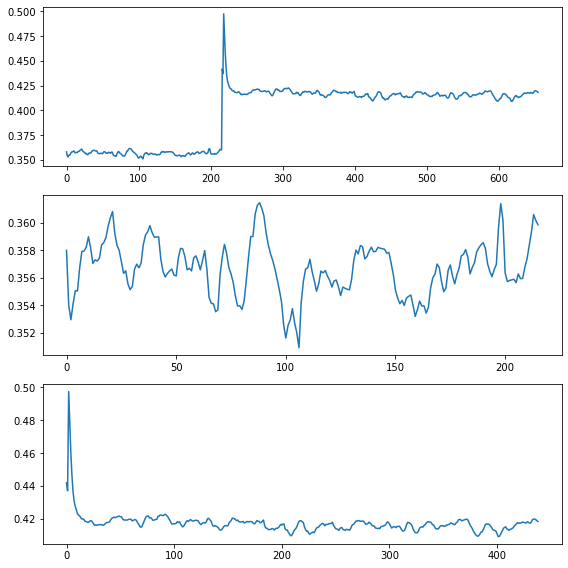

df_len_cnt: 215  H: 10  Total error: 7 Error check:  1696.2512245680089 True
df_len_cnt: 216  H: 10  Total error: 18 Error check:  18.915195019430268 False
df_len_cnt: 217  H: 10  Total error: 10 Error check:  186.1175441468475 True
******CHANGE TIMES
ch_times :  [218] ch_num :  1 Resist :  0.3497587950821241
df_len_cnt: 218  H: 10  Total error: 18 Error check:  56.98613619234312 True
******CHANGE TIMES
df_len_cnt: 219  H: 10  Total error: 20 Error check:  55.91439912841324 True
******CHANGE TIMES
df_len_cnt: 220  H: 10  Total error: 18 Error check:  144.818015593256 True
******CHANGE TIMES
df_len_cnt: 221  H: 10  Total error: 14 Error check:  155.39245714170315 True
******CHANGE TIMES
CHECK TIMES
[None, 218, None]
adf
218
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.365000       4.46      -20.0
1    2020-02-15 04:05:35     0.364000       4.46      -20.0
2    2020-02-15 16:04:41     0.363476       4.46      -20.0
3    2020-02-16 04:03:44   

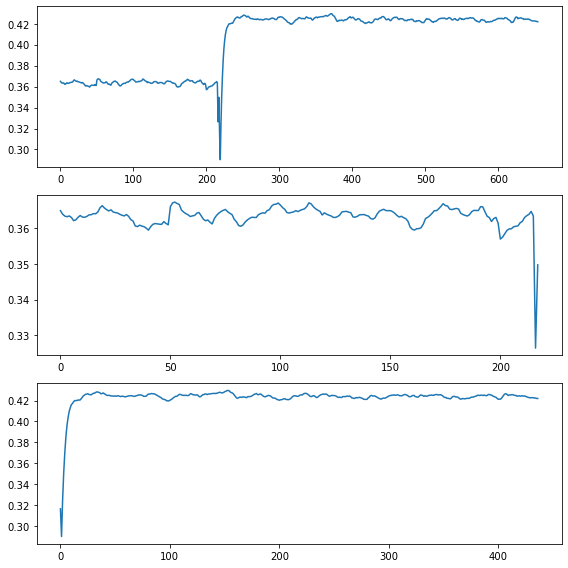

CHECK TIMES
[None, None]
adf
None
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.380000       4.45      -20.0
1    2020-02-15 04:05:35     0.373001       4.46      -20.0
2    2020-02-15 16:04:41     0.371953       4.45      -20.0
3    2020-02-16 04:03:44     0.373508       4.45      -20.0
4    2020-02-16 16:02:52     0.373668       4.46      -20.0
..                   ...          ...        ...        ...
650  2021-02-01 08:51:45     0.414170       4.43      -20.0
651  2021-02-01 20:51:10     0.414664       4.44      -20.0
652  2021-02-02 08:50:36     0.415295       4.44      -20.0
653  2021-02-02 20:50:08     0.416836       4.43      -20.0
654  2021-02-03 08:49:36     0.417691       4.43      -20.0

[655 rows x 4 columns]


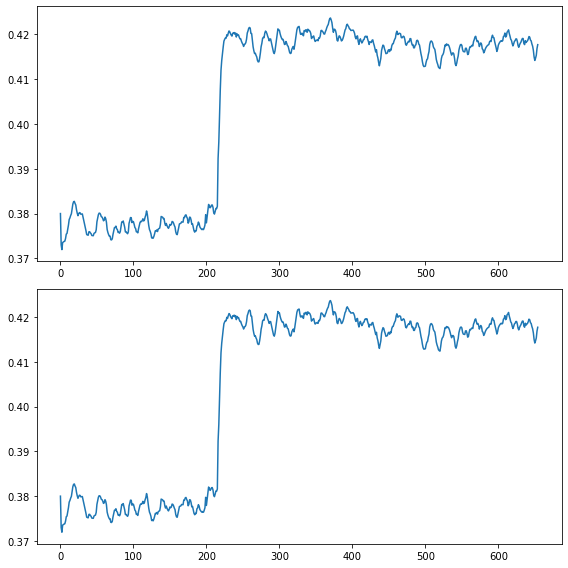

CHECK TIMES
[None, None]
adf
None
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.378000       4.42      -20.0
1    2020-02-15 04:05:35     0.375000       4.42      -20.0
2    2020-02-15 16:04:41     0.375000       4.43      -20.0
3    2020-02-16 04:03:44     0.374616       4.43      -20.0
4    2020-02-16 16:02:52     0.376372       4.43      -20.0
..                   ...          ...        ...        ...
650  2021-02-01 08:51:45     0.421359       4.43      -20.0
651  2021-02-01 20:51:10     0.422343       4.43      -20.0
652  2021-02-02 08:50:36     0.422520       4.43      -20.0
653  2021-02-02 20:50:08     0.422650       4.44      -20.0
654  2021-02-03 08:49:36     0.421934       4.43      -20.0

[655 rows x 4 columns]


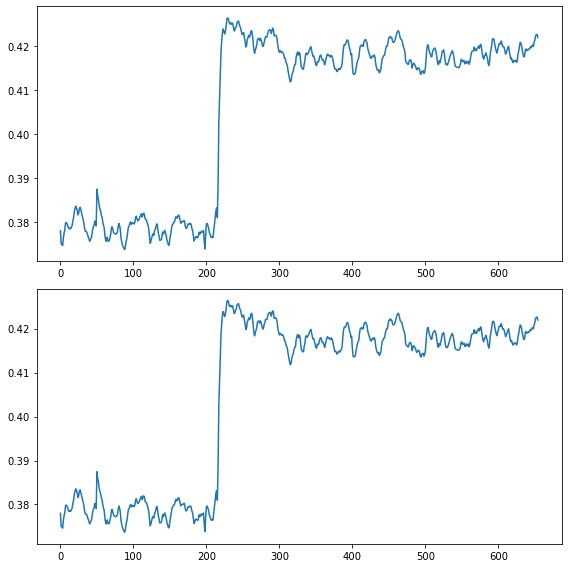

df_len_cnt: 215  H: 10  Total error: 10 Error check:  11201.262785737683 True
df_len_cnt: 217  H: 10  Total error: 16 Error check:  45.38644827637606 True
******CHANGE TIMES
ch_times :  [218] ch_num :  1 Resist :  0.47329537014691925
df_len_cnt: 218  H: 10  Total error: 20 Error check:  24.400496906885234 True
******CHANGE TIMES
CHECK TIMES
[None, 218, None]
adf
218
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.411000       4.43      -20.0
1    2020-02-15 04:05:35     0.413000       4.45      -20.0
2    2020-02-15 16:04:41     0.411429       4.45      -20.0
3    2020-02-16 04:03:44     0.410880       4.45      -20.0
4    2020-02-16 16:02:52     0.410593       4.46      -20.0
..                   ...          ...        ...        ...
213  2020-06-30 16:57:51     0.411619       4.46      -20.0
214  2020-07-01 04:57:12     0.412802       4.45      -20.0
215  2020-07-01 11:53:27     0.411775       4.46      -20.0
216  2020-07-01 11:59:29     0.

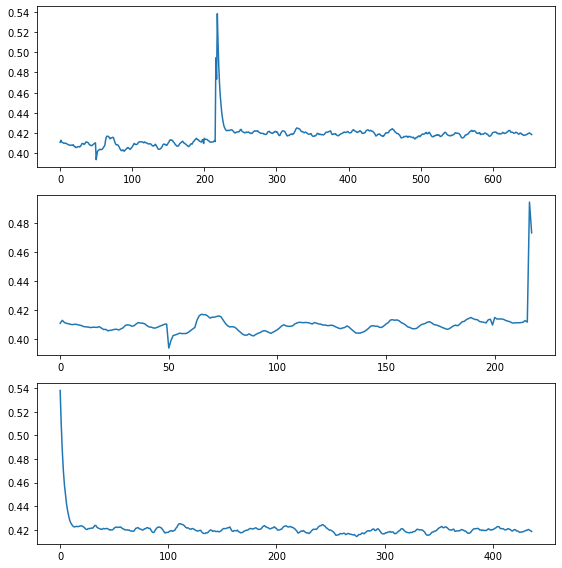

df_len_cnt: 215  H: 10  Total error: 10 Error check:  2445.0705879280144 True
******CHANGE TIMES
ch_times :  [216] ch_num :  1 Resist :  0.35206860485030156
CHECK TIMES
[None, 216, None]
adf
216
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.350000       4.47       24.5
1    2020-02-15 04:05:35     0.342001       4.46       24.4
2    2020-02-15 16:04:41     0.343572       4.46       24.5
3    2020-02-16 04:03:44     0.344505       4.46       24.4
4    2020-02-16 16:02:52     0.344666       4.46       24.4
..                   ...          ...        ...        ...
211  2020-06-29 16:58:43     0.349756       4.47       24.0
212  2020-06-30 04:58:17     0.350092       4.47       24.0
213  2020-06-30 16:57:51     0.350607       4.48       24.2
214  2020-07-01 04:57:12     0.350984       4.48       24.0
215  2020-07-01 11:53:27     0.352069       4.48       24.2

[216 rows x 4 columns]
adf
None
                 KeyTime  ResistValue  VoltValue  Te

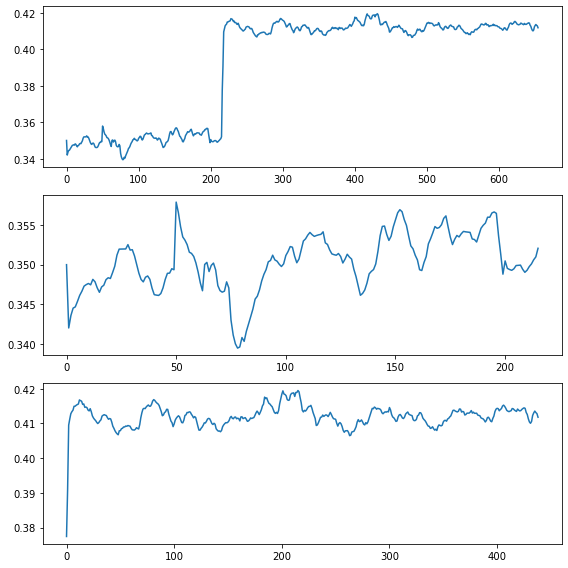

CHECK TIMES
[None, None]
adf
None
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.389000       4.53      -20.0
1    2020-02-15 04:05:35     0.381001       4.52      -20.0
2    2020-02-15 16:04:41     0.383096       4.52      -20.0
3    2020-02-16 04:03:44     0.384211       4.51      -20.0
4    2020-02-16 16:02:52     0.384469       4.51      -20.0
..                   ...          ...        ...        ...
650  2021-02-01 08:51:45     0.415162       4.48      -20.0
651  2021-02-01 20:51:10     0.415388       4.48      -20.0
652  2021-02-02 08:50:36     0.415013       4.49      -20.0
653  2021-02-02 20:50:08     0.414469       4.50      -20.0
654  2021-02-03 08:49:36     0.413802       4.49      -20.0

[655 rows x 4 columns]


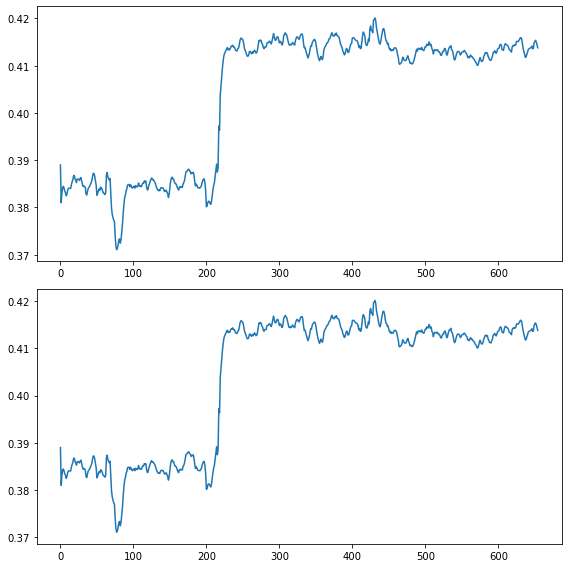

CHECK TIMES
[None, None]
adf
None
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.380000       4.49      -20.0
1    2020-02-15 04:05:35     0.382000       4.48      -20.0
2    2020-02-15 16:04:41     0.380952       4.47      -20.0
3    2020-02-16 04:03:44     0.380586       4.47      -20.0
4    2020-02-16 16:02:52     0.380721       4.48      -20.0
..                   ...          ...        ...        ...
650  2021-02-01 08:51:45     0.419275       4.51      -20.0
651  2021-02-01 20:51:10     0.419471       4.49      -20.0
652  2021-02-02 08:50:36     0.418804       4.50      -20.0
653  2021-02-02 20:50:08     0.418316       4.50      -20.0
654  2021-02-03 08:49:36     0.417961       4.50      -20.0

[655 rows x 4 columns]


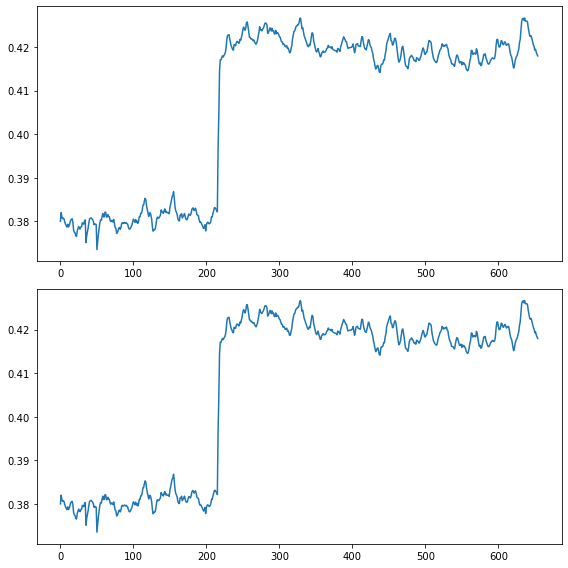

df_len_cnt: 215  H: 10  Total error: 10 Error check:  1480.6741336884575 True
******CHANGE TIMES
ch_times :  [216] ch_num :  1 Resist :  0.36050645001063714
CHECK TIMES
[None, 216, None]
adf
216
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.354000       4.50      -20.0
1    2020-02-15 04:05:35     0.356000       4.50      -20.0
2    2020-02-15 16:04:41     0.354952       4.51      -20.0
3    2020-02-16 04:03:44     0.354971       4.48      -20.0
4    2020-02-16 16:02:52     0.354328       4.49      -20.0
..                   ...          ...        ...        ...
211  2020-06-29 16:58:43     0.357139       4.50      -20.0
212  2020-06-30 04:58:17     0.357372       4.51      -20.0
213  2020-06-30 16:57:51     0.357812       4.50      -20.0
214  2020-07-01 04:57:12     0.359213       4.50      -20.0
215  2020-07-01 11:53:27     0.360506       4.50      -20.0

[216 rows x 4 columns]
adf
None
                 KeyTime  ResistValue  VoltValue  Te

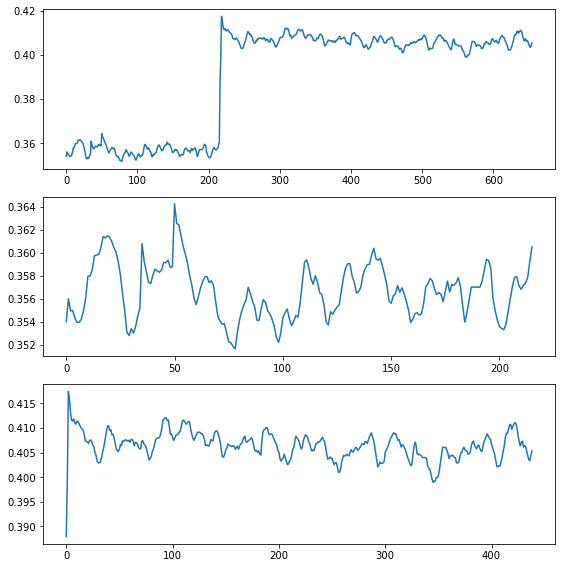

CHECK TIMES
[None, None]
adf
None
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.378000       4.49      -20.0
1    2020-02-15 04:05:35     0.379000       4.46      -20.0
2    2020-02-15 16:04:41     0.376905       4.45      -20.0
3    2020-02-16 04:03:44     0.375405       4.47      -20.0
4    2020-02-16 16:02:52     0.375925       4.48      -20.0
..                   ...          ...        ...        ...
649  2021-02-01 08:51:45     0.406317       4.47      -20.0
650  2021-02-01 20:51:10     0.407042       4.47      -20.0
651  2021-02-02 08:50:36     0.407301       4.46      -20.0
652  2021-02-02 20:50:08     0.408570       4.47      -20.0
653  2021-02-03 08:49:36     0.410307       4.47      -20.0

[654 rows x 4 columns]


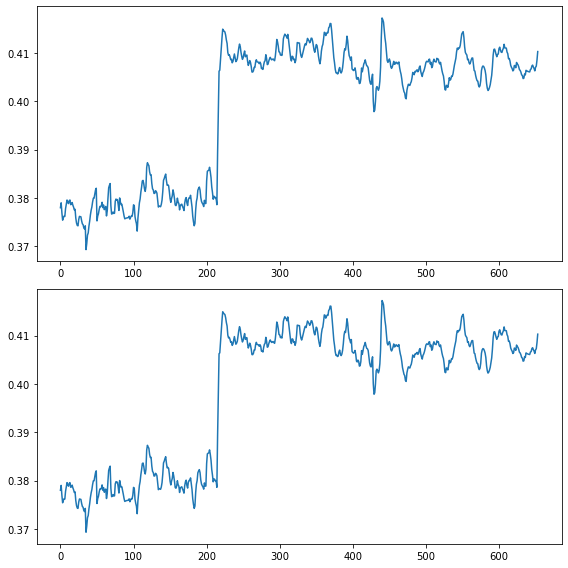

df_len_cnt: 215  H: 10  Total error: 10 Error check:  9698.999150917125 True
******CHANGE TIMES
ch_times :  [216] ch_num :  1 Resist :  0.36164053031657506
df_len_cnt: 217  H: 10  Total error: 13 Error check:  56.728731403672484 True
******CHANGE TIMES
CHECK TIMES
[None, 216, None]
adf
216
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.357000       4.49      -20.0
1    2020-02-15 04:05:35     0.362999       4.48      -20.0
2    2020-02-15 16:04:41     0.362476       4.49      -20.0
3    2020-02-16 04:03:44     0.360756       4.48      -20.0
4    2020-02-16 16:02:52     0.360510       4.49      -20.0
..                   ...          ...        ...        ...
211  2020-06-29 16:58:43     0.362411       4.48      -20.0
212  2020-06-30 04:58:17     0.362841       4.48      -20.0
213  2020-06-30 16:57:51     0.362614       4.49      -20.0
214  2020-07-01 04:57:12     0.362988       4.48      -20.0
215  2020-07-01 11:53:27     0.361641       4.48 

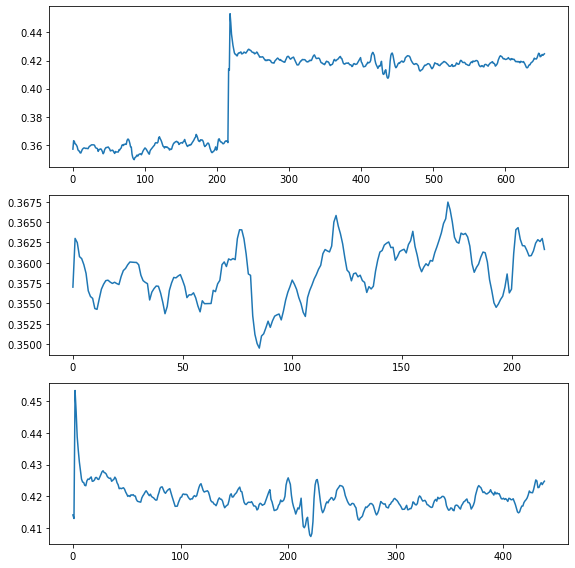

df_len_cnt: 215  H: 10  Total error: 10 Error check:  2841.8427646529076 True
******CHANGE TIMES
ch_times :  [216] ch_num :  1 Resist :  0.3558787416863037
df_len_cnt: 217  H: 10  Total error: 14 Error check:  68.4025923326356 True
******CHANGE TIMES
df_len_cnt: 218  H: 10  Total error: 20 Error check:  46.40466831761169 True
******CHANGE TIMES
CHECK TIMES
[None, 216, None]
adf
216
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.362000       4.45      -20.0
1    2020-02-15 04:05:35     0.362000       4.44      -20.0
2    2020-02-15 16:04:41     0.359905       4.46      -20.0
3    2020-02-16 04:03:44     0.358789       4.46      -20.0
4    2020-02-16 16:02:52     0.357879       4.45      -20.0
..                   ...          ...        ...        ...
211  2020-06-29 16:58:43     0.352211       4.46      -20.0
212  2020-06-30 04:58:17     0.351884       4.47      -20.0
213  2020-06-30 16:57:51     0.352455       4.45      -20.0
214  2020-07-01

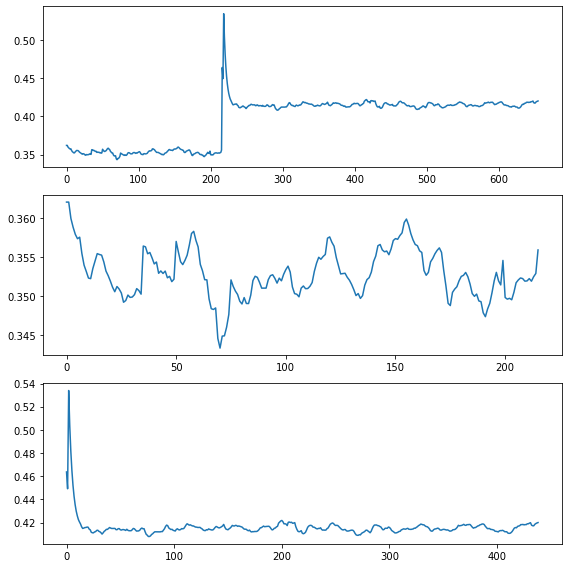

CHECK TIMES
[None, None]
adf
None
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.377000       4.46      -20.0
1    2020-02-15 04:05:35     0.379000       4.45      -20.0
2    2020-02-15 16:04:41     0.377952       4.46      -20.0
3    2020-02-16 04:03:44     0.376818       4.46      -20.0
4    2020-02-16 16:02:52     0.376225       4.47      -20.0
..                   ...          ...        ...        ...
649  2021-02-01 08:51:45     0.422557       4.47      -20.0
650  2021-02-01 20:51:10     0.422947       4.45      -20.0
651  2021-02-02 08:50:36     0.422691       4.45      -20.0
652  2021-02-02 20:50:08     0.422234       4.47      -20.0
653  2021-02-03 08:49:36     0.421631       4.45      -20.0

[654 rows x 4 columns]


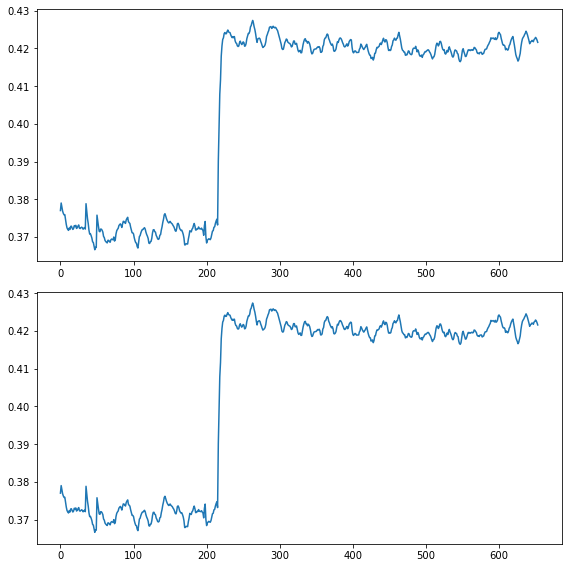

CHECK TIMES
[None, None]
adf
None
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.400000       4.41      -20.0
1    2020-02-15 04:05:35     0.404999       4.41      -20.0
2    2020-02-15 16:04:41     0.406047       4.42      -20.0
3    2020-02-16 04:03:44     0.406029       4.42      -20.0
4    2020-02-16 16:02:52     0.405367       4.42      -20.0
..                   ...          ...        ...        ...
650  2021-02-01 08:51:45     0.408304       4.43      -20.0
651  2021-02-01 20:51:10     0.408762       4.44      -20.0
652  2021-02-02 08:50:36     0.409097       4.43      -20.0
653  2021-02-02 20:50:08     0.409071       4.43      -20.0
654  2021-02-03 08:49:36     0.409322       4.44      -20.0

[655 rows x 4 columns]


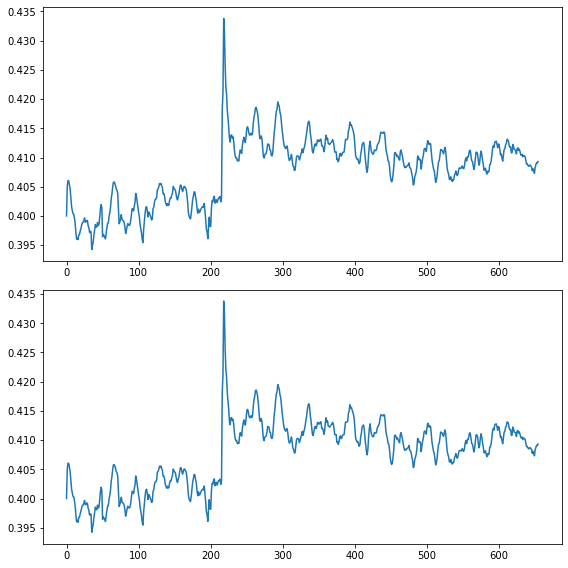

df_len_cnt: 118  H: 10  Total error: 3 Error check:  209.19085853008878 True
df_len_cnt: 214  H: 10  Total error: 5 Error check:  1674.9136294465898 True
df_len_cnt: 215  H: 10  Total error: 19 Error check:  21.82875500929224 True
******CHANGE TIMES
ch_times :  [216] ch_num :  1 Resist :  0.3311131883463229
df_len_cnt: 216  H: 10  Total error: 19 Error check:  7.9883176860670435 False
df_len_cnt: 217  H: 10  Total error: 20 Error check:  11.465426674902494 False
df_len_cnt: 218  H: 10  Total error: 19 Error check:  43.03098770171489 True
******CHANGE TIMES
df_len_cnt: 427  H: 10  Total error: 1 Error check:  562.450375986721 True
CHECK TIMES
[None, 216, None]
adf
216
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.387000       4.48      -20.0
1    2020-02-15 04:05:35     0.380001       4.48      -20.0
2    2020-02-15 16:04:41     0.381048       4.49      -20.0
3    2020-02-16 04:03:44     0.380645       4.48      -20.0
4    2020-02-16 16:02:52

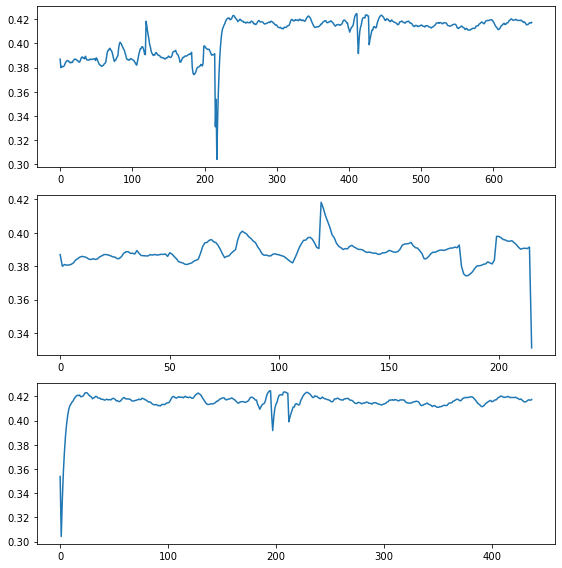

df_len_cnt: 214  H: 10  Total error: 10 Error check:  2091.255852440247 True
******CHANGE TIMES
ch_times :  [215] ch_num :  1 Resist :  0.3876661747321049
df_len_cnt: 215  H: 10  Total error: 18 Error check:  55.48846860313002 True
******CHANGE TIMES
df_len_cnt: 216  H: 10  Total error: 18 Error check:  47.20873454207341 True
******CHANGE TIMES
df_len_cnt: 217  H: 10  Total error: 20 Error check:  24.56132193990509 True
******CHANGE TIMES
df_len_cnt: 218  H: 10  Total error: 19 Error check:  19.32270216737319 False
df_len_cnt: 219  H: 10  Total error: 18 Error check:  19.874606042694598 False
CHECK TIMES
[None, 215, None]
adf
215
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.386000       4.47      -20.0
1    2020-02-15 04:05:35     0.378001       4.48      -20.0
2    2020-02-15 16:04:41     0.380619       4.48      -20.0
3    2020-02-16 04:03:44     0.381150       4.47      -20.0
4    2020-02-16 16:02:52     0.382732       4.47      -20.0
..

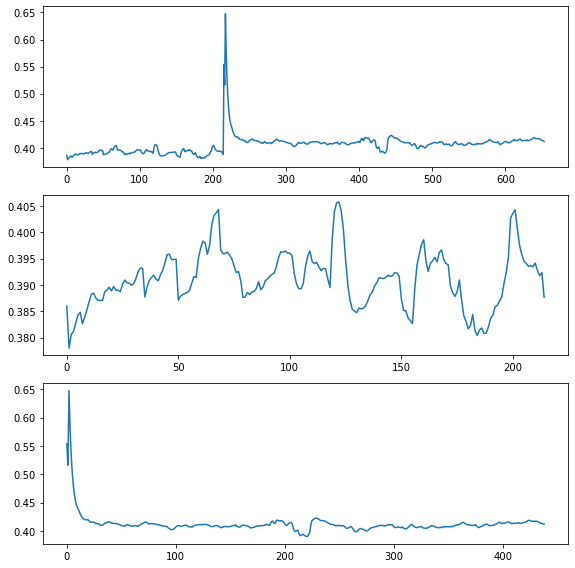

df_len_cnt: 197  H: 10  Total error: 1 Error check:  89.49033120625901 True
df_len_cnt: 213  H: 10  Total error: 10 Error check:  2621.6406219927394 True
******CHANGE TIMES
ch_times :  [214] ch_num :  1 Resist :  0.36191277119951226
df_len_cnt: 214  H: 10  Total error: 19 Error check:  63.99471314687693 True
******CHANGE TIMES
df_len_cnt: 215  H: 10  Total error: 19 Error check:  56.58217846112882 True
******CHANGE TIMES
df_len_cnt: 216  H: 10  Total error: 20 Error check:  32.604681105716935 True
******CHANGE TIMES
df_len_cnt: 217  H: 10  Total error: 20 Error check:  29.33950446306722 True
******CHANGE TIMES
df_len_cnt: 218  H: 10  Total error: 19 Error check:  28.69614948863688 True
******CHANGE TIMES
df_len_cnt: 219  H: 10  Total error: 19 Error check:  35.805083381423714 True
******CHANGE TIMES
CHECK TIMES
[None, 214, None]
adf
214
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.369000       4.48      -20.0
1    2020-02-15 04:05:35     0.

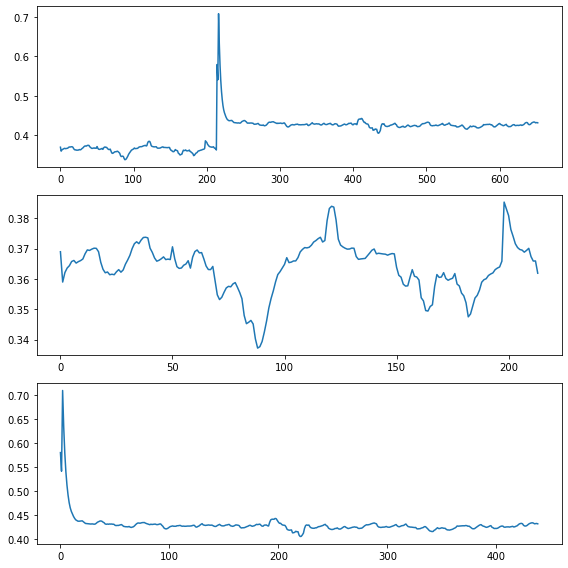

df_len_cnt: 214  H: 10  Total error: 10 Error check:  5431.393424884449 True
******CHANGE TIMES
ch_times :  [215] ch_num :  1 Resist :  0.37785615838553704
CHECK TIMES
[None, 215, None]
adf
215
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.379000       4.52       20.7
1    2020-02-15 04:05:35     0.376000       4.50       21.3
2    2020-02-15 16:04:41     0.375476       4.50       21.3
3    2020-02-16 04:03:44     0.375293       4.49       20.6
4    2020-02-16 16:02:52     0.376176       4.51       20.2
..                   ...          ...        ...        ...
210  2020-06-29 16:58:43     0.378854       4.51       19.8
211  2020-06-30 04:58:17     0.378893       4.50       19.8
212  2020-06-30 16:57:51     0.378922       4.51       19.9
213  2020-07-01 04:57:12     0.380024       4.50       19.8
214  2020-07-01 11:53:27     0.377856       4.50       20.2

[215 rows x 4 columns]
adf
None
                 KeyTime  ResistValue  VoltValue  Tem

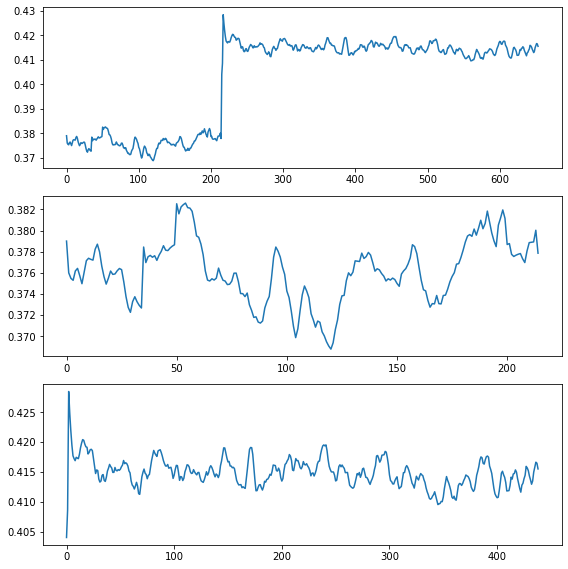

CHECK TIMES
[None, None]
adf
None
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.392000       4.54      -20.0
1    2020-02-15 04:05:35     0.392000       4.51      -20.0
2    2020-02-15 16:04:41     0.392524       4.51      -20.0
3    2020-02-16 04:03:44     0.393091       4.50      -20.0
4    2020-02-16 16:02:52     0.395019       4.52      -20.0
..                   ...          ...        ...        ...
649  2021-02-01 08:51:45     0.421889       4.52      -20.0
650  2021-02-01 20:51:10     0.422999       4.51      -20.0
651  2021-02-02 08:50:36     0.422729       4.52      -20.0
652  2021-02-02 20:50:08     0.422262       4.52      -20.0
653  2021-02-03 08:49:36     0.422191       4.50      -20.0

[654 rows x 4 columns]


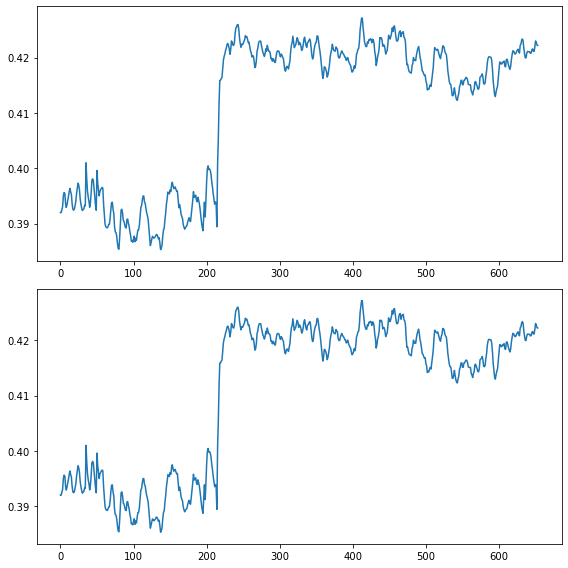

df_len_cnt: 198  H: 10  Total error: 1 Error check:  174.5314640784494 True
df_len_cnt: 214  H: 10  Total error: 10 Error check:  2323.3004608170254 True
df_len_cnt: 215  H: 10  Total error: 18 Error check:  45.81853081816536 True
******CHANGE TIMES
ch_times :  [216] ch_num :  1 Resist :  0.5815227566328983
df_len_cnt: 216  H: 10  Total error: 18 Error check:  31.747803024536626 True
******CHANGE TIMES
df_len_cnt: 217  H: 10  Total error: 20 Error check:  15.506165110019554 False
df_len_cnt: 218  H: 10  Total error: 19 Error check:  3.203865652433676 False
df_len_cnt: 219  H: 10  Total error: 18 Error check:  0.8025572001268407 False
df_len_cnt: 220  H: 10  Total error: 19 Error check:  13.025099279131599 False
CHECK TIMES
[None, 216, None]
adf
216
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.423000       4.49      -20.0
1    2020-02-15 04:05:35     0.410002       4.49      -20.0
2    2020-02-15 16:04:41     0.409477       4.50      -20.0
3

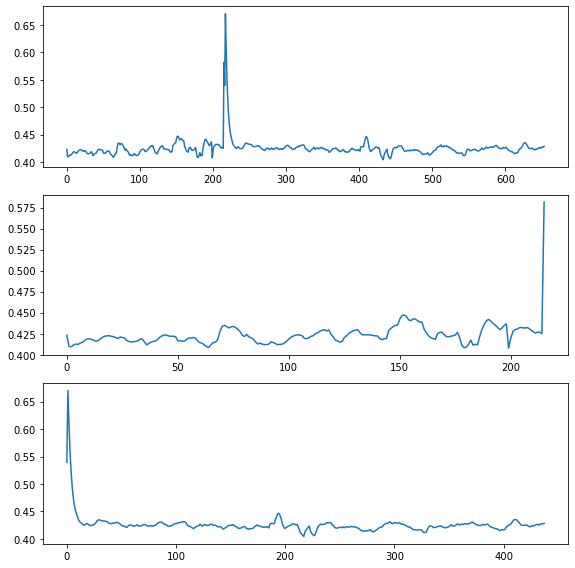

df_len_cnt: 160  H: 10  Total error: 10 Error check:  1173.0327453437435 True
******CHANGE TIMES
ch_times :  [161] ch_num :  1 Resist :  0.43784176571975547
df_len_cnt: 161  H: 10  Total error: 17 Error check:  48.74954694544183 True
******CHANGE TIMES
df_len_cnt: 182  H: 10  Total error: 4 Error check:  545.0868040083132 True
df_len_cnt: 198  H: 10  Total error: 3 Error check:  108.07950523660375 True
df_len_cnt: 215  H: 10  Total error: 5 Error check:  418.38734835571734 True
CHECK TIMES
[None, 161, None]
adf
161
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.403000       4.47      -20.0
1    2020-02-15 04:05:35     0.409999       4.47      -20.0
2    2020-02-15 16:04:41     0.409999       4.46      -20.0
3    2020-02-16 04:03:44     0.410768       4.47      -20.0
4    2020-02-16 16:02:52     0.411496       4.47      -20.0
..                   ...          ...        ...        ...
156  2020-06-03 03:00:00     0.436464       4.46      -20.0

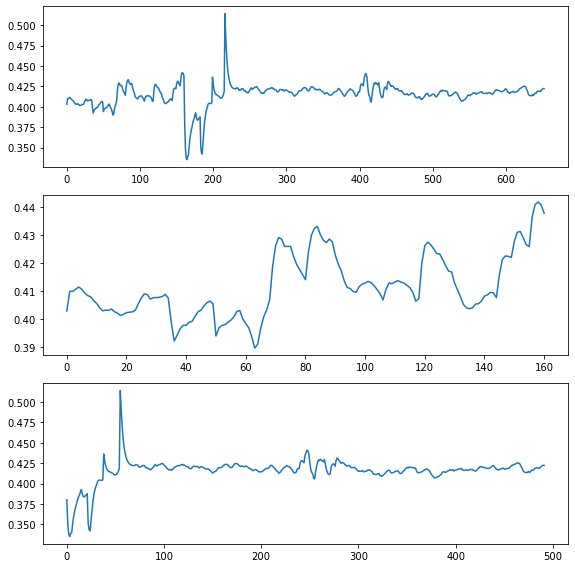

df_len_cnt: 198  H: 10  Total error: 3 Error check:  956.4070704323128 True
df_len_cnt: 214  H: 10  Total error: 10 Error check:  2571.5941336522073 True
******CHANGE TIMES
ch_times :  [215] ch_num :  1 Resist :  0.37590086511095155
df_len_cnt: 215  H: 10  Total error: 20 Error check:  224.79087430739716 True
******CHANGE TIMES
df_len_cnt: 216  H: 10  Total error: 20 Error check:  37.55758114973464 True
******CHANGE TIMES
df_len_cnt: 217  H: 10  Total error: 20 Error check:  36.9995868615985 True
******CHANGE TIMES
df_len_cnt: 218  H: 10  Total error: 20 Error check:  38.31541639308334 True
******CHANGE TIMES
CHECK TIMES
[None, 215, None]
adf
215
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.378000       4.47      -20.0
1    2020-02-15 04:05:35     0.377000       4.47      -20.0
2    2020-02-15 16:04:41     0.377524       4.48      -20.0
3    2020-02-16 04:03:44     0.377323       4.48      -20.0
4    2020-02-16 16:02:52     0.377544       4

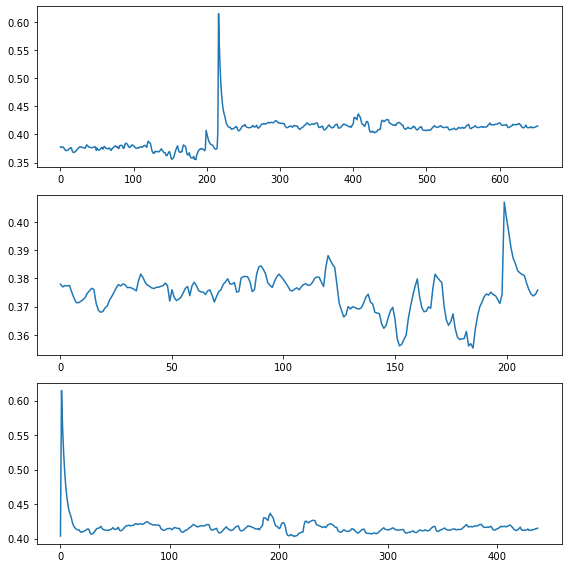

CHECK TIMES
[None, None]
adf
None
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.392000       4.45      -20.0
1    2020-02-15 04:05:35     0.385001       4.46      -20.0
2    2020-02-15 16:04:41     0.386048       4.46      -20.0
3    2020-02-16 04:03:44     0.385645       4.46      -20.0
4    2020-02-16 16:02:52     0.387066       4.46      -20.0
..                   ...          ...        ...        ...
646  2021-02-01 08:51:45     0.426988       4.46      -20.0
647  2021-02-01 20:51:10     0.426181       4.45      -20.0
648  2021-02-02 08:50:36     0.426672       4.46      -20.0
649  2021-02-02 20:50:08     0.425950       4.47      -20.0
650  2021-02-03 08:49:36     0.425964       4.47      -20.0

[651 rows x 4 columns]


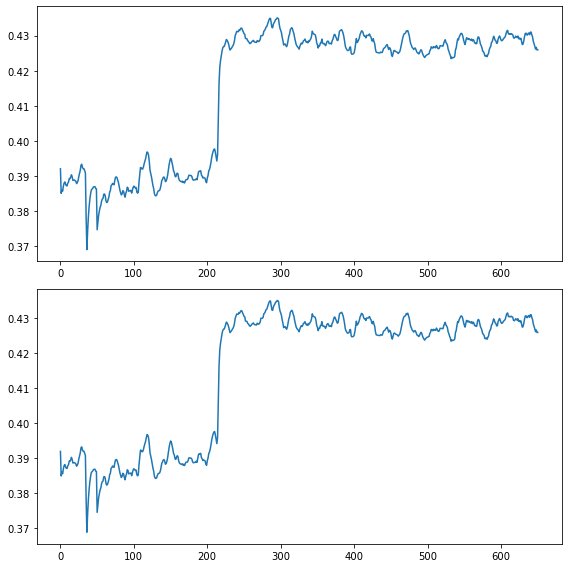

df_len_cnt: 213  H: 10  Total error: 10 Error check:  3854.569560564399 True
******CHANGE TIMES
ch_times :  [214] ch_num :  1 Resist :  0.35117033036022566
df_len_cnt: 214  H: 10  Total error: 10 Error check:  156.0263538251762 True
******CHANGE TIMES
CHECK TIMES
[None, 214, None]
adf
214
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.347000       4.43      -20.0
1    2020-02-15 04:05:35     0.344000       4.43      -20.0
2    2020-02-15 16:04:41     0.344000       4.43      -20.0
3    2020-02-16 04:03:44     0.345537       4.43      -20.0
4    2020-02-16 16:02:52     0.347645       4.44      -20.0
..                   ...          ...        ...        ...
209  2020-06-29 16:58:43     0.353021       4.44      -20.0
210  2020-06-30 04:58:17     0.353016       4.43      -20.0
211  2020-06-30 16:57:51     0.352471       4.44      -20.0
212  2020-07-01 04:57:12     0.352344       4.44      -20.0
213  2020-07-01 11:53:27     0.351170       4.43  

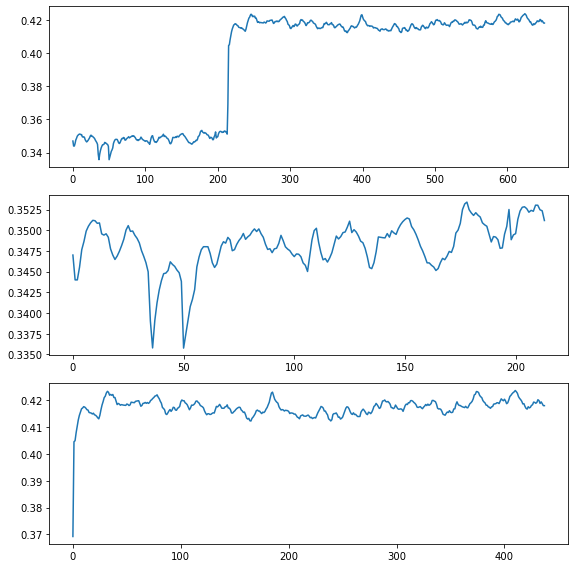

df_len_cnt: 198  H: 10  Total error: 3 Error check:  129.5591934297038 True
df_len_cnt: 214  H: 10  Total error: 10 Error check:  6882.53074056812 True
******CHANGE TIMES
ch_times :  [215] ch_num :  1 Resist :  0.3311454357239856
df_len_cnt: 215  H: 10  Total error: 20 Error check:  485.33819100414786 True
******CHANGE TIMES
df_len_cnt: 216  H: 10  Total error: 20 Error check:  50.55703980363992 True
******CHANGE TIMES
df_len_cnt: 217  H: 10  Total error: 20 Error check:  52.182549851224515 True
******CHANGE TIMES
df_len_cnt: 218  H: 10  Total error: 20 Error check:  55.36809156736048 True
******CHANGE TIMES
CHECK TIMES
[None, 215, None]
adf
215
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.331000       4.44      -20.0
1    2020-02-15 04:05:35     0.329000       4.43      -20.0
2    2020-02-15 16:04:41     0.327429       4.46      -20.0
3    2020-02-16 04:03:44     0.325728       4.45      -20.0
4    2020-02-16 16:02:52     0.324185       4.

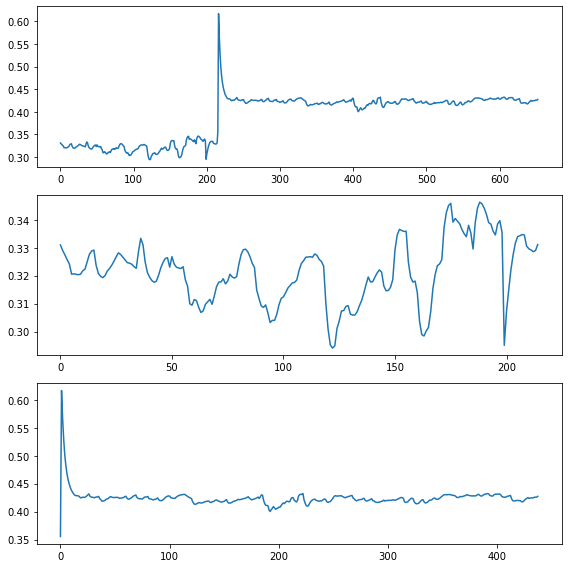

df_len_cnt: 182  H: 10  Total error: 12 Error check:  256.95295328080283 True
df_len_cnt: 183  H: 10  Total error: 18 Error check:  57.36654083363526 True
******CHANGE TIMES
ch_times :  [184] ch_num :  1 Resist :  0.29807938210402996
df_len_cnt: 185  H: 10  Total error: 19 Error check:  21.8497033434003 True
******CHANGE TIMES
df_len_cnt: 186  H: 10  Total error: 18 Error check:  16.104532609687112 False
df_len_cnt: 198  H: 10  Total error: 4 Error check:  19.574361780610573 False
df_len_cnt: 214  H: 10  Total error: 10 Error check:  1492.4447843060293 True
******CHANGE TIMES
ch_times :  [184, 215] ch_num :  2 Resist :  0.34975158872786616
df_len_cnt: 215  H: 10  Total error: 20 Error check:  227.50048932400176 True
******CHANGE TIMES
df_len_cnt: 436  H: 10  Total error: 10 Error check:  1648.2743723481374 True
df_len_cnt: 437  H: 10  Total error: 17 Error check:  56.4448693509109 True
******CHANGE TIMES
ch_times :  [184, 215, 438] ch_num :  3 Resist :  0.37324201068987894
df_len_cnt: 

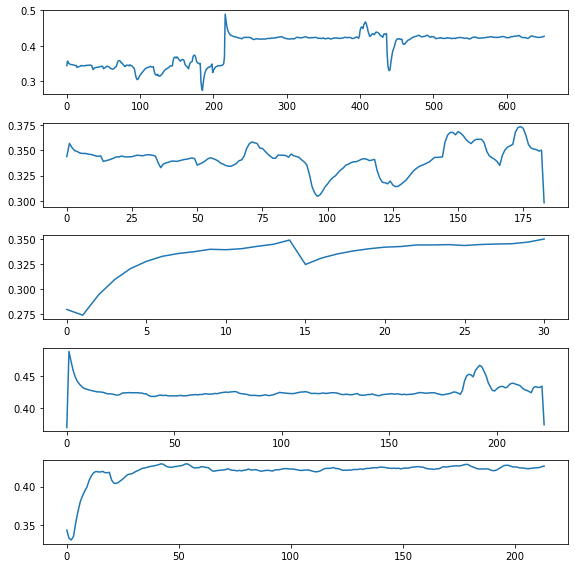

df_len_cnt: 214  H: 10  Total error: 10 Error check:  12844.150082079199 True
******CHANGE TIMES
ch_times :  [215] ch_num :  1 Resist :  0.31689915508488814
df_len_cnt: 215  H: 10  Total error: 19 Error check:  62.58899633885828 True
******CHANGE TIMES
df_len_cnt: 216  H: 10  Total error: 20 Error check:  39.330239641062846 True
******CHANGE TIMES
df_len_cnt: 217  H: 10  Total error: 20 Error check:  37.941176377671404 True
******CHANGE TIMES
df_len_cnt: 218  H: 10  Total error: 19 Error check:  39.508505958779125 True
******CHANGE TIMES
df_len_cnt: 219  H: 10  Total error: 20 Error check:  46.63132946809044 True
******CHANGE TIMES
df_len_cnt: 220  H: 10  Total error: 20 Error check:  55.55605694098513 True
******CHANGE TIMES
CHECK TIMES
[None, 215, None]
adf
215
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.319000       4.45      -20.0
1    2020-02-15 04:05:35     0.319000       4.46      -20.0
2    2020-02-15 16:04:41     0.320571       4.

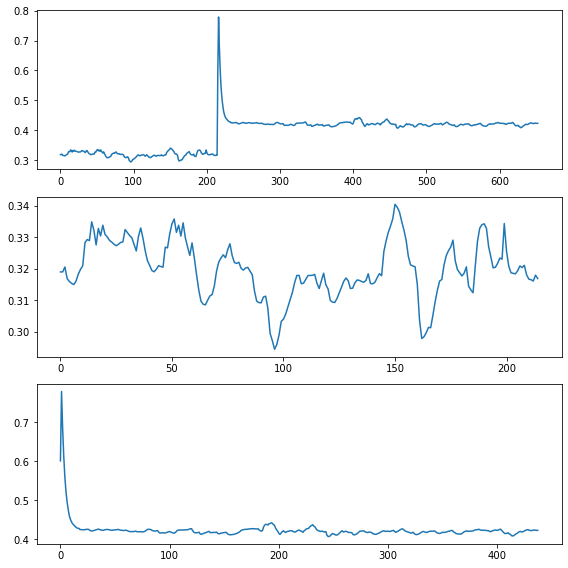

df_len_cnt: 214  H: 10  Total error: 10 Error check:  1776.749359874045 True
******CHANGE TIMES
ch_times :  [215] ch_num :  1 Resist :  0.3449531605822363
CHECK TIMES
[None, 215, None]
adf
215
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.348000       4.52      -20.0
1    2020-02-15 04:05:35     0.357998       4.51      -20.0
2    2020-02-15 16:04:41     0.355904       4.49      -20.0
3    2020-02-16 04:03:44     0.352484       4.49      -20.0
4    2020-02-16 16:02:52     0.350042       4.49      -20.0
..                   ...          ...        ...        ...
210  2020-06-29 16:58:43     0.341647       4.49      -20.0
211  2020-06-30 04:58:17     0.342282       4.48      -20.0
212  2020-06-30 16:57:51     0.342746       4.49      -20.0
213  2020-07-01 04:57:12     0.343085       4.50      -20.0
214  2020-07-01 11:53:27     0.344953       4.50      -20.0

[215 rows x 4 columns]
adf
None
                 KeyTime  ResistValue  VoltValue  Temp

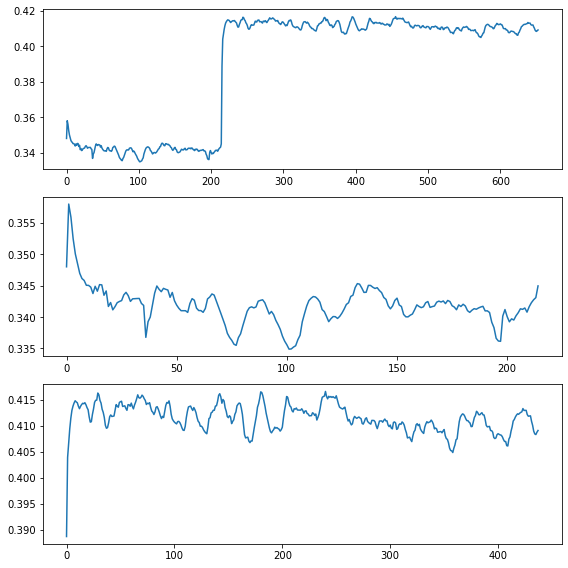

df_len_cnt: 214  H: 10  Total error: 10 Error check:  12695.665751778084 True
******CHANGE TIMES
ch_times :  [215] ch_num :  1 Resist :  0.33905113670336007
df_len_cnt: 215  H: 10  Total error: 12 Error check:  82.53227264230229 True
******CHANGE TIMES
CHECK TIMES
[None, 215, None]
adf
215
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.342000       4.53      -20.0
1    2020-02-15 04:05:35     0.345999       4.50      -20.0
2    2020-02-15 16:04:41     0.347571       4.50      -20.0
3    2020-02-16 04:03:44     0.346583       4.48      -20.0
4    2020-02-16 16:02:52     0.345088       4.50      -20.0
..                   ...          ...        ...        ...
210  2020-06-29 16:58:43     0.339895       4.51      -20.0
211  2020-06-30 04:58:17     0.339923       4.51      -20.0
212  2020-06-30 16:57:51     0.340755       4.51      -20.0
213  2020-07-01 04:57:12     0.340551       4.51      -20.0
214  2020-07-01 11:53:27     0.339051       4.53 

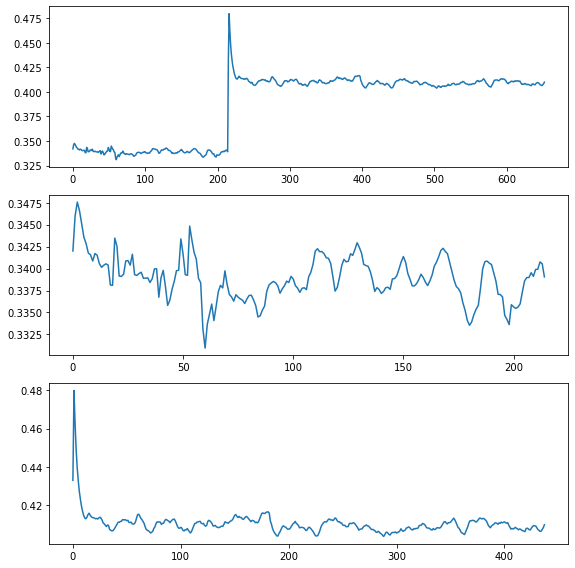

df_len_cnt: 214  H: 10  Total error: 15 Error check:  1551.2655767955491 True
******CHANGE TIMES
ch_times :  [215] ch_num :  1 Resist :  0.3411993303946893
df_len_cnt: 215  H: 10  Total error: 19 Error check:  56.9973076448278 True
******CHANGE TIMES
df_len_cnt: 216  H: 10  Total error: 20 Error check:  33.47828082666277 True
******CHANGE TIMES
df_len_cnt: 217  H: 10  Total error: 20 Error check:  30.54421681511966 True
******CHANGE TIMES
df_len_cnt: 218  H: 10  Total error: 19 Error check:  29.9098772083615 True
******CHANGE TIMES
df_len_cnt: 219  H: 10  Total error: 20 Error check:  37.01599872827207 True
******CHANGE TIMES
df_len_cnt: 220  H: 10  Total error: 20 Error check:  47.19965229785091 True
******CHANGE TIMES
df_len_cnt: 221  H: 10  Total error: 20 Error check:  56.82642747313751 True
******CHANGE TIMES
CHECK TIMES
[None, 215, None]
adf
215
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.333000       4.47       23.9
1    2020-02-15 

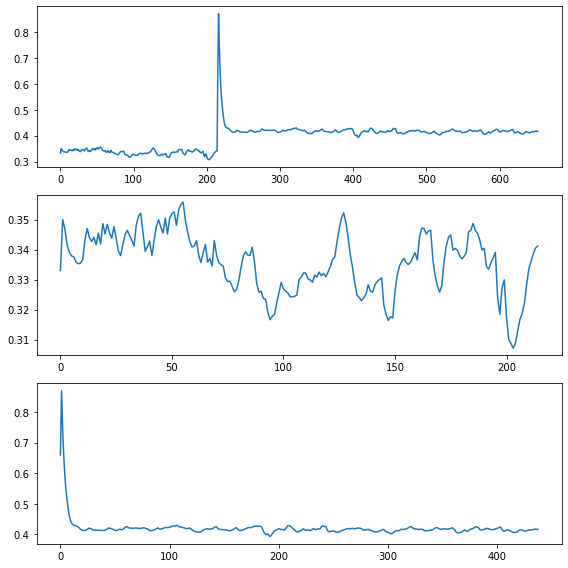

df_len_cnt: 214  H: 10  Total error: 10 Error check:  2413.2743617752485 True
******CHANGE TIMES
ch_times :  [215] ch_num :  1 Resist :  0.3596373632359203
df_len_cnt: 215  H: 10  Total error: 19 Error check:  53.39184802269106 True
******CHANGE TIMES
df_len_cnt: 216  H: 10  Total error: 20 Error check:  30.814198924541795 True
******CHANGE TIMES
df_len_cnt: 217  H: 10  Total error: 20 Error check:  25.937333590168514 True
******CHANGE TIMES
df_len_cnt: 218  H: 10  Total error: 19 Error check:  24.53409636525353 True
******CHANGE TIMES
df_len_cnt: 219  H: 10  Total error: 20 Error check:  32.124442714724125 True
******CHANGE TIMES
df_len_cnt: 220  H: 10  Total error: 20 Error check:  43.05313159474141 True
******CHANGE TIMES
df_len_cnt: 221  H: 10  Total error: 20 Error check:  54.09925599823284 True
******CHANGE TIMES
CHECK TIMES
[None, 215, None]
adf
215
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.362000       4.44      -20.0
1    2020-0

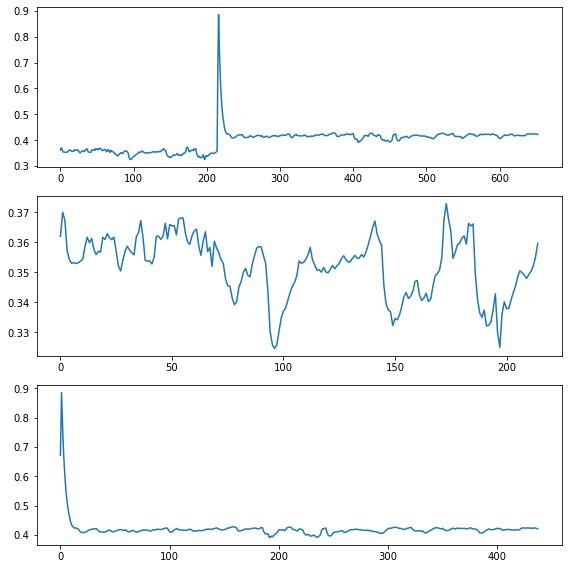

df_len_cnt: 85  H: 10  Total error: 9 Error check:  427.0748009427892 True
******CHANGE TIMES
ch_times :  [86] ch_num :  1 Resist :  0.3622751393536673
df_len_cnt: 86  H: 10  Total error: 20 Error check:  103.34528280953117 True
******CHANGE TIMES
df_len_cnt: 144  H: 10  Total error: 7 Error check:  382.5464382525711 True
df_len_cnt: 149  H: 10  Total error: 8 Error check:  84.979683536956 True
df_len_cnt: 185  H: 10  Total error: 12 Error check:  100.2365739963861 True
******CHANGE TIMES
ch_times :  [86, 186] ch_num :  2 Resist :  0.3719827849978175
df_len_cnt: 215  H: 10  Total error: 9 Error check:  420.2619328034719 True
******CHANGE TIMES
ch_times :  [86, 186, 216] ch_num :  3 Resist :  0.34834002679286735
df_len_cnt: 216  H: 10  Total error: 20 Error check:  135.57090604022005 True
******CHANGE TIMES
df_len_cnt: 217  H: 10  Total error: 11 Error check:  784.3573461558763 True
******CHANGE TIMES
df_len_cnt: 448  H: 10  Total error: 3 Error check:  185.85720110520117 True
CHECK TIM

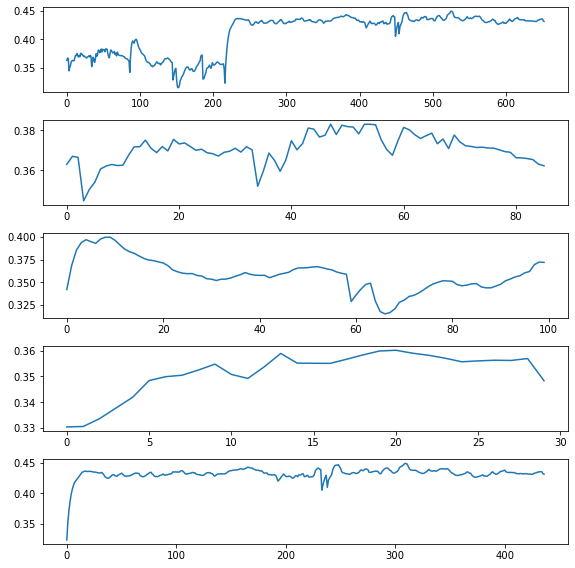

df_len_cnt: 18  H: 10  Total error: 2 Error check:  279.92914034947717 True
df_len_cnt: 31  H: 10  Total error: 8 Error check:  324.3611325459654 True
df_len_cnt: 35  H: 10  Total error: 5 Error check:  94.16252645389847 True
df_len_cnt: 46  H: 10  Total error: 9 Error check:  32.77918967982239 True
df_len_cnt: 58  H: 10  Total error: 5 Error check:  22.697851540999988 True
df_len_cnt: 68  H: 10  Total error: 4 Error check:  15.306825086486178 False
df_len_cnt: 214  H: 10  Total error: 10 Error check:  756.2313486758177 True
******CHANGE TIMES
ch_times :  [215] ch_num :  1 Resist :  0.38313588011846966
CHECK TIMES
[None, 215, None]
adf
215
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.374000       4.44      -20.0
1    2020-02-15 04:05:35     0.378999       4.45      -20.0
2    2020-02-15 16:04:41     0.378476       4.46      -20.0
3    2020-02-16 04:03:44     0.369458       4.44      -20.0
4    2020-02-16 16:02:52     0.372570       4.45    

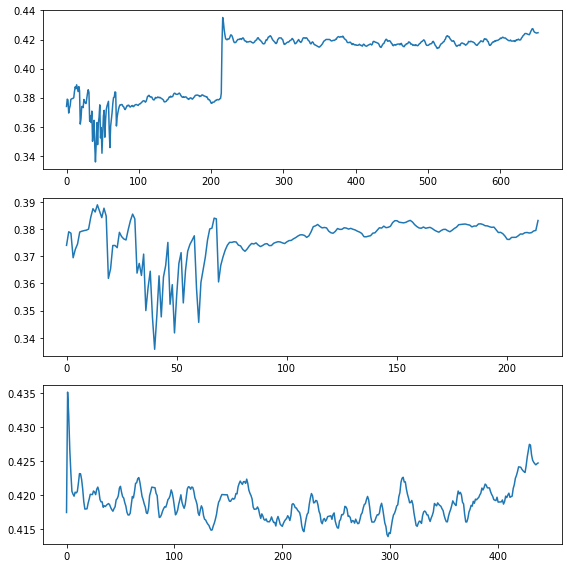

df_len_cnt: 24  H: 10  Total error: 12 Error check:  18.497697013539327 False
df_len_cnt: 30  H: 10  Total error: 17 Error check:  49.240637053079205 True
******CHANGE TIMES
ch_times :  [31] ch_num :  1 Resist :  0.3255489234837977
df_len_cnt: 41  H: 10  Total error: 16 Error check:  46.04715033871898 True
******CHANGE TIMES
ch_times :  [31, 42] ch_num :  2 Resist :  0.3841721396781471
df_len_cnt: 51  H: 10  Total error: 13 Error check:  19.970772517911776 False
df_len_cnt: 55  H: 10  Total error: 15 Error check:  48.05871779221468 True
******CHANGE TIMES
ch_times :  [31, 42, 56] ch_num :  3 Resist :  0.3270469376267714
CHECK TIMES
[None, 31, 42, 56, None]
adf
31
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-14 16:06:32     0.396000       4.43      -20.0
1   2020-02-15 04:05:35     0.404999       4.43      -20.0
2   2020-02-15 16:04:41     0.403428       4.45      -20.0
3   2020-02-16 04:03:44     0.394428       4.51      -20.0
4   2020-02-16 16:02:52     0.394

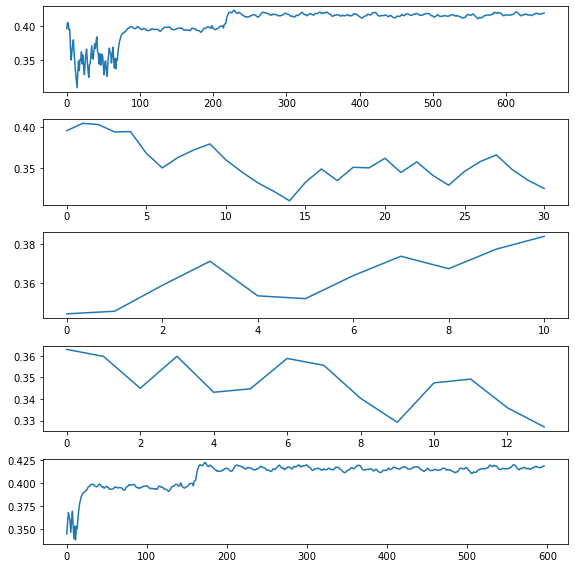

df_len_cnt: 18  H: 10  Total error: 8 Error check:  40.565095156451676 True
df_len_cnt: 33  H: 10  Total error: 10 Error check:  272.1479552984303 True
******CHANGE TIMES
ch_times :  [34] ch_num :  1 Resist :  0.3180886868941432
df_len_cnt: 38  H: 10  Total error: 6 Error check:  78.5366456159936 True
df_len_cnt: 58  H: 10  Total error: 15 Error check:  22.28795763925018 True
******CHANGE TIMES
ch_times :  [34, 59] ch_num :  2 Resist :  0.3233611092334133
df_len_cnt: 68  H: 10  Total error: 12 Error check:  39.0447417143808 True
******CHANGE TIMES
df_len_cnt: 213  H: 10  Total error: 10 Error check:  4949.99275862506 True
******CHANGE TIMES
ch_times :  [34, 59, 214] ch_num :  3 Resist :  0.3121838210331928
df_len_cnt: 214  H: 10  Total error: 18 Error check:  65.42283355629502 True
******CHANGE TIMES
df_len_cnt: 215  H: 10  Total error: 20 Error check:  41.99975899977219 True
******CHANGE TIMES
df_len_cnt: 216  H: 10  Total error: 20 Error check:  41.15885715832388 True
******CHANGE TI

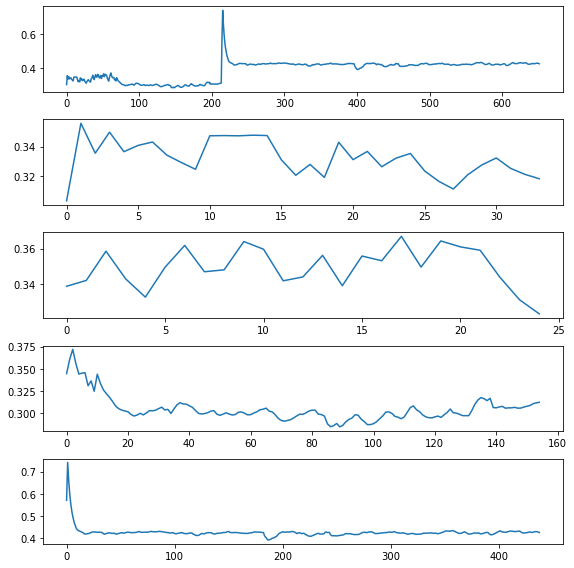

df_len_cnt: 144  H: 10  Total error: 3 Error check:  209.58276996866744 True
df_len_cnt: 145  H: 10  Total error: 20 Error check:  14.468256897112145 False
df_len_cnt: 185  H: 10  Total error: 10 Error check:  696.4660688638477 True
******CHANGE TIMES
ch_times :  [186] ch_num :  1 Resist :  0.35943985293224395
df_len_cnt: 186  H: 10  Total error: 16 Error check:  51.6511268551934 True
******CHANGE TIMES
df_len_cnt: 214  H: 10  Total error: 10 Error check:  1560.0642447162204 True
******CHANGE TIMES
ch_times :  [186, 215] ch_num :  2 Resist :  0.3556226032595091
df_len_cnt: 215  H: 10  Total error: 11 Error check:  75.36324264203176 True
******CHANGE TIMES
df_len_cnt: 453  H: 10  Total error: 5 Error check:  314.77925016452707 True
CHECK TIMES
[None, 186, 215, None]
adf
186
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.353000       4.43      -20.0
1    2020-02-15 04:05:35     0.411990       4.49      -20.0
2    2020-02-15 16:04:41     0.38423

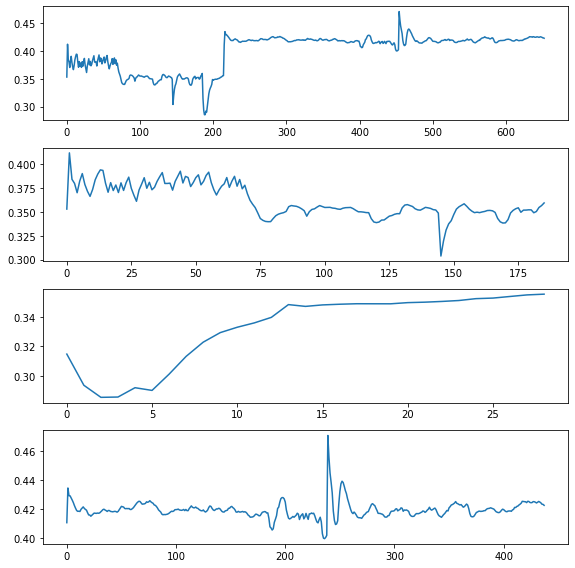

df_len_cnt: 98  H: 10  Total error: 8 Error check:  202.81652095677453 True
df_len_cnt: 458  H: 10  Total error: 8 Error check:  56.928159337279816 True
CHECK TIMES
[None, None]
adf
None
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.402000       4.49      -20.0
1    2020-02-15 04:05:35     0.394001       4.50      -20.0
2    2020-02-15 16:04:41     0.403429       4.49      -20.0
3    2020-02-16 04:03:44     0.400575       4.47      -20.0
4    2020-02-16 16:02:52     0.402997       4.48      -20.0
..                   ...          ...        ...        ...
648  2021-02-01 08:51:45     0.416838       4.48      -20.0
649  2021-02-01 20:51:10     0.416882       4.48      -20.0
650  2021-02-02 08:50:36     0.416643       4.48      -20.0
651  2021-02-02 20:50:08     0.416740       4.48      -20.0
652  2021-02-03 08:49:36     0.416810       4.48      -20.0

[653 rows x 4 columns]


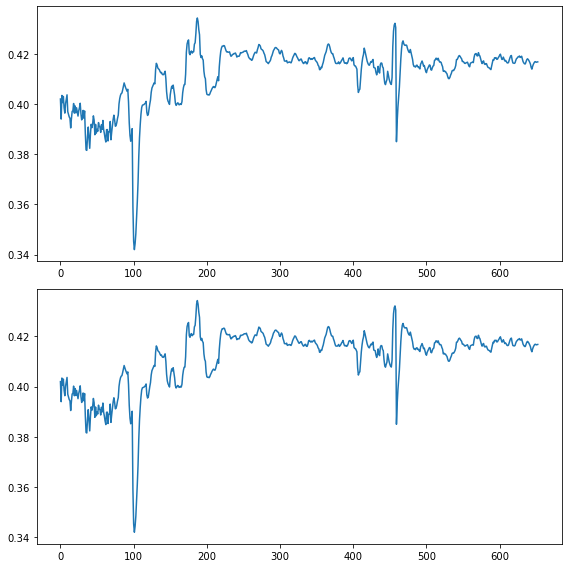

CHECK TIMES
[None, None]
adf
None
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.393000       4.50      -20.0
1    2020-02-15 04:05:35     0.375003       4.48      -20.0
2    2020-02-15 16:04:41     0.383906       4.49      -20.0
3    2020-02-16 04:03:44     0.368576       4.52      -20.0
4    2020-02-16 16:02:52     0.375891       4.50      -20.0
..                   ...          ...        ...        ...
648  2021-02-01 08:51:45     0.410736       4.48      -20.0
649  2021-02-01 20:51:10     0.410267       4.48      -20.0
650  2021-02-02 08:50:36     0.410735       4.49      -20.0
651  2021-02-02 20:50:08     0.411077       4.47      -20.0
652  2021-02-03 08:49:36     0.411056       4.47      -20.0

[653 rows x 4 columns]


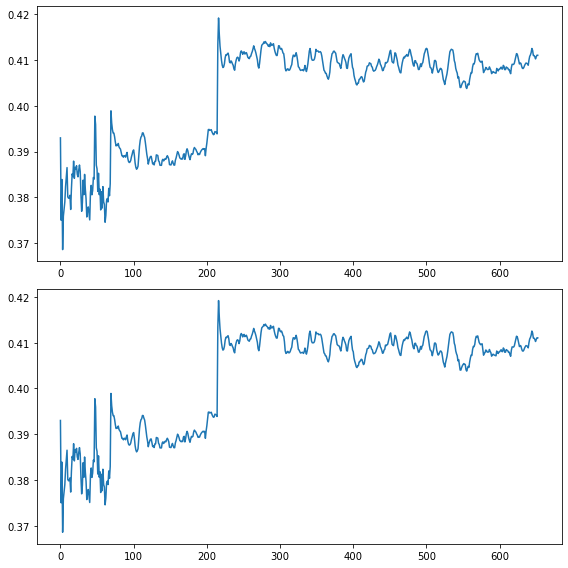

df_len_cnt: 214  H: 10  Total error: 10 Error check:  1235.72844165815 True
******CHANGE TIMES
ch_times :  [215] ch_num :  1 Resist :  0.38586786960409836
CHECK TIMES
[None, 215, None]
adf
215
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.379000       4.50      -20.0
1    2020-02-15 04:05:35     0.371001       4.48      -20.0
2    2020-02-15 16:04:41     0.374143       4.52      -20.0
3    2020-02-16 04:03:44     0.368326       4.46      -20.0
4    2020-02-16 16:02:52     0.373113       4.50      -20.0
..                   ...          ...        ...        ...
210  2020-06-29 16:58:43     0.382746       4.52      -20.0
211  2020-06-30 04:58:17     0.384976       4.52      -20.0
212  2020-06-30 16:57:51     0.385793       4.52      -20.0
213  2020-07-01 04:57:12     0.386929       4.53      -20.0
214  2020-07-01 11:53:27     0.385868       4.53      -20.0

[215 rows x 4 columns]
adf
None
                 KeyTime  ResistValue  VoltValue  Temp

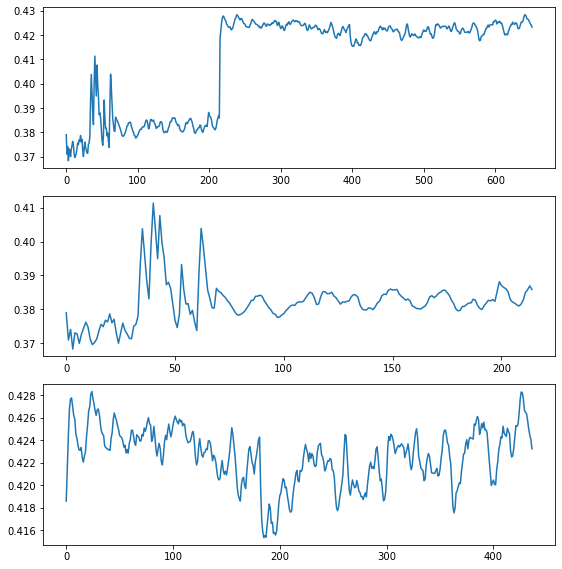

df_len_cnt: 48  H: 10  Total error: 16 Error check:  4.996462161285709 False
df_len_cnt: 214  H: 10  Total error: 10 Error check:  756.2029470287086 True
******CHANGE TIMES
ch_times :  [215] ch_num :  1 Resist :  0.3810023392359823
CHECK TIMES
[None, 215, None]
adf
215
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.360000       4.47      -20.0
1    2020-02-15 04:05:35     0.437987       4.42       24.8
2    2020-02-15 16:04:41     0.404996       4.47      -20.0
3    2020-02-16 04:03:44     0.399620       4.46      -20.0
4    2020-02-16 16:02:52     0.390610       4.47      -20.0
..                   ...          ...        ...        ...
210  2020-06-29 16:58:43     0.373686       4.48      -20.0
211  2020-06-30 04:58:17     0.373230       4.47      -20.0
212  2020-06-30 16:57:51     0.375329       4.48      -20.0
213  2020-07-01 04:57:12     0.377672       4.48      -20.0
214  2020-07-01 11:53:27     0.381002       4.48      -20.0

[215 rows

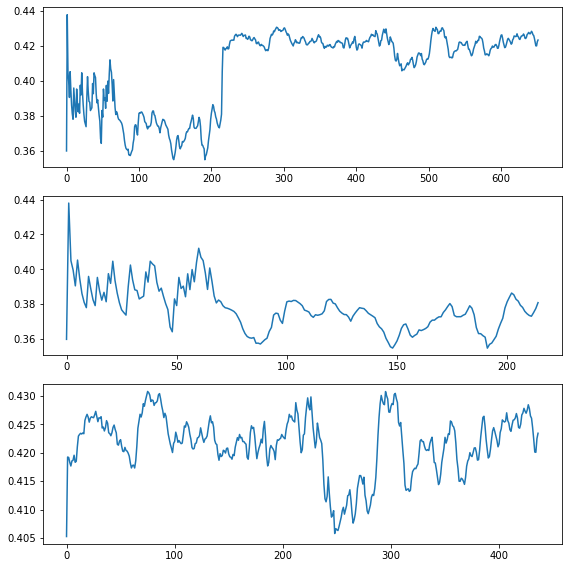

df_len_cnt: 214  H: 10  Total error: 10 Error check:  1558.7385722263493 True
******CHANGE TIMES
ch_times :  [215] ch_num :  1 Resist :  0.38074081155046363
CHECK TIMES
[None, 215, None]
adf
215
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.368000       4.48      -20.0
1    2020-02-15 04:05:35     0.386997       4.45      -20.0
2    2020-02-15 16:04:41     0.379666       4.49      -20.0
3    2020-02-16 04:03:44     0.365196       4.50      -20.0
4    2020-02-16 16:02:52     0.369047       4.48      -20.0
..                   ...          ...        ...        ...
210  2020-06-29 16:58:43     0.375659       4.48      -20.0
211  2020-06-30 04:58:17     0.374941       4.49      -20.0
212  2020-06-30 16:57:51     0.375497       4.49      -20.0
213  2020-07-01 04:57:12     0.375093       4.49      -20.0
214  2020-07-01 11:53:27     0.380741       4.48      -20.0

[215 rows x 4 columns]
adf
None
                 KeyTime  ResistValue  VoltValue  Te

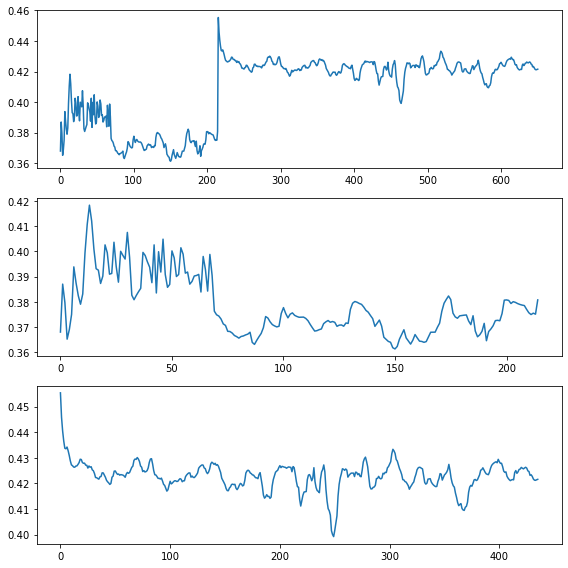

df_len_cnt: 16  H: 10  Total error: 7 Error check:  21.693238923747472 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.4185478346032253
df_len_cnt: 40  H: 10  Total error: 12 Error check:  56.25648639952408 True
******CHANGE TIMES
ch_times :  [17, 41] ch_num :  2 Resist :  0.36593088459472883
df_len_cnt: 218  H: 10  Total error: 4 Error check:  175.26650354274778 True
df_len_cnt: 220  H: 10  Total error: 6 Error check:  56.99493953410671 True
CHECK TIMES
[None, 17, 41, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-14 16:06:32     0.441000       4.42       25.0
1   2020-02-15 04:05:35     0.393008       4.47      -20.0
2   2020-02-15 16:04:41     0.390385       4.45      -20.0
3   2020-02-16 04:03:44     0.370645       4.49      -20.0
4   2020-02-16 16:02:52     0.392291       4.44       25.0
5   2020-02-17 04:01:57     0.393101       4.49      -20.0
6   2020-02-17 16:01:03     0.393357       4.49      -20.0
7   2020-02-18 04:00:18 

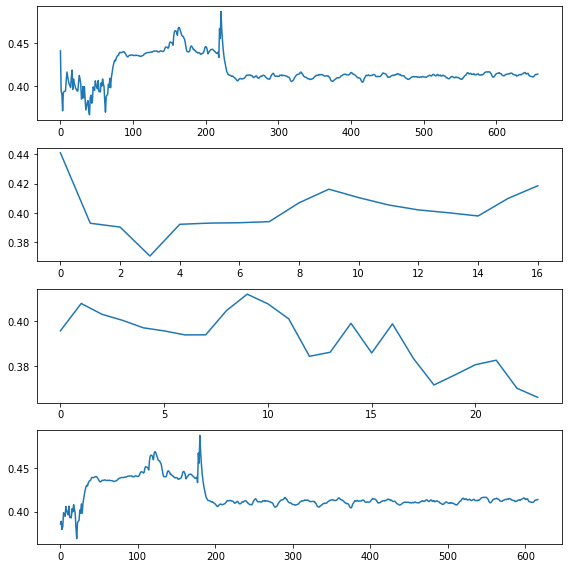

df_len_cnt: 46  H: 10  Total error: 6 Error check:  11.772372866298227 False
CHECK TIMES
[None, None]
adf
None
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.387000       4.45      -20.0
1    2020-02-15 04:05:35     0.347007       4.52      -20.0
2    2020-02-15 16:04:41     0.372668       4.48      -20.0
3    2020-02-16 04:03:44     0.346289       4.47      -20.0
4    2020-02-16 16:02:52     0.359896       4.45      -20.0
..                   ...          ...        ...        ...
651  2021-02-01 08:51:45     0.406696       4.46      -20.0
652  2021-02-01 20:51:10     0.407048       4.45      -20.0
653  2021-02-02 08:50:36     0.407576       4.46      -20.0
654  2021-02-02 20:50:08     0.407420       4.46      -20.0
655  2021-02-03 08:49:36     0.407577       4.46      -20.0

[656 rows x 4 columns]


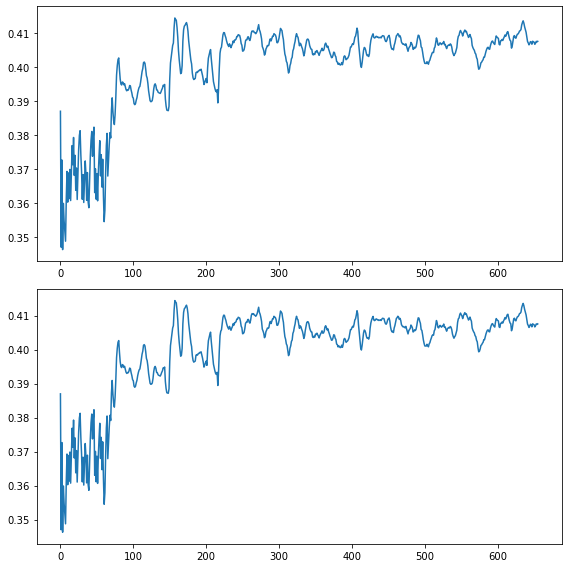

df_len_cnt: 68  H: 10  Total error: 7 Error check:  52.40311960498079 True
CHECK TIMES
[None, None]
adf
None
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.394000       4.48      -20.0
1    2020-02-15 04:05:35     0.358006       4.45      -20.0
2    2020-02-15 16:04:41     0.351194       4.52      -20.0
3    2020-02-16 04:03:44     0.348046       4.48      -20.0
4    2020-02-16 16:02:52     0.347052       4.52      -20.0
..                   ...          ...        ...        ...
650  2021-02-01 08:51:45     0.412345       4.48      -20.0
651  2021-02-01 20:51:10     0.412252       4.48      -20.0
652  2021-02-02 08:50:36     0.412454       4.47      -20.0
653  2021-02-02 20:50:08     0.412872       4.47      -20.0
654  2021-02-03 08:49:36     0.413717       4.47      -20.0

[655 rows x 4 columns]


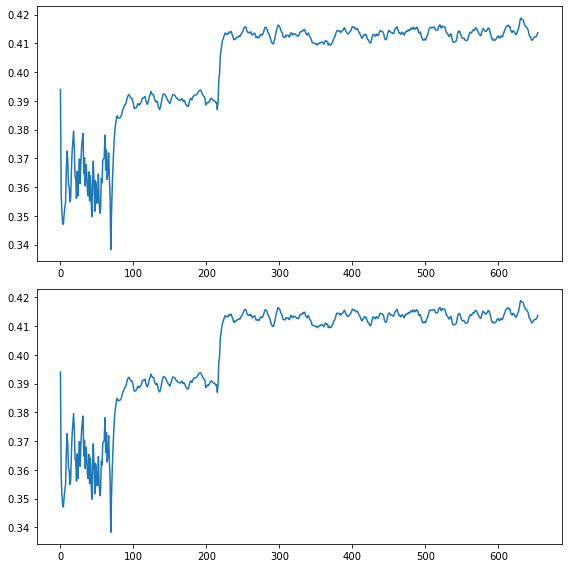

df_len_cnt: 215  H: 10  Total error: 10 Error check:  2582.3974425290685 True
******CHANGE TIMES
ch_times :  [216] ch_num :  1 Resist :  0.33543902060801944
df_len_cnt: 216  H: 10  Total error: 20 Error check:  110.95103750629131 True
******CHANGE TIMES
CHECK TIMES
[None, 216, None]
adf
216
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.349000       4.53      -20.0
1    2020-02-15 04:05:35     0.392993       4.45      -20.0
2    2020-02-15 16:04:41     0.374664       4.45      -20.0
3    2020-02-16 04:03:44     0.361348       4.50      -20.0
4    2020-02-16 16:02:52     0.360908       4.44      -20.0
..                   ...          ...        ...        ...
211  2020-06-29 16:58:43     0.338134       4.50      -20.0
212  2020-06-30 04:58:17     0.337017       4.50      -20.0
213  2020-06-30 16:57:51     0.336742       4.50      -20.0
214  2020-07-01 04:57:12     0.337082       4.50      -20.0
215  2020-07-01 11:53:27     0.335439       4.49

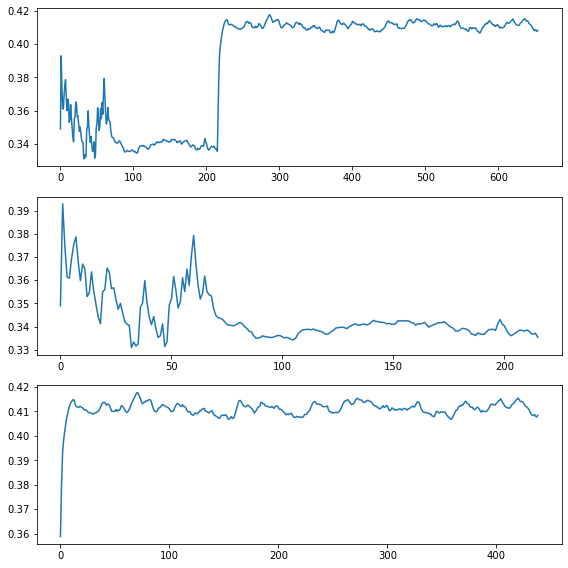

df_len_cnt: 44  H: 10  Total error: 12 Error check:  99.68173369884225 True
******CHANGE TIMES
ch_times :  [45] ch_num :  1 Resist :  0.32740333869932126
df_len_cnt: 148  H: 10  Total error: 9 Error check:  1021.5943511907708 True
CHECK TIMES
[None, 45, None]
adf
45
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-14 16:06:32     0.358000       4.45      -20.0
1   2020-02-15 04:05:35     0.348002       4.49      -20.0
2   2020-02-15 16:04:41     0.371571       4.46      -20.0
3   2020-02-16 04:03:44     0.368662       4.47      -20.0
4   2020-02-16 16:02:52     0.375949       4.45      -20.0
5   2020-02-17 04:01:57     0.365505       4.49      -20.0
6   2020-02-17 16:01:03     0.358803       4.49      -20.0
7   2020-02-18 04:00:18     0.354409       4.48      -20.0
8   2020-02-18 15:59:29     0.355394       4.45      -20.0
9   2020-02-19 03:58:42     0.356376       4.43      -20.0
10  2020-02-19 15:58:00     0.345963       4.49      -20.0
11  2020-02-20 03:57:09  

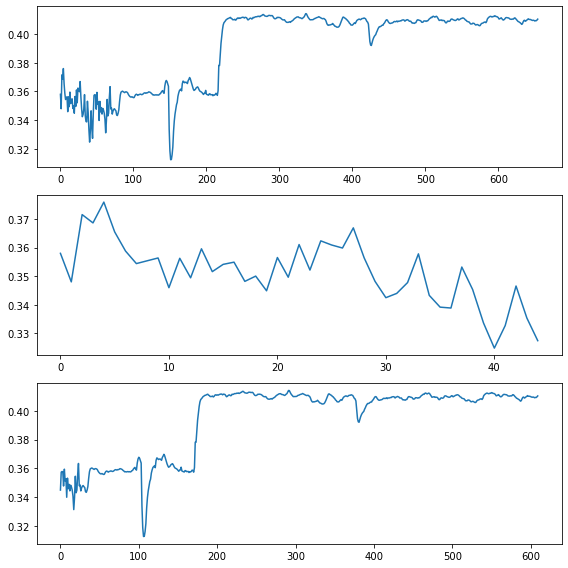

df_len_cnt: 215  H: 10  Total error: 10 Error check:  4365.957097911484 True
******CHANGE TIMES
ch_times :  [216] ch_num :  1 Resist :  0.3911580018035415
CHECK TIMES
[None, 216, None]
adf
216
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.394000       4.45      -20.0
1    2020-02-15 04:05:35     0.336010       4.48      -20.0
2    2020-02-15 16:04:41     0.340719       4.50      -20.0
3    2020-02-16 04:03:44     0.362339       4.47      -20.0
4    2020-02-16 16:02:52     0.356030       4.51      -20.0
..                   ...          ...        ...        ...
211  2020-06-29 16:58:43     0.391220       4.45      -20.0
212  2020-06-30 04:58:17     0.390620       4.45      -20.0
213  2020-06-30 16:57:51     0.389912       4.45      -20.0
214  2020-07-01 04:57:12     0.390476       4.45      -20.0
215  2020-07-01 11:53:27     0.391158       4.44      -20.0

[216 rows x 4 columns]
adf
None
                 KeyTime  ResistValue  VoltValue  Temp

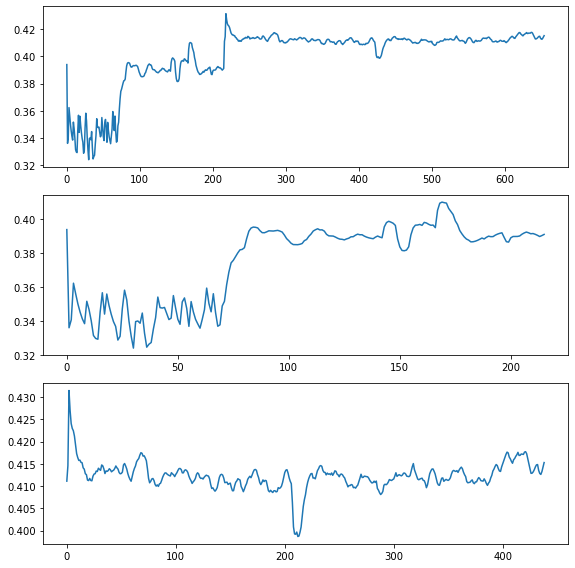

df_len_cnt: 215  H: 10  Total error: 10 Error check:  3688.6087508864725 True
******CHANGE TIMES
ch_times :  [216] ch_num :  1 Resist :  0.3296642307740345
df_len_cnt: 217  H: 10  Total error: 18 Error check:  57.55304433122147 True
******CHANGE TIMES
df_len_cnt: 218  H: 10  Total error: 20 Error check:  34.73033869448922 True
******CHANGE TIMES
df_len_cnt: 219  H: 10  Total error: 20 Error check:  30.910217636281246 True
******CHANGE TIMES
df_len_cnt: 220  H: 10  Total error: 19 Error check:  30.686385242739995 True
******CHANGE TIMES
df_len_cnt: 221  H: 10  Total error: 18 Error check:  36.109451247321225 True
******CHANGE TIMES
CHECK TIMES
[None, 216, None]
adf
216
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.350000       4.49      -20.0
1    2020-02-15 04:05:35     0.305007       4.46      -20.0
2    2020-02-15 16:04:41     0.322288       4.50      -20.0
3    2020-02-16 04:03:44     0.343306       4.47      -20.0
4    2020-02-16 16:02:5

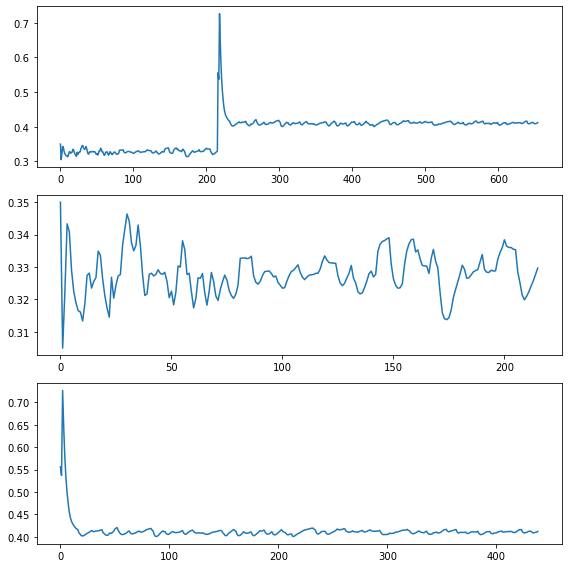

df_len_cnt: 216  H: 10  Total error: 10 Error check:  1078.807348771119 True
******CHANGE TIMES
ch_times :  [217] ch_num :  1 Resist :  0.3352818548120751
CHECK TIMES
[None, 217, None]
adf
217
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.337000       4.48      -20.0
1    2020-02-15 04:05:35     0.365995       4.46      -20.0
2    2020-02-15 16:04:41     0.333000       4.46      -20.0
3    2020-02-16 04:03:44     0.328390       4.45      -20.0
4    2020-02-16 16:02:52     0.320108       4.46      -20.0
..                   ...          ...        ...        ...
212  2020-06-30 04:58:17     0.330614       4.47      -20.0
213  2020-06-30 16:57:51     0.330718       4.48      -20.0
214  2020-07-01 04:57:12     0.331335       4.47      -20.0
215  2020-07-01 11:53:27     0.332055       4.46      -20.0
216  2020-07-01 11:59:29     0.335282       4.47      -20.0

[217 rows x 4 columns]
adf
None
                 KeyTime  ResistValue  VoltValue  Temp

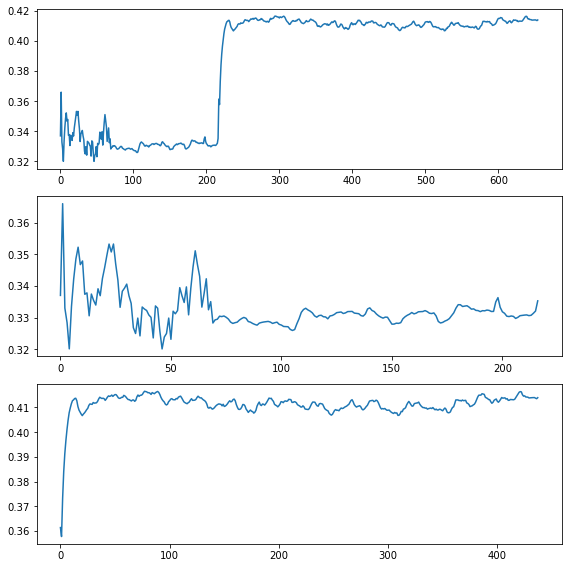

df_len_cnt: 42  H: 10  Total error: 4 Error check:  205.01945736990402 True
df_len_cnt: 215  H: 10  Total error: 10 Error check:  3020.9363849889965 True
******CHANGE TIMES
ch_times :  [216] ch_num :  1 Resist :  0.3072471698749593
df_len_cnt: 216  H: 10  Total error: 20 Error check:  103.87342983973613 True
******CHANGE TIMES
CHECK TIMES
[None, 216, None]
adf
216
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.367000       4.45      -20.0
1    2020-02-15 04:05:35     0.342004       4.48      -20.0
2    2020-02-15 16:04:41     0.356668       4.47      -20.0
3    2020-02-16 04:03:44     0.374466       4.49      -20.0
4    2020-02-16 16:02:52     0.371052       4.46      -20.0
..                   ...          ...        ...        ...
211  2020-06-29 16:58:43     0.304834       4.45      -20.0
212  2020-06-30 04:58:17     0.305419       4.44      -20.0
213  2020-06-30 16:57:51     0.305846       4.44      -20.0
214  2020-07-01 04:57:12     0.30

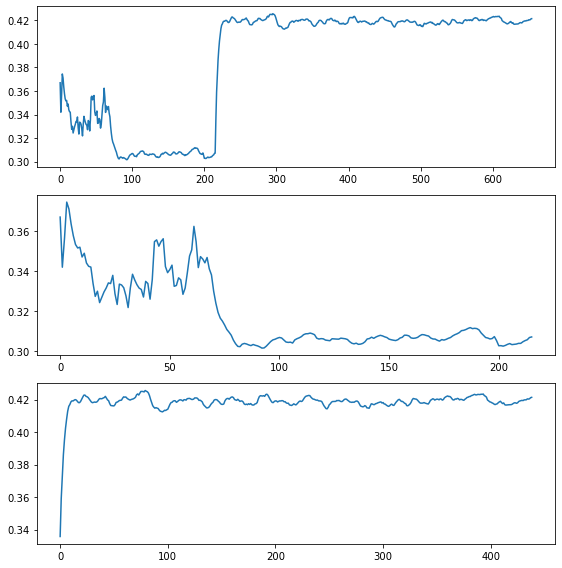

df_len_cnt: 71  H: 10  Total error: 8 Error check:  335.55009966451956 True
df_len_cnt: 142  H: 10  Total error: 4 Error check:  1513.3974042725342 True
df_len_cnt: 166  H: 10  Total error: 2 Error check:  109.33843983734252 True
df_len_cnt: 216  H: 10  Total error: 11 Error check:  341.67953624668036 True
******CHANGE TIMES
ch_times :  [217] ch_num :  1 Resist :  0.35421801670121167
CHECK TIMES
[None, 217, None]
adf
217
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.338000       4.47      -20.0
1    2020-02-15 04:05:35     0.343999       4.50      -20.0
2    2020-02-15 16:04:41     0.343476       4.48      -20.0
3    2020-02-16 04:03:44     0.372104       4.48      -20.0
4    2020-02-16 16:02:52     0.363589       4.47      -20.0
..                   ...          ...        ...        ...
212  2020-06-30 04:58:17     0.349413       4.45      -20.0
213  2020-06-30 16:57:51     0.350112       4.45      -20.0
214  2020-07-01 04:57:12     0.3503

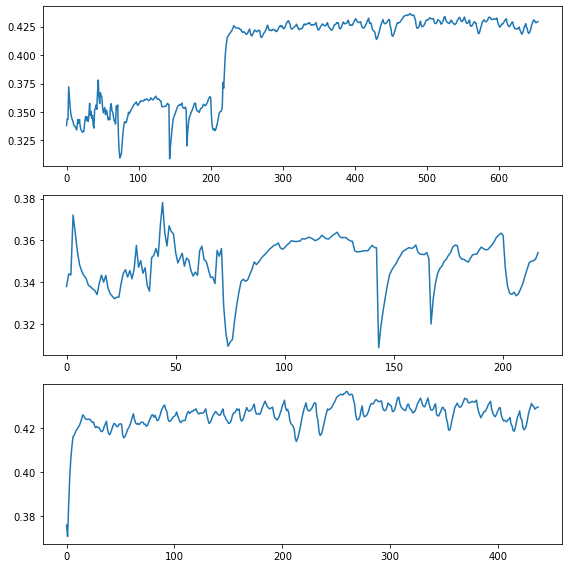

df_len_cnt: 200  H: 10  Total error: 10 Error check:  367.98580579068715 True
******CHANGE TIMES
ch_times :  [201] ch_num :  1 Resist :  0.3496181235525687
df_len_cnt: 215  H: 10  Total error: 12 Error check:  2737.6255906849165 True
******CHANGE TIMES
ch_times :  [201, 216] ch_num :  2 Resist :  0.3334923790953014
df_len_cnt: 216  H: 10  Total error: 19 Error check:  66.06462337894776 True
******CHANGE TIMES
df_len_cnt: 217  H: 10  Total error: 19 Error check:  58.34153211933161 True
******CHANGE TIMES
df_len_cnt: 218  H: 10  Total error: 20 Error check:  34.525193467988124 True
******CHANGE TIMES
df_len_cnt: 219  H: 10  Total error: 20 Error check:  30.919333240299924 True
******CHANGE TIMES
df_len_cnt: 220  H: 10  Total error: 19 Error check:  28.664663201233747 True
******CHANGE TIMES
df_len_cnt: 221  H: 10  Total error: 19 Error check:  32.8216676121567 True
******CHANGE TIMES
df_len_cnt: 222  H: 10  Total error: 20 Error check:  41.98760808783513 True
******CHANGE TIMES
df_len_cn

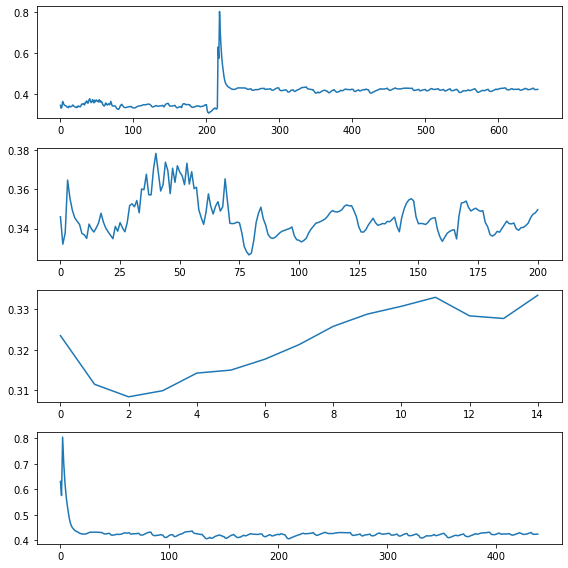

df_len_cnt: 55  H: 10  Total error: 9 Error check:  35.44315044075787 True
******CHANGE TIMES
ch_times :  [56] ch_num :  1 Resist :  0.3816225808074543
df_len_cnt: 214  H: 10  Total error: 10 Error check:  5090.70100864637 True
******CHANGE TIMES
ch_times :  [56, 215] ch_num :  2 Resist :  0.32737835167675583
df_len_cnt: 215  H: 10  Total error: 19 Error check:  66.31310556792238 True
******CHANGE TIMES
df_len_cnt: 216  H: 10  Total error: 19 Error check:  58.9964714910766 True
******CHANGE TIMES
df_len_cnt: 217  H: 10  Total error: 20 Error check:  34.874499292341326 True
******CHANGE TIMES
df_len_cnt: 218  H: 10  Total error: 20 Error check:  31.614735239357795 True
******CHANGE TIMES
df_len_cnt: 219  H: 10  Total error: 19 Error check:  29.893906373346063 True
******CHANGE TIMES
df_len_cnt: 220  H: 10  Total error: 19 Error check:  34.91818091043194 True
******CHANGE TIMES
CHECK TIMES
[None, 56, 215, None]
adf
56
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02

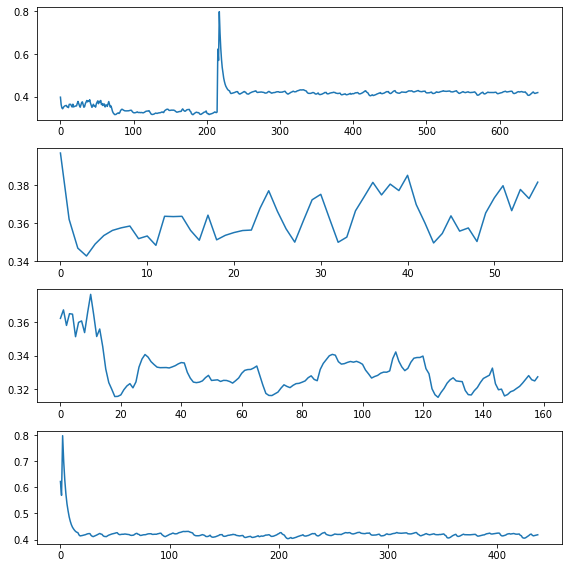

df_len_cnt: 214  H: 10  Total error: 10 Error check:  1242.9010163661928 True
******CHANGE TIMES
ch_times :  [215] ch_num :  1 Resist :  0.33751424494938836
df_len_cnt: 216  H: 10  Total error: 14 Error check:  63.89657621343461 True
******CHANGE TIMES
CHECK TIMES
[None, 215, None]
adf
215
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.408000       4.44      -20.0
1    2020-02-15 04:05:35     0.397002       4.48      -20.0
2    2020-02-15 16:04:41     0.378669       4.49      -20.0
3    2020-02-16 04:03:44     0.380717       4.47      -20.0
4    2020-02-16 16:02:52     0.386681       4.48      -20.0
..                   ...          ...        ...        ...
210  2020-06-29 16:58:43     0.332406       4.50       22.6
211  2020-06-30 04:58:17     0.332296       4.49       22.5
212  2020-06-30 16:57:51     0.332757       4.50       22.5
213  2020-07-01 04:57:12     0.333633       4.50       22.5
214  2020-07-01 11:53:27     0.337514       4.50 

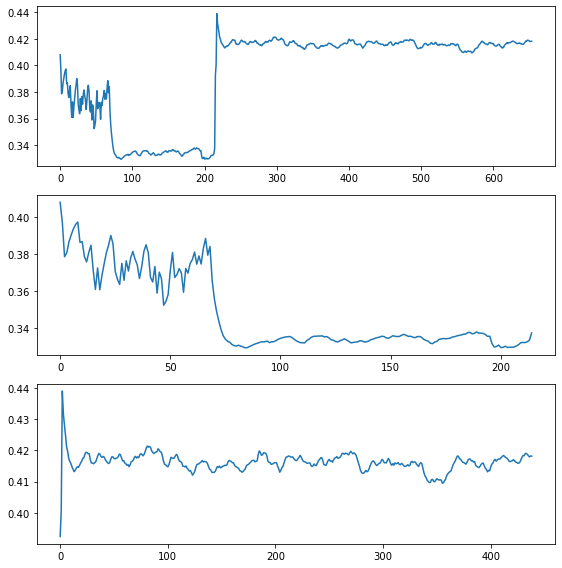

df_len_cnt: 60  H: 10  Total error: 1 Error check:  69.85449881923479 True
df_len_cnt: 61  H: 10  Total error: 11 Error check:  44.48624404240357 True
******CHANGE TIMES
ch_times :  [62] ch_num :  1 Resist :  0.3851172830855127
df_len_cnt: 215  H: 10  Total error: 10 Error check:  1621.3890730142318 True
******CHANGE TIMES
ch_times :  [62, 216] ch_num :  2 Resist :  0.35611785872387103
df_len_cnt: 217  H: 10  Total error: 13 Error check:  58.33074975675656 True
******CHANGE TIMES
CHECK TIMES
[None, 62, 216, None]
adf
62
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-14 16:06:32     0.381000       4.46      -20.0
1   2020-02-15 04:05:35     0.406996       4.44      -20.0
2   2020-02-15 16:04:41     0.402284       4.49      -20.0
3   2020-02-16 04:03:44     0.425224       4.49       22.0
4   2020-02-16 16:02:52     0.418627       4.45      -20.0
..                  ...          ...        ...        ...
57  2020-03-14 03:21:05     0.343891       4.44      -20.0
58

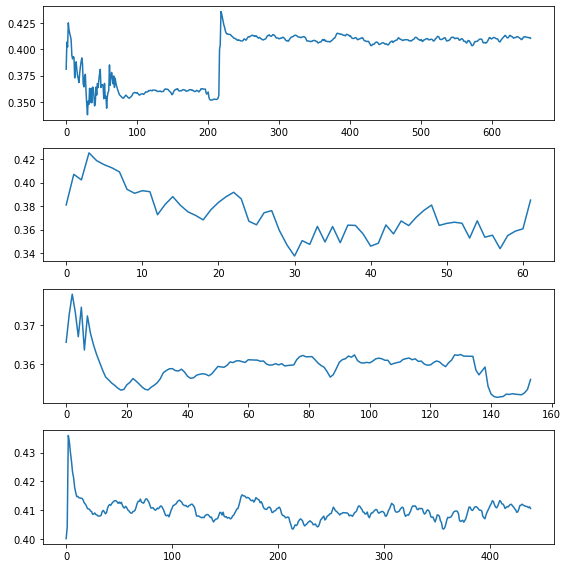

df_len_cnt: 215  H: 10  Total error: 13 Error check:  1159.1973629249865 True
******CHANGE TIMES
ch_times :  [216] ch_num :  1 Resist :  0.3959196441727057
df_len_cnt: 216  H: 10  Total error: 19 Error check:  53.14132143049155 True
******CHANGE TIMES
df_len_cnt: 217  H: 10  Total error: 18 Error check:  41.89018378327759 True
******CHANGE TIMES
df_len_cnt: 218  H: 10  Total error: 20 Error check:  20.904535233816418 True
******CHANGE TIMES
df_len_cnt: 219  H: 10  Total error: 20 Error check:  11.296862582974036 False
df_len_cnt: 220  H: 10  Total error: 19 Error check:  6.985229685684775 False
df_len_cnt: 221  H: 10  Total error: 19 Error check:  15.46859392864413 False
df_len_cnt: 222  H: 10  Total error: 20 Error check:  34.45886284957771 True
******CHANGE TIMES
CHECK TIMES
[None, 216, None]
adf
216
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.326000       4.44      -20.0
1    2020-02-15 04:05:35     0.377991       4.46      -20.0
2    2

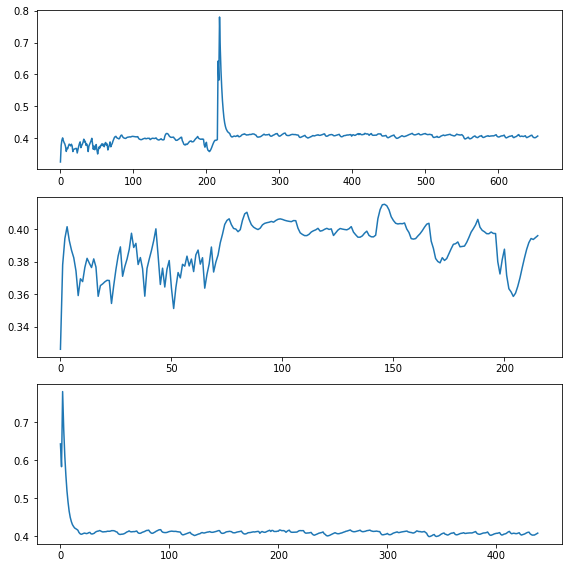

df_len_cnt: 31  H: 10  Total error: 6 Error check:  3.4730597406011645 False
df_len_cnt: 34  H: 10  Total error: 10 Error check:  44.0365359671639 True
******CHANGE TIMES
ch_times :  [35] ch_num :  1 Resist :  0.3539811769718623
df_len_cnt: 38  H: 10  Total error: 7 Error check:  223.71981697268225 True
df_len_cnt: 67  H: 10  Total error: 13 Error check:  197.1864487475944 True
******CHANGE TIMES
ch_times :  [35, 68] ch_num :  2 Resist :  0.3466506534579348
df_len_cnt: 215  H: 10  Total error: 10 Error check:  4375.315540042862 True
df_len_cnt: 216  H: 10  Total error: 18 Error check:  51.84925155676948 True
******CHANGE TIMES
ch_times :  [35, 68, 217] ch_num :  3 Resist :  0.5311973071564601
df_len_cnt: 217  H: 10  Total error: 18 Error check:  39.67269371491635 True
******CHANGE TIMES
df_len_cnt: 218  H: 10  Total error: 20 Error check:  20.079820869149792 True
******CHANGE TIMES
df_len_cnt: 219  H: 10  Total error: 19 Error check:  9.702431539584563 False
df_len_cnt: 220  H: 10  Tot

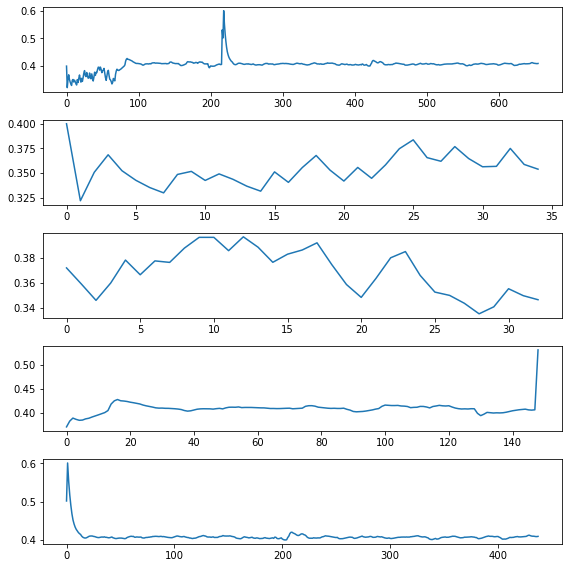

df_len_cnt: 26  H: 10  Total error: 2 Error check:  63.49022959123243 True
df_len_cnt: 30  H: 10  Total error: 7 Error check:  44.327885232108294 True
df_len_cnt: 46  H: 10  Total error: 16 Error check:  49.8114811662987 True
******CHANGE TIMES
ch_times :  [47] ch_num :  1 Resist :  0.34551767141493495
df_len_cnt: 48  H: 10  Total error: 10 Error check:  43.528118948457106 True
******CHANGE TIMES
df_len_cnt: 52  H: 10  Total error: 14 Error check:  56.85137456989311 True
******CHANGE TIMES
df_len_cnt: 63  H: 10  Total error: 14 Error check:  36.54136674655045 True
******CHANGE TIMES
ch_times :  [47, 64] ch_num :  2 Resist :  0.3959563354835903
df_len_cnt: 68  H: 10  Total error: 8 Error check:  28.569538661958433 True
df_len_cnt: 215  H: 10  Total error: 10 Error check:  2927.9129429446334 True
******CHANGE TIMES
ch_times :  [47, 64, 216] ch_num :  3 Resist :  0.36019806903693435
df_len_cnt: 216  H: 10  Total error: 19 Error check:  57.91755541017742 True
******CHANGE TIMES
df_len_cnt:

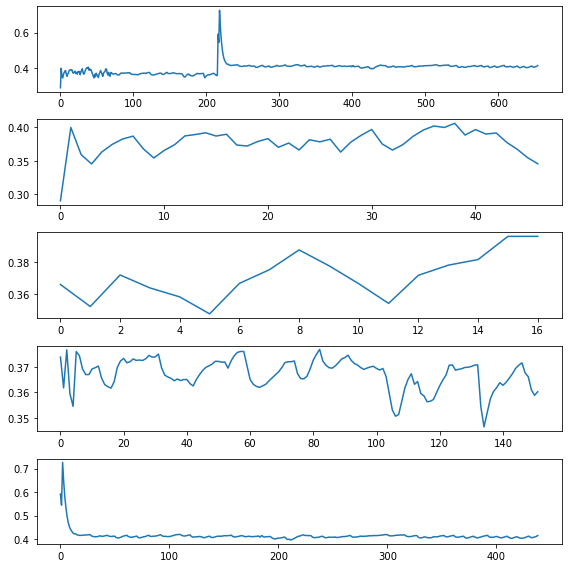

df_len_cnt: 16  H: 10  Total error: 8 Error check:  3.581659190050997 False
df_len_cnt: 20  H: 10  Total error: 6 Error check:  47.046476249381456 True
******CHANGE TIMES
ch_times :  [21] ch_num :  1 Resist :  0.3424067023794763
df_len_cnt: 29  H: 10  Total error: 11 Error check:  218.6874806220641 True
******CHANGE TIMES
df_len_cnt: 53  H: 10  Total error: 14 Error check:  26.795828426222783 True
******CHANGE TIMES
ch_times :  [21, 54] ch_num :  2 Resist :  0.40985069072385816
df_len_cnt: 60  H: 10  Total error: 11 Error check:  4.8081541642804515 False
df_len_cnt: 215  H: 10  Total error: 10 Error check:  12122.910655401383 True
******CHANGE TIMES
ch_times :  [21, 54, 216] ch_num :  3 Resist :  0.3168083742712386
df_len_cnt: 217  H: 10  Total error: 19 Error check:  21.025887437882677 True
******CHANGE TIMES
CHECK TIMES
[None, 21, 54, 216, None]
adf
21
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-14 16:06:32     0.409000       4.46      -20.0
1   2020-02-15 

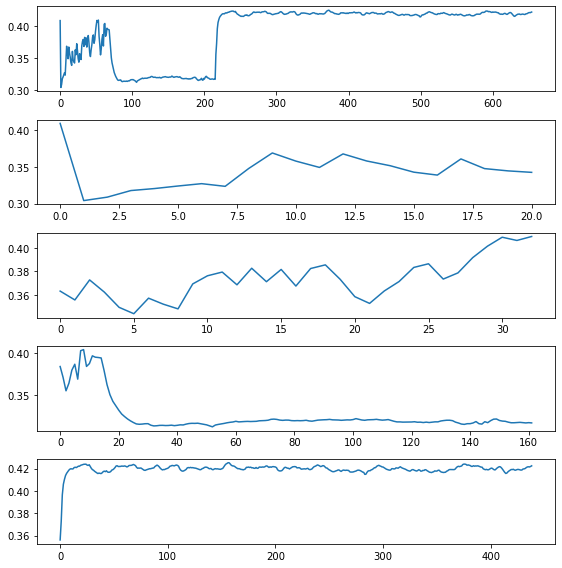

df_len_cnt: 26  H: 10  Total error: 4 Error check:  142.3758322331278 True
df_len_cnt: 28  H: 10  Total error: 14 Error check:  39.5660124462591 True
******CHANGE TIMES
ch_times :  [29] ch_num :  1 Resist :  0.3827410497718689
df_len_cnt: 31  H: 10  Total error: 10 Error check:  41.621784318979984 True
******CHANGE TIMES
df_len_cnt: 42  H: 10  Total error: 6 Error check:  33.759742179786606 True
df_len_cnt: 45  H: 10  Total error: 18 Error check:  32.909698559931186 True
******CHANGE TIMES
ch_times :  [29, 46] ch_num :  2 Resist :  0.4217875977467998
df_len_cnt: 56  H: 10  Total error: 6 Error check:  63.495853044676466 True
df_len_cnt: 66  H: 10  Total error: 3 Error check:  11.218420742684229 False
df_len_cnt: 67  H: 10  Total error: 6 Error check:  17.043481936848178 False
CHECK TIMES
[None, 29, 46, None]
adf
29
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-14 16:06:32     0.376000       4.48      -20.0
1   2020-02-15 04:05:35     0.412994       4.46      -2

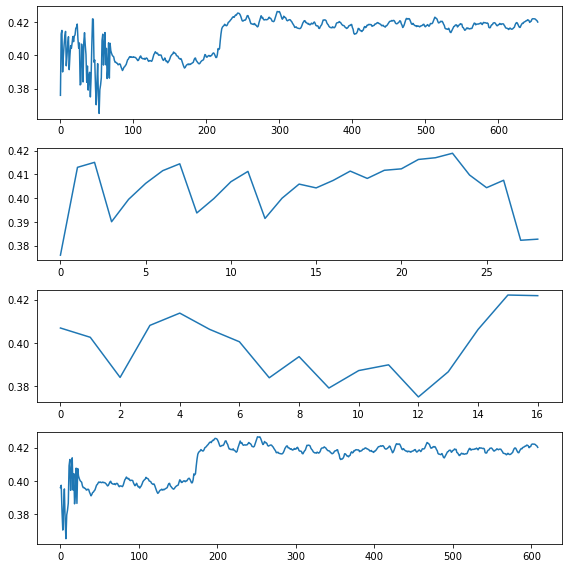

df_len_cnt: 18  H: 10  Total error: 16 Error check:  30.56741754198657 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.35626036089337065
df_len_cnt: 23  H: 10  Total error: 12 Error check:  141.84875231653845 True
******CHANGE TIMES
df_len_cnt: 27  H: 10  Total error: 12 Error check:  15.215120565112908 False
df_len_cnt: 55  H: 10  Total error: 12 Error check:  34.50209946598399 True
df_len_cnt: 215  H: 10  Total error: 10 Error check:  5423.907743139938 True
******CHANGE TIMES
ch_times :  [19, 216] ch_num :  2 Resist :  0.33459907831815167
df_len_cnt: 216  H: 10  Total error: 19 Error check:  68.63386038463966 True
******CHANGE TIMES
df_len_cnt: 217  H: 10  Total error: 17 Error check:  62.33227829265368 True
******CHANGE TIMES
df_len_cnt: 218  H: 10  Total error: 20 Error check:  39.23868772424572 True
******CHANGE TIMES
df_len_cnt: 219  H: 10  Total error: 20 Error check:  38.014976729239294 True
******CHANGE TIMES
df_len_cnt: 220  H: 10  Total error: 19 Error check

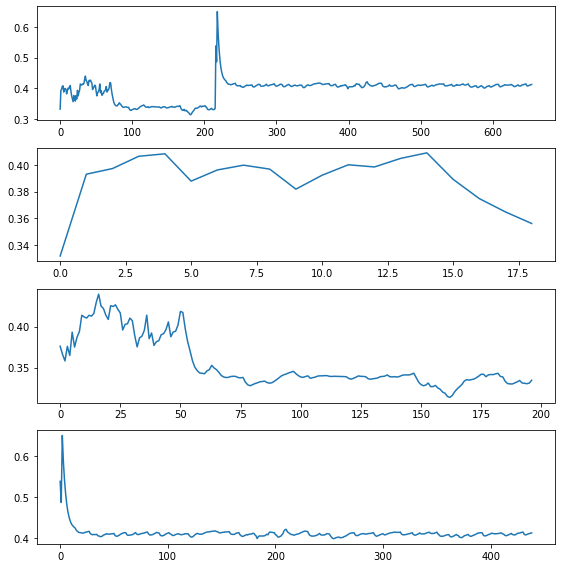

df_len_cnt: 18  H: 10  Total error: 3 Error check:  21.345575864095075 True
df_len_cnt: 22  H: 10  Total error: 6 Error check:  43.0136484103688 True
df_len_cnt: 25  H: 10  Total error: 7 Error check:  11.42032026195606 False
df_len_cnt: 37  H: 10  Total error: 2 Error check:  12.228044891815612 False
df_len_cnt: 38  H: 10  Total error: 5 Error check:  12.169914300241684 False
df_len_cnt: 51  H: 10  Total error: 5 Error check:  7.446228098987769 False
df_len_cnt: 52  H: 10  Total error: 6 Error check:  2.8409870084746482 False
df_len_cnt: 53  H: 10  Total error: 3 Error check:  1.4593374002555946 False
df_len_cnt: 60  H: 10  Total error: 5 Error check:  106.67880531480782 True
df_len_cnt: 61  H: 10  Total error: 6 Error check:  31.040243498544207 True
******CHANGE TIMES
ch_times :  [62] ch_num :  1 Resist :  0.38464924144312507
df_len_cnt: 65  H: 10  Total error: 4 Error check:  101.26272385171748 True
df_len_cnt: 215  H: 10  Total error: 7 Error check:  1422.0404568116091 True
df_len_

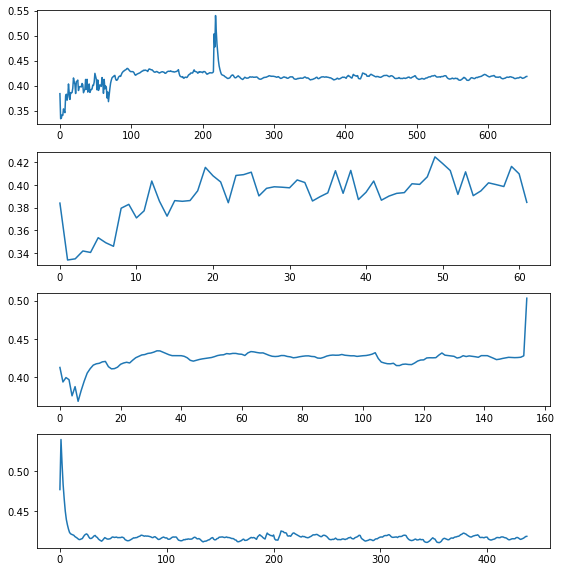

df_len_cnt: 28  H: 10  Total error: 14 Error check:  23.765423882528484 True
******CHANGE TIMES
ch_times :  [29] ch_num :  1 Resist :  0.39135675509427353
df_len_cnt: 44  H: 10  Total error: 17 Error check:  46.341369783935605 True
******CHANGE TIMES
ch_times :  [29, 45] ch_num :  2 Resist :  0.3472485413676143
df_len_cnt: 49  H: 10  Total error: 11 Error check:  333.7989510520705 True
******CHANGE TIMES
df_len_cnt: 50  H: 10  Total error: 11 Error check:  35.03448577255233 True
df_len_cnt: 56  H: 10  Total error: 7 Error check:  39.577304077877315 True
******CHANGE TIMES
ch_times :  [29, 45, 57] ch_num :  3 Resist :  0.4120543829421292
df_len_cnt: 57  H: 10  Total error: 12 Error check:  37.74281534729484 True
******CHANGE TIMES
df_len_cnt: 59  H: 10  Total error: 8 Error check:  60.862975410654585 True
******CHANGE TIMES
df_len_cnt: 60  H: 10  Total error: 13 Error check:  131.39392562420923 True
******CHANGE TIMES
df_len_cnt: 64  H: 10  Total error: 11 Error check:  37.1054192462890

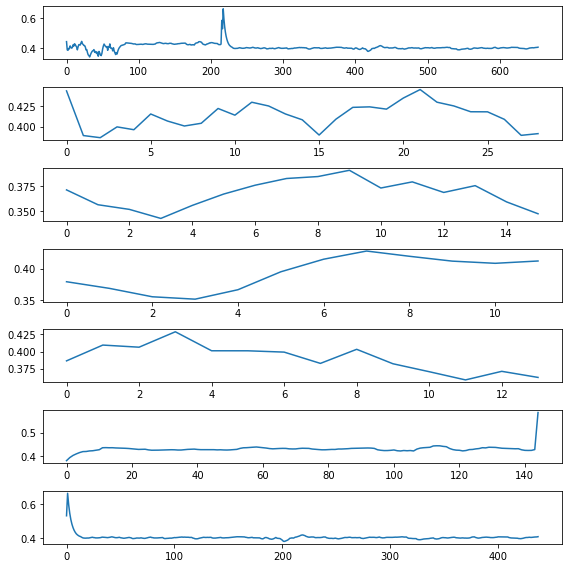

df_len_cnt: 17  H: 10  Total error: 6 Error check:  87.78990438381241 True
df_len_cnt: 23  H: 10  Total error: 10 Error check:  222.25690701496143 True
******CHANGE TIMES
ch_times :  [24] ch_num :  1 Resist :  0.41634119859693075
df_len_cnt: 25  H: 10  Total error: 14 Error check:  57.90726475949748 True
******CHANGE TIMES
df_len_cnt: 27  H: 10  Total error: 12 Error check:  116.7253705618982 True
******CHANGE TIMES
df_len_cnt: 32  H: 10  Total error: 11 Error check:  39.62308440475491 True
******CHANGE TIMES
df_len_cnt: 36  H: 10  Total error: 5 Error check:  16.130913894086994 False
df_len_cnt: 37  H: 10  Total error: 15 Error check:  12.36300913015901 False
df_len_cnt: 41  H: 10  Total error: 5 Error check:  41.581779304073144 True
df_len_cnt: 52  H: 10  Total error: 7 Error check:  1.2870862707193815 False
df_len_cnt: 53  H: 10  Total error: 4 Error check:  17.384486311737987 False
df_len_cnt: 54  H: 10  Total error: 8 Error check:  11.457209783320515 False
df_len_cnt: 62  H: 10  T

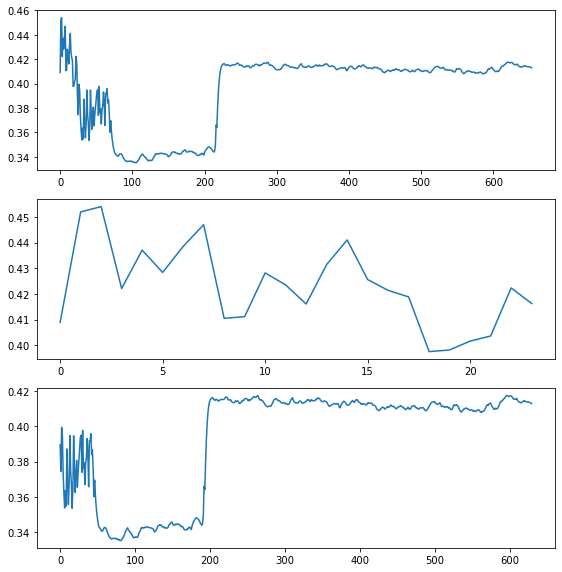

df_len_cnt: 18  H: 10  Total error: 6 Error check:  64.61281135191336 True
df_len_cnt: 22  H: 10  Total error: 6 Error check:  57.56107922201815 True
df_len_cnt: 26  H: 10  Total error: 6 Error check:  17.99276632429754 False
df_len_cnt: 30  H: 10  Total error: 7 Error check:  12.363339617455935 False
df_len_cnt: 40  H: 10  Total error: 17 Error check:  55.3354629213219 True
******CHANGE TIMES
ch_times :  [41] ch_num :  1 Resist :  0.3429933935707059
df_len_cnt: 45  H: 10  Total error: 6 Error check:  0.17646054339418377 False
df_len_cnt: 47  H: 10  Total error: 7 Error check:  33.285582299401426 True
df_len_cnt: 48  H: 10  Total error: 18 Error check:  14.104101216336536 False
df_len_cnt: 51  H: 10  Total error: 8 Error check:  96.3146576553262 True
******CHANGE TIMES
ch_times :  [41, 52] ch_num :  2 Resist :  0.39052125619120537
df_len_cnt: 55  H: 10  Total error: 11 Error check:  22.531287842341793 True
******CHANGE TIMES
df_len_cnt: 63  H: 10  Total error: 8 Error check:  100.59717

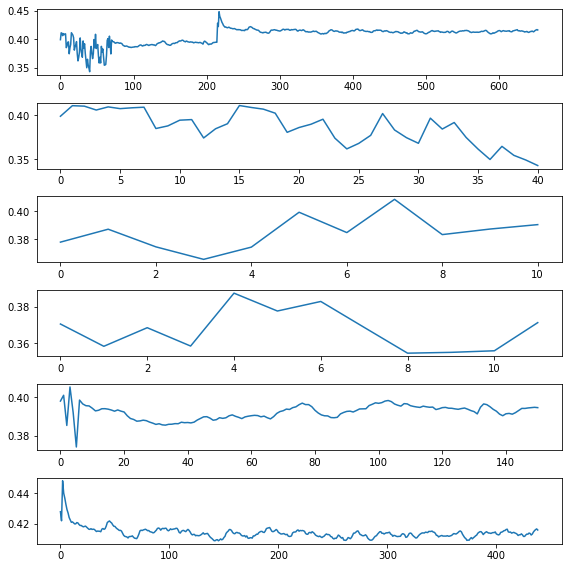

df_len_cnt: 17  H: 10  Total error: 9 Error check:  2.0012238069161628 False
df_len_cnt: 24  H: 10  Total error: 9 Error check:  74.80748825106707 True
df_len_cnt: 40  H: 10  Total error: 6 Error check:  20.50982968586615 True
df_len_cnt: 55  H: 10  Total error: 7 Error check:  28.565620029982526 True
******CHANGE TIMES
ch_times :  [56] ch_num :  1 Resist :  0.3379254622164158
df_len_cnt: 70  H: 10  Total error: 13 Error check:  510.01612469660864 True
******CHANGE TIMES
ch_times :  [56, 71] ch_num :  2 Resist :  0.36692564773180203
df_len_cnt: 71  H: 10  Total error: 18 Error check:  71.44089104804766 True
******CHANGE TIMES
df_len_cnt: 214  H: 10  Total error: 8 Error check:  11058.588745984756 True
df_len_cnt: 215  H: 10  Total error: 19 Error check:  40.776051077975104 True
******CHANGE TIMES
ch_times :  [56, 71, 216] ch_num :  3 Resist :  0.6387299381369538
df_len_cnt: 216  H: 10  Total error: 19 Error check:  25.70557987469589 True
******CHANGE TIMES
df_len_cnt: 217  H: 10  Total

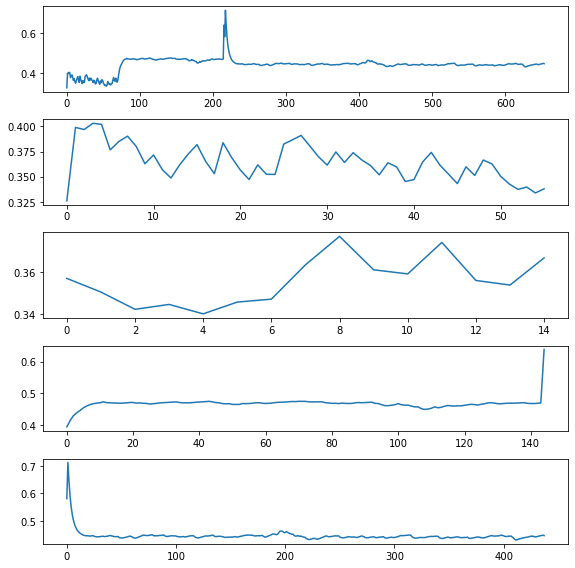

df_len_cnt: 38  H: 10  Total error: 8 Error check:  64.98878156776365 True
df_len_cnt: 47  H: 10  Total error: 6 Error check:  4.021507466894395 False
df_len_cnt: 63  H: 10  Total error: 8 Error check:  191.5089767084573 True
******CHANGE TIMES
ch_times :  [64] ch_num :  1 Resist :  0.33679747720626285
df_len_cnt: 66  H: 10  Total error: 11 Error check:  287.7408678447495 True
******CHANGE TIMES
df_len_cnt: 214  H: 10  Total error: 10 Error check:  8358.9188065407 True
******CHANGE TIMES
ch_times :  [64, 215] ch_num :  2 Resist :  0.4088792479305763
df_len_cnt: 215  H: 10  Total error: 19 Error check:  64.84274414834637 True
******CHANGE TIMES
df_len_cnt: 216  H: 10  Total error: 18 Error check:  59.93343636654569 True
******CHANGE TIMES
df_len_cnt: 217  H: 10  Total error: 20 Error check:  35.444488869647614 True
******CHANGE TIMES
df_len_cnt: 218  H: 10  Total error: 19 Error check:  31.699126122913235 True
******CHANGE TIMES
CHECK TIMES
[None, 64, 215, None]
adf
64
                K

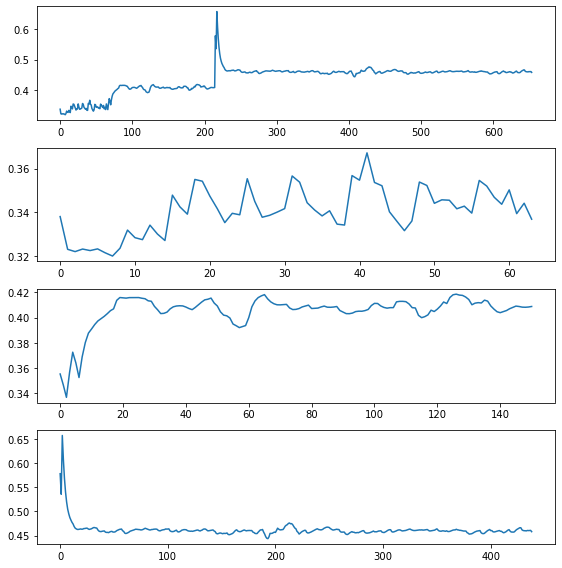

df_len_cnt: 42  H: 10  Total error: 3 Error check:  111.73804208106874 True
df_len_cnt: 60  H: 10  Total error: 2 Error check:  19.360699778053363 False
df_len_cnt: 65  H: 10  Total error: 7 Error check:  183.52489293386594 True
df_len_cnt: 187  H: 10  Total error: 2 Error check:  280.1059787346521 True
df_len_cnt: 214  H: 10  Total error: 7 Error check:  4212.7563733700745 True
df_len_cnt: 215  H: 10  Total error: 19 Error check:  36.90045797112537 True
******CHANGE TIMES
ch_times :  [216] ch_num :  1 Resist :  0.33514927945528256
df_len_cnt: 216  H: 10  Total error: 18 Error check:  18.008095009737634 False
df_len_cnt: 217  H: 10  Total error: 20 Error check:  3.9350814911288197 False
df_len_cnt: 218  H: 10  Total error: 19 Error check:  16.195798054098226 False
df_len_cnt: 410  H: 10  Total error: 3 Error check:  53.29957019793916 True
df_len_cnt: 416  H: 10  Total error: 8 Error check:  4.523894307295027 False
CHECK TIMES
[None, 216, None]
adf
216
                 KeyTime  ResistVa

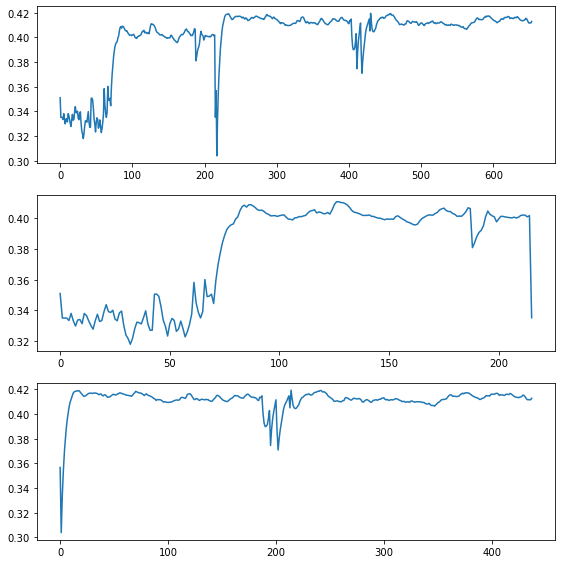

df_len_cnt: 28  H: 10  Total error: 6 Error check:  219.89818734017663 True
df_len_cnt: 29  H: 10  Total error: 6 Error check:  22.65871565847038 True
******CHANGE TIMES
ch_times :  [30] ch_num :  1 Resist :  0.3528861074530125
df_len_cnt: 38  H: 10  Total error: 16 Error check:  45.91695386628136 True
******CHANGE TIMES
df_len_cnt: 56  H: 10  Total error: 11 Error check:  38.14270885542872 True
******CHANGE TIMES
ch_times :  [30, 57] ch_num :  2 Resist :  0.3334029401098028
df_len_cnt: 61  H: 10  Total error: 2 Error check:  8.129412854345256 False
df_len_cnt: 214  H: 10  Total error: 10 Error check:  9098.455377445447 True
******CHANGE TIMES
ch_times :  [30, 57, 215] ch_num :  3 Resist :  0.31915626785063944
df_len_cnt: 215  H: 10  Total error: 20 Error check:  145.85907756952693 True
******CHANGE TIMES
CHECK TIMES
[None, 30, 57, 215, None]
adf
30
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-14 16:06:32     0.334000       4.51      -20.0
1   2020-02-15 04:05

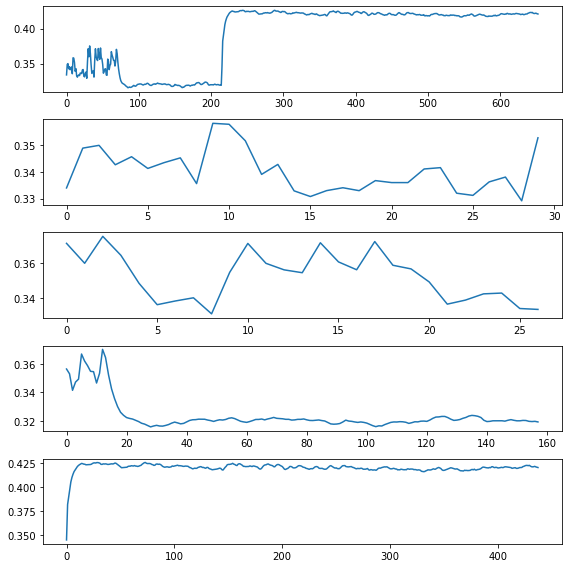

df_len_cnt: 23  H: 10  Total error: 14 Error check:  0.9534407668453313 False
df_len_cnt: 27  H: 10  Total error: 3 Error check:  128.73803428732938 True
df_len_cnt: 33  H: 10  Total error: 6 Error check:  103.71981265702735 True
df_len_cnt: 35  H: 10  Total error: 12 Error check:  28.418543156337545 True
******CHANGE TIMES
ch_times :  [36] ch_num :  1 Resist :  0.3821019560913853
df_len_cnt: 42  H: 10  Total error: 7 Error check:  1.7912270542352318 False
df_len_cnt: 48  H: 10  Total error: 5 Error check:  28.629669453251772 True
df_len_cnt: 51  H: 10  Total error: 8 Error check:  7.688290341625456 False
df_len_cnt: 58  H: 10  Total error: 11 Error check:  2.9574648791206135 False
df_len_cnt: 60  H: 10  Total error: 8 Error check:  3.3789025822988634 False
df_len_cnt: 65  H: 10  Total error: 4 Error check:  56.876392866157154 True
df_len_cnt: 214  H: 10  Total error: 10 Error check:  2420.5381693752543 True
******CHANGE TIMES
ch_times :  [36, 215] ch_num :  2 Resist :  0.3281211498171

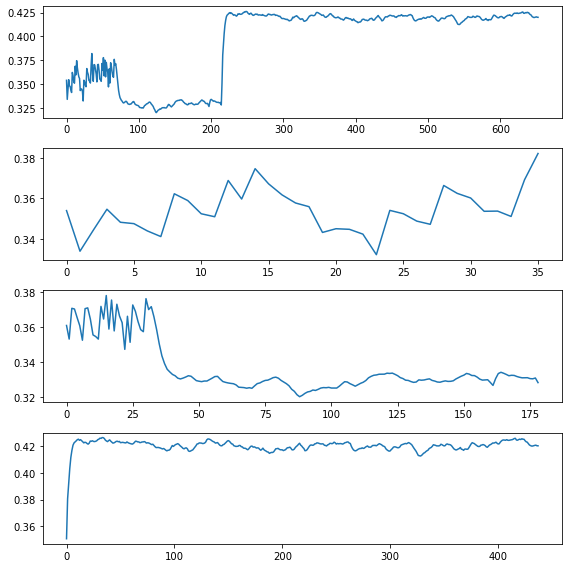

df_len_cnt: 18  H: 10  Total error: 13 Error check:  40.91299160521654 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.33285876422054567
df_len_cnt: 22  H: 10  Total error: 10 Error check:  65.8838828106455 True
******CHANGE TIMES
df_len_cnt: 28  H: 10  Total error: 9 Error check:  188.9373286331258 True
******CHANGE TIMES
df_len_cnt: 32  H: 10  Total error: 14 Error check:  29.190860761670447 True
******CHANGE TIMES
ch_times :  [19, 33] ch_num :  2 Resist :  0.38300857498227775
df_len_cnt: 46  H: 10  Total error: 6 Error check:  25.921315098443152 True
******CHANGE TIMES
ch_times :  [19, 33, 47] ch_num :  3 Resist :  0.3513763317717711
df_len_cnt: 51  H: 10  Total error: 11 Error check:  183.715507882341 True
******CHANGE TIMES
df_len_cnt: 215  H: 10  Total error: 11 Error check:  382.00378136360104 True
******CHANGE TIMES
ch_times :  [19, 33, 47, 216] ch_num :  4 Resist :  0.37448248199903905
CHECK TIMES
[None, 19, 33, 47, 216, None]
adf
19
                KeyTime  R

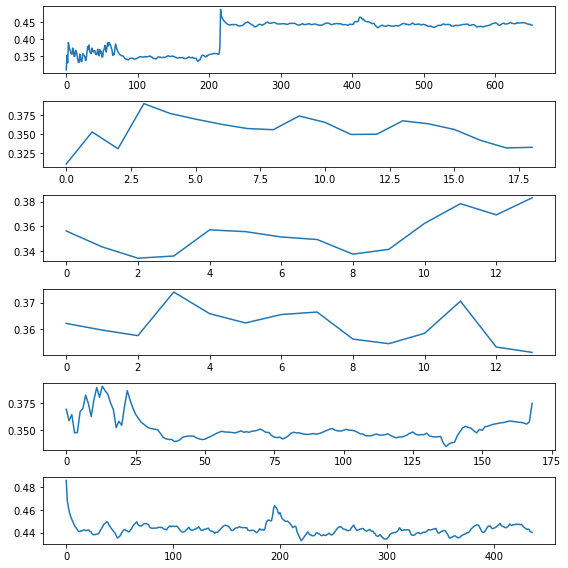

df_len_cnt: 21  H: 10  Total error: 5 Error check:  74.46080445605703 True
df_len_cnt: 26  H: 10  Total error: 14 Error check:  6.991016905510548 False
df_len_cnt: 36  H: 10  Total error: 4 Error check:  12.486752064200312 False
df_len_cnt: 37  H: 10  Total error: 9 Error check:  6.1211985929836885 False
df_len_cnt: 45  H: 10  Total error: 7 Error check:  8.852729241654893 False
df_len_cnt: 62  H: 10  Total error: 6 Error check:  503.44617417531833 True
df_len_cnt: 64  H: 10  Total error: 12 Error check:  67.64703884676338 True
******CHANGE TIMES
ch_times :  [65] ch_num :  1 Resist :  0.344240418312822
df_len_cnt: 214  H: 10  Total error: 10 Error check:  5306.3372187032055 True
******CHANGE TIMES
ch_times :  [65, 215] ch_num :  2 Resist :  0.3384576658592172
df_len_cnt: 215  H: 10  Total error: 16 Error check:  224.5358825195524 True
******CHANGE TIMES
CHECK TIMES
[None, 65, 215, None]
adf
65
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-14 16:06:32     0.4210

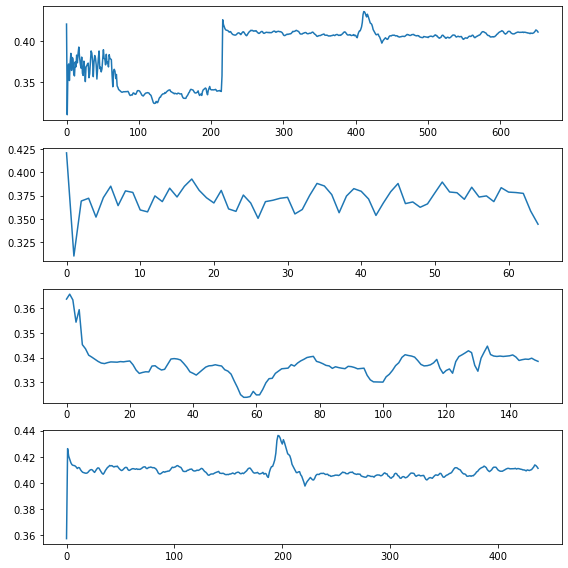

df_len_cnt: 18  H: 10  Total error: 15 Error check:  40.08201913264311 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.34668277662208846
df_len_cnt: 24  H: 10  Total error: 9 Error check:  10.36610096719855 False
df_len_cnt: 40  H: 10  Total error: 10 Error check:  62.46861624586083 True
******CHANGE TIMES
ch_times :  [19, 41] ch_num :  2 Resist :  0.39882618881270343
df_len_cnt: 55  H: 10  Total error: 6 Error check:  33.28753866145066 True
df_len_cnt: 66  H: 10  Total error: 8 Error check:  159.19851182691207 True
******CHANGE TIMES
ch_times :  [19, 41, 67] ch_num :  3 Resist :  0.3857264031342458
df_len_cnt: 214  H: 10  Total error: 10 Error check:  4280.17004645427 True
******CHANGE TIMES
ch_times :  [19, 41, 67, 215] ch_num :  4 Resist :  0.3510671544768637
df_len_cnt: 215  H: 10  Total error: 19 Error check:  98.52693763419575 True
******CHANGE TIMES
CHECK TIMES
[None, 19, 41, 67, 215, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   20

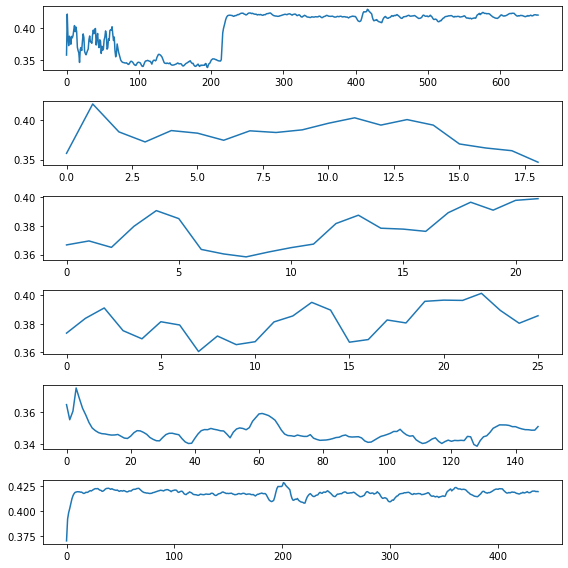

df_len_cnt: 67  H: 10  Total error: 12 Error check:  167.6297310136452 True
******CHANGE TIMES
ch_times :  [68] ch_num :  1 Resist :  0.4069123667205692
df_len_cnt: 70  H: 10  Total error: 13 Error check:  327.8073483453788 True
******CHANGE TIMES
df_len_cnt: 71  H: 10  Total error: 16 Error check:  130.3281924707158 True
******CHANGE TIMES
df_len_cnt: 214  H: 10  Total error: 10 Error check:  4619.161369282627 True
******CHANGE TIMES
ch_times :  [68, 215] ch_num :  2 Resist :  0.30882561715079515
df_len_cnt: 215  H: 10  Total error: 20 Error check:  57.51945000088078 True
******CHANGE TIMES
df_len_cnt: 216  H: 10  Total error: 20 Error check:  14.475170377848611 False
CHECK TIMES
[None, 68, 215, None]
adf
68
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-14 16:06:32     0.422000       4.46      -20.0
1   2020-02-15 04:05:35     0.356011       4.49      -20.0
2   2020-02-15 16:04:41     0.390050       4.45      -20.0
3   2020-02-16 04:03:44     0.358147       4.

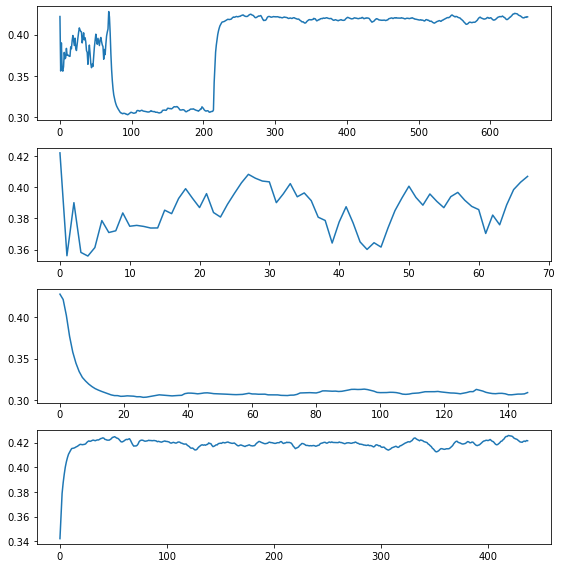

df_len_cnt: 31  H: 10  Total error: 9 Error check:  3.473142672149523 False
df_len_cnt: 67  H: 10  Total error: 14 Error check:  178.00941721386386 True
******CHANGE TIMES
ch_times :  [68] ch_num :  1 Resist :  0.35914983001848394
CHECK TIMES
[None, 68, None]
adf
68
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-14 16:06:32     0.379000       4.47       24.5
1   2020-02-15 04:05:35     0.418993       4.44      -20.0
2   2020-02-15 16:04:41     0.397522       4.49       24.4
3   2020-02-16 04:03:44     0.406541       4.47      -20.0
4   2020-02-16 16:02:52     0.411584       4.45      -20.0
..                  ...          ...        ...        ...
63  2020-03-20 02:14:32     0.377037       4.45      -20.0
64  2020-03-20 14:13:46     0.375947       4.47       24.8
65  2020-03-21 02:13:04     0.375691       4.47       24.8
66  2020-03-21 14:12:13     0.362537       4.46      -20.0
67  2020-03-22 02:11:24     0.359150       4.47      -20.0

[68 rows x 4 columns]
ad

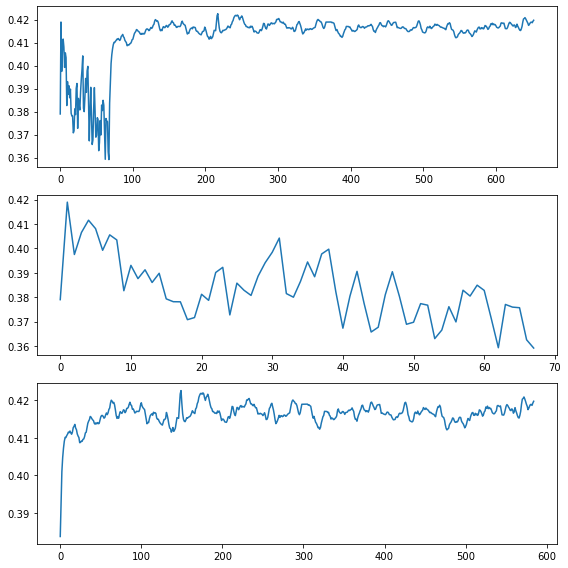

df_len_cnt: 19  H: 10  Total error: 12 Error check:  154.8482311253819 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.40526126476399366
df_len_cnt: 214  H: 10  Total error: 10 Error check:  1774.5368310516149 True
******CHANGE TIMES
ch_times :  [20, 215] ch_num :  2 Resist :  0.3561616848435803
CHECK TIMES
[None, 20, 215, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-14 16:06:32     0.380000       4.43      -20.0
1   2020-02-15 04:05:35     0.378000       4.48       24.3
2   2020-02-15 16:04:41     0.375381       4.44      -20.0
3   2020-02-16 04:03:44     0.366784       4.46      -20.0
4   2020-02-16 16:02:52     0.369790       4.47       24.5
5   2020-02-17 04:01:57     0.382703       4.45      -20.0
6   2020-02-17 16:01:03     0.380792       4.45      -20.0
7   2020-02-18 04:00:18     0.379738       4.48       24.3
8   2020-02-18 15:59:29     0.389137       4.45      -20.0
9   2020-02-19 03:58:42     0.376026       4.51      -2

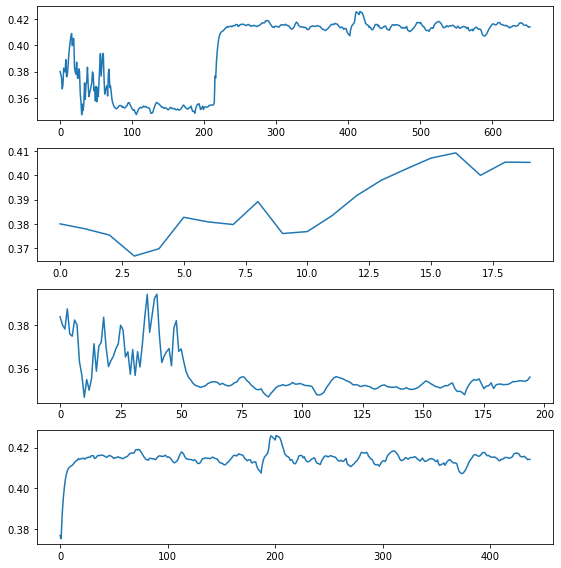

df_len_cnt: 35  H: 10  Total error: 10 Error check:  129.75080110760805 True
******CHANGE TIMES
ch_times :  [36] ch_num :  1 Resist :  0.34936187457638257
df_len_cnt: 42  H: 10  Total error: 10 Error check:  352.9924550136963 True
df_len_cnt: 43  H: 10  Total error: 14 Error check:  56.43983114826905 True
******CHANGE TIMES
df_len_cnt: 48  H: 10  Total error: 14 Error check:  21.10026783261449 True
******CHANGE TIMES
ch_times :  [36, 49] ch_num :  2 Resist :  0.3899723621989358
CHECK TIMES
[None, 36, 49, None]
adf
36
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-14 16:06:32     0.402000       4.45      -20.0
1   2020-02-15 04:05:35     0.374005       4.44      -20.0
2   2020-02-15 16:04:41     0.387620       4.44      -20.0
3   2020-02-16 04:03:44     0.400443       4.44      -20.0
4   2020-02-16 16:02:52     0.391491       4.46      -20.0
5   2020-02-17 04:01:57     0.371322       4.46      -20.0
6   2020-02-17 16:01:03     0.378643       4.43      -20.0
7   2

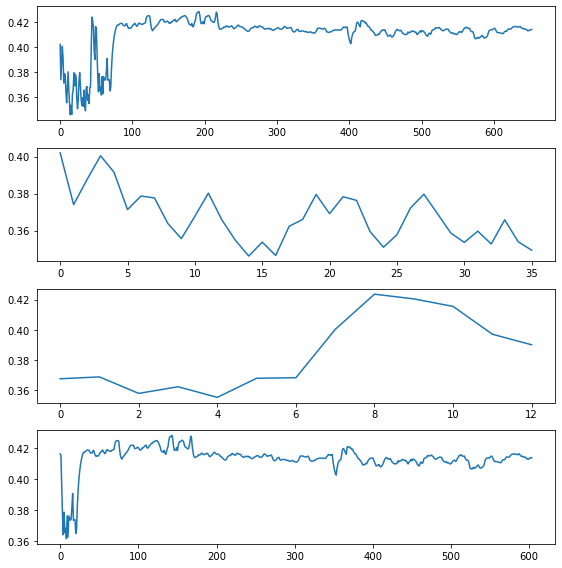

df_len_cnt: 31  H: 10  Total error: 5 Error check:  81.23683417612156 True
df_len_cnt: 38  H: 10  Total error: 11 Error check:  80.79338058782113 True
******CHANGE TIMES
ch_times :  [39] ch_num :  1 Resist :  0.36266919089765204
df_len_cnt: 44  H: 10  Total error: 16 Error check:  0.1681802492445076 False
df_len_cnt: 49  H: 10  Total error: 13 Error check:  212.8769603272735 True
******CHANGE TIMES
ch_times :  [39, 50] ch_num :  2 Resist :  0.40339698457599993
df_len_cnt: 60  H: 10  Total error: 15 Error check:  159.31588043326096 True
******CHANGE TIMES
ch_times :  [39, 50, 61] ch_num :  3 Resist :  0.342060469999919
df_len_cnt: 61  H: 10  Total error: 10 Error check:  53.45535843525514 True
df_len_cnt: 64  H: 10  Total error: 18 Error check:  25.539933991003654 True
******CHANGE TIMES
df_len_cnt: 214  H: 10  Total error: 10 Error check:  7196.881625436511 True
******CHANGE TIMES
ch_times :  [39, 50, 61, 215] ch_num :  4 Resist :  0.37547766977169644
df_len_cnt: 215  H: 10  Total erro

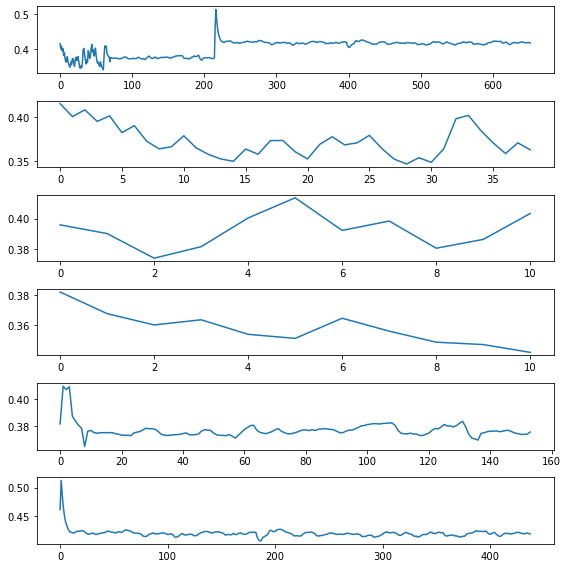

df_len_cnt: 23  H: 10  Total error: 8 Error check:  329.1424604638122 True
df_len_cnt: 28  H: 10  Total error: 6 Error check:  4.690087227595501 False
df_len_cnt: 30  H: 10  Total error: 14 Error check:  1.6124113816608154 False
df_len_cnt: 31  H: 10  Total error: 7 Error check:  28.438502929908566 True
df_len_cnt: 32  H: 10  Total error: 12 Error check:  30.139646582215523 True
******CHANGE TIMES
ch_times :  [33] ch_num :  1 Resist :  0.39689303966142603
df_len_cnt: 39  H: 10  Total error: 7 Error check:  13.179511367553287 False
df_len_cnt: 52  H: 10  Total error: 5 Error check:  51.994531830711935 True
df_len_cnt: 60  H: 10  Total error: 15 Error check:  75.50774618003128 True
******CHANGE TIMES
ch_times :  [33, 61] ch_num :  2 Resist :  0.35296860867774965
df_len_cnt: 61  H: 10  Total error: 7 Error check:  28.008784726758723 True
df_len_cnt: 63  H: 10  Total error: 9 Error check:  48.786503894342 True
******CHANGE TIMES
df_len_cnt: 65  H: 10  Total error: 9 Error check:  44.255829

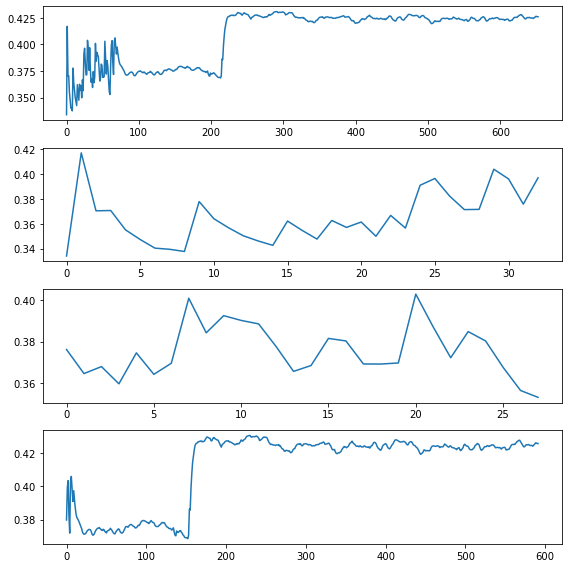

df_len_cnt: 19  H: 10  Total error: 6 Error check:  190.6889571169284 True
df_len_cnt: 23  H: 10  Total error: 7 Error check:  177.8529879864201 True
df_len_cnt: 27  H: 10  Total error: 15 Error check:  109.16088734479969 True
******CHANGE TIMES
ch_times :  [28] ch_num :  1 Resist :  0.3515331260623137
df_len_cnt: 34  H: 10  Total error: 6 Error check:  51.855965026211216 True
df_len_cnt: 39  H: 10  Total error: 6 Error check:  45.52616987032165 True
df_len_cnt: 46  H: 10  Total error: 11 Error check:  117.77782799706364 True
******CHANGE TIMES
ch_times :  [28, 47] ch_num :  2 Resist :  0.3580845284223873
df_len_cnt: 50  H: 10  Total error: 10 Error check:  203.58388982607528 True
df_len_cnt: 51  H: 10  Total error: 13 Error check:  42.40648636967158 True
******CHANGE TIMES
df_len_cnt: 53  H: 10  Total error: 19 Error check:  11.11289462751012 False
df_len_cnt: 56  H: 10  Total error: 9 Error check:  39.77159718938247 True
df_len_cnt: 65  H: 10  Total error: 17 Error check:  18.3674312

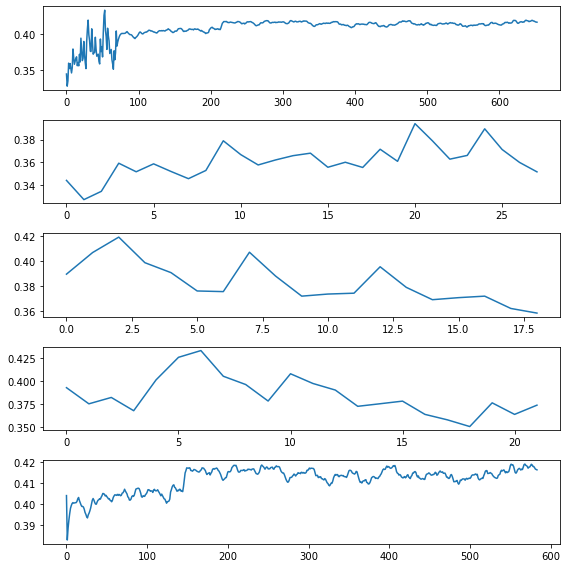

df_len_cnt: 16  H: 10  Total error: 16 Error check:  7.236321343965649 False
df_len_cnt: 17  H: 10  Total error: 10 Error check:  16.2848368370671 False
df_len_cnt: 20  H: 10  Total error: 11 Error check:  32.15249828136251 True
******CHANGE TIMES
ch_times :  [21] ch_num :  1 Resist :  0.4169616378094087
df_len_cnt: 22  H: 10  Total error: 11 Error check:  67.33767228347693 True
******CHANGE TIMES
df_len_cnt: 27  H: 10  Total error: 7 Error check:  31.36681586456828 True
******CHANGE TIMES
df_len_cnt: 33  H: 10  Total error: 12 Error check:  29.019427165673978 True
******CHANGE TIMES
ch_times :  [21, 34] ch_num :  2 Resist :  0.37156115119512134
df_len_cnt: 37  H: 10  Total error: 6 Error check:  29.50391822135429 True
df_len_cnt: 46  H: 10  Total error: 12 Error check:  29.797589082189436 True
******CHANGE TIMES
ch_times :  [21, 34, 47] ch_num :  3 Resist :  0.37436306164017724
df_len_cnt: 54  H: 10  Total error: 5 Error check:  81.91187888317369 True
df_len_cnt: 68  H: 10  Total erro

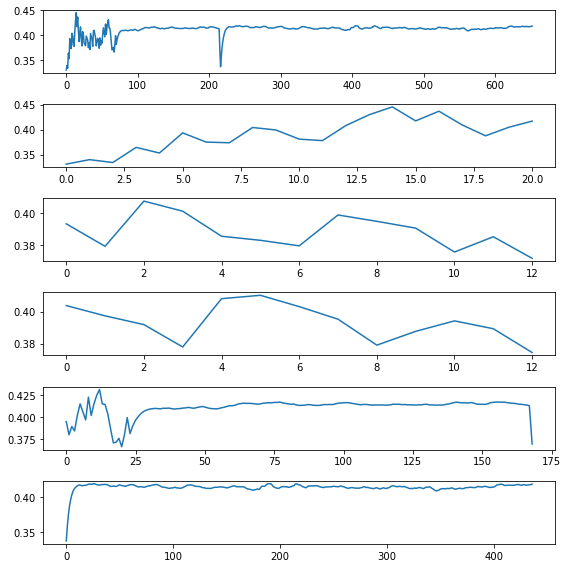

df_len_cnt: 22  H: 10  Total error: 13 Error check:  27.90068935389404 True
******CHANGE TIMES
ch_times :  [23] ch_num :  1 Resist :  0.367761189985392
df_len_cnt: 25  H: 10  Total error: 11 Error check:  35.52305275826851 True
******CHANGE TIMES
df_len_cnt: 26  H: 10  Total error: 9 Error check:  15.785553527849636 False
df_len_cnt: 33  H: 10  Total error: 12 Error check:  24.50524346080027 True
******CHANGE TIMES
ch_times :  [23, 34] ch_num :  2 Resist :  0.37183001231447854
df_len_cnt: 35  H: 10  Total error: 5 Error check:  2.019968150229917 False
df_len_cnt: 38  H: 10  Total error: 13 Error check:  5.57155949647833 False
df_len_cnt: 40  H: 10  Total error: 3 Error check:  1.5168248256099064 False
df_len_cnt: 44  H: 10  Total error: 14 Error check:  21.743425508275095 True
******CHANGE TIMES
ch_times :  [23, 34, 45] ch_num :  3 Resist :  0.3704457166793292
df_len_cnt: 49  H: 10  Total error: 17 Error check:  25.79321687827888 True
******CHANGE TIMES
df_len_cnt: 53  H: 10  Total err

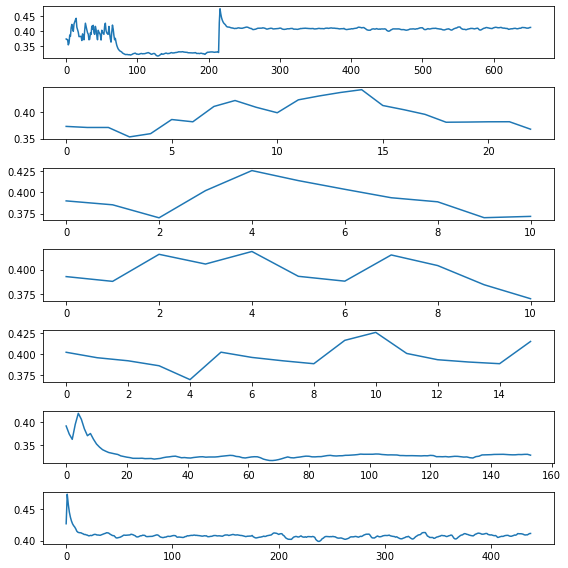

df_len_cnt: 16  H: 10  Total error: 10 Error check:  59.55384321072007 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.4116503512624091
df_len_cnt: 17  H: 10  Total error: 13 Error check:  229.6499531324874 True
******CHANGE TIMES
df_len_cnt: 25  H: 10  Total error: 10 Error check:  27.44697022663638 True
******CHANGE TIMES
df_len_cnt: 30  H: 10  Total error: 13 Error check:  103.23252369364369 True
******CHANGE TIMES
ch_times :  [17, 31] ch_num :  2 Resist :  0.3647069233721186
df_len_cnt: 32  H: 10  Total error: 6 Error check:  146.4210351897807 True
df_len_cnt: 36  H: 10  Total error: 6 Error check:  15.845724985571186 False
df_len_cnt: 38  H: 10  Total error: 8 Error check:  28.651643622266924 True
******CHANGE TIMES
df_len_cnt: 40  H: 10  Total error: 15 Error check:  40.009289270893305 True
******CHANGE TIMES
df_len_cnt: 41  H: 10  Total error: 5 Error check:  22.034875845714225 True
df_len_cnt: 42  H: 10  Total error: 9 Error check:  20.997951381597687 True
****

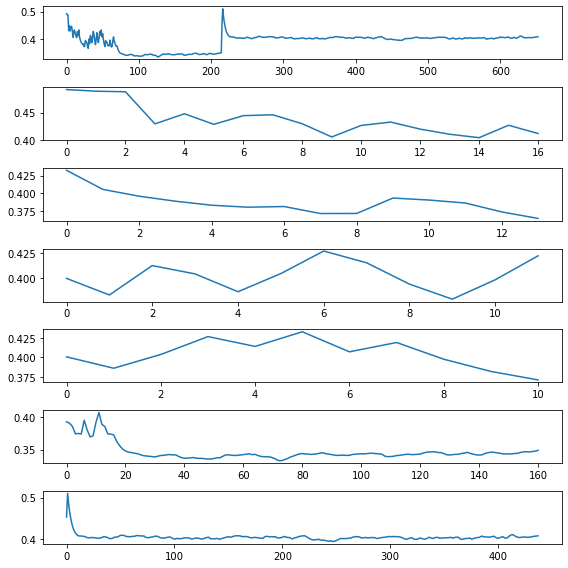

df_len_cnt: 16  H: 10  Total error: 4 Error check:  0.08363145818099463 False
df_len_cnt: 21  H: 10  Total error: 16 Error check:  19.814162025366468 False
df_len_cnt: 24  H: 10  Total error: 8 Error check:  9.552844853726135 False
df_len_cnt: 30  H: 10  Total error: 13 Error check:  5.960207236692232 False
df_len_cnt: 32  H: 10  Total error: 8 Error check:  15.379488326966825 False
df_len_cnt: 36  H: 10  Total error: 3 Error check:  8.608990546792066 False
df_len_cnt: 41  H: 10  Total error: 6 Error check:  4.622536079683255 False
df_len_cnt: 45  H: 10  Total error: 6 Error check:  30.032714019282707 True
df_len_cnt: 47  H: 10  Total error: 5 Error check:  33.633658971325424 True
df_len_cnt: 55  H: 10  Total error: 6 Error check:  15.070834708515193 False
df_len_cnt: 62  H: 10  Total error: 14 Error check:  92.28408900965312 True
******CHANGE TIMES
ch_times :  [63] ch_num :  1 Resist :  0.3470536563853662
df_len_cnt: 66  H: 10  Total error: 7 Error check:  25.147125908303096 True
****

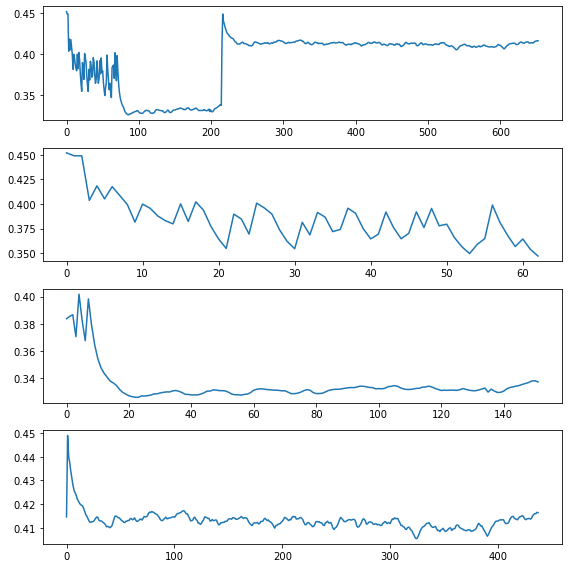

df_len_cnt: 17  H: 10  Total error: 6 Error check:  1559.3875694784774 True
df_len_cnt: 55  H: 10  Total error: 2 Error check:  332.51289658822276 True
df_len_cnt: 62  H: 10  Total error: 5 Error check:  203.75532760098457 True
df_len_cnt: 214  H: 10  Total error: 10 Error check:  2040.9347127350106 True
******CHANGE TIMES
ch_times :  [215] ch_num :  1 Resist :  0.37491464561115384
df_len_cnt: 215  H: 10  Total error: 11 Error check:  82.97317569958393 True
******CHANGE TIMES
CHECK TIMES
[None, 215, None]
adf
215
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.390000       4.51      -20.0
1    2020-02-15 04:05:35     0.382001       4.50      -20.0
2    2020-02-15 16:04:41     0.382001       4.51      -20.0
3    2020-02-16 04:03:44     0.377775       4.47      -20.0
4    2020-02-16 16:02:52     0.379806       4.50      -20.0
..                   ...          ...        ...        ...
210  2020-06-29 16:58:43     0.371987       4.48      -20.0
2

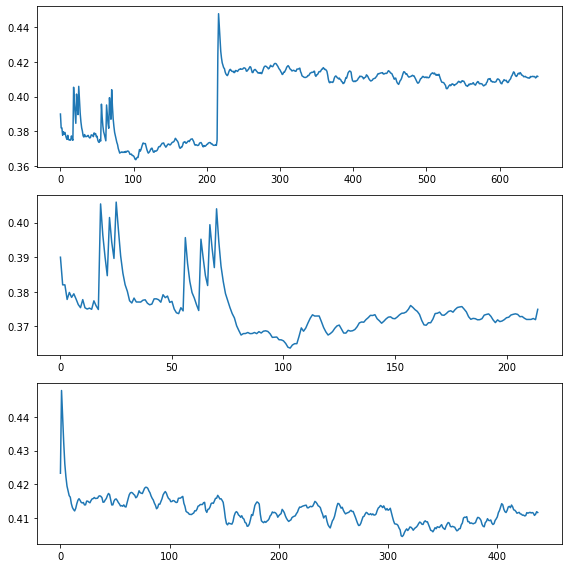

df_len_cnt: 21  H: 10  Total error: 4 Error check:  4.642868926851558 False
df_len_cnt: 32  H: 10  Total error: 8 Error check:  3.1373305021839606 False
df_len_cnt: 36  H: 10  Total error: 3 Error check:  53.92926536406713 True
df_len_cnt: 41  H: 10  Total error: 5 Error check:  83.15313671325666 True
df_len_cnt: 45  H: 10  Total error: 2 Error check:  67.78412363327519 True
df_len_cnt: 55  H: 10  Total error: 7 Error check:  28.125862402574253 True
df_len_cnt: 62  H: 10  Total error: 5 Error check:  192.80444523235914 True
CHECK TIMES
[None, None]
adf
None
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.377000       4.49      -20.0
1    2020-02-15 04:05:35     0.372001       4.49      -20.0
2    2020-02-15 16:04:41     0.373048       4.50      -20.0
3    2020-02-16 04:03:44     0.416054       4.50      -20.0
4    2020-02-16 16:02:52     0.403314       4.50      -20.0
..                   ...          ...        ...        ...
648  2021-02-01 

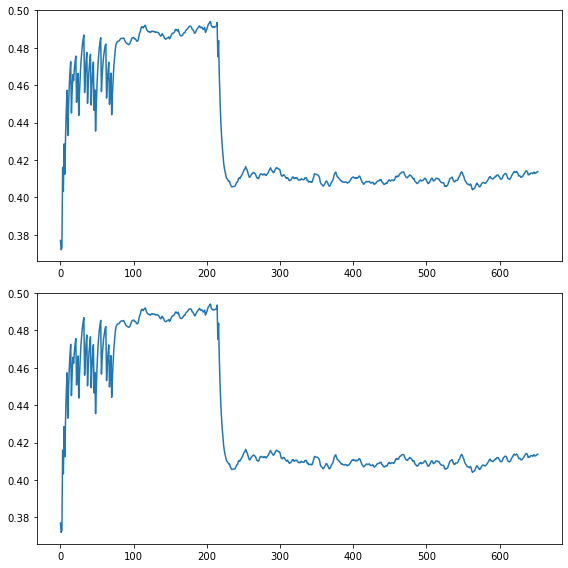

CHECK TIMES
[None, None]
adf
None
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.452000       4.49      -20.0
1    2020-02-15 04:05:35     0.449000       4.48      -20.0
2    2020-02-15 16:04:41     0.449000       4.49      -20.0
3    2020-02-16 04:03:44     0.448616       4.49      -20.0
4    2020-02-16 16:02:52     0.448741       4.49      -20.0
..                   ...          ...        ...        ...
647  2021-02-01 08:51:45     0.416323       4.50      -20.0
648  2021-02-01 20:51:10     0.415155       4.49      -20.0
649  2021-02-02 08:50:36     0.414303       4.49      -20.0
650  2021-02-02 20:50:08     0.414221       4.50      -20.0
651  2021-02-03 08:49:36     0.414431       4.50      -20.0

[652 rows x 4 columns]


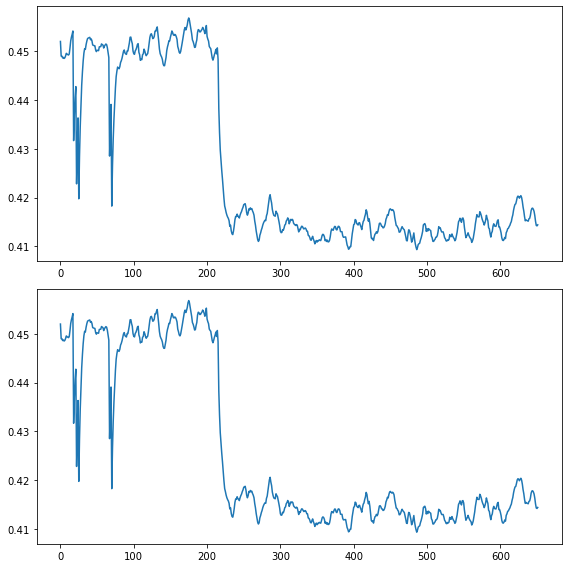

df_len_cnt: 214  H: 10  Total error: 10 Error check:  3080.27750834223 True
******CHANGE TIMES
ch_times :  [215] ch_num :  1 Resist :  0.38529840127688353
CHECK TIMES
[None, 215, None]
adf
215
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.390000       4.51      -20.0
1    2020-02-15 04:05:35     0.382001       4.50      -20.0
2    2020-02-15 16:04:41     0.382001       4.50      -20.0
3    2020-02-16 04:03:44     0.382769       4.51      -20.0
4    2020-02-16 16:02:52     0.383170       4.51      -20.0
..                   ...          ...        ...        ...
210  2020-06-29 16:58:43     0.383686       4.48      -20.0
211  2020-06-30 04:58:17     0.383500       4.49      -20.0
212  2020-06-30 16:57:51     0.384176       4.48      -20.0
213  2020-07-01 04:57:12     0.384669       4.48      -20.0
214  2020-07-01 11:53:27     0.385298       4.49      -20.0

[215 rows x 4 columns]
adf
None
                 KeyTime  ResistValue  VoltValue  Temp

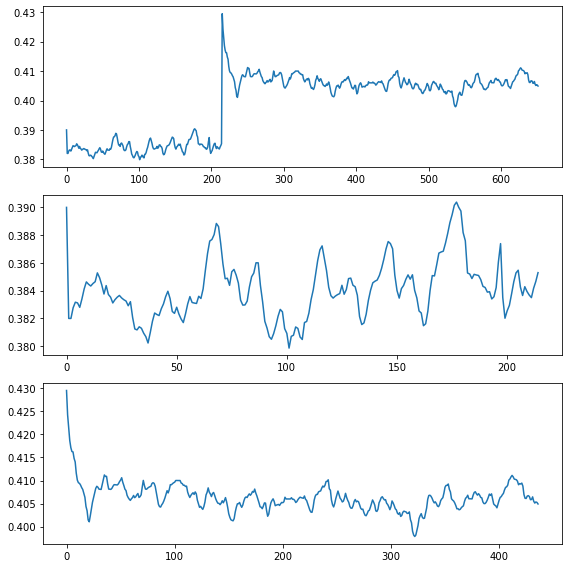

df_len_cnt: 214  H: 10  Total error: 10 Error check:  5718.45445974932 True
******CHANGE TIMES
ch_times :  [215] ch_num :  1 Resist :  0.3746882310667704
CHECK TIMES
[None, 215, None]
adf
215
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-14 16:06:32     0.377000       4.49      -20.0
1    2020-02-15 04:05:35     0.372001       4.49      -20.0
2    2020-02-15 16:04:41     0.373048       4.50      -20.0
3    2020-02-16 04:03:44     0.374566       4.50      -20.0
4    2020-02-16 16:02:52     0.375360       4.48      -20.0
..                   ...          ...        ...        ...
210  2020-06-29 16:58:43     0.374233       4.47      -20.0
211  2020-06-30 04:58:17     0.373630       4.47      -20.0
212  2020-06-30 16:57:51     0.373730       4.47      -20.0
213  2020-07-01 04:57:12     0.372722       4.48      -20.0
214  2020-07-01 11:53:27     0.374688       4.47      -20.0

[215 rows x 4 columns]
adf
None
                 KeyTime  ResistValue  VoltValue  TempV

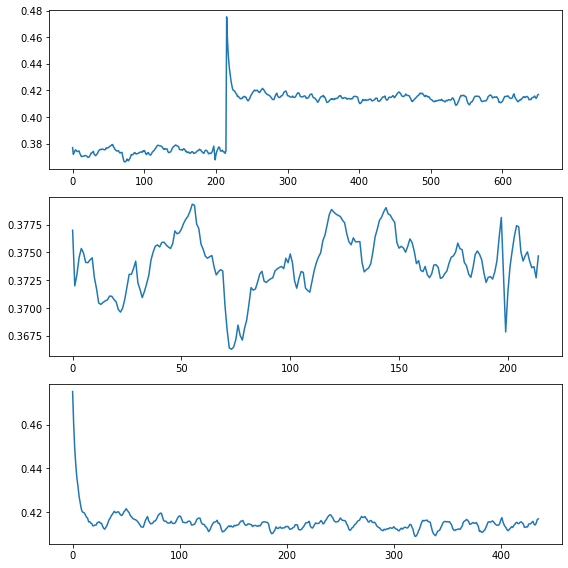

m2_s2_bank_b52ed68c11136d45b8ce552e5f1d588a__site_40ab7c891c559b478e96f8bb5c682ca0
df_len_cnt: 16  H: 10  Total error: 10 Error check:  13639.009443836596 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.15810375360338
df_len_cnt: 17  H: 10  Total error: 20 Error check:  97.0509987719464 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  10.65437975316855 False
df_len_cnt: 19  H: 10  Total error: 20 Error check:  46.88276385643246 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  64.03074609332039 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 11 Error check:  318.1176202595843 True
******CHANGE TIMES
ch_times :  [17, 227] ch_num :  2 Resist :  0.580623656915022
df_len_cnt: 229  H: 10  Total error: 18 Error check:  102.75444689162079 True
******CHANGE TIMES
df_len_cnt: 230  H: 10  Total error: 20 Error check:  8.295613048115698 False
CHECK TIMES
[None, 17, 227, None]
adf
17
                KeyTime  Resis

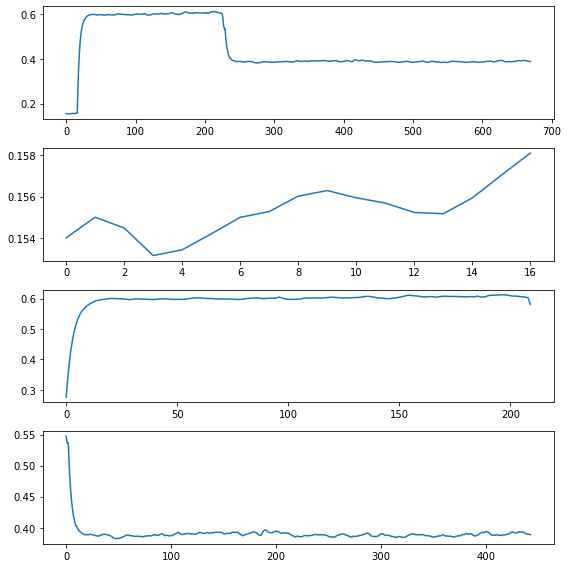

df_len_cnt: 16  H: 10  Total error: 10 Error check:  6081.601451502725 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.40316708005534546
df_len_cnt: 17  H: 10  Total error: 20 Error check:  95.63675638889961 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  13.171720781818413 False
df_len_cnt: 224  H: 10  Total error: 10 Error check:  4689.086693176771 True
******CHANGE TIMES
ch_times :  [17, 225] ch_num :  2 Resist :  0.5913099537616621
df_len_cnt: 225  H: 10  Total error: 20 Error check:  172.78691880104782 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 225, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.403000       4.49      -20.0
1   2020-02-13 01:38:01     0.404000       4.49      -20.0
2   2020-02-13 13:37:15     0.405047       4.49      -20.0
3   2020-02-14 01:36:29     0.405798       4.49      -20.0
4   2020-02-14 13:35:57     0.406190       4.49      -20.0
5   2020-02-15 01:35:0

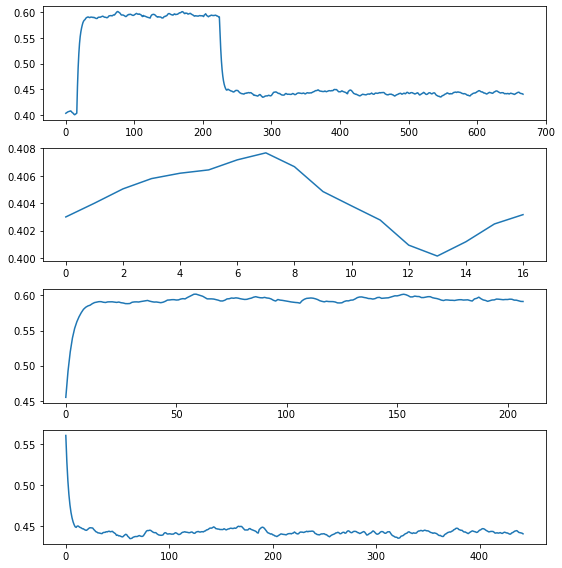

df_len_cnt: 16  H: 10  Total error: 10 Error check:  3776.777173567963 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.40647353026910765
df_len_cnt: 17  H: 10  Total error: 20 Error check:  80.43372693427477 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  16.612858080701912 False
df_len_cnt: 224  H: 10  Total error: 10 Error check:  11650.254812668756 True
******CHANGE TIMES
ch_times :  [17, 225] ch_num :  2 Resist :  0.5966219279186408
df_len_cnt: 225  H: 10  Total error: 20 Error check:  144.12571367025024 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 225, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.399000       4.47      -20.0
1   2020-02-13 01:38:01     0.401000       4.48      -20.0
2   2020-02-13 13:37:15     0.400476       4.48      -20.0
3   2020-02-14 01:36:29     0.400293       4.48      -20.0
4   2020-02-14 13:35:57     0.400198       4.48      -20.0
5   2020-02-15 01:35:

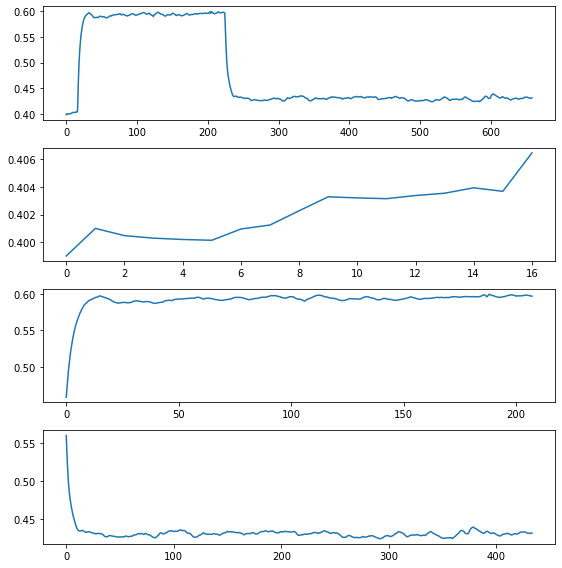

df_len_cnt: 16  H: 10  Total error: 10 Error check:  4987.160565943942 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.38693643282499707
df_len_cnt: 17  H: 10  Total error: 20 Error check:  112.529761436523 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  7.427568289423349 False
df_len_cnt: 224  H: 10  Total error: 10 Error check:  323.88919296247326 True
******CHANGE TIMES
ch_times :  [17, 225] ch_num :  2 Resist :  0.583556592309809
df_len_cnt: 225  H: 10  Total error: 20 Error check:  22.54828761981727 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 225, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.394000       4.47      -20.0
1   2020-02-13 01:38:01     0.391000       4.47      -20.0
2   2020-02-13 13:37:15     0.390476       4.49      -20.0
3   2020-02-14 01:36:29     0.389141       4.48      -20.0
4   2020-02-14 13:35:57     0.388769       4.49      -20.0
5   2020-02-15 01:35:07  

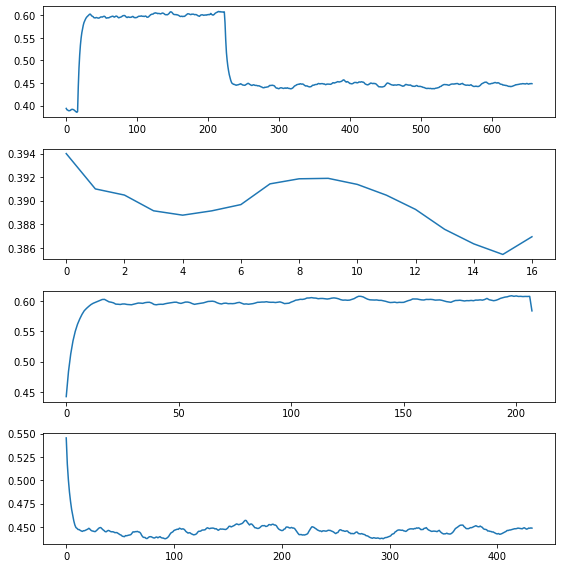

df_len_cnt: 16  H: 10  Total error: 10 Error check:  27662.36563913116 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.32955018506450573
df_len_cnt: 17  H: 10  Total error: 20 Error check:  97.62277826834035 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  11.89784929864744 False
df_len_cnt: 19  H: 10  Total error: 20 Error check:  46.77518390857709 True
******CHANGE TIMES
df_len_cnt: 223  H: 10  Total error: 10 Error check:  6216.642394973213 True
******CHANGE TIMES
ch_times :  [17, 224] ch_num :  2 Resist :  0.6046317359653505
CHECK TIMES
[None, 17, 224, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.331000       4.49      -20.0
1   2020-02-13 01:38:01     0.332000       4.48      -20.0
2   2020-02-13 13:37:15     0.329905       4.50      -20.0
3   2020-02-14 01:36:29     0.329557       4.50      -20.0
4   2020-02-14 13:35:57     0.329375       4.50      -20.0
5   2020-02-15 01:35:07  

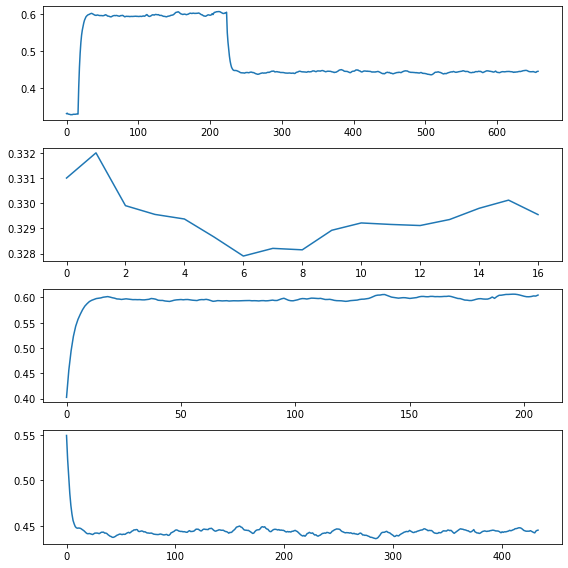

df_len_cnt: 17  H: 10  Total error: 10 Error check:  2731.9336473825056 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.3338726988165407
df_len_cnt: 18  H: 10  Total error: 20 Error check:  82.16014364259973 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  15.6266772651699 False
df_len_cnt: 20  H: 10  Total error: 20 Error check:  48.514955591509654 True
******CHANGE TIMES
df_len_cnt: 224  H: 10  Total error: 10 Error check:  2713.146751527316 True
******CHANGE TIMES
ch_times :  [18, 225] ch_num :  2 Resist :  0.5918734292431401
df_len_cnt: 225  H: 10  Total error: 20 Error check:  95.15848150875752 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 225, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.314000       4.47      -20.0
1   2020-02-13 01:38:01     0.315000       4.47      -20.0
2   2020-02-13 13:37:15     0.316571       4.49      -20.0
3   2020-02-14 01:36:29     0.318657       4.49

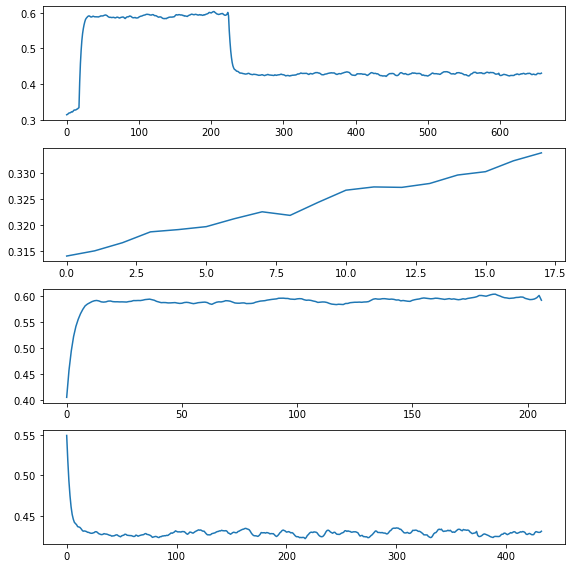

df_len_cnt: 17  H: 10  Total error: 10 Error check:  3814.5484433406978 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.40014996685265725
df_len_cnt: 18  H: 10  Total error: 20 Error check:  87.35427832603764 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  13.511055068806389 False
df_len_cnt: 223  H: 10  Total error: 9 Error check:  1622.9786940540346 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.5898818955589414
df_len_cnt: 224  H: 10  Total error: 20 Error check:  301.0916025338749 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 11 Error check:  406.4779134231518 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.387000       4.48      -20.0
1   2020-02-13 01:38:01     0.384000       4.49      -20.0
2   2020-02-13 13:37:15     0.385572       4.49      -20.0
3   2020-02-14 01:36:29     0.386889       4

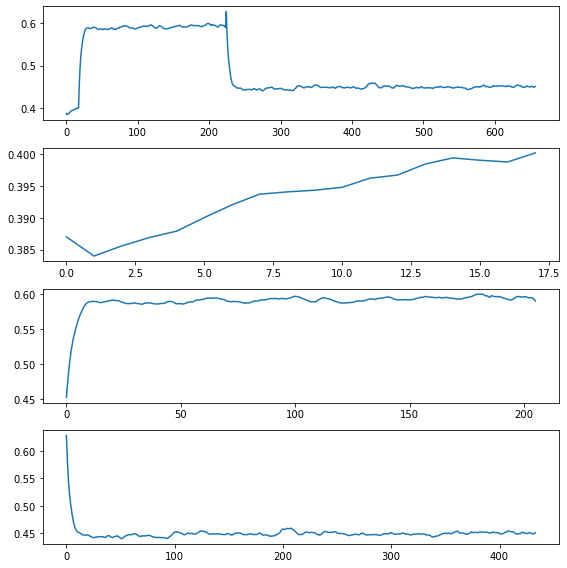

df_len_cnt: 17  H: 10  Total error: 10 Error check:  6766.612854882101 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.39454504342715774
df_len_cnt: 18  H: 10  Total error: 20 Error check:  104.98213002900903 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  6.029442465866362 False
df_len_cnt: 224  H: 10  Total error: 10 Error check:  590.6655506945455 True
******CHANGE TIMES
ch_times :  [18, 225] ch_num :  2 Resist :  0.6225416610432263
df_len_cnt: 225  H: 10  Total error: 18 Error check:  182.88876965291405 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 225, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.379000       4.47      -20.0
1   2020-02-13 01:38:01     0.391998       4.47      -20.0
2   2020-02-13 13:37:15     0.394618       4.49      -20.0
3   2020-02-14 01:36:29     0.397454       4.48      -20.0
4   2020-02-14 13:35:57     0.398937       4.47      -20.0
5   2020-02-15 01:35:0

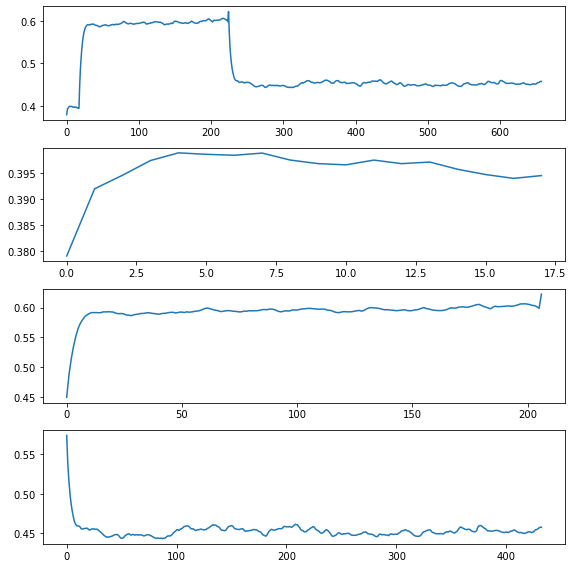

df_len_cnt: 17  H: 10  Total error: 10 Error check:  3945.086353415929 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.36356289483136084
df_len_cnt: 18  H: 10  Total error: 20 Error check:  113.24233533642321 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  6.844779956909082 False
df_len_cnt: 20  H: 10  Total error: 20 Error check:  44.35676242869746 True
******CHANGE TIMES
df_len_cnt: 223  H: 10  Total error: 10 Error check:  5096.204094700499 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.614408927756106
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.362000       4.48      -20.0
1   2020-02-13 01:38:01     0.365999       4.49      -20.0
2   2020-02-13 13:37:15     0.367047       4.49      -20.0
3   2020-02-14 01:36:29     0.367029       4.48      -20.0
4   2020-02-14 13:35:57     0.367020       4.49      -20.0
5   2020-02-15 01:35:07  

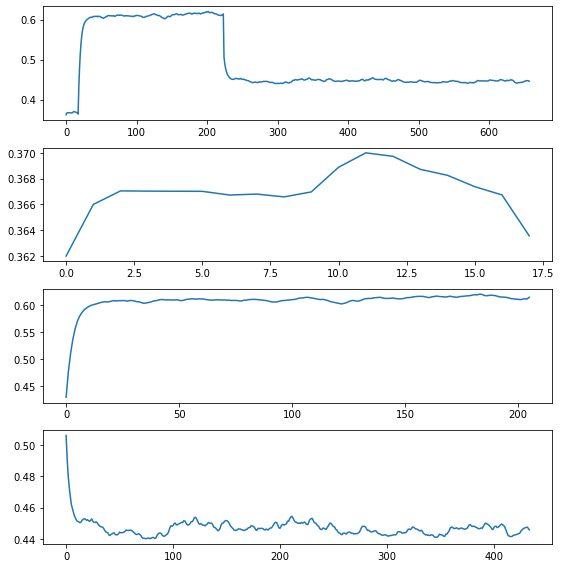

df_len_cnt: 17  H: 10  Total error: 10 Error check:  7969.160725210848 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.31365972312839874
df_len_cnt: 18  H: 10  Total error: 20 Error check:  98.1889961726752 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  11.137073992048858 False
df_len_cnt: 20  H: 10  Total error: 20 Error check:  48.1119166460878 True
******CHANGE TIMES
df_len_cnt: 223  H: 10  Total error: 10 Error check:  5858.25659440473 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.6086472354838002
df_len_cnt: 224  H: 10  Total error: 20 Error check:  96.37740125298025 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.316000       4.45      -20.0
1   2020-02-13 01:38:01     0.302002       4.46      -20.0
2   2020-02-13 13:37:15     0.306191       4.46      -20.0
3   2020-02-14 01:36:29     0.307654       4.46  

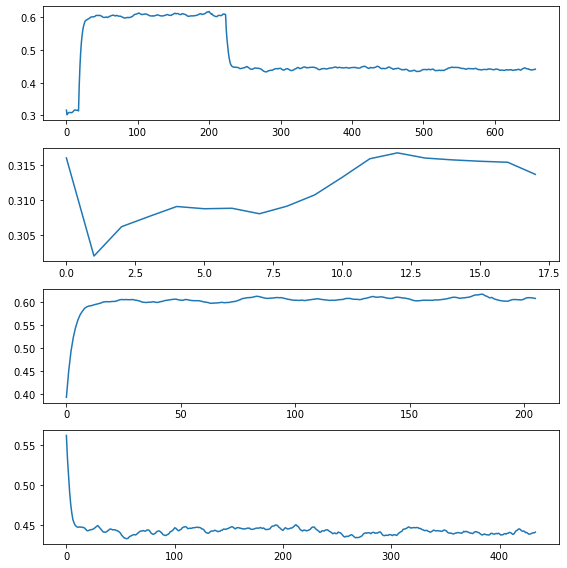

df_len_cnt: 17  H: 10  Total error: 10 Error check:  8389.111063851551 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.3180235010238521
df_len_cnt: 18  H: 10  Total error: 20 Error check:  103.88189465625355 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  11.608933276888449 False
df_len_cnt: 20  H: 10  Total error: 20 Error check:  48.837969840836124 True
******CHANGE TIMES
df_len_cnt: 223  H: 10  Total error: 10 Error check:  6226.234793061132 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.6146887678144554
df_len_cnt: 224  H: 10  Total error: 20 Error check:  48.87410257202563 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.313000       4.49      -20.0
1   2020-02-13 01:38:01     0.317999       4.50      -20.0
2   2020-02-13 13:37:15     0.318523       4.49      -20.0
3   2020-02-14 01:36:29     0.317554       4.

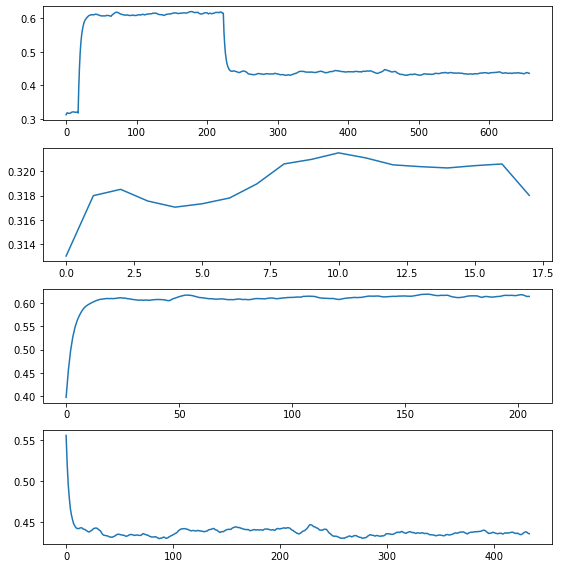

df_len_cnt: 17  H: 10  Total error: 10 Error check:  7137.767531981131 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.36330380203792706
df_len_cnt: 18  H: 10  Total error: 20 Error check:  97.32328853022506 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  11.557700365678587 False
df_len_cnt: 223  H: 10  Total error: 9 Error check:  2776.7065803901814 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.5988927463158095
df_len_cnt: 224  H: 10  Total error: 13 Error check:  371.4402302587094 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 11 Error check:  271.6193060892946 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 20 Error check:  7.838141771425238 False
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.361000       4.48      -20.0
1   2020-02-13 01:38:01     0.365999       4.49      -20.0
2   2020-02-13 13:37:15   

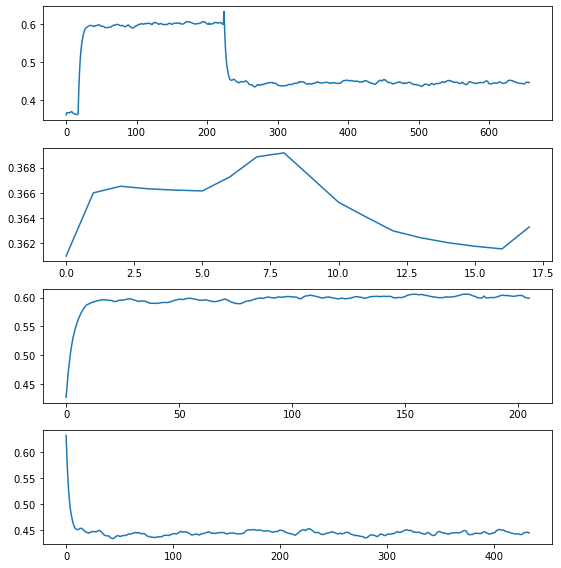

df_len_cnt: 17  H: 10  Total error: 10 Error check:  2846.5831793281145 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.3759576894795556
df_len_cnt: 18  H: 10  Total error: 20 Error check:  118.1824641935922 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  4.481866884832146 False
df_len_cnt: 223  H: 10  Total error: 10 Error check:  9330.633694377906 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.6106289742993589
df_len_cnt: 224  H: 10  Total error: 20 Error check:  94.46482756166907 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.375000       4.46       21.7
1   2020-02-13 01:38:01     0.375000       4.47       18.3
2   2020-02-13 13:37:15     0.376048       4.48       17.8
3   2020-02-14 01:36:29     0.377950       4.47       17.7
4   2020-02-14 13:35:57     0.378293       4.48       18.1
5   2020-02-15 01:35:07 

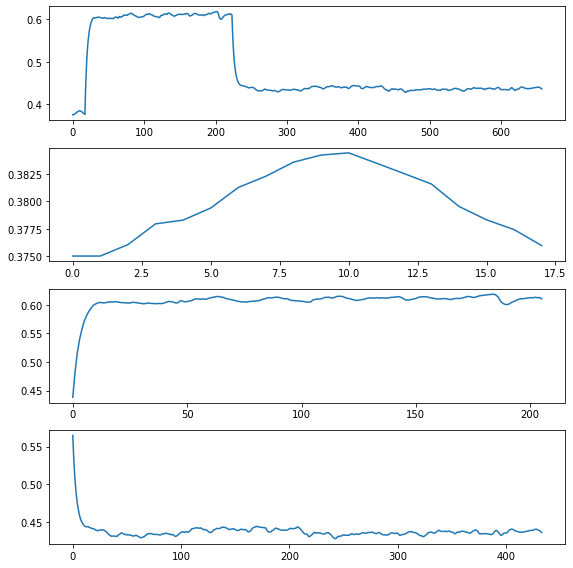

df_len_cnt: 17  H: 10  Total error: 10 Error check:  10941.179966955384 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.3841180342050971
df_len_cnt: 18  H: 10  Total error: 20 Error check:  95.69660307389289 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  13.801843430495417 False
df_len_cnt: 223  H: 10  Total error: 10 Error check:  10653.778207640811 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.6084261424925479
df_len_cnt: 224  H: 10  Total error: 20 Error check:  29.39618443354058 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.378000       4.48      -20.0
1   2020-02-13 01:38:01     0.382999       4.49      -20.0
2   2020-02-13 13:37:15     0.382476       4.49      -20.0
3   2020-02-14 01:36:29     0.382293       4.49      -20.0
4   2020-02-14 13:35:57     0.383829       4.49      -20.0
5   2020-02-15 01:35:0

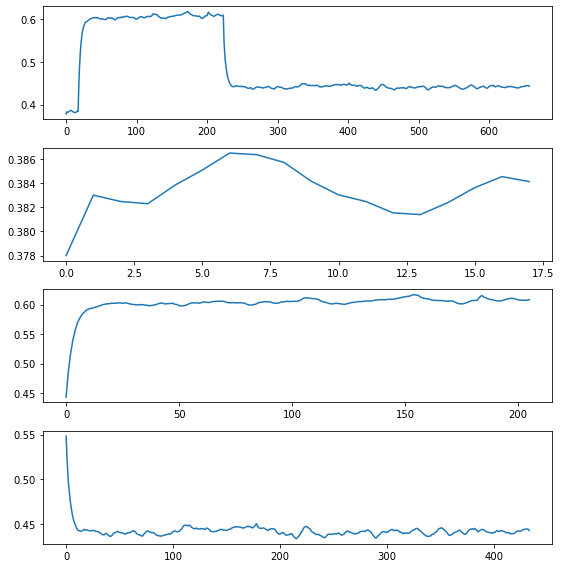

df_len_cnt: 17  H: 10  Total error: 10 Error check:  5699.5779562431935 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.34919592555180207
df_len_cnt: 18  H: 10  Total error: 20 Error check:  92.99920252245543 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  12.56738048447704 False
df_len_cnt: 20  H: 10  Total error: 20 Error check:  48.148756739862776 True
******CHANGE TIMES
df_len_cnt: 223  H: 10  Total error: 10 Error check:  4078.0157910833886 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.5852296300356604
df_len_cnt: 224  H: 10  Total error: 20 Error check:  58.519159260107635 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.339000       4.47      -20.0
1   2020-02-13 01:38:01     0.342999       4.48      -20.0
2   2020-02-13 13:37:15     0.343523       4.48      -20.0
3   2020-02-14 01:36:29     0.342938       

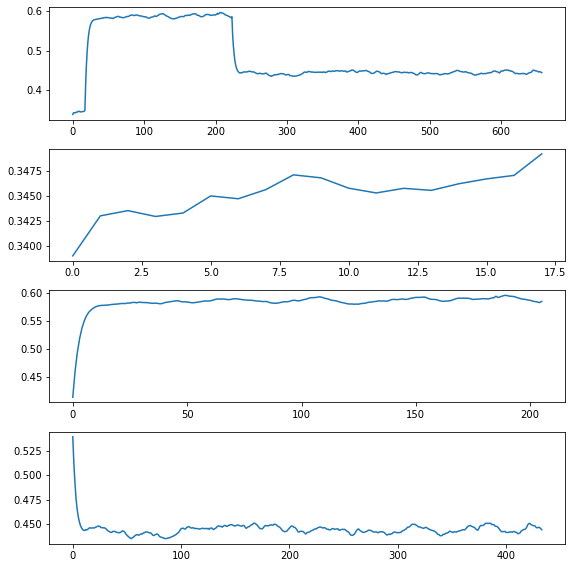

df_len_cnt: 17  H: 10  Total error: 10 Error check:  12465.621126641408 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.32965839610261144
df_len_cnt: 18  H: 10  Total error: 20 Error check:  106.02178334966985 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  7.688216979289013 False
df_len_cnt: 20  H: 10  Total error: 20 Error check:  44.92636680625401 True
******CHANGE TIMES
df_len_cnt: 223  H: 10  Total error: 10 Error check:  5847.260874082703 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.5997608129476778
df_len_cnt: 224  H: 10  Total error: 20 Error check:  161.27756359867064 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.323000       4.49      -20.0
1   2020-02-13 01:38:01     0.329999       4.49      -20.0
2   2020-02-13 13:37:15     0.328952       4.49      -20.0
3   2020-02-14 01:36:29     0.331275       4

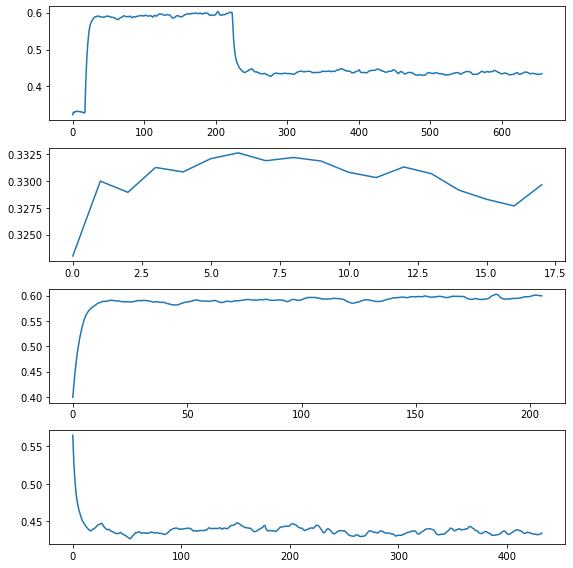

df_len_cnt: 17  H: 10  Total error: 10 Error check:  2006.8059337189197 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.40581190822695334
df_len_cnt: 18  H: 10  Total error: 20 Error check:  74.76756057335882 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  21.865335685540412 True
******CHANGE TIMES
df_len_cnt: 223  H: 10  Total error: 10 Error check:  2117.555537384022 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.5802560124964254
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.394000       4.49      -20.0
1   2020-02-13 01:38:01     0.394000       4.49      -20.0
2   2020-02-13 13:37:15     0.392429       4.50      -20.0
3   2020-02-14 01:36:29     0.392648       4.49      -20.0
4   2020-02-14 13:35:57     0.393415       4.49      -20.0
5   2020-02-15 01:35:07     0.394487       4.49      -20.0
6   2020-02-15 13:34:27     0.395488     

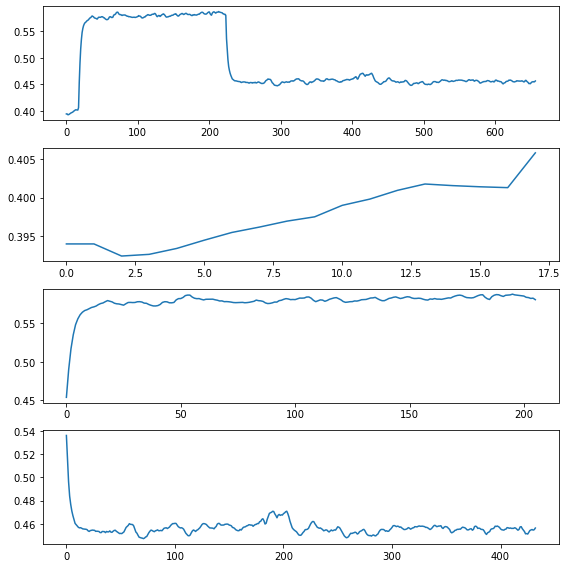

df_len_cnt: 17  H: 10  Total error: 10 Error check:  2518.3664402225313 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.3930277455285475
df_len_cnt: 18  H: 10  Total error: 20 Error check:  84.31076706799276 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  17.11591775719122 False
df_len_cnt: 224  H: 10  Total error: 10 Error check:  1495.1806080080103 True
******CHANGE TIMES
ch_times :  [18, 225] ch_num :  2 Resist :  0.5725718188143354
df_len_cnt: 225  H: 10  Total error: 20 Error check:  97.64173704174745 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 225, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.380000       4.49      -20.0
1   2020-02-13 01:38:01     0.381000       4.48      -20.0
2   2020-02-13 13:37:15     0.381524       4.49      -20.0
3   2020-02-14 01:36:29     0.382859       4.49      -20.0
4   2020-02-14 13:35:57     0.384536       4.49      -20.0
5   2020-02-15 01:35:07

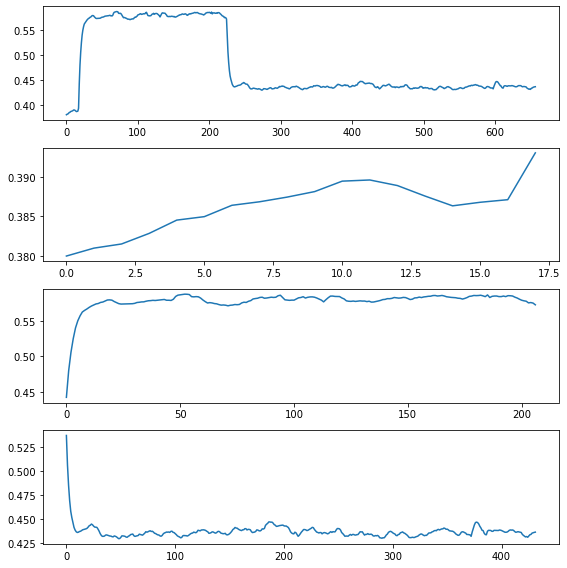

df_len_cnt: 17  H: 10  Total error: 10 Error check:  20067.438333007583 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.3753424780795688
df_len_cnt: 18  H: 10  Total error: 20 Error check:  99.84629746710353 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  11.36374564395631 False
df_len_cnt: 223  H: 10  Total error: 9 Error check:  7106.1693994016605 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.5893455954773188
df_len_cnt: 224  H: 10  Total error: 20 Error check:  203.37967121608577 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 11 Error check:  1331.4512599490517 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 20 Error check:  73.59059041817986 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.360000       4.43      -20.0
1   2020-02-13 01:38:01     0.367999       4.45      -20.0
2   202

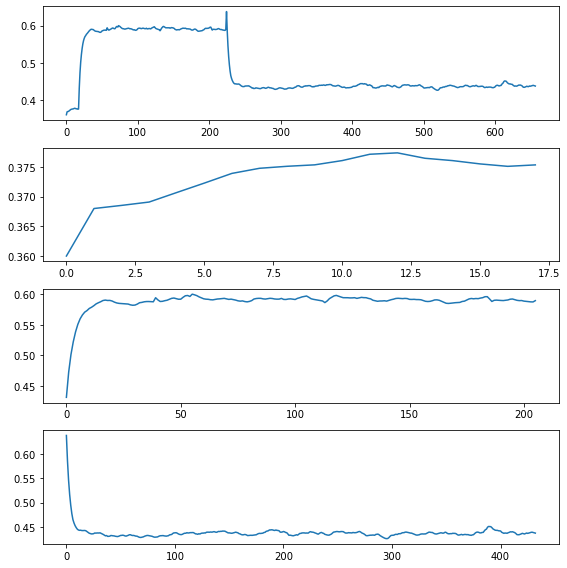

df_len_cnt: 17  H: 10  Total error: 10 Error check:  9500.825926264182 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.3052154529516398
df_len_cnt: 18  H: 10  Total error: 20 Error check:  109.26250147490124 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  8.660622916858674 False
df_len_cnt: 20  H: 10  Total error: 20 Error check:  44.55495167062954 True
******CHANGE TIMES
df_len_cnt: 223  H: 10  Total error: 10 Error check:  2425.976784158399 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.6211331473782696
df_len_cnt: 224  H: 10  Total error: 20 Error check:  85.20660829046744 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.303000       4.48      -20.0
1   2020-02-13 01:38:01     0.301000       4.49      -20.0
2   2020-02-13 13:37:15     0.303095       4.49      -20.0
3   2020-02-14 01:36:29     0.306132       4.48

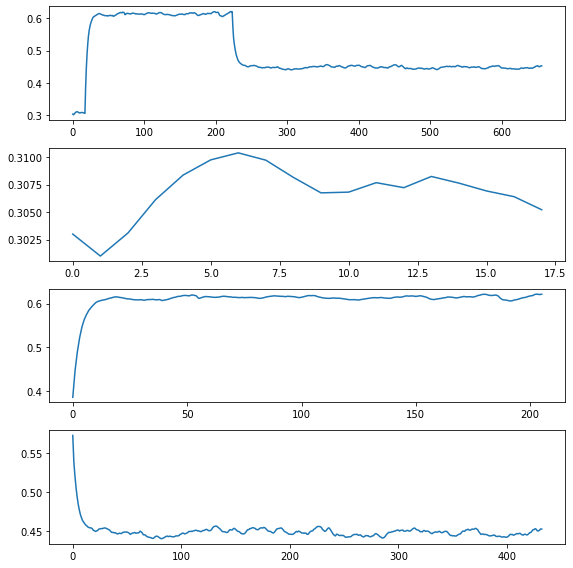

df_len_cnt: 17  H: 10  Total error: 10 Error check:  9525.886053871218 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.32653520810635744
df_len_cnt: 18  H: 10  Total error: 20 Error check:  95.63836897539353 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  12.435428065399053 False
df_len_cnt: 20  H: 10  Total error: 20 Error check:  47.46346745257319 True
******CHANGE TIMES
df_len_cnt: 223  H: 10  Total error: 10 Error check:  3337.2933743779813 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.6036495570421319
df_len_cnt: 224  H: 10  Total error: 20 Error check:  97.02951128273139 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.325000       4.49      -20.0
1   2020-02-13 01:38:01     0.311002       4.49      -20.0
2   2020-02-13 13:37:15     0.313096       4.50      -20.0
3   2020-02-14 01:36:29     0.314212       4.

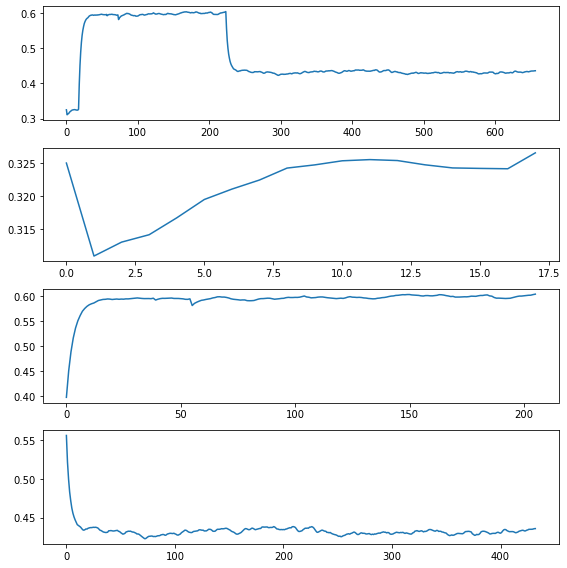

df_len_cnt: 17  H: 10  Total error: 10 Error check:  1785.5054726427256 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.36602433230032627
df_len_cnt: 18  H: 10  Total error: 20 Error check:  78.43470470556906 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  17.519340467467593 False
df_len_cnt: 223  H: 10  Total error: 10 Error check:  1696.3054192793309 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.5847198749043665
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.349000       4.46      -20.0
1   2020-02-13 01:38:01     0.346000       4.46      -20.0
2   2020-02-13 13:37:15     0.350714       4.46      -20.0
3   2020-02-14 01:36:29     0.353129       4.46      -20.0
4   2020-02-14 13:35:57     0.353087       4.46      -20.0
5   2020-02-15 01:35:07     0.353061       4.46      -20.0
6   2020-02-15 13:34:27     0.352758       4.46      -20.0

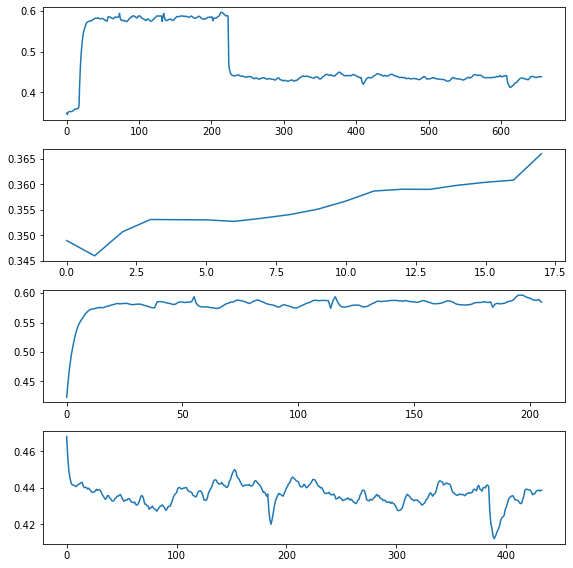

df_len_cnt: 17  H: 10  Total error: 10 Error check:  4795.888641337603 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.38870055609486537
df_len_cnt: 18  H: 10  Total error: 20 Error check:  104.66197378987852 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  11.347433269148338 False
df_len_cnt: 223  H: 10  Total error: 9 Error check:  1138.2956671041768 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.6213430189393634
df_len_cnt: 224  H: 10  Total error: 20 Error check:  97.14726541912057 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 16 Error check:  308.0055406417649 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 12 Error check:  226.4984557445484 True
******CHANGE TIMES
df_len_cnt: 227  H: 10  Total error: 20 Error check:  10.380236206367998 False
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.395000       4.4

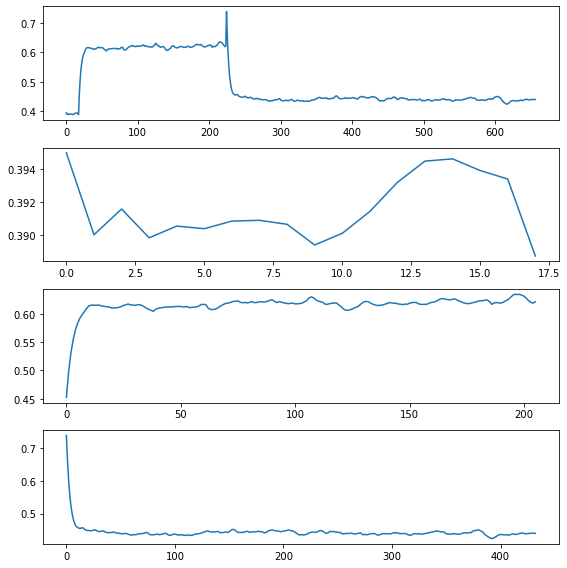

df_len_cnt: 17  H: 10  Total error: 10 Error check:  8820.256658175409 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.39073498317317457
df_len_cnt: 18  H: 10  Total error: 20 Error check:  94.89404010548327 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  14.73499641006128 False
df_len_cnt: 223  H: 10  Total error: 9 Error check:  2087.4338298762664 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.6278648227062901
df_len_cnt: 224  H: 10  Total error: 20 Error check:  83.17762301273018 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 20 Error check:  252.66788294312295 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 12 Error check:  265.9407306894527 True
******CHANGE TIMES
df_len_cnt: 227  H: 10  Total error: 20 Error check:  12.619641060717383 False
df_len_cnt: 228  H: 10  Total error: 20 Error check:  40.68591928550938 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 224, None]
adf
18
          

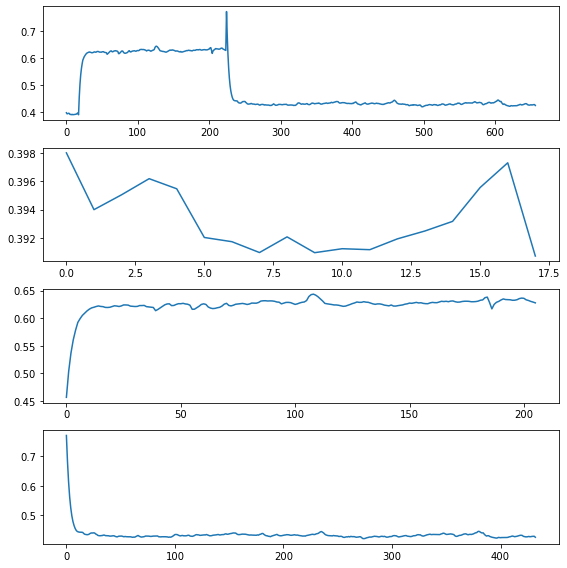

df_len_cnt: 17  H: 10  Total error: 10 Error check:  4736.817383515181 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.3161337009792199
df_len_cnt: 18  H: 10  Total error: 20 Error check:  84.80957932588284 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  16.380112344416435 False
df_len_cnt: 20  H: 10  Total error: 20 Error check:  49.691891565409016 True
******CHANGE TIMES
df_len_cnt: 223  H: 10  Total error: 10 Error check:  8051.621664407505 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.6000061320452552
df_len_cnt: 224  H: 10  Total error: 20 Error check:  149.99793767525156 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.317000       4.49       21.5
1   2020-02-13 01:38:01     0.309001       4.50       18.0
2   2020-02-13 13:37:15     0.308477       4.48       17.4
3   2020-02-14 01:36:29     0.308294       4.

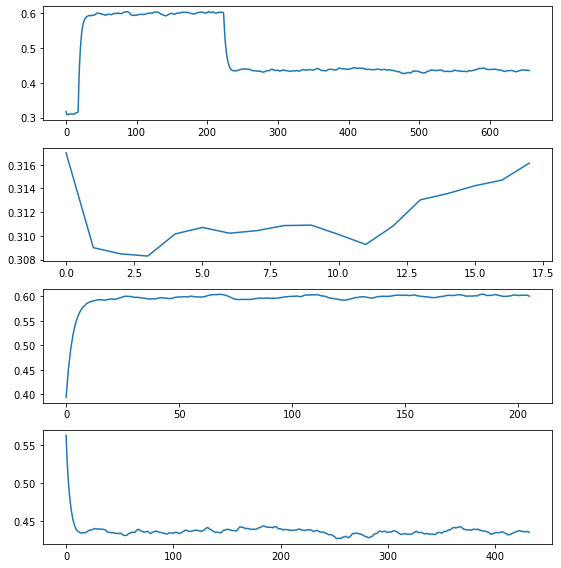

df_len_cnt: 17  H: 10  Total error: 10 Error check:  6273.985278097923 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.32897030504206015
df_len_cnt: 18  H: 10  Total error: 20 Error check:  95.32606496845091 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  11.95710907624272 False
df_len_cnt: 20  H: 10  Total error: 20 Error check:  47.615953700687506 True
******CHANGE TIMES
df_len_cnt: 223  H: 10  Total error: 10 Error check:  4804.189524008082 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.6073277258623624
df_len_cnt: 224  H: 10  Total error: 20 Error check:  42.28057387315812 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.337000       4.48      -20.0
1   2020-02-13 01:38:01     0.335000       4.48      -20.0
2   2020-02-13 13:37:15     0.335524       4.48      -20.0
3   2020-02-14 01:36:29     0.334939       4.4

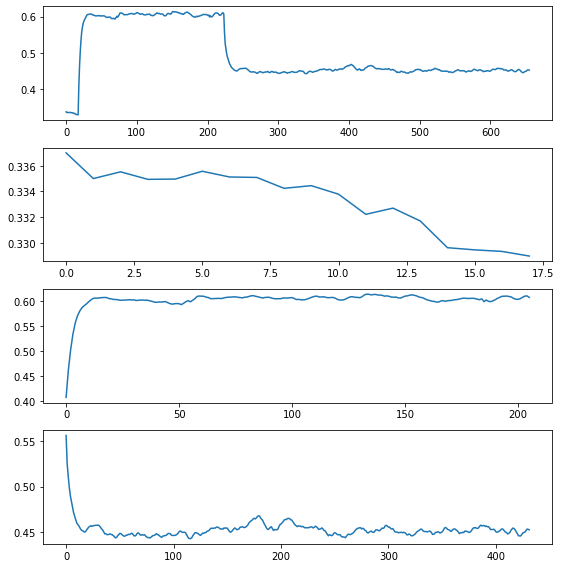

df_len_cnt: 17  H: 10  Total error: 10 Error check:  7033.806970893566 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.37372146462357353
df_len_cnt: 18  H: 10  Total error: 20 Error check:  85.6451417493878 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  19.337500105507242 False
df_len_cnt: 223  H: 10  Total error: 9 Error check:  1350.9818903598766 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.6048423136926193
df_len_cnt: 224  H: 10  Total error: 20 Error check:  68.88752830361 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 20 Error check:  192.93480278351132 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 12 Error check:  348.33741363923275 True
******CHANGE TIMES
df_len_cnt: 227  H: 10  Total error: 20 Error check:  17.013189247503153 False
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.378000       4.50  

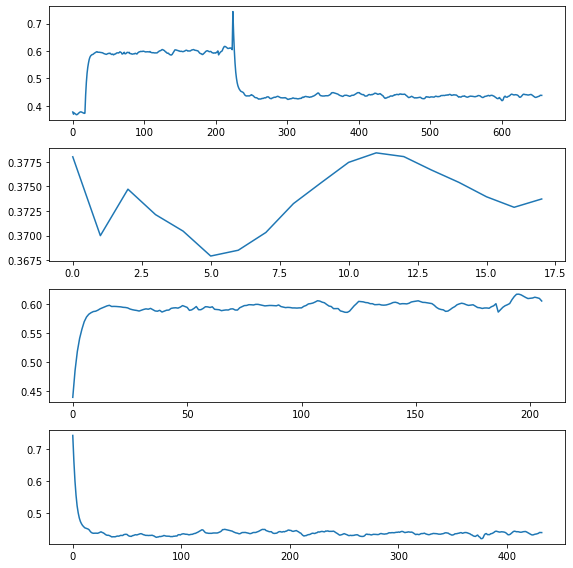

df_len_cnt: 17  H: 10  Total error: 10 Error check:  12559.196700280696 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.37585513117674774
df_len_cnt: 18  H: 10  Total error: 20 Error check:  105.89974175655215 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  5.635334341047173 False
df_len_cnt: 223  H: 10  Total error: 9 Error check:  6452.714801719741 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.6009380699560074
df_len_cnt: 224  H: 10  Total error: 20 Error check:  196.13346519813206 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 11 Error check:  1706.1772386652642 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 20 Error check:  73.21660821245814 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.358000       4.49      -20.0
1   2020-02-13 01:38:01     0.355000       4.49      -20.0
2   20

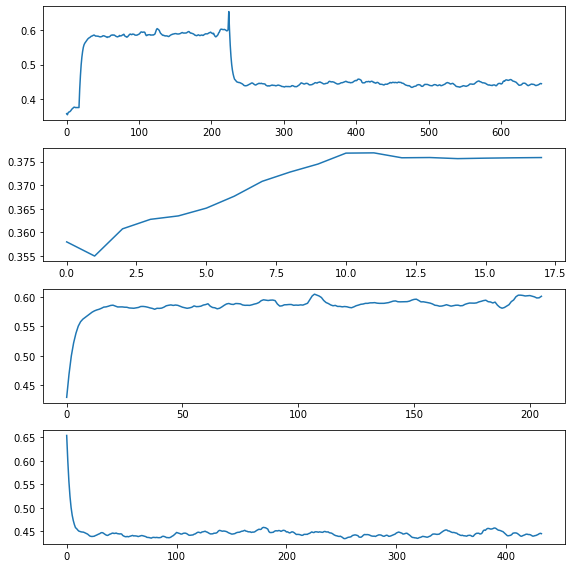

df_len_cnt: 17  H: 10  Total error: 10 Error check:  9164.81544668248 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.3934743530002138
df_len_cnt: 18  H: 10  Total error: 20 Error check:  128.232440504343 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  2.5263555524668644 False
df_len_cnt: 223  H: 10  Total error: 9 Error check:  1518.5955574788936 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.5982412971529032
df_len_cnt: 224  H: 10  Total error: 20 Error check:  51.61274799816279 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 20 Error check:  136.94629324761033 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 12 Error check:  366.03515494146933 True
******CHANGE TIMES
df_len_cnt: 227  H: 10  Total error: 20 Error check:  44.93938154703573 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.3

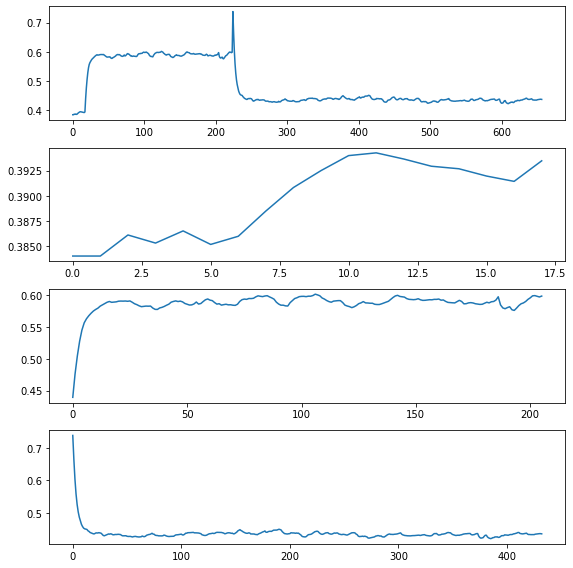

df_len_cnt: 17  H: 10  Total error: 10 Error check:  8271.147556796173 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.31349916333194333
df_len_cnt: 18  H: 10  Total error: 20 Error check:  97.57121248538392 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  11.229337604063439 False
df_len_cnt: 20  H: 10  Total error: 20 Error check:  48.67633265301739 True
******CHANGE TIMES
df_len_cnt: 224  H: 10  Total error: 10 Error check:  1053.7798888694238 True
******CHANGE TIMES
ch_times :  [18, 225] ch_num :  2 Resist :  0.5920936186748502
CHECK TIMES
[None, 18, 225, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.297000       4.50      -20.0
1   2020-02-13 01:38:01     0.307998       4.50      -20.0
2   2020-02-13 13:37:15     0.309570       4.50      -20.0
3   2020-02-14 01:36:29     0.309351       4.49      -20.0
4   2020-02-14 13:35:57     0.311194       4.49      -20.0
5   2020-02-15 01:35:07

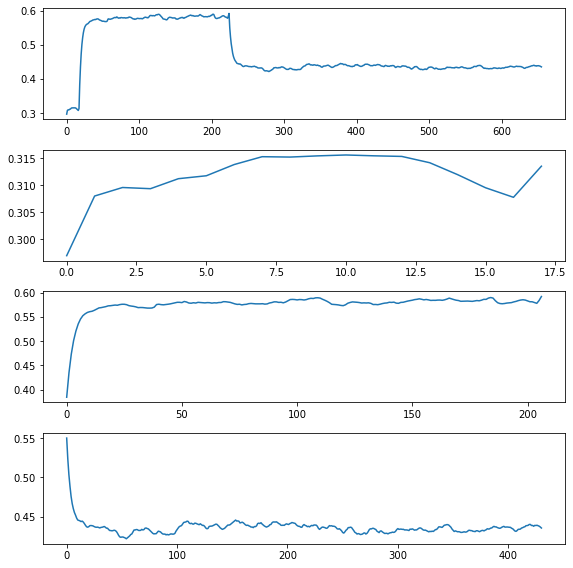

df_len_cnt: 17  H: 10  Total error: 10 Error check:  17329.88339214317 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.32463655657669105
df_len_cnt: 18  H: 10  Total error: 20 Error check:  100.72942232258532 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  9.340481948349545 False
df_len_cnt: 20  H: 10  Total error: 20 Error check:  46.1501559652078 True
******CHANGE TIMES
df_len_cnt: 224  H: 10  Total error: 10 Error check:  4438.101411742369 True
******CHANGE TIMES
ch_times :  [18, 225] ch_num :  2 Resist :  0.5852379995659429
df_len_cnt: 225  H: 10  Total error: 20 Error check:  82.24197305298888 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 225, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.323000       4.49      -20.0
1   2020-02-13 01:38:01     0.329999       4.49      -20.0
2   2020-02-13 13:37:15     0.327904       4.50      -20.0
3   2020-02-14 01:36:29     0.325252       4.49

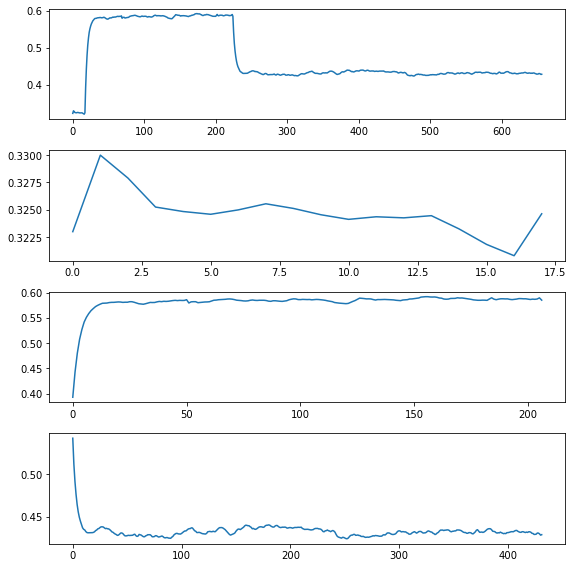

df_len_cnt: 17  H: 10  Total error: 10 Error check:  2804.2097947361463 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.3658957088829585
df_len_cnt: 18  H: 10  Total error: 20 Error check:  81.34278767883127 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  14.759015425276647 False
df_len_cnt: 223  H: 10  Total error: 9 Error check:  1385.5755651680324 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.5766403759576308
df_len_cnt: 224  H: 10  Total error: 20 Error check:  30.379061352783104 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 20 Error check:  82.79886125647339 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 20 Error check:  168.29094678957583 True
******CHANGE TIMES
df_len_cnt: 227  H: 10  Total error: 13 Error check:  111.73579843177326 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49    

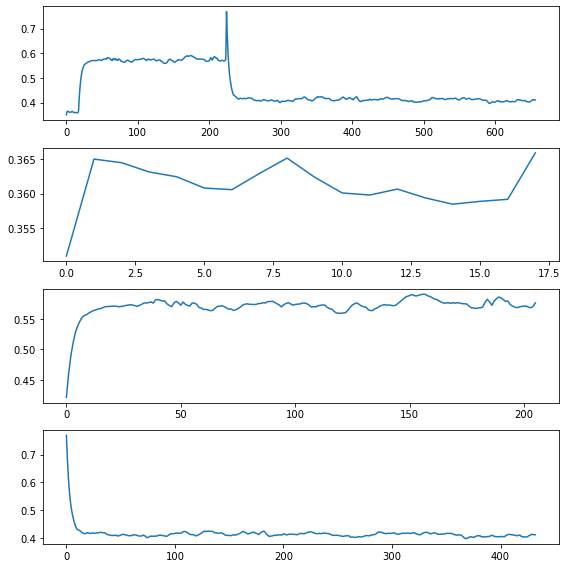

df_len_cnt: 17  H: 10  Total error: 10 Error check:  8565.14809467654 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.37598840840209413
df_len_cnt: 18  H: 10  Total error: 20 Error check:  96.81815446767223 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  10.184330951090997 False
df_len_cnt: 223  H: 10  Total error: 9 Error check:  7795.758317460658 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.6010407509825206
df_len_cnt: 224  H: 10  Total error: 20 Error check:  138.42482442167417 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 11 Error check:  660.5952126570676 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 20 Error check:  124.08184548505044 True
******CHANGE TIMES
df_len_cnt: 227  H: 10  Total error: 20 Error check:  3.0615150735535215 False
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.373000       4.50

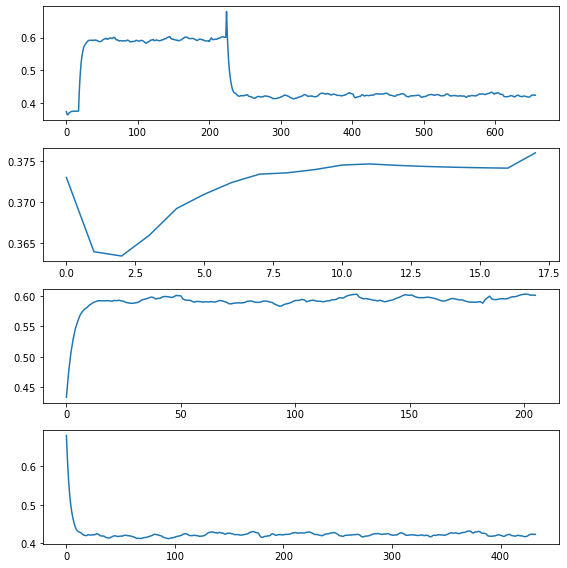

df_len_cnt: 17  H: 10  Total error: 10 Error check:  2714.4954334383506 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.3596640357395042
df_len_cnt: 18  H: 10  Total error: 20 Error check:  62.53585521093994 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  14.144686482670716 False
df_len_cnt: 223  H: 10  Total error: 9 Error check:  1329.8629165023942 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.591852948082981
df_len_cnt: 224  H: 10  Total error: 20 Error check:  35.547489022309115 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 20 Error check:  98.2175881613325 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 13 Error check:  209.15992898375694 True
******CHANGE TIMES
df_len_cnt: 227  H: 10  Total error: 15 Error check:  77.5435577182918 True
******CHANGE TIMES
df_len_cnt: 228  H: 10  Total error: 20 Error check:  15.064772555056866 False
CHECK TIMES
[None, 18, 224, None]
adf
18
           

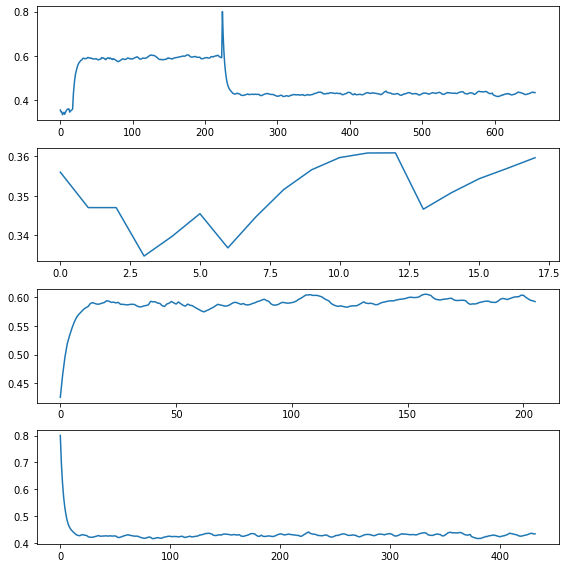

df_len_cnt: 17  H: 10  Total error: 13 Error check:  1338.1263735386563 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.316922413883182
df_len_cnt: 18  H: 10  Total error: 20 Error check:  136.23142608256876 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  0.5729642424920596 False
df_len_cnt: 20  H: 10  Total error: 20 Error check:  42.54439297836481 True
******CHANGE TIMES
df_len_cnt: 223  H: 10  Total error: 10 Error check:  5237.168212445302 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.6083205358375747
df_len_cnt: 224  H: 10  Total error: 20 Error check:  122.89149863533748 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.312000       4.49      -20.0
1   2020-02-13 01:38:01     0.316999       4.48      -20.0
2   2020-02-13 13:37:15     0.318047       4.48      -20.0
3   2020-02-14 01:36:29     0.338773       4.

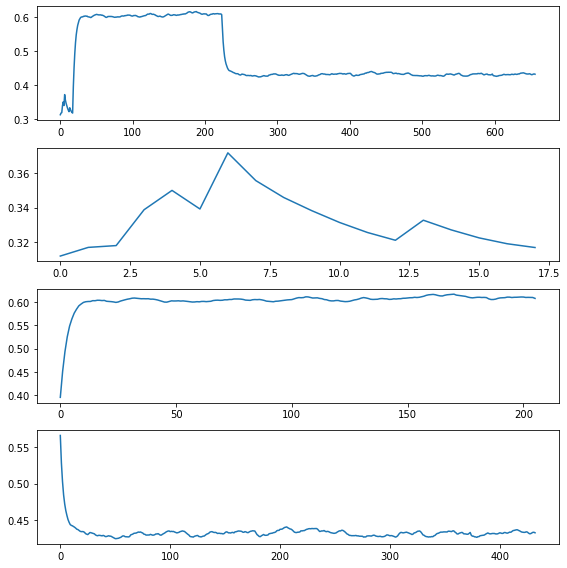

df_len_cnt: 17  H: 10  Total error: 12 Error check:  1566.2316614108968 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.36765187499694363
df_len_cnt: 18  H: 10  Total error: 20 Error check:  138.92695598616004 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  5.414474321074671 False
df_len_cnt: 224  H: 10  Total error: 10 Error check:  5540.387257914497 True
******CHANGE TIMES
ch_times :  [18, 225] ch_num :  2 Resist :  0.612724981164403
df_len_cnt: 225  H: 10  Total error: 20 Error check:  83.13911919672582 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 225, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.347000       4.50      -20.0
1   2020-02-13 01:38:01     0.372996       4.50      -20.0
2   2020-02-13 13:37:15     0.371427       4.50      -20.0
3   2020-02-14 01:36:29     0.400458       4.50       17.4
4   2020-02-14 13:35:57     0.417598       4.50       17.8
5   2020-02-15 01:35:07

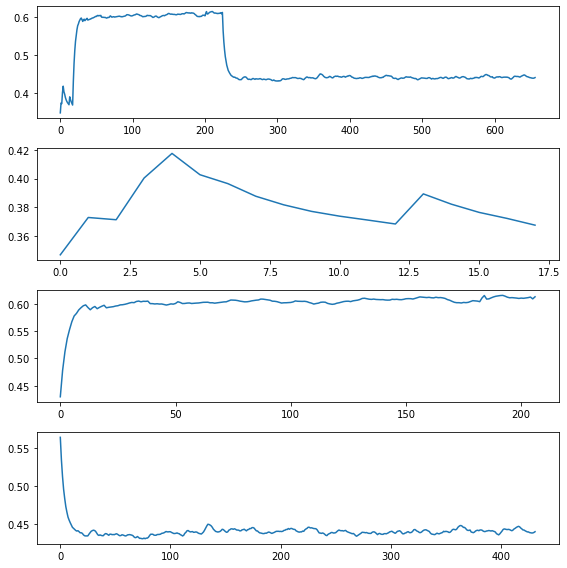

df_len_cnt: 17  H: 10  Total error: 11 Error check:  1250.6843251722416 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.4324206469224769
df_len_cnt: 18  H: 10  Total error: 20 Error check:  41.827431010946405 True
******CHANGE TIMES
df_len_cnt: 223  H: 10  Total error: 9 Error check:  2380.7069460652688 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.5935537961590153
df_len_cnt: 224  H: 10  Total error: 20 Error check:  17.281761277613082 False
df_len_cnt: 225  H: 10  Total error: 20 Error check:  52.89321235527503 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 20 Error check:  97.26755654684548 True
******CHANGE TIMES
df_len_cnt: 227  H: 10  Total error: 13 Error check:  127.71534844935653 True
******CHANGE TIMES
df_len_cnt: 228  H: 10  Total error: 19 Error check:  14.267563067899378 False
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.413000       4

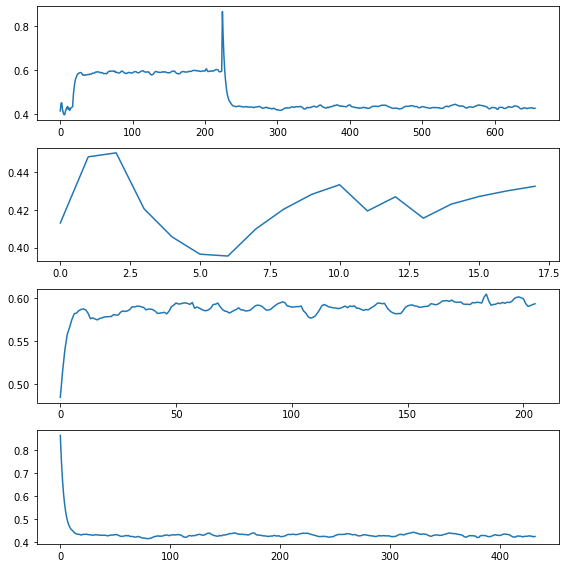

df_len_cnt: 17  H: 10  Total error: 11 Error check:  1868.3211646362217 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.38542548914146846
df_len_cnt: 18  H: 10  Total error: 20 Error check:  111.56869308814214 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  18.799143940747815 False
df_len_cnt: 223  H: 10  Total error: 9 Error check:  2305.8679339987657 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.5801063202770874
df_len_cnt: 224  H: 10  Total error: 20 Error check:  19.16487869587499 False
df_len_cnt: 225  H: 10  Total error: 20 Error check:  57.75651616877847 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 20 Error check:  110.12649111656711 True
******CHANGE TIMES
df_len_cnt: 227  H: 10  Total error: 13 Error check:  153.8235181483063 True
******CHANGE TIMES
df_len_cnt: 228  H: 10  Total error: 20 Error check:  3.4566969970356256 False
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  

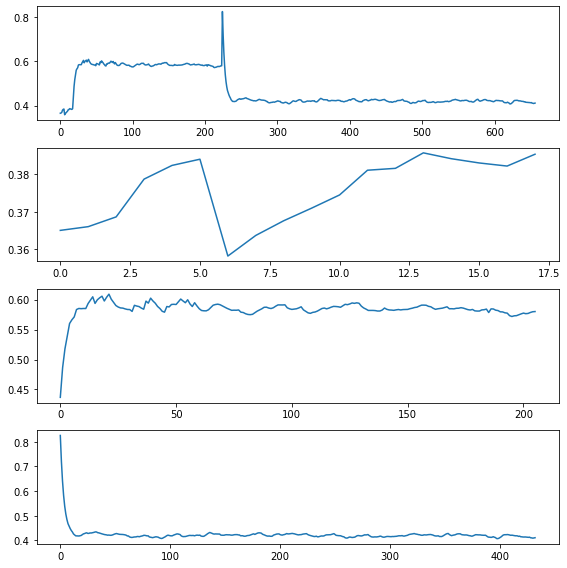

df_len_cnt: 17  H: 10  Total error: 16 Error check:  775.8367676651163 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.37095442024164627
df_len_cnt: 18  H: 10  Total error: 20 Error check:  74.7933000725116 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  5.362016923075732 False
df_len_cnt: 20  H: 10  Total error: 20 Error check:  48.642351551625325 True
******CHANGE TIMES
df_len_cnt: 223  H: 10  Total error: 10 Error check:  2592.2295634972143 True
******CHANGE TIMES
ch_times :  [18, 224] ch_num :  2 Resist :  0.612391095982324
CHECK TIMES
[None, 18, 224, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.397000       4.48      -20.0
1   2020-02-13 01:38:01     0.402999       4.50      -20.0
2   2020-02-13 13:37:15     0.399333       4.50      -20.0
3   2020-02-14 01:36:29     0.361558       4.48      -20.0
4   2020-02-14 13:35:57     0.340499       4.49      -20.0
5   2020-02-15 01:35:07  

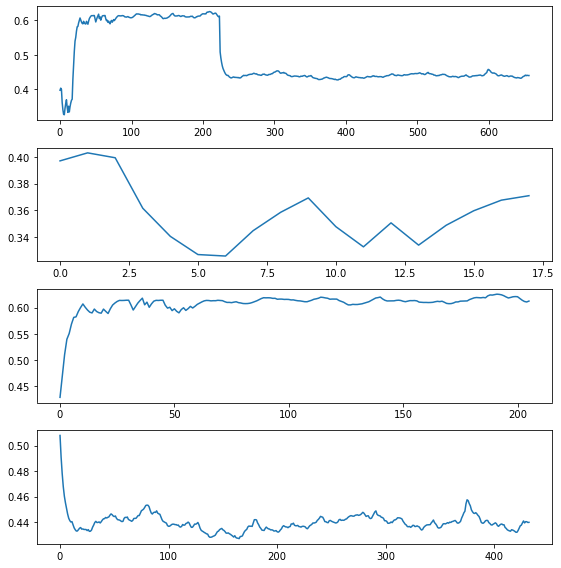

df_len_cnt: 17  H: 10  Total error: 10 Error check:  5028.558354575827 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.3053281662250966
df_len_cnt: 18  H: 10  Total error: 20 Error check:  112.29461493751911 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  7.870149978248703 False
df_len_cnt: 20  H: 10  Total error: 20 Error check:  42.91270766466331 True
******CHANGE TIMES
df_len_cnt: 222  H: 10  Total error: 10 Error check:  5404.937726027364 True
******CHANGE TIMES
ch_times :  [18, 223] ch_num :  2 Resist :  0.5863319189086201
df_len_cnt: 223  H: 10  Total error: 20 Error check:  121.92585518581676 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 223, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.282000       4.49      -20.0
1   2020-02-13 01:38:01     0.299997       4.50      -20.0
2   2020-02-13 13:37:15     0.312569       4.51      -20.0
3   2020-02-14 01:36:29     0.316960       4.5

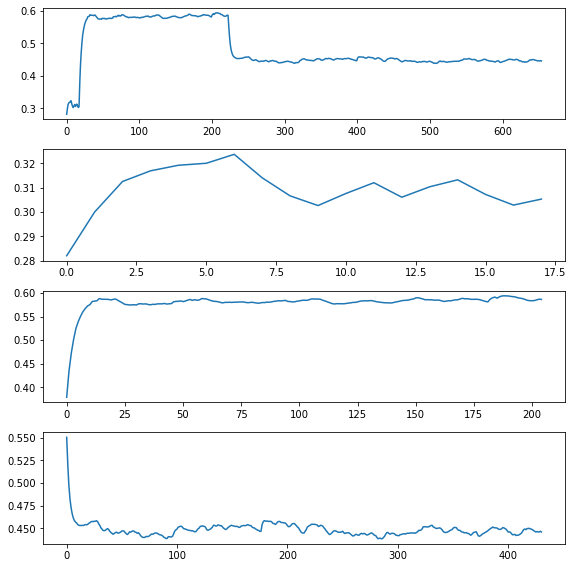

df_len_cnt: 17  H: 10  Total error: 10 Error check:  3078.166847737906 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.32509126714262904
df_len_cnt: 18  H: 10  Total error: 20 Error check:  149.02092703265376 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  4.611783651918545 False
df_len_cnt: 20  H: 10  Total error: 20 Error check:  46.17169573853929 True
******CHANGE TIMES
df_len_cnt: 222  H: 10  Total error: 10 Error check:  9801.478975319269 True
******CHANGE TIMES
ch_times :  [18, 223] ch_num :  2 Resist :  0.5945587794522768
CHECK TIMES
[None, 18, 223, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.315000       4.51      -20.0
1   2020-02-13 01:38:01     0.317000       4.50      -20.0
2   2020-02-13 13:37:15     0.327475       4.50      -20.0
3   2020-02-14 01:36:29     0.329213       4.49      -20.0
4   2020-02-14 13:35:57     0.331101       4.49      -20.0
5   2020-02-15 01:35:07 

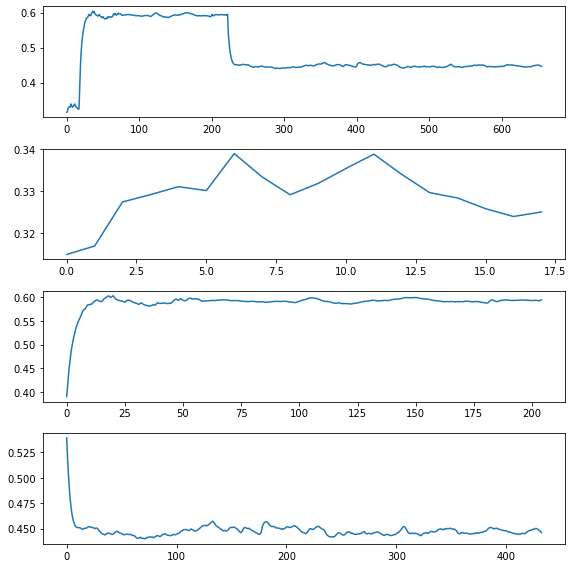

df_len_cnt: 17  H: 10  Total error: 15 Error check:  1079.6055416347626 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.3363085545884328
df_len_cnt: 18  H: 10  Total error: 20 Error check:  130.05904568902508 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  4.175012610762938 False
df_len_cnt: 20  H: 10  Total error: 20 Error check:  38.068672147179385 True
******CHANGE TIMES
df_len_cnt: 222  H: 10  Total error: 9 Error check:  1192.430262530956 True
******CHANGE TIMES
ch_times :  [18, 223] ch_num :  2 Resist :  0.6179484788722848
df_len_cnt: 223  H: 10  Total error: 20 Error check:  55.31583570533646 True
******CHANGE TIMES
df_len_cnt: 224  H: 10  Total error: 20 Error check:  154.66912036425157 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 12 Error check:  423.1912130316027 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 20 Error check:  46.19628912788291 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 223, None]


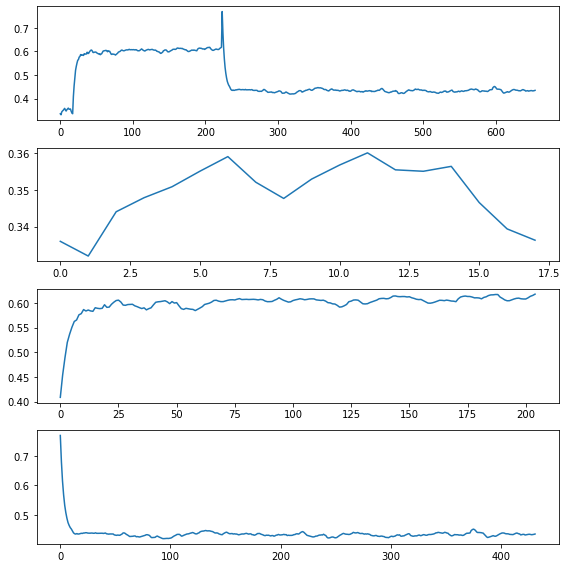

df_len_cnt: 17  H: 10  Total error: 10 Error check:  3041.4839701141036 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.3658272450423018
df_len_cnt: 18  H: 10  Total error: 20 Error check:  74.33060357067475 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  10.01024305610889 False
df_len_cnt: 222  H: 10  Total error: 10 Error check:  3382.3707640685952 True
******CHANGE TIMES
ch_times :  [18, 223] ch_num :  2 Resist :  0.59219929738194
df_len_cnt: 223  H: 10  Total error: 20 Error check:  101.98973153859497 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 223, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.360000       4.49      -20.0
1   2020-02-13 01:38:01     0.355001       4.48      -20.0
2   2020-02-13 13:37:15     0.358667       4.50      -20.0
3   2020-02-14 01:36:29     0.362252       4.51      -20.0
4   2020-02-14 13:35:57     0.365106       4.50      -20.0
5   2020-02-15 01:35:07 

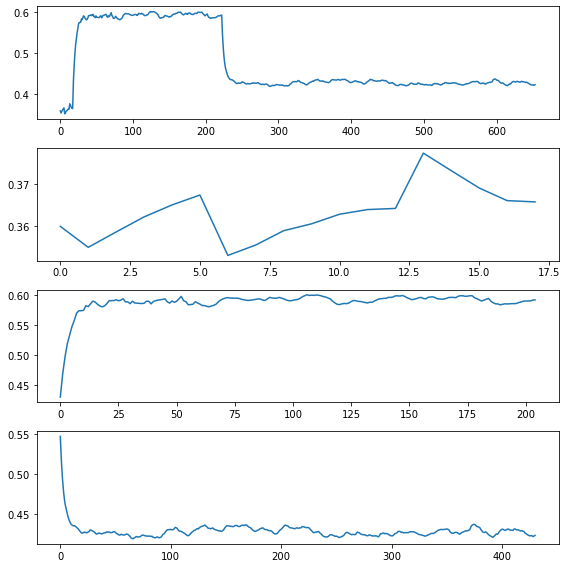

df_len_cnt: 17  H: 10  Total error: 14 Error check:  744.7908940699307 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.3442910341297919
df_len_cnt: 18  H: 10  Total error: 20 Error check:  57.47886862009645 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  27.335332001249185 True
******CHANGE TIMES
df_len_cnt: 222  H: 10  Total error: 10 Error check:  22657.077400426468 True
******CHANGE TIMES
ch_times :  [18, 223] ch_num :  2 Resist :  0.5826079938407234
df_len_cnt: 223  H: 10  Total error: 20 Error check:  110.66936947052439 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 223, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.368000       4.50      -20.0
1   2020-02-13 01:38:01     0.357002       4.50      -20.0
2   2020-02-13 13:37:15     0.337098       4.50      -20.0
3   2020-02-14 01:36:29     0.331682       4.49      -20.0
4   2020-02-14 13:35:57     0.327871       4.49      -20.0
5   

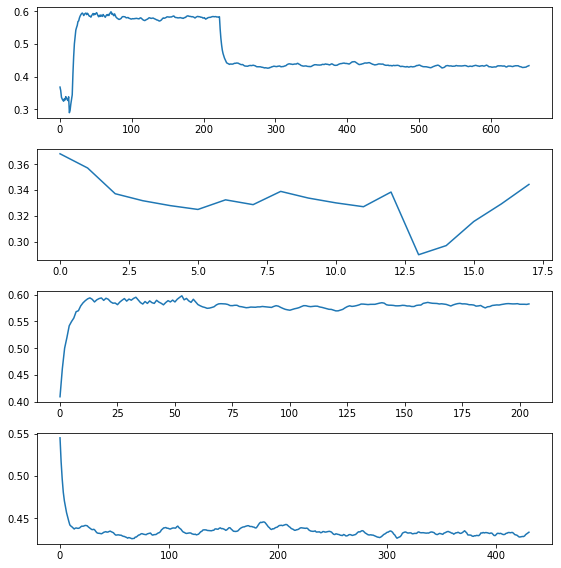

df_len_cnt: 17  H: 10  Total error: 17 Error check:  858.5992827216838 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.32775007017616503
df_len_cnt: 18  H: 10  Total error: 20 Error check:  128.39075264945598 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  1.6233302933821703 False
df_len_cnt: 20  H: 10  Total error: 20 Error check:  42.670147584541155 True
******CHANGE TIMES
df_len_cnt: 221  H: 10  Total error: 10 Error check:  2796.07222610985 True
******CHANGE TIMES
ch_times :  [18, 222] ch_num :  2 Resist :  0.6073168682467388
df_len_cnt: 222  H: 10  Total error: 20 Error check:  119.3761390884821 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 222, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.310000       4.50      -20.0
1   2020-02-13 01:38:01     0.322998       4.50      -20.0
2   2020-02-13 13:37:15     0.336093       4.51      -20.0
3   2020-02-14 01:36:29     0.341436       4.

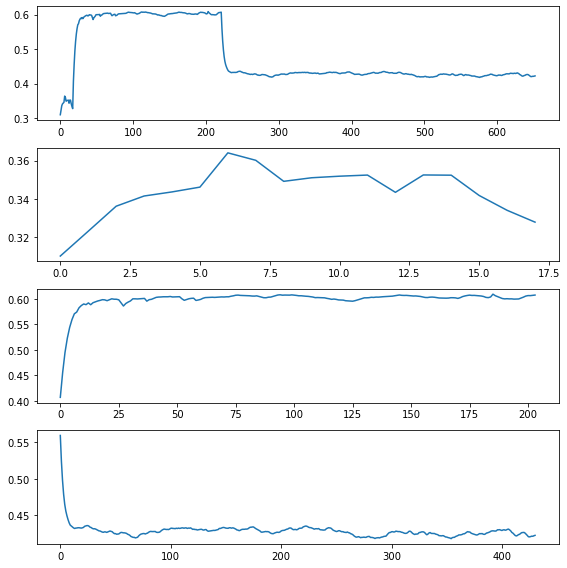

df_len_cnt: 17  H: 10  Total error: 13 Error check:  789.3800209799335 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.36871689463279916
df_len_cnt: 18  H: 10  Total error: 20 Error check:  109.43367584969226 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  10.648306155417757 False
df_len_cnt: 221  H: 10  Total error: 10 Error check:  4637.386803750572 True
******CHANGE TIMES
ch_times :  [18, 222] ch_num :  2 Resist :  0.6028530593020418
df_len_cnt: 222  H: 10  Total error: 20 Error check:  97.63131306240294 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 222, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.356000       4.51      -20.0
1   2020-02-13 01:38:01     0.344002       4.50      -20.0
2   2020-02-13 13:37:15     0.372285       4.50      -20.0
3   2020-02-14 01:36:29     0.387157       4.51      -20.0
4   2020-02-14 13:35:57     0.393630       4.50      -20.0
5   2020-02-15 01:35:0

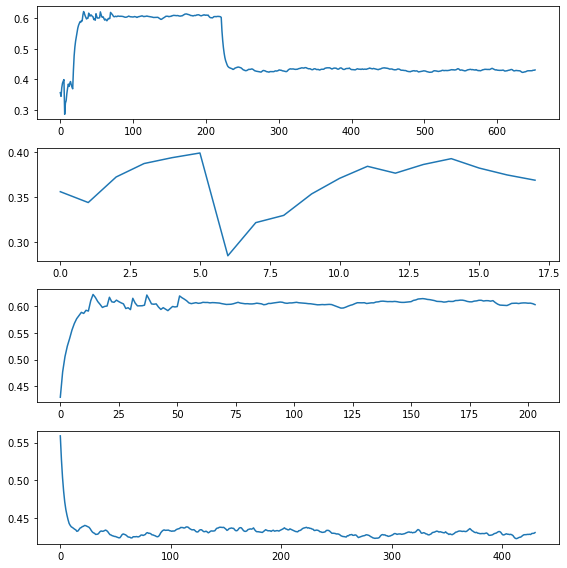

df_len_cnt: 16  H: 10  Total error: 20 Error check:  90.97518441254437 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.3090280101675927
df_len_cnt: 17  H: 10  Total error: 20 Error check:  58.00505579331715 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  17.815681220775957 False
df_len_cnt: 19  H: 10  Total error: 20 Error check:  55.12964704098825 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  67.0620926730351 True
******CHANGE TIMES
df_len_cnt: 221  H: 10  Total error: 10 Error check:  6841.357045865159 True
******CHANGE TIMES
ch_times :  [17, 222] ch_num :  2 Resist :  0.5918912135288175
CHECK TIMES
[None, 17, 222, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.404000       4.50      -20.0
1   2020-02-13 01:38:01     0.397001       4.49      -20.0
2   2020-02-13 13:37:15     0.189063       4.48       18.5
3   2020-02-14 01:36:29     0.180203       4.48  

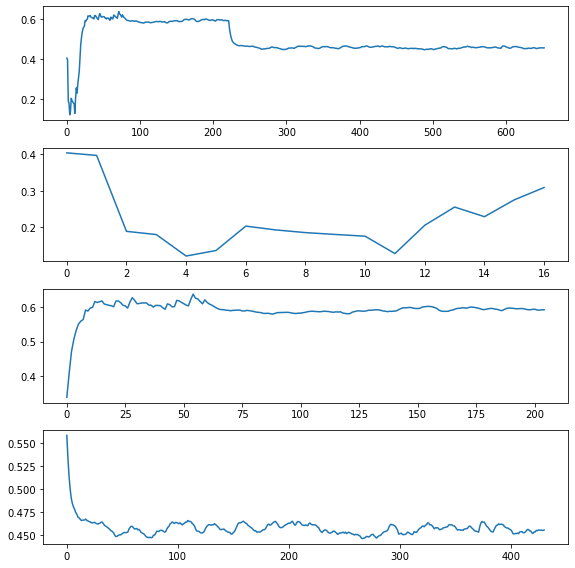

df_len_cnt: 17  H: 10  Total error: 15 Error check:  1153.5701360474684 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.15258341093879701
df_len_cnt: 18  H: 10  Total error: 20 Error check:  102.15414857339087 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  9.088412335216448 False
df_len_cnt: 20  H: 10  Total error: 20 Error check:  43.87895072452258 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  64.78258014928637 True
******CHANGE TIMES
df_len_cnt: 221  H: 10  Total error: 10 Error check:  2785.2246457054875 True
******CHANGE TIMES
ch_times :  [18, 222] ch_num :  2 Resist :  0.6166400722652359
df_len_cnt: 222  H: 10  Total error: 20 Error check:  119.42055275326504 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 222, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.148000       4.48      -20.0
1   2020-02-13 01:38:01     0.167997       4.49      -20.0
2   202

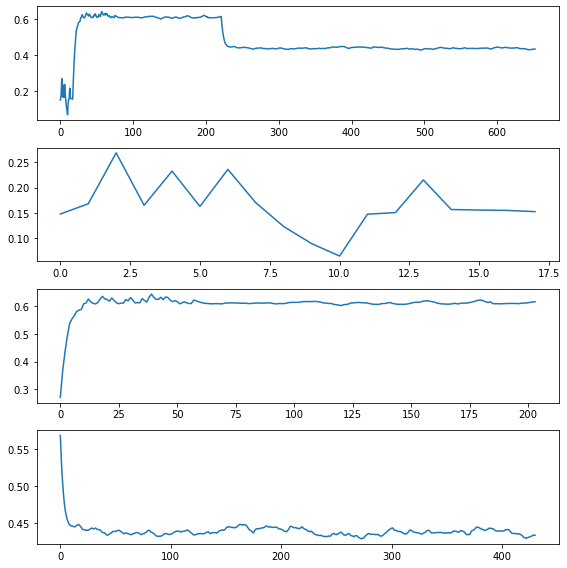

df_len_cnt: 16  H: 10  Total error: 20 Error check:  112.82527965357549 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.17354295089001504
df_len_cnt: 17  H: 10  Total error: 19 Error check:  327.5346263878464 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 17 Error check:  167.4027631991412 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  13.825334231953429 False
df_len_cnt: 20  H: 10  Total error: 20 Error check:  32.04443918247265 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  56.59443964467512 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 20 Error check:  71.85605818305272 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 10 Error check:  1032.0069257057573 True
******CHANGE TIMES
ch_times :  [17, 227] ch_num :  2 Resist :  0.6576963915218476
df_len_cnt: 227  H: 10  Total error: 20 Error check:  22.88632214556932 True
******CHANGE TIMES
df_len_cnt: 228  H: 10  Total error:

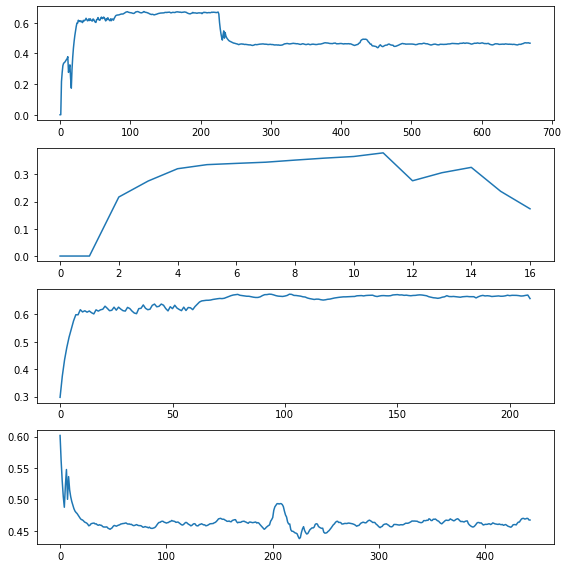

df_len_cnt: 16  H: 10  Total error: 14 Error check:  949.7975890341188 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.37438675715467046
df_len_cnt: 17  H: 10  Total error: 20 Error check:  135.52396542592288 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  7.167683005014301 False
df_len_cnt: 224  H: 10  Total error: 10 Error check:  4434.33746539887 True
******CHANGE TIMES
ch_times :  [17, 225] ch_num :  2 Resist :  0.6266512751661287
df_len_cnt: 438  H: 10  Total error: 10 Error check:  2969.639772249894 True
******CHANGE TIMES
ch_times :  [17, 225, 439] ch_num :  3 Resist :  0.49184972412846756
CHECK TIMES
[None, 17, 225, 439, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.348000       4.48      -20.0
1   2020-02-13 01:38:01     0.344001       4.49      -20.0
2   2020-02-13 13:37:15     0.343477       4.49      -20.0
3   2020-02-14 01:36:29     0.370184       4.47      -20.0
4   2020-

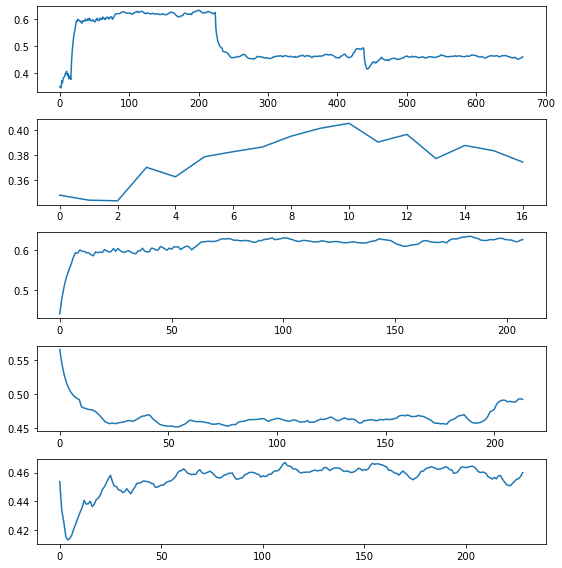

df_len_cnt: 16  H: 10  Total error: 10 Error check:  2338.1297156557202 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.3713253788505772
df_len_cnt: 17  H: 10  Total error: 20 Error check:  100.12987861444861 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  15.004553766042584 False
df_len_cnt: 224  H: 10  Total error: 10 Error check:  3508.9540776855906 True
******CHANGE TIMES
ch_times :  [17, 225] ch_num :  2 Resist :  0.6076891170577341
CHECK TIMES
[None, 17, 225, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.411000       4.48      -20.0
1   2020-02-13 01:38:01     0.410000       4.46      -20.0
2   2020-02-13 13:37:15     0.399001       4.47      -20.0
3   2020-02-14 01:36:29     0.377872       4.49      -20.0
4   2020-02-14 13:35:57     0.378893       4.50      -20.0
5   2020-02-15 01:35:07     0.381913       4.49      -20.0
6   2020-02-15 13:34:27     0.382793       4.47      -20.0

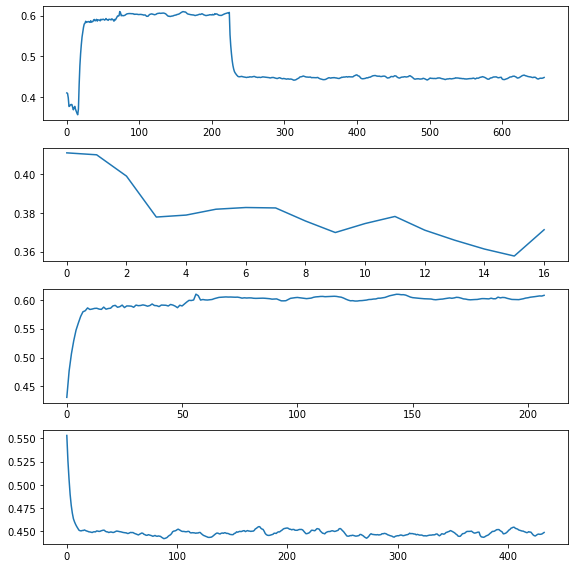

df_len_cnt: 16  H: 10  Total error: 10 Error check:  1855.5478073808326 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.3732418651715922
df_len_cnt: 17  H: 10  Total error: 20 Error check:  107.9093489444143 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  13.659466828415306 False
df_len_cnt: 222  H: 10  Total error: 10 Error check:  21253.556199496223 True
******CHANGE TIMES
ch_times :  [17, 223] ch_num :  2 Resist :  0.5949347770865935
df_len_cnt: 223  H: 10  Total error: 20 Error check:  127.01201776178141 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 223, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.332000       4.48      -20.0
1   2020-02-13 01:38:01     0.336999       4.49      -20.0
2   2020-02-13 13:37:15     0.324953       4.46      -20.0
3   2020-02-14 01:36:29     0.346868       4.49      -20.0
4   2020-02-14 13:35:57     0.358981       4.47      -20.0
5   2020-02-15 01:35:

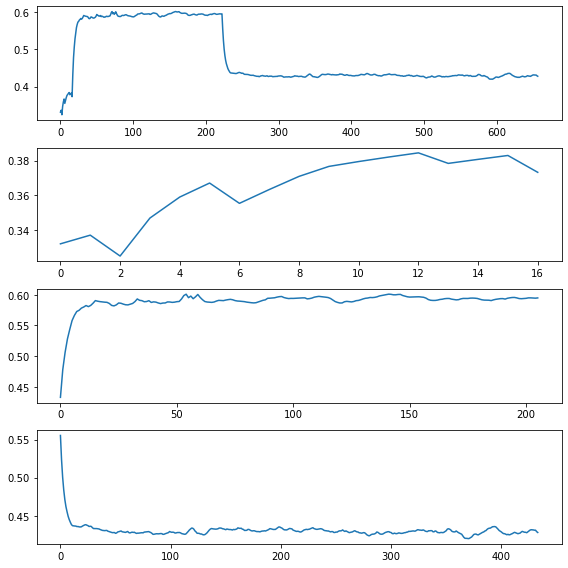

df_len_cnt: 16  H: 10  Total error: 12 Error check:  1173.2233858948116 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.37870242375028
df_len_cnt: 17  H: 10  Total error: 20 Error check:  64.48722059077403 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  18.08491485928793 False
df_len_cnt: 222  H: 10  Total error: 10 Error check:  7218.512358789694 True
******CHANGE TIMES
ch_times :  [17, 223] ch_num :  2 Resist :  0.5978885757989999
df_len_cnt: 223  H: 10  Total error: 20 Error check:  52.45493659726582 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 223, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.380000       4.49      -20.0
1   2020-02-13 01:38:01     0.378000       4.49      -20.0
2   2020-02-13 13:37:15     0.358621       4.46      -20.0
3   2020-02-14 01:36:29     0.368754       4.47      -20.0
4   2020-02-14 13:35:57     0.371444       4.46      -20.0
5   2020-02-15 01:35:07   

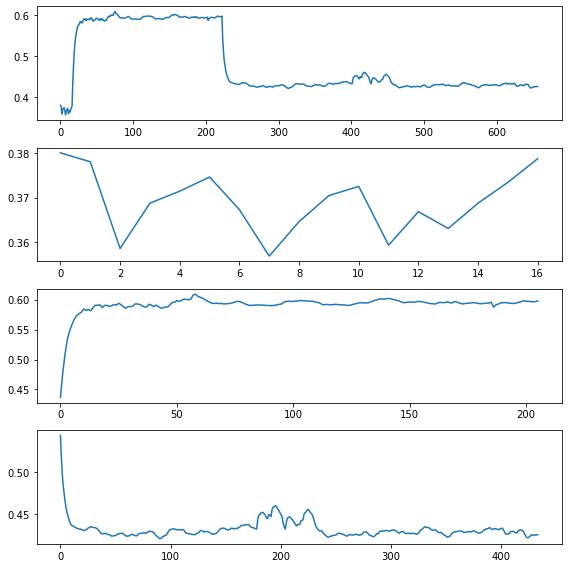

df_len_cnt: 16  H: 10  Total error: 13 Error check:  1074.0774824232583 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.367221595989931
df_len_cnt: 17  H: 10  Total error: 20 Error check:  75.10054412629718 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  18.85991143271929 False
df_len_cnt: 19  H: 10  Total error: 20 Error check:  52.004153750089124 True
******CHANGE TIMES
df_len_cnt: 223  H: 10  Total error: 10 Error check:  7885.851518972777 True
******CHANGE TIMES
ch_times :  [17, 224] ch_num :  2 Resist :  0.5863627874484111
df_len_cnt: 224  H: 10  Total error: 20 Error check:  122.5529739634206 True
******CHANGE TIMES
df_len_cnt: 428  H: 10  Total error: 14 Error check:  29.478399168922724 True
******CHANGE TIMES
ch_times :  [17, 224, 429] ch_num :  3 Resist :  0.44762741203594963
df_len_cnt: 431  H: 10  Total error: 12 Error check:  62.29001247791537 True
******CHANGE TIMES
df_len_cnt: 438  H: 10  Total error: 7 Error check:  24.040415

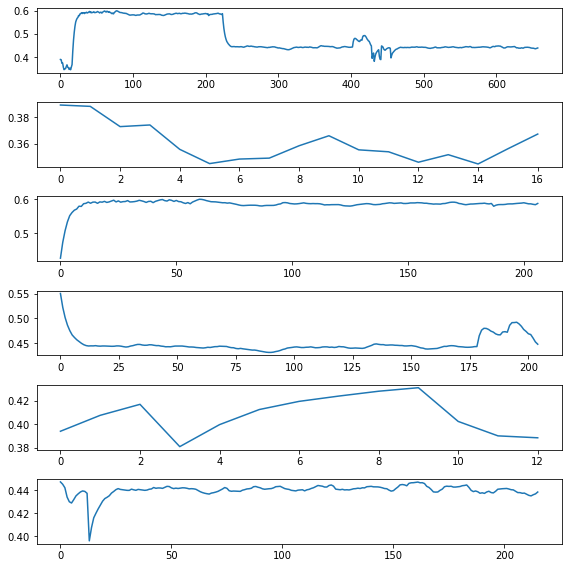

df_len_cnt: 16  H: 10  Total error: 10 Error check:  2746.9659203925557 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.35119112945479825
df_len_cnt: 17  H: 10  Total error: 20 Error check:  99.19560207004349 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  13.467514396058322 False
df_len_cnt: 223  H: 10  Total error: 8 Error check:  3645.4832023174617 True
******CHANGE TIMES
ch_times :  [17, 224] ch_num :  2 Resist :  0.5907811462482269
df_len_cnt: 224  H: 10  Total error: 20 Error check:  34.132602565116784 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 20 Error check:  91.77483937032433 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 12 Error check:  188.67738717638267 True
******CHANGE TIMES
df_len_cnt: 227  H: 10  Total error: 13 Error check:  97.03496821931022 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 224, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49    

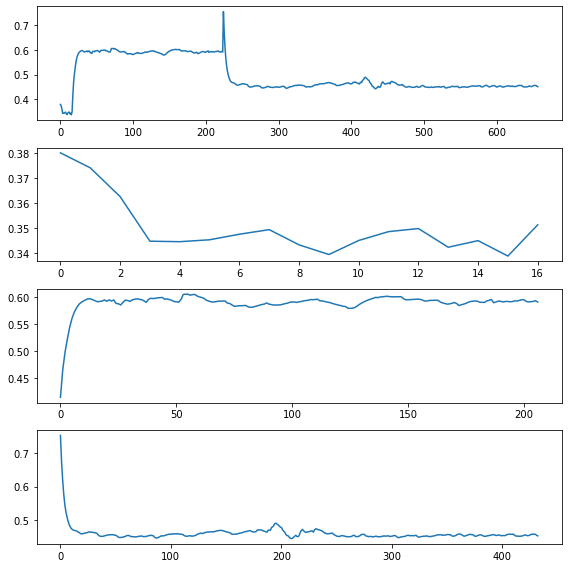

df_len_cnt: 16  H: 10  Total error: 10 Error check:  1743.85872661132 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.3412788604394694
df_len_cnt: 17  H: 10  Total error: 20 Error check:  122.8585814425909 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  13.260929154575976 False
df_len_cnt: 223  H: 10  Total error: 10 Error check:  23861.428639693226 True
******CHANGE TIMES
ch_times :  [17, 224] ch_num :  2 Resist :  0.6068123380344321
df_len_cnt: 224  H: 10  Total error: 20 Error check:  47.00118258982751 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 224, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.306000       4.45      -20.0
1   2020-02-13 01:38:01     0.312999       4.46      -20.0
2   2020-02-13 13:37:15     0.338664       4.46      -20.0
3   2020-02-14 01:36:29     0.345708       4.45      -20.0
4   2020-02-14 13:35:57     0.349065       4.47      -20.0
5   2020-02-15 01:35:07 

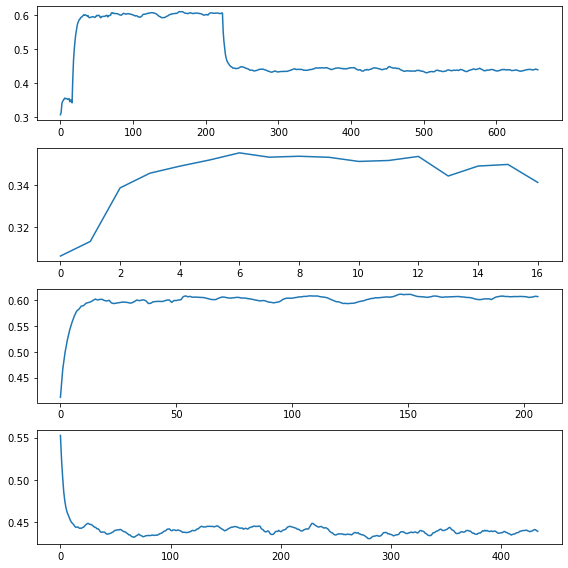

df_len_cnt: 16  H: 10  Total error: 10 Error check:  2452.6898645443025 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.35526281267157533
df_len_cnt: 17  H: 10  Total error: 20 Error check:  88.9783635567413 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  19.23094651211796 False
df_len_cnt: 223  H: 10  Total error: 10 Error check:  7564.4673754780015 True
******CHANGE TIMES
ch_times :  [17, 224] ch_num :  2 Resist :  0.6119748166400402
CHECK TIMES
[None, 17, 224, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.341000       4.46      -20.0
1   2020-02-13 01:38:01     0.340000       4.45      -20.0
2   2020-02-13 13:37:15     0.327430       4.46       18.5
3   2020-02-14 01:36:29     0.343783       4.46      -20.0
4   2020-02-14 13:35:57     0.348747       4.48      -20.0
5   2020-02-15 01:35:07     0.348524       4.48      -20.0
6   2020-02-15 13:34:27     0.340676       4.46       18.1
7

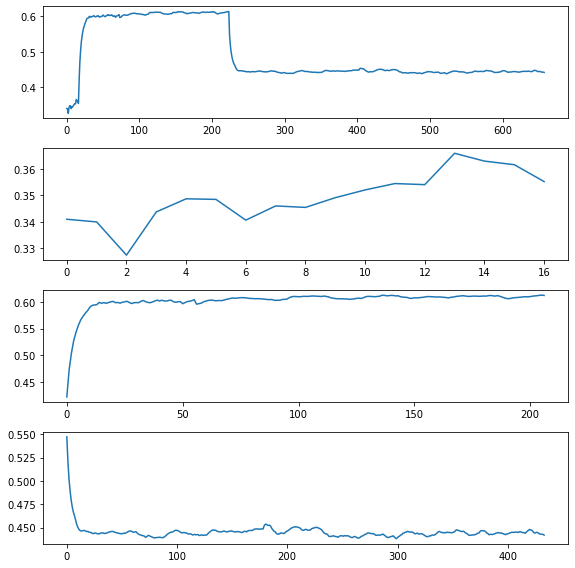

df_len_cnt: 16  H: 10  Total error: 13 Error check:  1308.2316894793942 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.3565427313833616
df_len_cnt: 17  H: 10  Total error: 20 Error check:  84.31926095344066 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  10.21199664673323 False
df_len_cnt: 19  H: 10  Total error: 20 Error check:  48.66361628006812 True
******CHANGE TIMES
df_len_cnt: 223  H: 10  Total error: 10 Error check:  1529.6382621812938 True
******CHANGE TIMES
ch_times :  [17, 224] ch_num :  2 Resist :  0.588692050236936
df_len_cnt: 428  H: 10  Total error: 8 Error check:  151.32296165078117 True
df_len_cnt: 431  H: 10  Total error: 7 Error check:  183.23547491082005 True
df_len_cnt: 441  H: 10  Total error: 17 Error check:  34.403027389267834 True
******CHANGE TIMES
ch_times :  [17, 224, 442] ch_num :  3 Resist :  0.4395492873299837
CHECK TIMES
[None, 17, 224, 442, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempVa

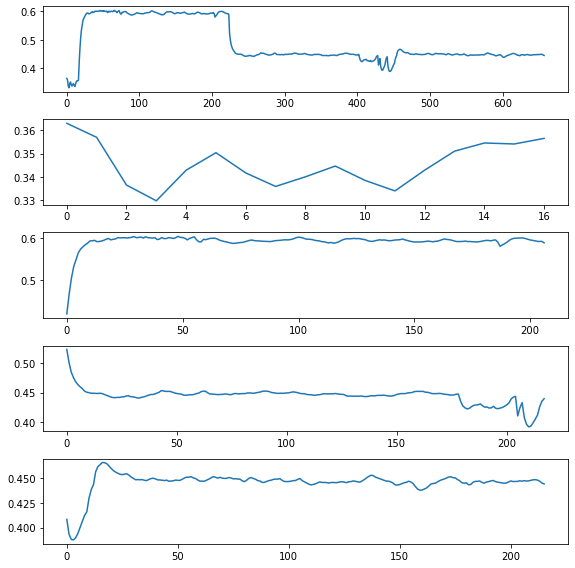

df_len_cnt: 16  H: 10  Total error: 12 Error check:  2200.232983427022 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.34528438494896535
df_len_cnt: 17  H: 10  Total error: 20 Error check:  80.82790020979587 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  12.326375242410522 False
df_len_cnt: 19  H: 10  Total error: 20 Error check:  48.2072118282764 True
******CHANGE TIMES
df_len_cnt: 223  H: 10  Total error: 9 Error check:  1349.0540529090956 True
******CHANGE TIMES
ch_times :  [17, 224] ch_num :  2 Resist :  0.5994029633472274
df_len_cnt: 224  H: 10  Total error: 20 Error check:  23.3325008841648 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 20 Error check:  66.42272017575931 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 20 Error check:  125.99608398463371 True
******CHANGE TIMES
df_len_cnt: 227  H: 10  Total error: 13 Error check:  153.98451815443462 True
******CHANGE TIMES
df_len_cnt: 228  H: 10  Total error

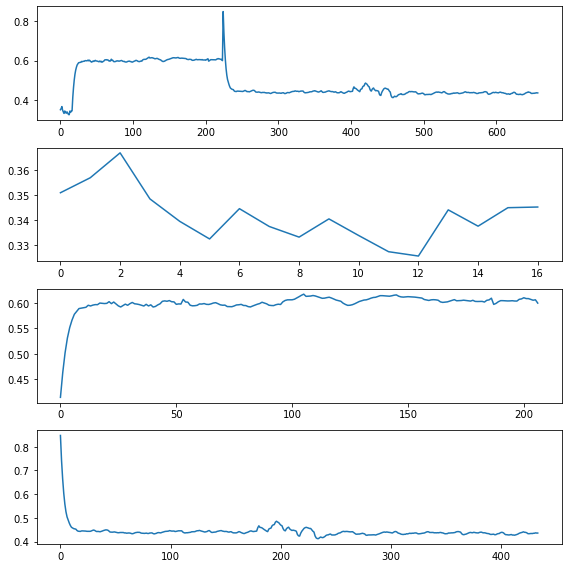

df_len_cnt: 16  H: 10  Total error: 15 Error check:  988.4712560057776 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.33783843118926227
df_len_cnt: 17  H: 10  Total error: 20 Error check:  131.99372800474546 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  7.770612582022511 False
df_len_cnt: 19  H: 10  Total error: 20 Error check:  42.61895874513873 True
******CHANGE TIMES
df_len_cnt: 222  H: 10  Total error: 9 Error check:  2834.8769213806913 True
******CHANGE TIMES
ch_times :  [17, 223] ch_num :  2 Resist :  0.6006217914947958
df_len_cnt: 223  H: 10  Total error: 20 Error check:  16.886531347312577 False
df_len_cnt: 224  H: 10  Total error: 20 Error check:  52.27643964903728 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 20 Error check:  96.14111931354815 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 13 Error check:  126.36162796378045 True
******CHANGE TIMES
df_len_cnt: 227  H: 10  Total error: 20 Error check

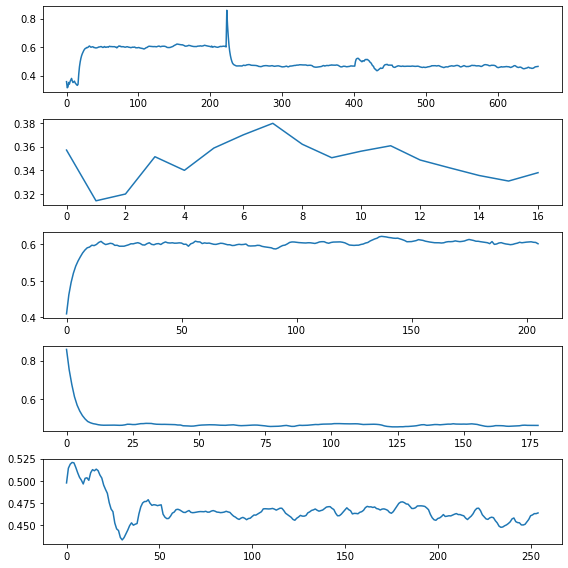

df_len_cnt: 16  H: 10  Total error: 16 Error check:  852.8212507366517 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.3428499195606939
df_len_cnt: 17  H: 10  Total error: 20 Error check:  148.78914585787822 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  11.563237783864368 False
df_len_cnt: 224  H: 10  Total error: 10 Error check:  1807.7255234330864 True
******CHANGE TIMES
ch_times :  [17, 225] ch_num :  2 Resist :  0.6036505651907251
df_len_cnt: 225  H: 10  Total error: 20 Error check:  75.73058541157062 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 225, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.310000       4.47       21.2
1   2020-02-13 01:38:01     0.316999       4.48      -20.0
2   2020-02-13 13:37:15     0.310714       4.47      -20.0
3   2020-02-14 01:36:29     0.337330       4.45      -20.0
4   2020-02-14 13:35:57     0.350924       4.45      -20.0
5   2020-02-15 01:35:0

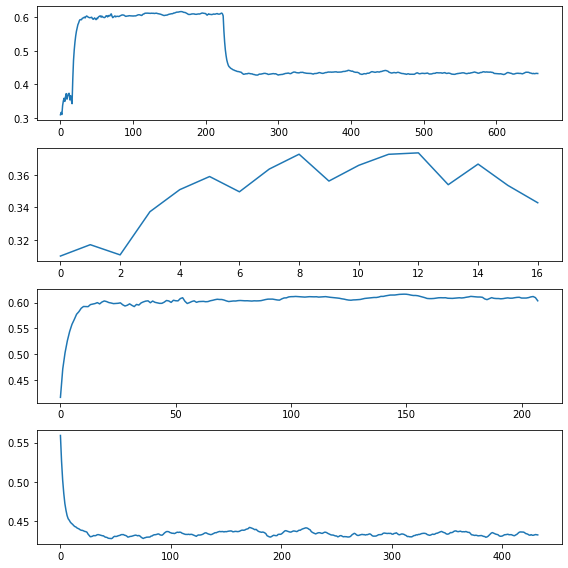

df_len_cnt: 16  H: 10  Total error: 11 Error check:  2500.023850017035 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.356002031744984
df_len_cnt: 17  H: 10  Total error: 20 Error check:  95.4299389868697 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  13.055974235817766 False
df_len_cnt: 224  H: 10  Total error: 10 Error check:  521.5666668219873 True
******CHANGE TIMES
ch_times :  [17, 225] ch_num :  2 Resist :  0.5985928292420147
df_len_cnt: 225  H: 10  Total error: 20 Error check:  43.74289409926349 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 225, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.314000       4.48      -20.0
1   2020-02-13 01:38:01     0.395986       4.49      -20.0
2   2020-02-13 13:37:15     0.386566       4.48      -20.0
3   2020-02-14 01:36:29     0.362915       4.47      -20.0
4   2020-02-14 13:35:57     0.372077       4.48      -20.0
5   2020-02-15 01:35:07   

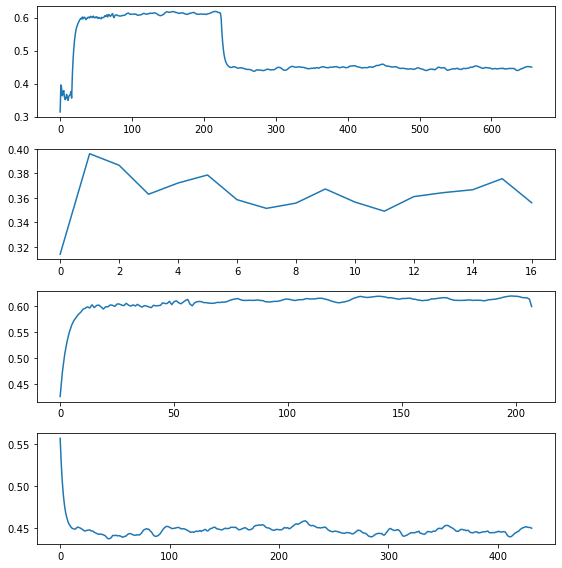

df_len_cnt: 16  H: 10  Total error: 18 Error check:  488.50789293270725 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.373953457840163
df_len_cnt: 17  H: 10  Total error: 20 Error check:  47.92151622063395 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  13.645953862622509 False
df_len_cnt: 19  H: 10  Total error: 20 Error check:  49.77220541868757 True
******CHANGE TIMES
df_len_cnt: 223  H: 10  Total error: 9 Error check:  3856.6399183819763 True
******CHANGE TIMES
ch_times :  [17, 224] ch_num :  2 Resist :  0.5980681830190389
df_len_cnt: 224  H: 10  Total error: 20 Error check:  26.72122016098239 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 20 Error check:  73.28084568958604 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 20 Error check:  140.9198719090932 True
******CHANGE TIMES
df_len_cnt: 227  H: 10  Total error: 13 Error check:  73.1940957143426 True
******CHANGE TIMES
df_len_cnt: 402  H: 10  Total error: 

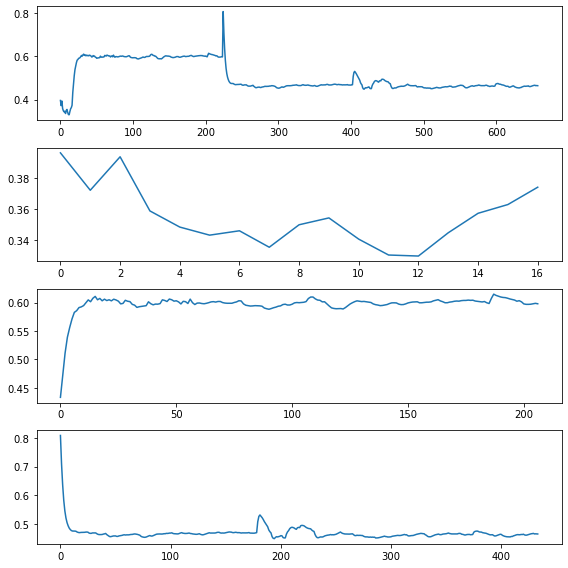

df_len_cnt: 16  H: 10  Total error: 11 Error check:  2286.1140805231985 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.3448879479056054
df_len_cnt: 17  H: 10  Total error: 20 Error check:  116.3147797913612 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  10.002721353492479 False
df_len_cnt: 19  H: 10  Total error: 20 Error check:  47.17964090481478 True
******CHANGE TIMES
df_len_cnt: 223  H: 10  Total error: 8 Error check:  1492.0737864167556 True
******CHANGE TIMES
ch_times :  [17, 224] ch_num :  2 Resist :  0.6081358359209439
df_len_cnt: 224  H: 10  Total error: 20 Error check:  77.42453649170604 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 13 Error check:  268.26761208696297 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 12 Error check:  225.18216010969462 True
******CHANGE TIMES
df_len_cnt: 401  H: 10  Total error: 10 Error check:  2589.7478637479276 True
CHECK TIMES
[None, 17, 224, None]
adf
17
          

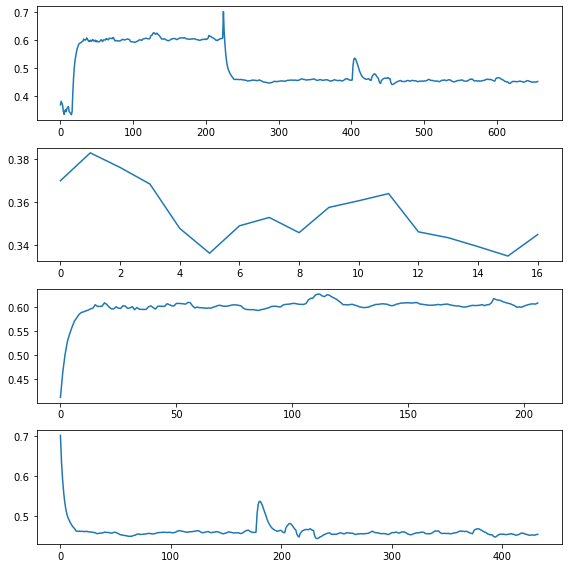

df_len_cnt: 16  H: 10  Total error: 13 Error check:  1237.5591890092837 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.35219182377557456
df_len_cnt: 17  H: 10  Total error: 20 Error check:  128.59436131037495 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  6.885030009124361 False
df_len_cnt: 223  H: 10  Total error: 9 Error check:  2385.711171610528 True
******CHANGE TIMES
ch_times :  [17, 224] ch_num :  2 Resist :  0.6047938014238108
df_len_cnt: 224  H: 10  Total error: 20 Error check:  36.47715628802862 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 20 Error check:  99.38141384670642 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 12 Error check:  221.16774419465835 True
******CHANGE TIMES
df_len_cnt: 227  H: 10  Total error: 20 Error check:  40.95870994597224 True
******CHANGE TIMES
df_len_cnt: 401  H: 10  Total error: 10 Error check:  3462.8759166773557 True
CHECK TIMES
[None, 17, 224, None]
adf
17
          

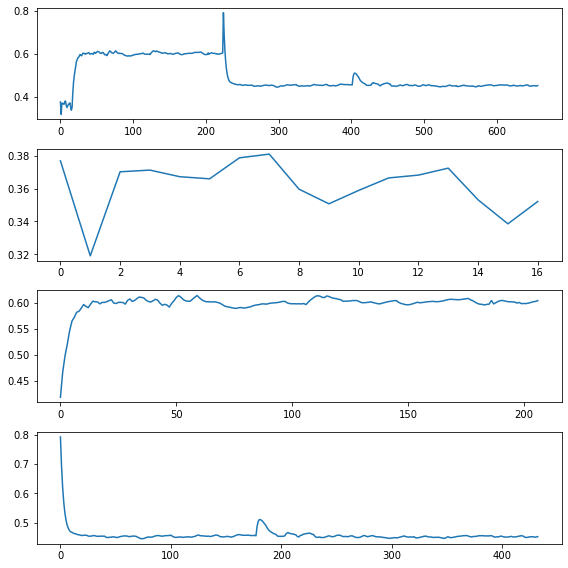

df_len_cnt: 16  H: 10  Total error: 14 Error check:  1039.29677029463 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.3627378498586853
df_len_cnt: 17  H: 10  Total error: 20 Error check:  139.76718853123634 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  1.2319202832840457 False
df_len_cnt: 224  H: 10  Total error: 10 Error check:  11316.468026386674 True
******CHANGE TIMES
ch_times :  [17, 225] ch_num :  2 Resist :  0.6183514946772292
df_len_cnt: 225  H: 10  Total error: 20 Error check:  54.56330586723289 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 225, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.319000       4.46      -20.0
1   2020-02-13 01:38:01     0.304002       4.46      -20.0
2   2020-02-13 13:37:15     0.360045       4.48      -20.0
3   2020-02-14 01:36:29     0.379235       4.44      -20.0
4   2020-02-14 13:35:57     0.377527       4.47      -20.0
5   2020-02-15 01:35:07

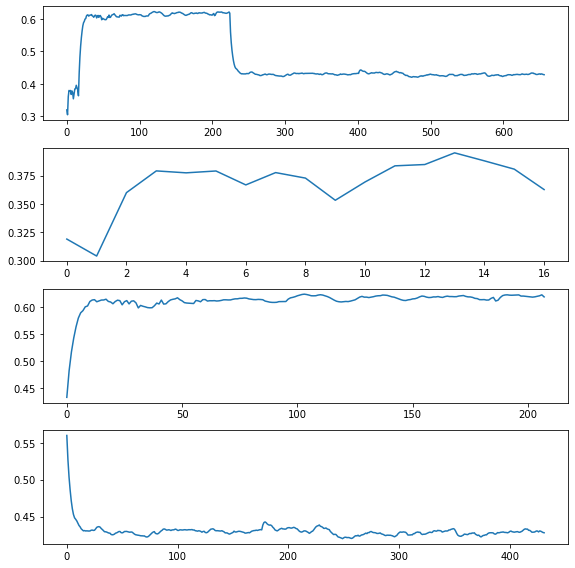

df_len_cnt: 16  H: 10  Total error: 13 Error check:  1334.256331160614 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.36177469385006866
df_len_cnt: 17  H: 10  Total error: 20 Error check:  140.55246192214213 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  5.083445458113845 False
df_len_cnt: 223  H: 10  Total error: 10 Error check:  2433.5060666956288 True
******CHANGE TIMES
ch_times :  [17, 224] ch_num :  2 Resist :  0.6091964706086708
df_len_cnt: 224  H: 10  Total error: 13 Error check:  269.02884447828217 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 20 Error check:  10.365969030453588 False
CHECK TIMES
[None, 17, 224, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.302000       4.47      -20.0
1   2020-02-13 01:38:01     0.356991       4.47      -20.0
2   2020-02-13 13:37:15     0.351234       4.46      -20.0
3   2020-02-14 01:36:29     0.345766       4.45      -20.0
4

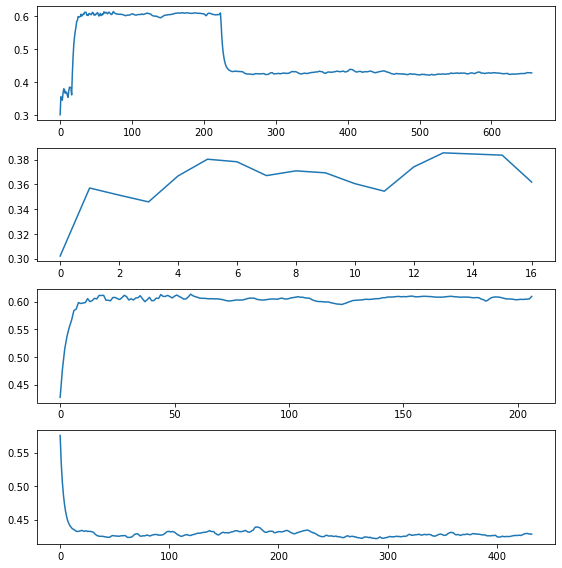

df_len_cnt: 16  H: 10  Total error: 10 Error check:  2021.4282605305964 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.39004079288955823
df_len_cnt: 17  H: 10  Total error: 20 Error check:  136.6318845373745 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  5.439367515269862 False
df_len_cnt: 223  H: 10  Total error: 9 Error check:  1738.6630180628074 True
******CHANGE TIMES
ch_times :  [17, 224] ch_num :  2 Resist :  0.5918771837997434
df_len_cnt: 224  H: 10  Total error: 20 Error check:  46.28569223306592 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 20 Error check:  121.99409147623513 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 12 Error check:  286.3726194981504 True
******CHANGE TIMES
df_len_cnt: 227  H: 10  Total error: 20 Error check:  47.9344377447866 True
******CHANGE TIMES
df_len_cnt: 401  H: 10  Total error: 5 Error check:  496.319744894169 True
CHECK TIMES
[None, 17, 224, None]
adf
17
              

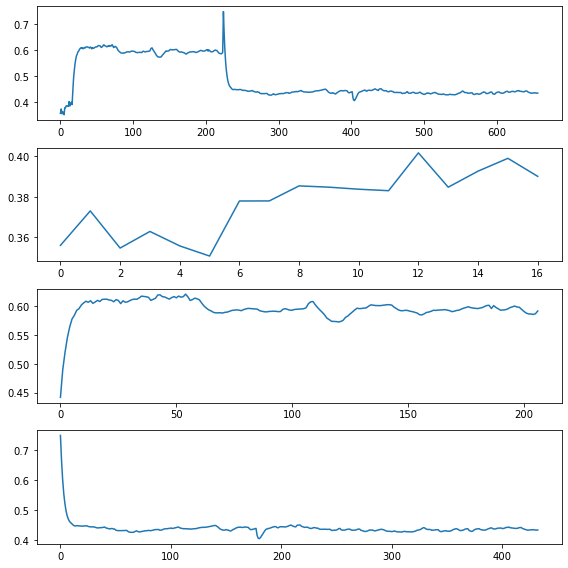

df_len_cnt: 16  H: 10  Total error: 18 Error check:  448.2194005977492 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.3689393834139682
df_len_cnt: 17  H: 10  Total error: 16 Error check:  296.6534635179584 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  39.20528936634676 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  23.18687493254426 True
******CHANGE TIMES
df_len_cnt: 223  H: 10  Total error: 9 Error check:  2812.590365151744 True
******CHANGE TIMES
ch_times :  [17, 224] ch_num :  2 Resist :  0.6250202597882377
df_len_cnt: 224  H: 10  Total error: 20 Error check:  270.5430423129232 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 11 Error check:  566.1922382730189 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 20 Error check:  36.51619393044778 True
******CHANGE TIMES
df_len_cnt: 227  H: 10  Total error: 20 Error check:  33.49920993749749 True
******CHANGE TIMES
CHECK TIMES
[None, 1

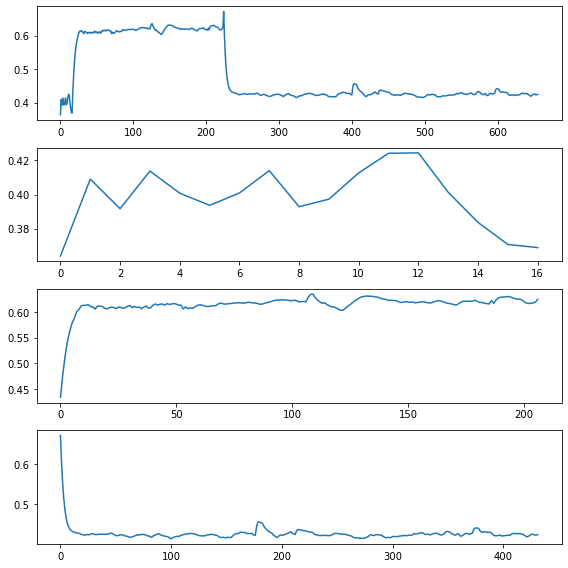

df_len_cnt: 16  H: 10  Total error: 13 Error check:  1072.0032732312047 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.3867373959866798
df_len_cnt: 17  H: 10  Total error: 20 Error check:  142.6838580003915 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  0.116987825381797 False
df_len_cnt: 223  H: 10  Total error: 9 Error check:  2014.9668222206174 True
******CHANGE TIMES
ch_times :  [17, 224] ch_num :  2 Resist :  0.6292802550071279
df_len_cnt: 224  H: 10  Total error: 20 Error check:  81.11717150840948 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 20 Error check:  268.7468562685035 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 12 Error check:  259.41495850303835 True
******CHANGE TIMES
df_len_cnt: 227  H: 10  Total error: 20 Error check:  26.11415627074179 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 224, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.

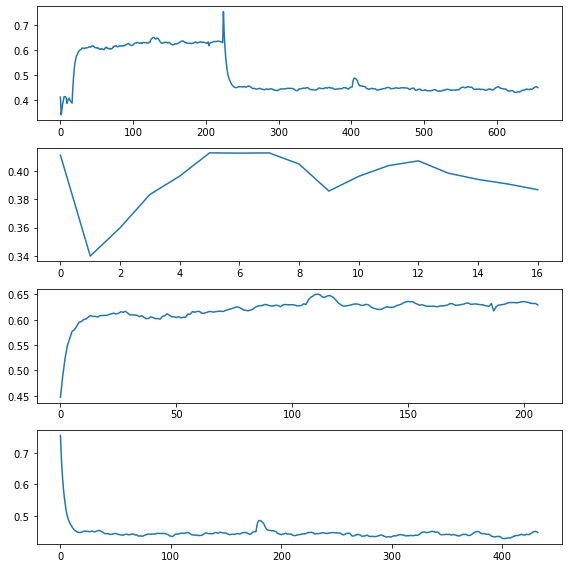

df_len_cnt: 16  H: 10  Total error: 12 Error check:  1476.616017666562 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.3919583264437873
df_len_cnt: 17  H: 10  Total error: 20 Error check:  106.39417215956453 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  2.6559406210149374 False
df_len_cnt: 223  H: 10  Total error: 10 Error check:  27056.4631277235 True
******CHANGE TIMES
ch_times :  [17, 224] ch_num :  2 Resist :  0.6094217409492387
df_len_cnt: 224  H: 10  Total error: 20 Error check:  29.04226171689436 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 224, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.335000       4.46      -20.0
1   2020-02-13 01:38:01     0.359996       4.46      -20.0
2   2020-02-13 13:37:15     0.375711       4.48      -20.0
3   2020-02-14 01:36:29     0.389652       4.47      -20.0
4   2020-02-14 13:35:57     0.375086       4.47      -20.0
5   2020-02-15 01:35:07 

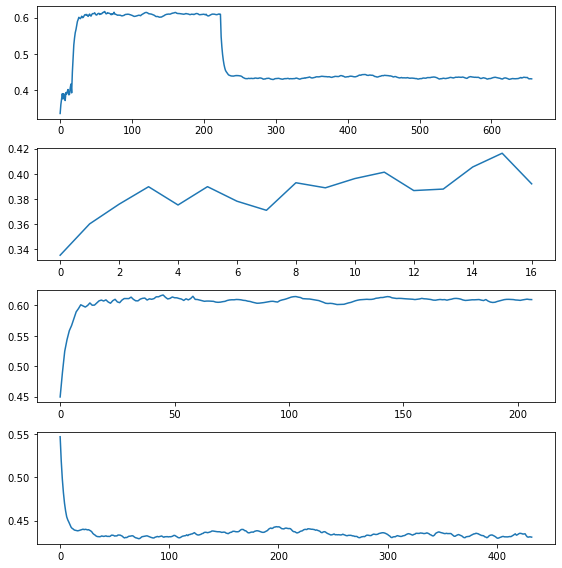

df_len_cnt: 16  H: 10  Total error: 11 Error check:  1289.7599086869193 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.38417195211110444
df_len_cnt: 17  H: 10  Total error: 20 Error check:  62.41068842253116 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  7.03937795049274 False
df_len_cnt: 223  H: 10  Total error: 10 Error check:  345.5827996983168 True
******CHANGE TIMES
ch_times :  [17, 224] ch_num :  2 Resist :  0.5939902827946982
df_len_cnt: 224  H: 10  Total error: 20 Error check:  30.66731257429009 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 224, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.349000       4.47      -20.0
1   2020-02-13 01:38:01     0.446984       4.50       19.8
2   2020-02-13 13:37:15     0.410328       4.49      -20.0
3   2020-02-14 01:36:29     0.383312       4.46      -20.0
4   2020-02-14 13:35:57     0.368857       4.47      -20.0
5   2020-02-15 01:35:07 

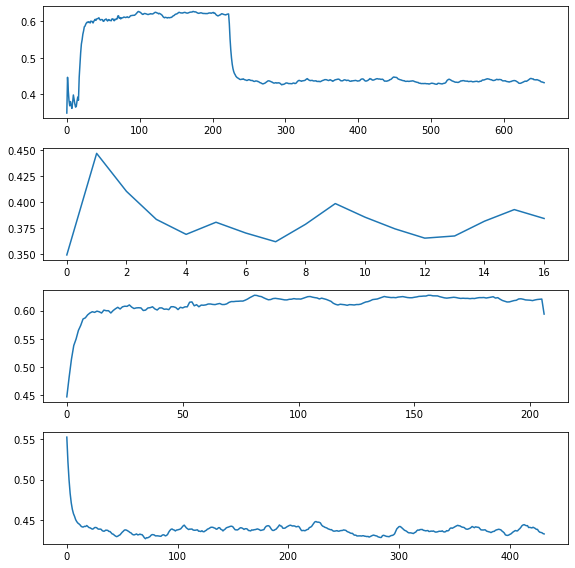

df_len_cnt: 16  H: 10  Total error: 16 Error check:  619.0050551347988 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.39328704271263676
df_len_cnt: 17  H: 10  Total error: 20 Error check:  35.09253859538486 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  23.669742276045667 True
******CHANGE TIMES
df_len_cnt: 223  H: 10  Total error: 9 Error check:  4464.688710894921 True
******CHANGE TIMES
ch_times :  [17, 224] ch_num :  2 Resist :  0.6242330361517947
df_len_cnt: 224  H: 10  Total error: 20 Error check:  71.27322504432969 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 20 Error check:  205.70825979090753 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 12 Error check:  323.50284286207966 True
******CHANGE TIMES
df_len_cnt: 227  H: 10  Total error: 20 Error check:  21.079046209850333 True
******CHANGE TIMES
df_len_cnt: 228  H: 10  Total error: 20 Error check:  35.5420002561865 True
******CHANGE TIMES
CHECK TIMES
[No

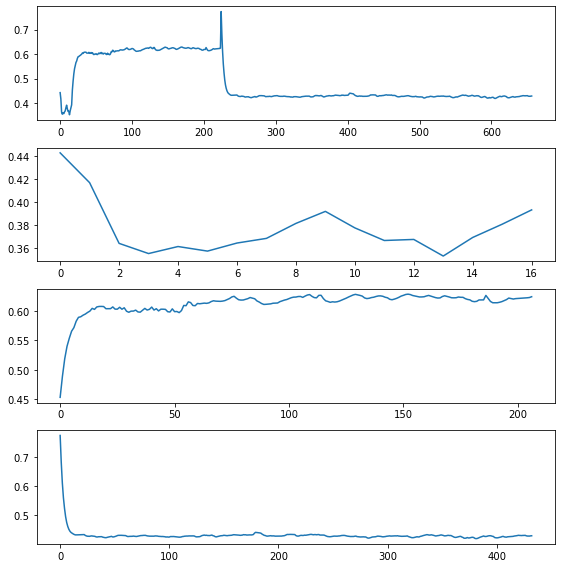

df_len_cnt: 16  H: 10  Total error: 10 Error check:  1766.0850484413104 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.37458767784782115
df_len_cnt: 17  H: 10  Total error: 20 Error check:  85.50368898978518 True
******CHANGE TIMES
df_len_cnt: 223  H: 10  Total error: 9 Error check:  2047.5226824642486 True
******CHANGE TIMES
ch_times :  [17, 224] ch_num :  2 Resist :  0.6189245849705102
df_len_cnt: 224  H: 10  Total error: 20 Error check:  63.09072253006091 True
******CHANGE TIMES
df_len_cnt: 225  H: 10  Total error: 20 Error check:  179.9518745799715 True
******CHANGE TIMES
df_len_cnt: 226  H: 10  Total error: 12 Error check:  424.47906332454 True
******CHANGE TIMES
df_len_cnt: 227  H: 10  Total error: 20 Error check:  32.07211375022718 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 224, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 13:38:49     0.412000       4.48      -20.0
1   2020-02-13 01:38:01     0.408001       4.47   

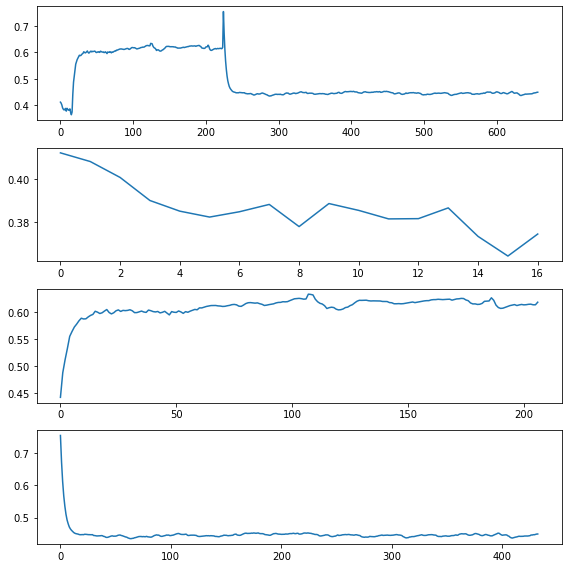

df_len_cnt: 16  H: 10  Total error: 20 Error check:  24.67091448266632 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  105.39124113881158
df_len_cnt: 17  H: 10  Total error: 20 Error check:  34.80739126721279 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  47.82284230492608 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  60.637851909047356 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  71.37999728272379 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  79.59986554529763 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 20 Error check:  85.5628083600979 True
******CHANGE TIMES
df_len_cnt: 23  H: 10  Total error: 20 Error check:  89.79436641651961 True
******CHANGE TIMES
df_len_cnt: 24  H: 10  Total error: 20 Error check:  89.78559701297726 True
******CHANGE TIMES
df_len_cnt: 25  H: 10  Total error: 20 Error check:  89.77901830048418 True
******CHANG

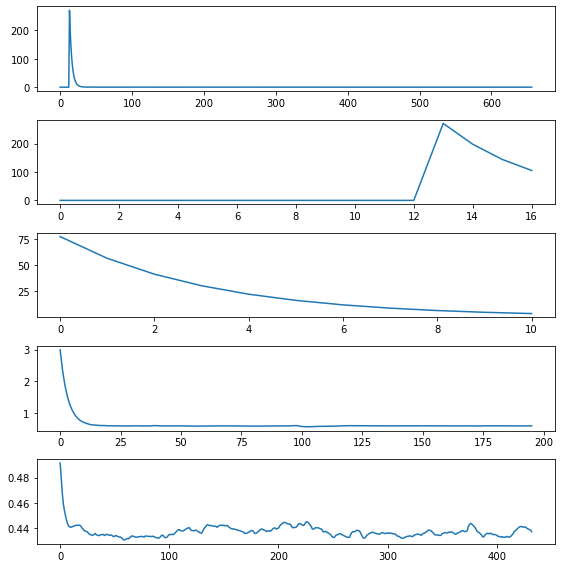

df_len_cnt: 16  H: 10  Total error: 19 Error check:  12.337101525708853 False
df_len_cnt: 17  H: 10  Total error: 19 Error check:  10.609694810677928 False
df_len_cnt: 18  H: 10  Total error: 19 Error check:  34.62242369774145 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  58.84984344902023
df_len_cnt: 19  H: 10  Total error: 19 Error check:  54.35572178264635 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 19 Error check:  68.7126052870435 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 19 Error check:  78.60280180225645 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 19 Error check:  85.2870899508522 True
******CHANGE TIMES
df_len_cnt: 23  H: 10  Total error: 20 Error check:  89.80181971515897 True
******CHANGE TIMES
df_len_cnt: 24  H: 10  Total error: 20 Error check:  89.79905149130815 True
******CHANGE TIMES
df_len_cnt: 25  H: 10  Total error: 20 Error check:  89.78922108464675 True
******CHANGE TIMES
df_len_cnt: 26  H: 10  Total 

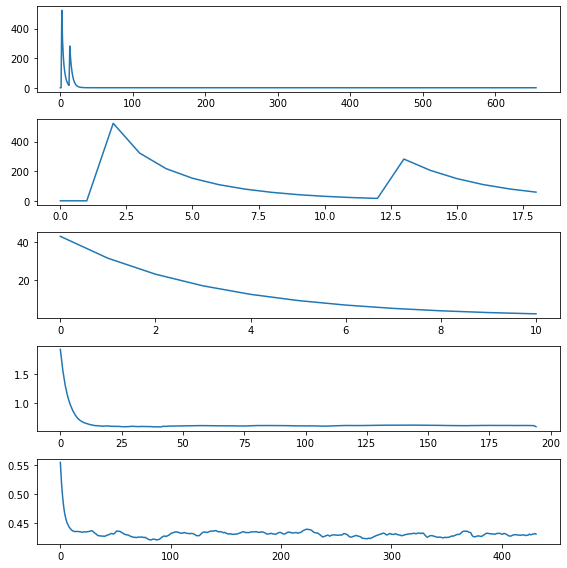

df_len_cnt: 16  H: 10  Total error: 19 Error check:  12.352993656175682 False
df_len_cnt: 17  H: 10  Total error: 19 Error check:  10.594128845336659 False
df_len_cnt: 18  H: 10  Total error: 19 Error check:  34.605469361602545 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  58.85434560832499
df_len_cnt: 19  H: 10  Total error: 19 Error check:  54.34848187065037 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 19 Error check:  68.7120205696431 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 19 Error check:  78.59995220483714 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 19 Error check:  85.28816796918947 True
******CHANGE TIMES
df_len_cnt: 23  H: 10  Total error: 20 Error check:  89.80369726227926 True
******CHANGE TIMES
df_len_cnt: 24  H: 10  Total error: 20 Error check:  89.80723636610355 True
******CHANGE TIMES
df_len_cnt: 25  H: 10  Total error: 20 Error check:  89.80654300853166 True
******CHANGE TIMES
df_len_cnt: 26  H: 10  Tota

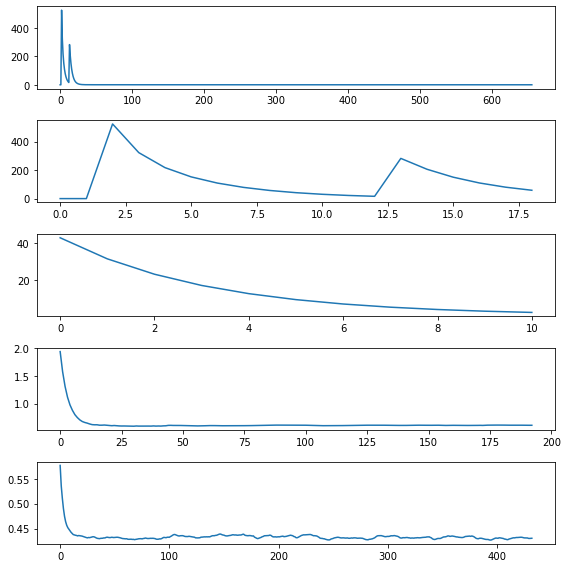

df_len_cnt: 16  H: 10  Total error: 20 Error check:  10.818640379976971 False
df_len_cnt: 17  H: 10  Total error: 20 Error check:  27.76191746581574 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  89.13401402435173
df_len_cnt: 18  H: 10  Total error: 20 Error check:  45.956049720202486 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  61.41982696502858 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  72.58842128879843 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  80.37788480467694 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 20 Error check:  85.8808075044572 True
******CHANGE TIMES
df_len_cnt: 23  H: 10  Total error: 20 Error check:  89.80018929960181 True
******CHANGE TIMES
df_len_cnt: 24  H: 10  Total error: 20 Error check:  89.79625885353411 True
******CHANGE TIMES
df_len_cnt: 25  H: 10  Total error: 20 Error check:  89.79767096454148 True
******CHANGE TIMES
df_len_cnt

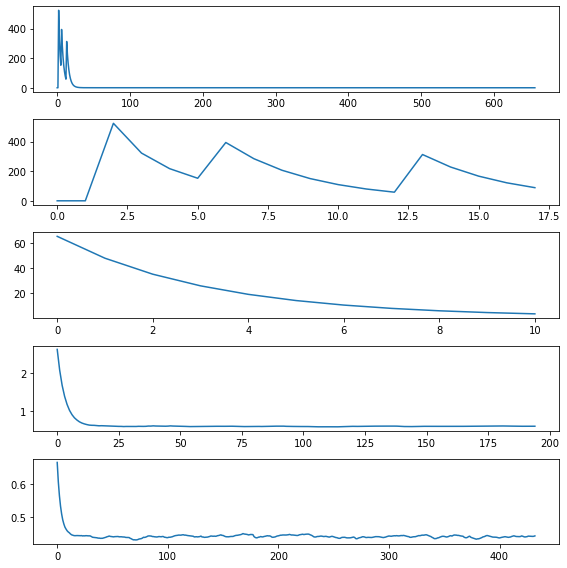

df_len_cnt: 16  H: 10  Total error: 20 Error check:  20.72595084424778 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  194.03950884018474
df_len_cnt: 17  H: 10  Total error: 20 Error check:  50.896227555952414 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  63.48404597602254 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  73.00843823425978 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  80.12383747312116 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  85.3999330971653 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 20 Error check:  87.64395773239312 True
******CHANGE TIMES
df_len_cnt: 23  H: 10  Total error: 20 Error check:  89.79510233302763 True
******CHANGE TIMES
df_len_cnt: 24  H: 10  Total error: 20 Error check:  89.78973905779874 True
******CHANGE TIMES
df_len_cnt: 25  H: 10  Total error: 20 Error check:  89.78958085074737 True
******CHANG

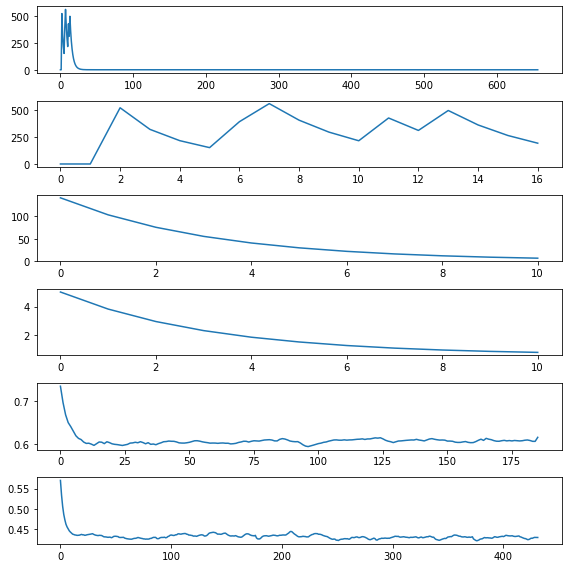

df_len_cnt: 16  H: 10  Total error: 20 Error check:  10.454981135651046 False
df_len_cnt: 17  H: 10  Total error: 20 Error check:  45.11013266412953 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  202.74828442564814
df_len_cnt: 18  H: 10  Total error: 20 Error check:  60.91615908121328 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  72.00134597491294 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  79.84465892395926 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  85.43651832763835 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 20 Error check:  88.38040824823817 True
******CHANGE TIMES
df_len_cnt: 23  H: 10  Total error: 20 Error check:  89.79328772561738 True
******CHANGE TIMES
df_len_cnt: 24  H: 10  Total error: 20 Error check:  89.79125216343242 True
******CHANGE TIMES
df_len_cnt: 25  H: 10  Total error: 20 Error check:  89.79045728724545 True
******CHANGE TIMES
df_len_cn

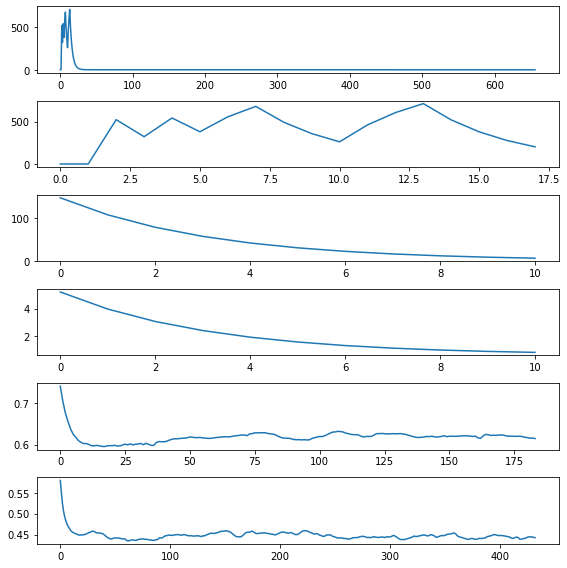

df_len_cnt: 16  H: 10  Total error: 20 Error check:  34.513444461285 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  332.877960420391
df_len_cnt: 17  H: 10  Total error: 20 Error check:  56.057035425183265 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  67.68917199717214 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  76.31198630170357 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  82.6615215473279 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  86.40421176118386 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 20 Error check:  88.64219949984043 True
******CHANGE TIMES
df_len_cnt: 23  H: 10  Total error: 20 Error check:  89.79220956157766 True
******CHANGE TIMES
df_len_cnt: 24  H: 10  Total error: 20 Error check:  89.79206929186172 True
******CHANGE TIMES
df_len_cnt: 25  H: 10  Total error: 20 Error check:  89.79137675349644 True
******CHANGE TI

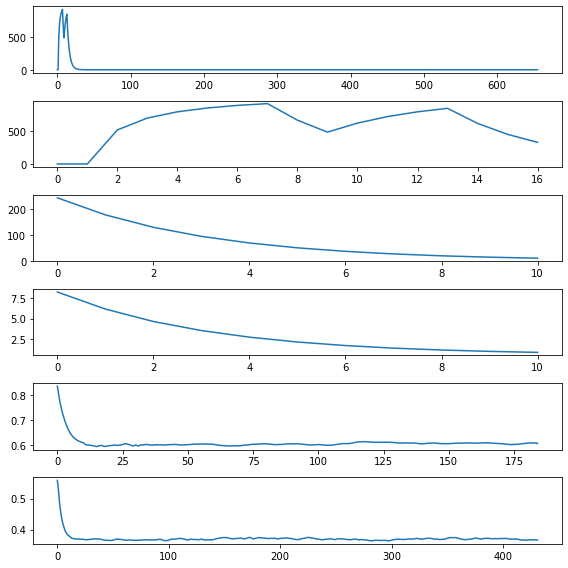

df_len_cnt: 16  H: 10  Total error: 20 Error check:  47.49457486920742 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  551.9580062501996
df_len_cnt: 17  H: 10  Total error: 20 Error check:  23.73877075746715 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  51.32765618688483 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  65.55196261706006 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  75.41218846265282 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  81.28484918803855 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 20 Error check:  84.97113957627285 True
******CHANGE TIMES
df_len_cnt: 23  H: 10  Total error: 20 Error check:  87.26181193191684 True
******CHANGE TIMES
df_len_cnt: 24  H: 10  Total error: 20 Error check:  88.46705643259102 True
******CHANGE TIMES
df_len_cnt: 25  H: 10  Total error: 20 Error check:  89.79055238095846 True
******CHANGE

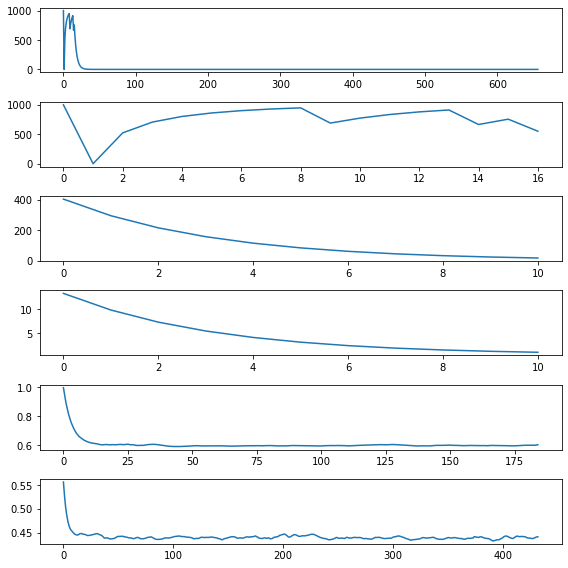

df_len_cnt: 16  H: 10  Total error: 20 Error check:  100.21518350531436 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  729.9182894559721
df_len_cnt: 17  H: 10  Total error: 20 Error check:  10.330532118581697 False
df_len_cnt: 18  H: 10  Total error: 20 Error check:  46.38351968614642 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  63.8219427725594 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  73.8210104124263 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  80.10077630933111 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 20 Error check:  84.24364306171401 True
******CHANGE TIMES
df_len_cnt: 23  H: 10  Total error: 20 Error check:  87.02059850462008 True
******CHANGE TIMES
df_len_cnt: 24  H: 10  Total error: 20 Error check:  88.8204349896602 True
******CHANGE TIMES
df_len_cnt: 25  H: 10  Total error: 20 Error check:  89.78961102280118 True
******CHANGE TIMES
df_len_cnt: 

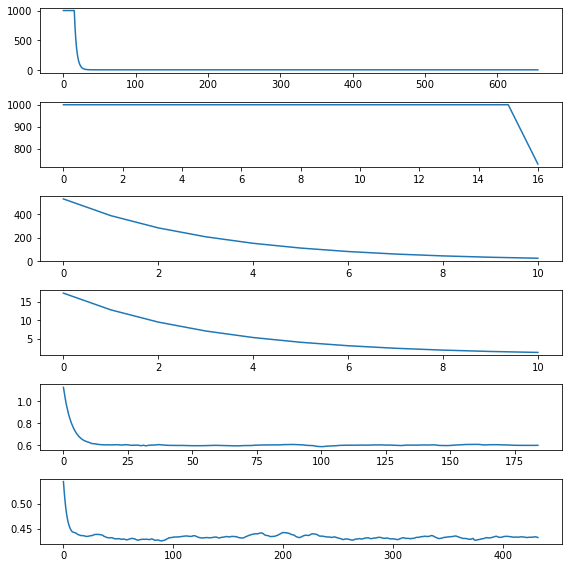

df_len_cnt: 16  H: 10  Total error: 20 Error check:  47.432385731750806 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  624.900537341867
df_len_cnt: 17  H: 10  Total error: 20 Error check:  24.10458738493887 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 20 Error check:  52.01755231338816 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  66.48966229673806 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  75.07343973202791 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  80.5384146829845 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 20 Error check:  84.11800636098988 True
******CHANGE TIMES
df_len_cnt: 23  H: 10  Total error: 20 Error check:  86.40304162379071 True
******CHANGE TIMES
df_len_cnt: 24  H: 10  Total error: 20 Error check:  88.6422318861137 True
******CHANGE TIMES
df_len_cnt: 25  H: 10  Total error: 20 Error check:  89.79201059358834 True
******CHANGE T

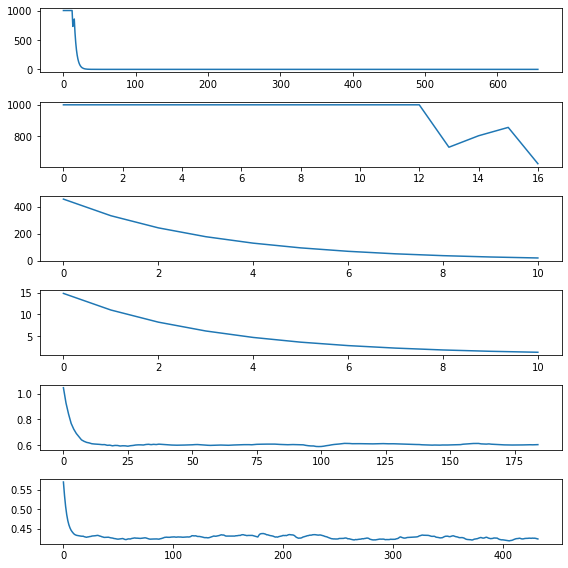

df_len_cnt: 16  H: 10  Total error: 20 Error check:  100.20311303214426 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  729.9058610329147
df_len_cnt: 17  H: 10  Total error: 20 Error check:  10.332082668488699 False
df_len_cnt: 18  H: 10  Total error: 20 Error check:  46.384237664471556 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  63.82190529862973 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  73.82272915228098 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  80.10214584947934 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 20 Error check:  84.24451827015076 True
******CHANGE TIMES
df_len_cnt: 23  H: 10  Total error: 20 Error check:  87.02126519210722 True
******CHANGE TIMES
df_len_cnt: 24  H: 10  Total error: 20 Error check:  88.82046939611806 True
******CHANGE TIMES
df_len_cnt: 25  H: 10  Total error: 20 Error check:  89.78988302479824 True
******CHANGE TIMES
df_len_c

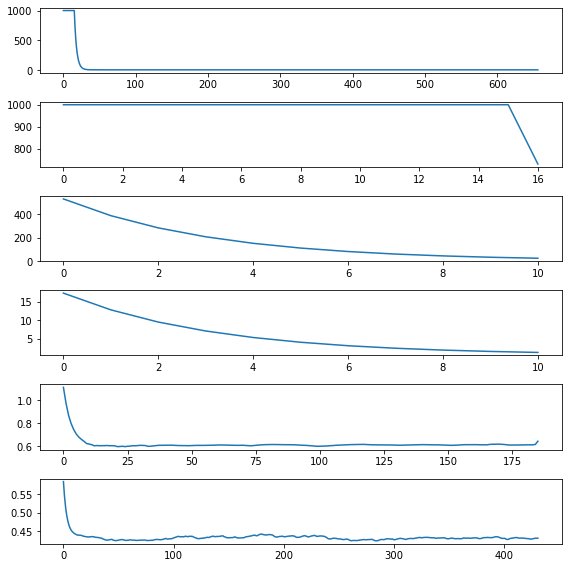

df_len_cnt: 16  H: 10  Total error: 20 Error check:  100.19873964636281 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  729.9004573707159
df_len_cnt: 17  H: 10  Total error: 20 Error check:  10.334442169215382 False
df_len_cnt: 18  H: 10  Total error: 20 Error check:  46.385100102474034 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  63.823818397685194 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  73.82277971825361 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  80.10173527694238 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 20 Error check:  84.24422819550004 True
******CHANGE TIMES
df_len_cnt: 23  H: 10  Total error: 20 Error check:  87.02150821489091 True
******CHANGE TIMES
df_len_cnt: 24  H: 10  Total error: 20 Error check:  88.8197261603268 True
******CHANGE TIMES
df_len_cnt: 25  H: 10  Total error: 20 Error check:  89.79130871654564 True
******CHANGE TIMES
df_len_c

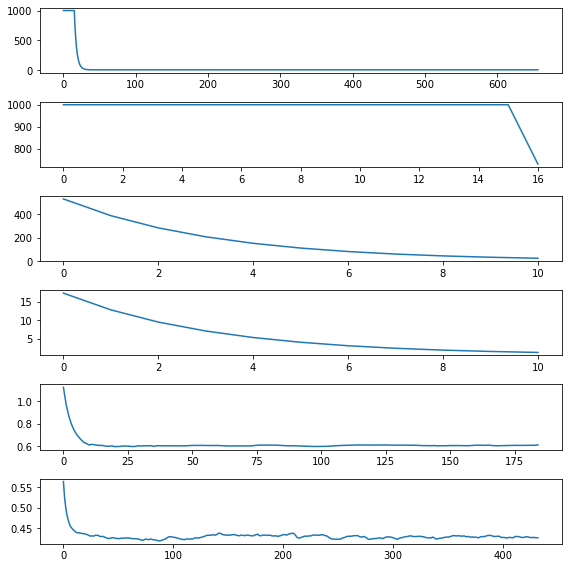

df_len_cnt: 16  H: 10  Total error: 20 Error check:  100.20470051174517 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  729.9085628640141
df_len_cnt: 17  H: 10  Total error: 20 Error check:  10.33219838112937 False
df_len_cnt: 18  H: 10  Total error: 20 Error check:  46.38533596344595 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  63.823094538076106 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  73.82289492783981 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  80.09961143996605 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 20 Error check:  84.24318610448952 True
******CHANGE TIMES
df_len_cnt: 23  H: 10  Total error: 20 Error check:  87.02018752093285 True
******CHANGE TIMES
df_len_cnt: 24  H: 10  Total error: 20 Error check:  88.81962787577694 True
******CHANGE TIMES
df_len_cnt: 25  H: 10  Total error: 20 Error check:  89.78831004382116 True
******CHANGE TIMES
df_len_cn

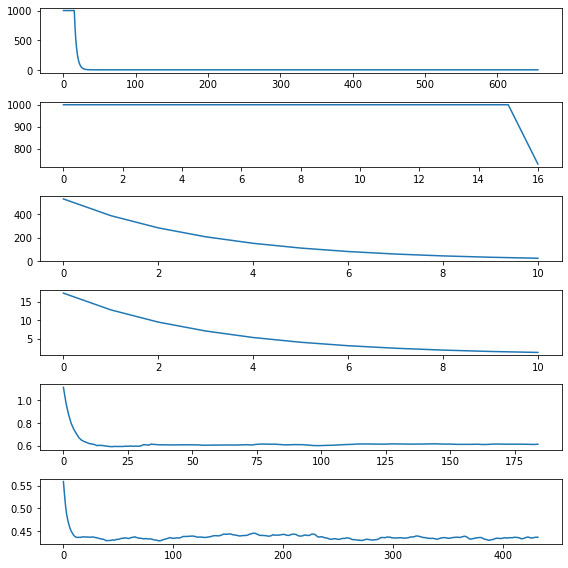

df_len_cnt: 16  H: 10  Total error: 20 Error check:  100.2163830308152 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  729.9182894559721
df_len_cnt: 17  H: 10  Total error: 20 Error check:  10.328443635496809 False
df_len_cnt: 18  H: 10  Total error: 20 Error check:  46.38272234899455 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  63.82194313364353 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  73.82136622507085 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  80.10067545546295 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 20 Error check:  84.24342403206751 True
******CHANGE TIMES
df_len_cnt: 23  H: 10  Total error: 20 Error check:  87.02018096054482 True
******CHANGE TIMES
df_len_cnt: 24  H: 10  Total error: 20 Error check:  88.8217891730834 True
******CHANGE TIMES
df_len_cnt: 25  H: 10  Total error: 20 Error check:  89.79257877633525 True
******CHANGE TIMES
df_len_cnt:

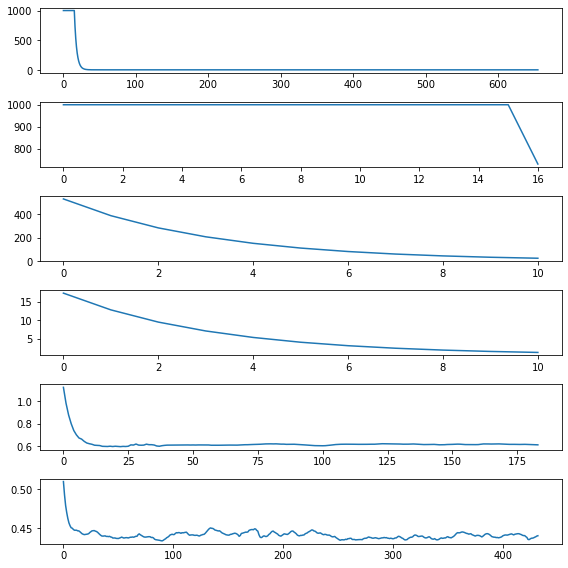

df_len_cnt: 16  H: 10  Total error: 20 Error check:  100.2194289557018 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  729.9239633012809
df_len_cnt: 17  H: 10  Total error: 20 Error check:  10.32897182524298 False
df_len_cnt: 18  H: 10  Total error: 20 Error check:  46.3827332231552 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  63.82215390862183 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  73.82160168062066 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  80.10158197523484 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 20 Error check:  84.2416928343033 True
******CHANGE TIMES
df_len_cnt: 23  H: 10  Total error: 20 Error check:  87.01915943417333 True
******CHANGE TIMES
df_len_cnt: 24  H: 10  Total error: 20 Error check:  88.81846451160233 True
******CHANGE TIMES
df_len_cnt: 25  H: 10  Total error: 20 Error check:  89.78846074956526 True
******CHANGE TIMES
df_len_cnt: 2

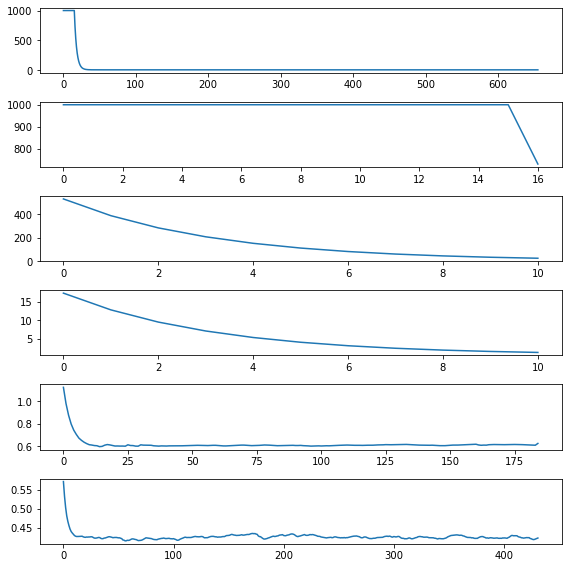

df_len_cnt: 16  H: 10  Total error: 20 Error check:  100.19875786442036 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  729.9007275538258
df_len_cnt: 17  H: 10  Total error: 20 Error check:  10.334764857774184 False
df_len_cnt: 18  H: 10  Total error: 20 Error check:  46.38659193918799 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  63.82316590426386 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  73.81956603011604 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  80.10096098827256 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 20 Error check:  84.2450534531835 True
******CHANGE TIMES
df_len_cnt: 23  H: 10  Total error: 20 Error check:  87.02287567324473 True
******CHANGE TIMES
df_len_cnt: 24  H: 10  Total error: 20 Error check:  88.82197230020675 True
******CHANGE TIMES
df_len_cnt: 25  H: 10  Total error: 20 Error check:  89.79111483251448 True
******CHANGE TIMES
df_len_cnt

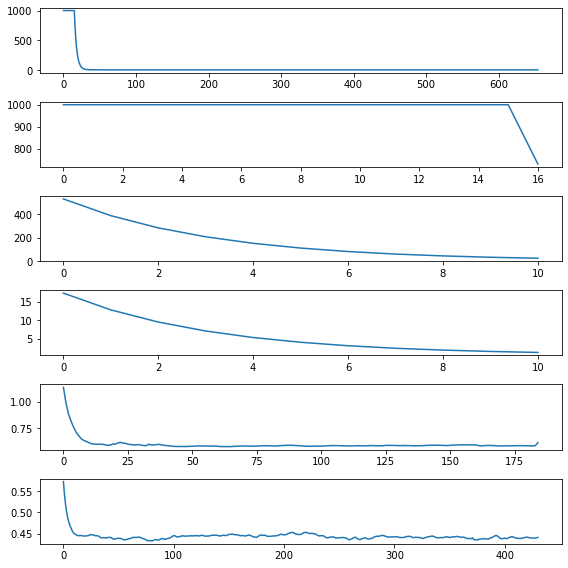

df_len_cnt: 16  H: 10  Total error: 20 Error check:  100.19871879542744 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  729.9036995680351
df_len_cnt: 17  H: 10  Total error: 20 Error check:  10.335052073062483 False
df_len_cnt: 18  H: 10  Total error: 20 Error check:  46.38653928843735 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  63.82158462521264 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  73.8216464094396 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  80.10157508171747 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 20 Error check:  84.24451399310526 True
******CHANGE TIMES
df_len_cnt: 23  H: 10  Total error: 20 Error check:  87.02140662298548 True
******CHANGE TIMES
df_len_cnt: 24  H: 10  Total error: 20 Error check:  88.82225682018124 True
******CHANGE TIMES
df_len_cnt: 25  H: 10  Total error: 20 Error check:  89.78806297122378 True
******CHANGE TIMES
df_len_cnt

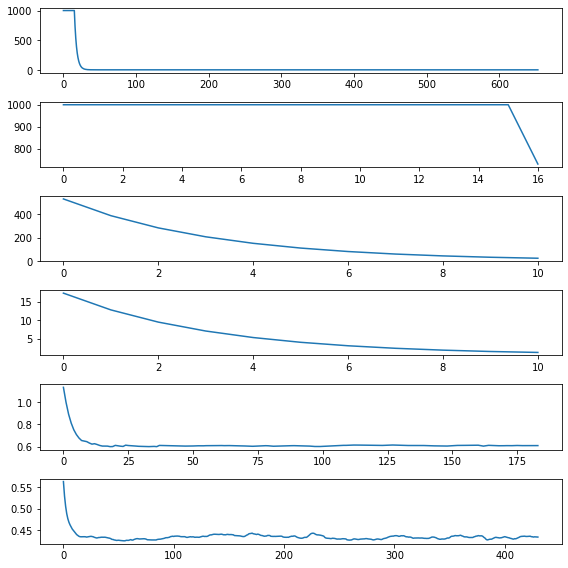

df_len_cnt: 16  H: 10  Total error: 20 Error check:  100.2204719412243 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  729.922882568841
df_len_cnt: 17  H: 10  Total error: 20 Error check:  10.328155246792402 False
df_len_cnt: 18  H: 10  Total error: 20 Error check:  46.38287433132303 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  63.82219472387679 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  73.82215904302458 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  80.10221645999235 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 20 Error check:  84.24521310089678 True
******CHANGE TIMES
df_len_cnt: 23  H: 10  Total error: 20 Error check:  87.02224251706208 True
******CHANGE TIMES
df_len_cnt: 24  H: 10  Total error: 20 Error check:  88.82198403509325 True
******CHANGE TIMES
df_len_cnt: 25  H: 10  Total error: 20 Error check:  89.79216293326505 True
******CHANGE TIMES
df_len_cnt:

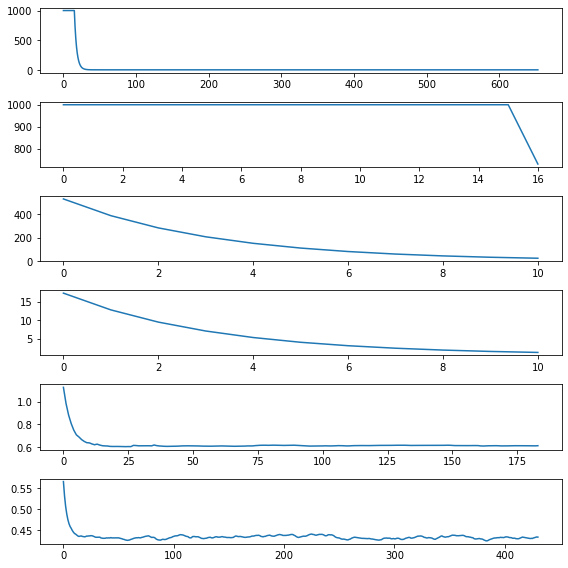

df_len_cnt: 16  H: 10  Total error: 20 Error check:  100.22115647843792 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  729.9226123857311
df_len_cnt: 17  H: 10  Total error: 20 Error check:  10.32890865652996 False
df_len_cnt: 18  H: 10  Total error: 20 Error check:  46.38331724962472 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  63.82259600310641 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  73.82251824299921 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  80.10258767585312 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 20 Error check:  84.24563111665144 True
******CHANGE TIMES
df_len_cnt: 23  H: 10  Total error: 20 Error check:  87.02293790368081 True
******CHANGE TIMES
df_len_cnt: 24  H: 10  Total error: 20 Error check:  88.81892137118251 True
******CHANGE TIMES
df_len_cnt: 25  H: 10  Total error: 20 Error check:  89.78938288792749 True
******CHANGE TIMES
df_len_cnt

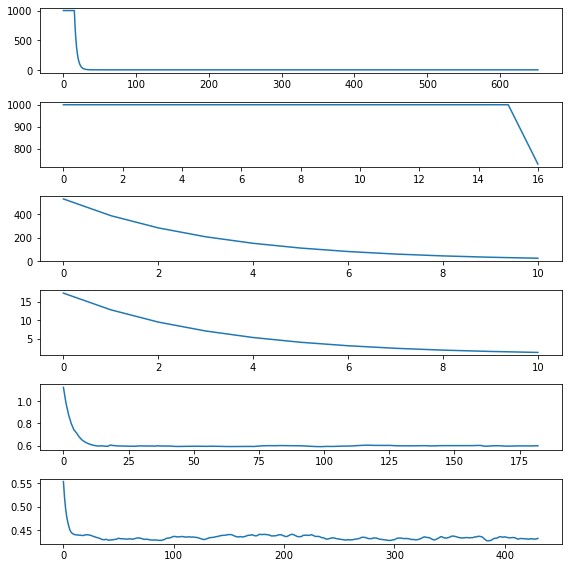

df_len_cnt: 16  H: 10  Total error: 20 Error check:  100.21368839685456 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  729.9161279910925
df_len_cnt: 17  H: 10  Total error: 20 Error check:  10.330865612252223 False
df_len_cnt: 18  H: 10  Total error: 20 Error check:  46.38425488148183 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  63.822740564000036 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  73.82215834888515 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  80.1017886166639 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 20 Error check:  84.2444913256978 True
******CHANGE TIMES
df_len_cnt: 23  H: 10  Total error: 20 Error check:  87.02156875710766 True
******CHANGE TIMES
df_len_cnt: 24  H: 10  Total error: 20 Error check:  88.82136098356082 True
******CHANGE TIMES
df_len_cnt: 25  H: 10  Total error: 20 Error check:  89.79150309536757 True
******CHANGE TIMES
df_len_cnt

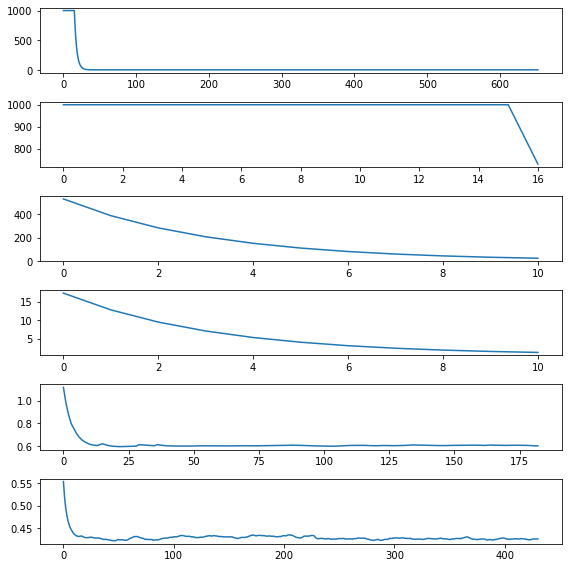

df_len_cnt: 16  H: 10  Total error: 20 Error check:  100.11038098930595 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  729.8161602404138
df_len_cnt: 17  H: 10  Total error: 20 Error check:  10.355296777682476 False
df_len_cnt: 18  H: 10  Total error: 20 Error check:  46.39410201333743 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  63.827577092419105 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  73.82476646413798 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  80.10323487400848 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 20 Error check:  84.24512233400363 True
******CHANGE TIMES
df_len_cnt: 23  H: 10  Total error: 20 Error check:  87.02136752817576 True
******CHANGE TIMES
df_len_cnt: 24  H: 10  Total error: 20 Error check:  88.82035861388535 True
******CHANGE TIMES
df_len_cnt: 25  H: 10  Total error: 20 Error check:  89.7895364875311 True
******CHANGE TIMES
df_len_cn

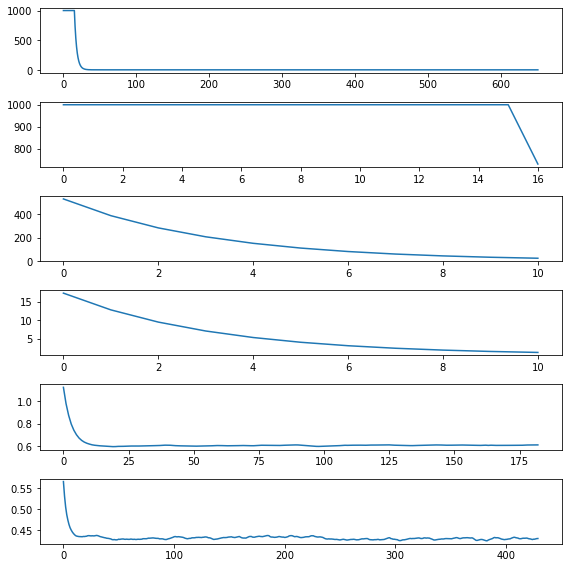

df_len_cnt: 16  H: 10  Total error: 20 Error check:  100.10009429950067 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  729.8161602404138
df_len_cnt: 17  H: 10  Total error: 20 Error check:  10.357936694791988 False
df_len_cnt: 18  H: 10  Total error: 20 Error check:  46.39551736625944 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  63.828637344798224 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  73.82555615791414 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  80.10379818871681 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 20 Error check:  84.24562965005053 True
******CHANGE TIMES
df_len_cnt: 23  H: 10  Total error: 20 Error check:  87.021884622659 True
******CHANGE TIMES
df_len_cnt: 24  H: 10  Total error: 20 Error check:  88.82117245561024 True
******CHANGE TIMES
df_len_cnt: 25  H: 10  Total error: 20 Error check:  89.7904560609848 True
******CHANGE TIMES
df_len_cnt:

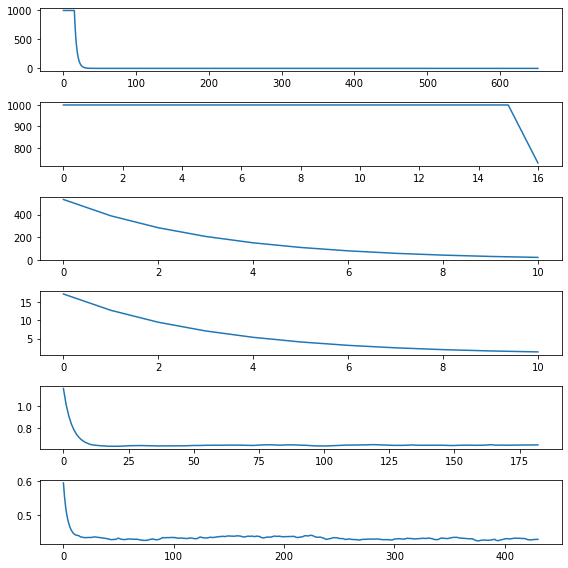

m2_s2_bank_b57ba6527158fa4095578709fab0e24b__site_3471ad4b4665ee47a6a824c7bbc7911b
df_len_cnt: 18  H: 10  Total error: 10 Error check:  3558.8533237520687 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.4510179794684211
df_len_cnt: 19  H: 10  Total error: 20 Error check:  193.5703101845757 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  4.856217554276595 False
df_len_cnt: 206  H: 10  Total error: 10 Error check:  354.03999852845 True
******CHANGE TIMES
ch_times :  [19, 207] ch_num :  2 Resist :  0.6004014296849276
CHECK TIMES
[None, 19, 207, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.457000       4.42       23.0
1   2020-02-13 00:29:18     0.456000       4.42       23.3
2   2020-02-13 12:28:31     0.456000       4.42       23.3
3   2020-02-14 00:27:44     0.456000       4.42       23.3
4   2020-02-14 12:27:11     0.456652       4.42       23.3
5   2020-02-15 00:26:26     0.457055   

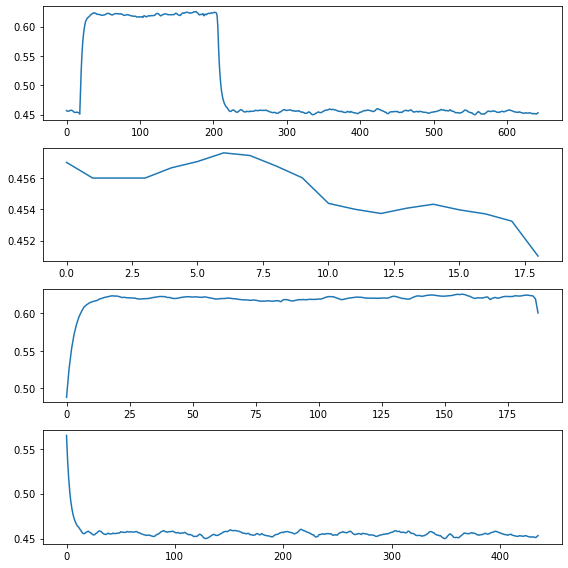

df_len_cnt: 18  H: 10  Total error: 10 Error check:  10754.757760988778 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.4525339255269082
df_len_cnt: 19  H: 10  Total error: 20 Error check:  125.30653317489795 True
******CHANGE TIMES
df_len_cnt: 205  H: 10  Total error: 12 Error check:  223.40851723205807 True
******CHANGE TIMES
ch_times :  [19, 206] ch_num :  2 Resist :  0.5820175441449261
CHECK TIMES
[None, 19, 206, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.455000       4.42      -20.0
1   2020-02-13 00:29:18     0.453000       4.44      -20.0
2   2020-02-13 12:28:31     0.453000       4.44      -20.0
3   2020-02-14 00:27:44     0.453000       4.43      -20.0
4   2020-02-14 12:27:11     0.453000       4.44      -20.0
5   2020-02-15 00:26:26     0.452402       4.43      -20.0
6   2020-02-15 12:25:37     0.452573       4.44      -20.0
7   2020-02-16 00:24:56     0.452970       4.44      -20.0
8   2020-02-16 12:

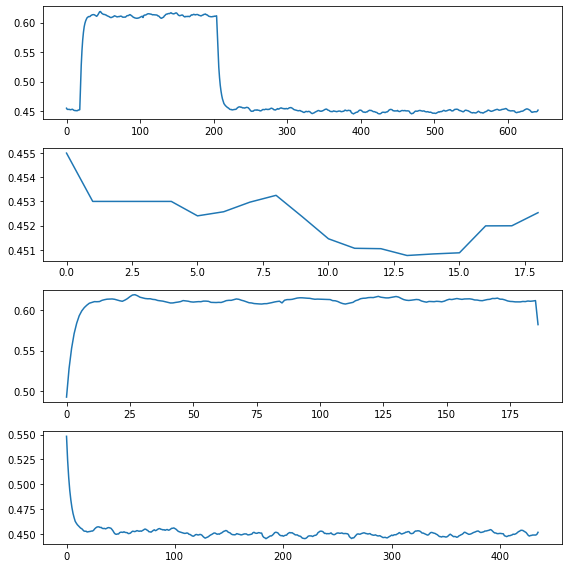

df_len_cnt: 18  H: 10  Total error: 10 Error check:  19805.713515727588 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.4117365377326997
df_len_cnt: 19  H: 10  Total error: 20 Error check:  99.0878956640433 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  13.823994882778177 False
df_len_cnt: 204  H: 10  Total error: 10 Error check:  3454.3154222724093 True
******CHANGE TIMES
ch_times :  [19, 205] ch_num :  2 Resist :  0.6002694297582044
df_len_cnt: 205  H: 10  Total error: 20 Error check:  128.80224627429385 True
******CHANGE TIMES
CHECK TIMES
[None, 19, 205, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.412000       4.44      -20.0
1   2020-02-13 00:29:18     0.410000       4.43      -20.0
2   2020-02-13 12:28:31     0.410000       4.44      -20.0
3   2020-02-14 00:27:44     0.411537       4.44      -20.0
4   2020-02-14 12:27:11     0.412340       4.43      -20.0
5   2020-02-15 00:26:2

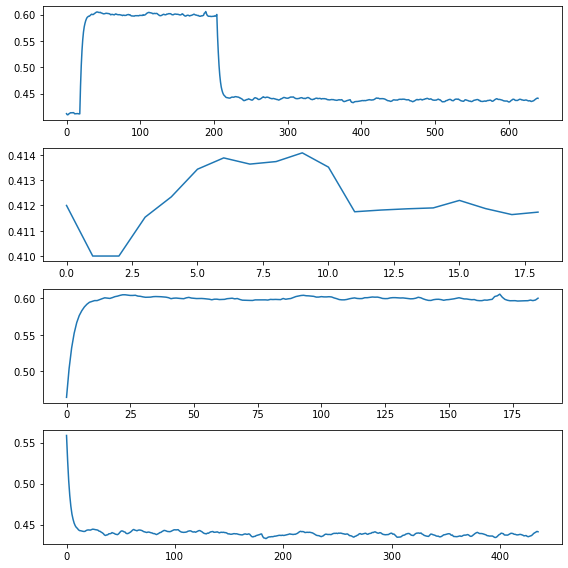

df_len_cnt: 18  H: 10  Total error: 10 Error check:  12409.686715671241 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.42045349420839156
df_len_cnt: 19  H: 10  Total error: 20 Error check:  155.54393255537553 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  2.314781709882937 False
df_len_cnt: 204  H: 10  Total error: 10 Error check:  24676.969870887788 True
******CHANGE TIMES
ch_times :  [19, 205] ch_num :  2 Resist :  0.6193412648314817
df_len_cnt: 205  H: 10  Total error: 20 Error check:  100.92631585365868 True
******CHANGE TIMES
CHECK TIMES
[None, 19, 205, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.419000       4.46      -20.0
1   2020-02-13 00:29:18     0.420000       4.46      -20.0
2   2020-02-13 12:28:31     0.419476       4.46      -20.0
3   2020-02-14 00:27:44     0.420062       4.46      -20.0
4   2020-02-14 12:27:11     0.420368       4.45      -20.0
5   2020-02-15 00:26

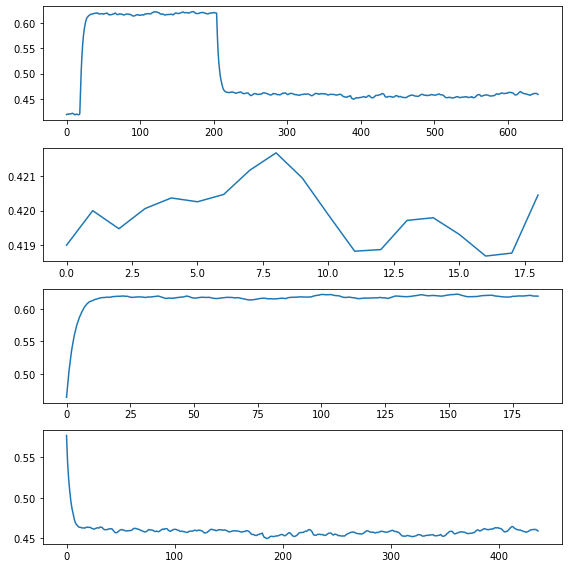

df_len_cnt: 18  H: 10  Total error: 10 Error check:  17223.422876388686 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.4280374094621986
df_len_cnt: 19  H: 10  Total error: 20 Error check:  218.82750059576037 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  13.616251946858124 False
df_len_cnt: 204  H: 10  Total error: 10 Error check:  4326.144630583444 True
******CHANGE TIMES
ch_times :  [19, 205] ch_num :  2 Resist :  0.6334637415051054
df_len_cnt: 205  H: 10  Total error: 20 Error check:  151.942918560631 True
******CHANGE TIMES
df_len_cnt: 206  H: 10  Total error: 20 Error check:  2.314311392516311 False
CHECK TIMES
[None, 19, 205, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.429000       4.48      -20.0
1   2020-02-13 00:29:18     0.427000       4.48      -20.0
2   2020-02-13 12:28:31     0.427524       4.47      -20.0
3   2020-02-14 00:27:44     0.428859       4.48      -20.0
4   

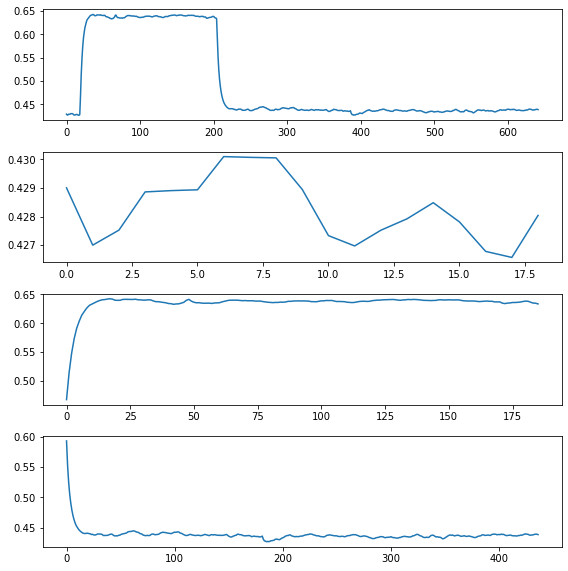

df_len_cnt: 18  H: 10  Total error: 10 Error check:  3552.298988602494 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.46985440698910297
df_len_cnt: 20  H: 10  Total error: 19 Error check:  67.09608228187098 True
******CHANGE TIMES
df_len_cnt: 204  H: 10  Total error: 10 Error check:  286.44528541717455 True
******CHANGE TIMES
ch_times :  [19, 205] ch_num :  2 Resist :  0.5911423441692467
df_len_cnt: 205  H: 10  Total error: 20 Error check:  20.66893771659309 True
******CHANGE TIMES
CHECK TIMES
[None, 19, 205, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.481000       4.55      -20.0
1   2020-02-13 00:29:18     0.482000       4.55      -20.0
2   2020-02-13 12:28:31     0.481476       4.54      -20.0
3   2020-02-14 00:27:44     0.481677       4.55      -20.0
4   2020-02-14 12:27:11     0.480478       4.55      -20.0
5   2020-02-15 00:26:26     0.479737       4.54      -20.0
6   2020-02-15 12:25:37     0.478101     

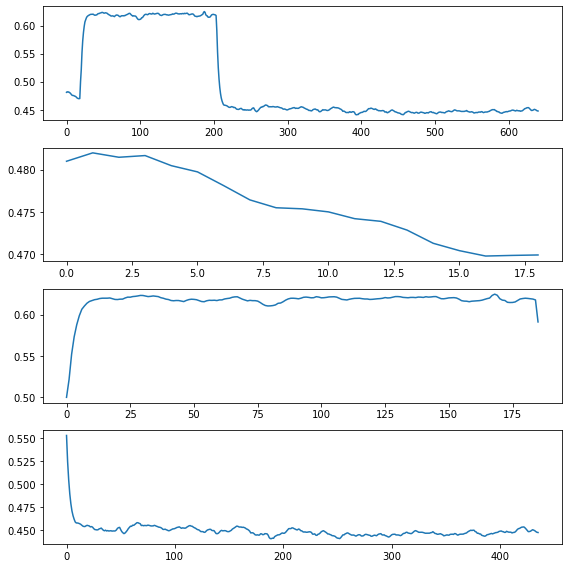

df_len_cnt: 19  H: 10  Total error: 10 Error check:  13216.956313338304 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.4516311552844185
df_len_cnt: 20  H: 10  Total error: 20 Error check:  142.37627887933436 True
******CHANGE TIMES
df_len_cnt: 204  H: 10  Total error: 10 Error check:  417.72226770257845 True
******CHANGE TIMES
ch_times :  [20, 205] ch_num :  2 Resist :  0.6321908443208624
df_len_cnt: 205  H: 10  Total error: 11 Error check:  317.7356563927711 True
******CHANGE TIMES
df_len_cnt: 206  H: 10  Total error: 20 Error check:  12.98633407981464 False
CHECK TIMES
[None, 20, 205, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.446000       4.52      -20.0
1   2020-02-13 00:29:18     0.447000       4.52      -20.0
2   2020-02-13 12:28:31     0.448571       4.52      -20.0
3   2020-02-14 00:27:44     0.449120       4.52      -20.0
4   2020-02-14 12:27:11     0.448102       4.52      -20.0
5   2020-02-15 00:26:

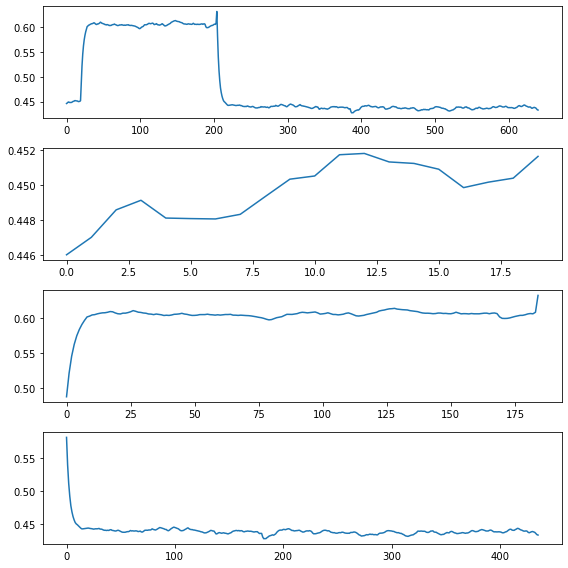

df_len_cnt: 19  H: 10  Total error: 10 Error check:  13037.928633017737 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.4771003792625053
df_len_cnt: 20  H: 10  Total error: 20 Error check:  164.63447623838013 True
******CHANGE TIMES
df_len_cnt: 204  H: 10  Total error: 10 Error check:  628.482460321217 True
******CHANGE TIMES
ch_times :  [20, 205] ch_num :  2 Resist :  0.6354867377738244
df_len_cnt: 205  H: 10  Total error: 19 Error check:  213.56190111054752 True
******CHANGE TIMES
df_len_cnt: 206  H: 10  Total error: 20 Error check:  0.03137377149081249 False
CHECK TIMES
[None, 20, 205, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.477000       4.41      -20.0
1   2020-02-13 00:29:18     0.474000       4.41      -20.0
2   2020-02-13 12:28:31     0.472429       4.41      -20.0
3   2020-02-14 00:27:44     0.471880       4.41      -20.0
4   2020-02-14 12:27:11     0.471919       4.41      -20.0
5   2020-02-15 00:26

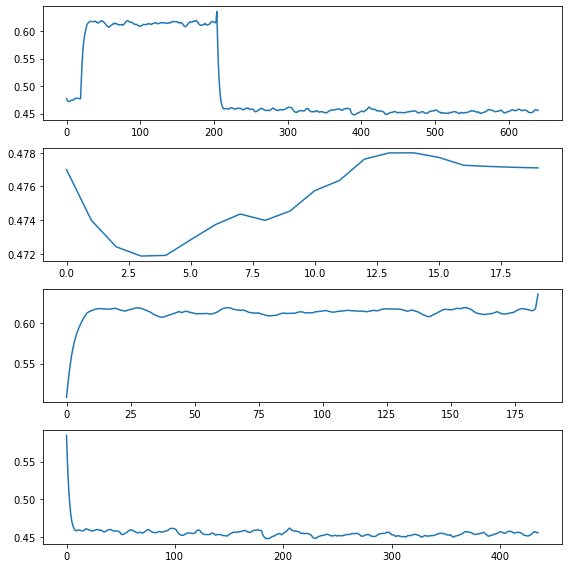

df_len_cnt: 19  H: 10  Total error: 10 Error check:  22782.66927844813 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.47926658082260026
df_len_cnt: 20  H: 10  Total error: 20 Error check:  161.28109660748797 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 10 Error check:  28003.419098703314 True
******CHANGE TIMES
ch_times :  [20, 204] ch_num :  2 Resist :  0.6139938702634327
CHECK TIMES
[None, 20, 204, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.476000       4.42      -20.0
1   2020-02-13 00:29:18     0.476000       4.40      -20.0
2   2020-02-13 12:28:31     0.476000       4.42      -20.0
3   2020-02-14 00:27:44     0.476000       4.42      -20.0
4   2020-02-14 12:27:11     0.476000       4.42      -20.0
5   2020-02-15 00:26:26     0.476897       4.42      -20.0
6   2020-02-15 12:25:37     0.477496       4.42      -20.0
7   2020-02-16 00:24:56     0.478470       4.42      -20.0
8   2020-02-16 12:

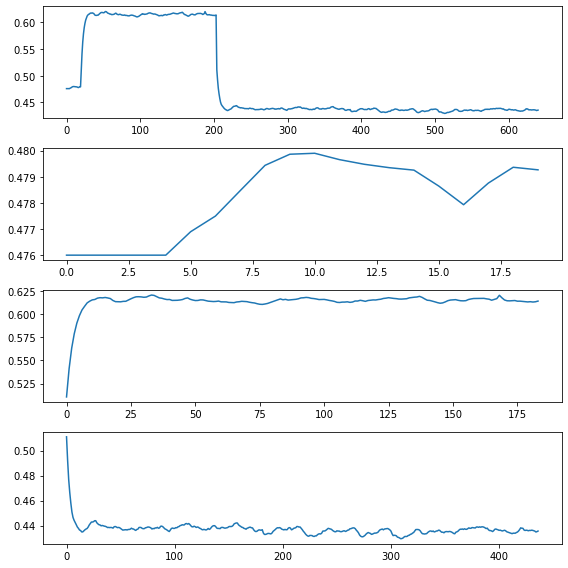

df_len_cnt: 19  H: 10  Total error: 10 Error check:  16783.235872315734 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.41233481836501157
df_len_cnt: 20  H: 10  Total error: 20 Error check:  152.77631881024055 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  4.20220431330032 False
df_len_cnt: 203  H: 10  Total error: 10 Error check:  3941.7451464713067 True
******CHANGE TIMES
ch_times :  [20, 204] ch_num :  2 Resist :  0.6188736483632326
df_len_cnt: 204  H: 10  Total error: 20 Error check:  140.781740778425 True
******CHANGE TIMES
df_len_cnt: 205  H: 10  Total error: 20 Error check:  2.5467535602750355 False
CHECK TIMES
[None, 20, 204, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.413000       4.43      -20.0
1   2020-02-13 00:29:18     0.415000       4.43      -20.0
2   2020-02-13 12:28:31     0.412381       4.43      -20.0
3   2020-02-14 00:27:44     0.412235       4.43      -20.0
4  

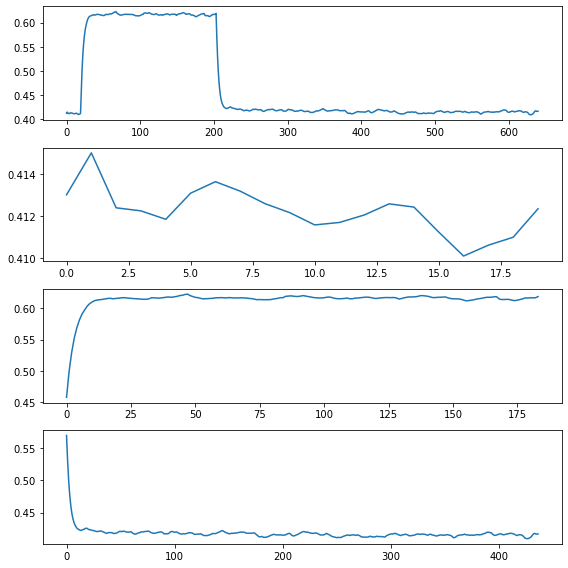

df_len_cnt: 19  H: 10  Total error: 10 Error check:  32811.19901800098 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.42822510355153753
df_len_cnt: 20  H: 10  Total error: 20 Error check:  133.23006530439378 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  4.3711794017698145 False
df_len_cnt: 203  H: 10  Total error: 10 Error check:  24227.57749851018 True
******CHANGE TIMES
ch_times :  [20, 204] ch_num :  2 Resist :  0.6107959481424574
df_len_cnt: 204  H: 10  Total error: 20 Error check:  82.62802196214022 True
******CHANGE TIMES
CHECK TIMES
[None, 20, 204, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.431000       4.48      -20.0
1   2020-02-13 00:29:18     0.429000       4.48      -20.0
2   2020-02-13 12:28:31     0.427429       4.48      -20.0
3   2020-02-14 00:27:44     0.426112       4.49      -20.0
4   2020-02-14 12:27:11     0.425749       4.48      -20.0
5   2020-02-15 00:26:2

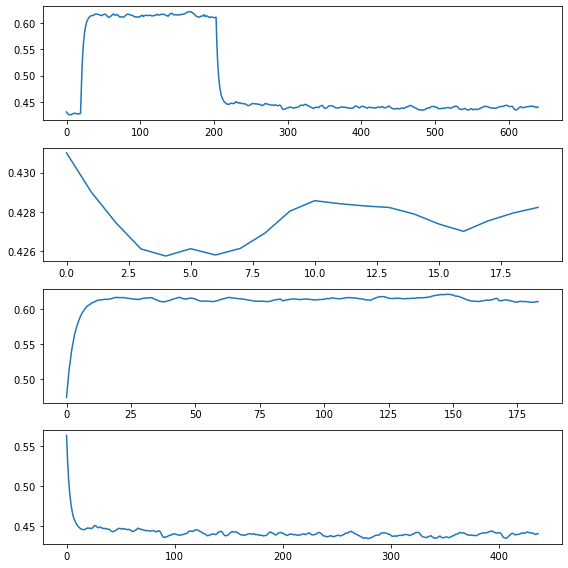

df_len_cnt: 19  H: 10  Total error: 10 Error check:  22507.479125967784 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.40914364023897026
df_len_cnt: 20  H: 10  Total error: 20 Error check:  170.88023115027028 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  8.09878569930706 False
df_len_cnt: 204  H: 10  Total error: 10 Error check:  448.2627357358543 True
******CHANGE TIMES
ch_times :  [20, 205] ch_num :  2 Resist :  0.6532281520432226
df_len_cnt: 205  H: 10  Total error: 11 Error check:  282.0413018235506 True
******CHANGE TIMES
df_len_cnt: 206  H: 10  Total error: 20 Error check:  18.378481773791968 False
CHECK TIMES
[None, 20, 205, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.414000       4.46      -20.0
1   2020-02-13 00:29:18     0.412000       4.47      -20.0
2   2020-02-13 12:28:31     0.410429       4.46      -20.0
3   2020-02-14 00:27:44     0.409880       4.46      -20.0
4  

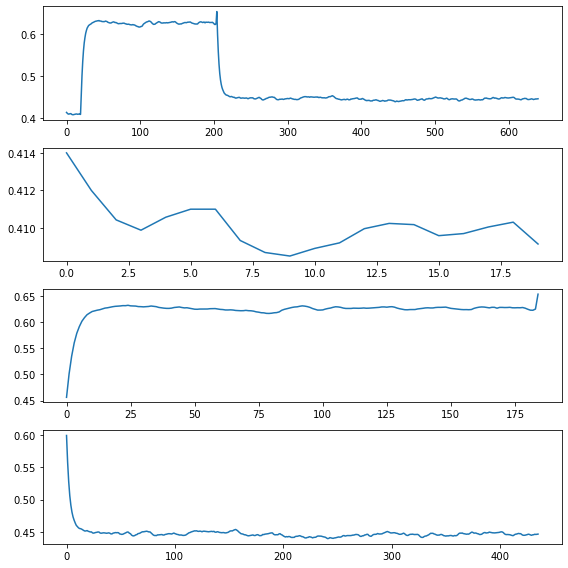

df_len_cnt: 19  H: 10  Total error: 10 Error check:  25875.057577278814 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.3977859857174914
df_len_cnt: 20  H: 10  Total error: 20 Error check:  100.1377978878986 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  8.213192768996329 False
df_len_cnt: 203  H: 10  Total error: 10 Error check:  5332.816886962013 True
******CHANGE TIMES
ch_times :  [20, 204] ch_num :  2 Resist :  0.607937699957581
df_len_cnt: 204  H: 10  Total error: 20 Error check:  69.23047537832953 True
******CHANGE TIMES
CHECK TIMES
[None, 20, 204, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.399000       4.42       22.6
1   2020-02-13 00:29:18     0.397000       4.42       23.0
2   2020-02-13 12:28:31     0.397524       4.42       23.0
3   2020-02-14 00:27:44     0.396939       4.42       23.0
4   2020-02-14 12:27:11     0.396959       4.42       23.0
5   2020-02-15 00:26:26  

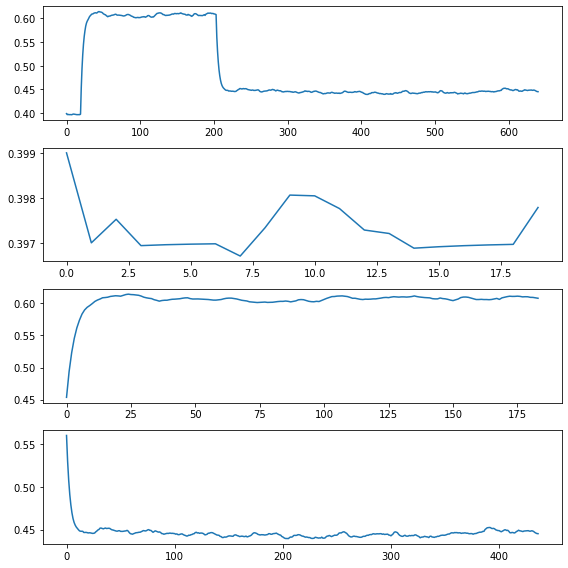

df_len_cnt: 19  H: 10  Total error: 10 Error check:  2828.419655805628 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.45740599302301554
df_len_cnt: 20  H: 10  Total error: 20 Error check:  122.2574767810368 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 10 Error check:  2862.432670024282 True
******CHANGE TIMES
ch_times :  [20, 204] ch_num :  2 Resist :  0.6055687497352696
CHECK TIMES
[None, 20, 204, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.451000       4.48      -20.0
1   2020-02-13 00:29:18     0.451000       4.48      -20.0
2   2020-02-13 12:28:31     0.452048       4.48      -20.0
3   2020-02-14 00:27:44     0.451645       4.48      -20.0
4   2020-02-14 12:27:11     0.451761       4.48      -20.0
5   2020-02-15 00:26:26     0.452430       4.48      -20.0
6   2020-02-15 12:25:37     0.453163       4.48      -20.0
7   2020-02-16 00:24:56     0.453674       4.47      -20.0
8   2020-02-16 12:24

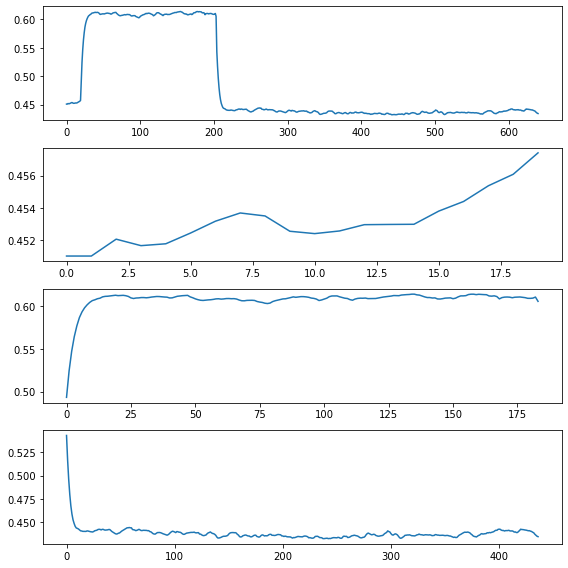

df_len_cnt: 19  H: 10  Total error: 10 Error check:  4498.4076527814705 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.4160818735282702
df_len_cnt: 20  H: 10  Total error: 20 Error check:  130.04014468839372 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  6.297844238065624 False
df_len_cnt: 203  H: 10  Total error: 10 Error check:  3202.9483390719533 True
******CHANGE TIMES
ch_times :  [20, 204] ch_num :  2 Resist :  0.6095668800973907
CHECK TIMES
[None, 20, 204, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.416000       4.51      -20.0
1   2020-02-13 00:29:18     0.415000       4.50      -20.0
2   2020-02-13 12:28:31     0.413429       4.50      -20.0
3   2020-02-14 00:27:44     0.412880       4.50      -20.0
4   2020-02-14 12:27:11     0.412593       4.51      -20.0
5   2020-02-15 00:26:26     0.412715       4.50      -20.0
6   2020-02-15 12:25:37     0.413651       4.51      -20.0


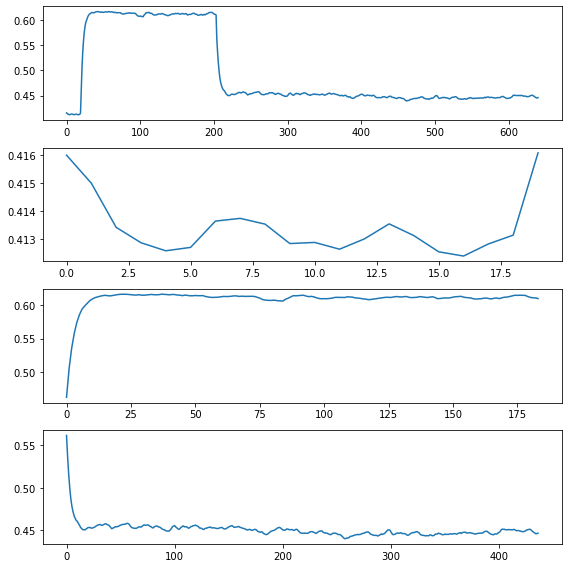

df_len_cnt: 19  H: 10  Total error: 10 Error check:  13088.160916720008 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.424589932971947
df_len_cnt: 20  H: 10  Total error: 20 Error check:  148.24294198520852 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  2.366313614527788 False
df_len_cnt: 203  H: 10  Total error: 10 Error check:  8098.668297938616 True
******CHANGE TIMES
ch_times :  [20, 204] ch_num :  2 Resist :  0.612895631384048
df_len_cnt: 204  H: 10  Total error: 20 Error check:  137.68370438730508 True
******CHANGE TIMES
CHECK TIMES
[None, 20, 204, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.432000       4.49      -20.0
1   2020-02-13 00:29:18     0.427001       4.49      -20.0
2   2020-02-13 12:28:31     0.429095       4.49      -20.0
3   2020-02-14 00:27:44     0.427906       4.48      -20.0
4   2020-02-14 12:27:11     0.427284       4.46      -20.0
5   2020-02-15 00:26:26 

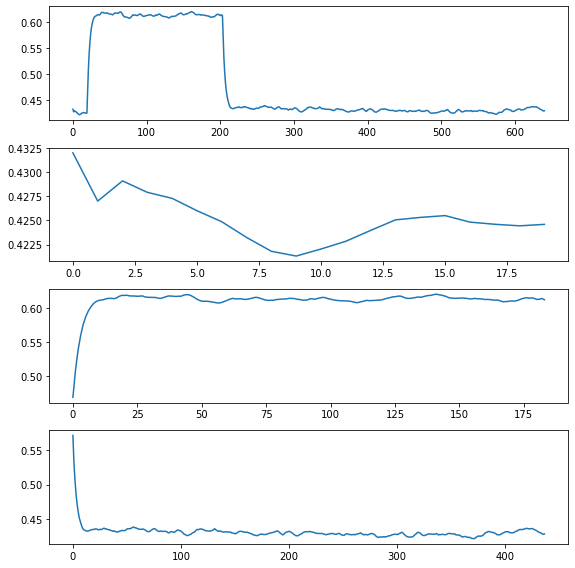

df_len_cnt: 19  H: 10  Total error: 10 Error check:  11165.095574352412 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.4368901031104089
df_len_cnt: 20  H: 10  Total error: 20 Error check:  152.53224618758915 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  3.4928981963427863 False
df_len_cnt: 203  H: 10  Total error: 10 Error check:  8282.673259145695 True
******CHANGE TIMES
ch_times :  [20, 204] ch_num :  2 Resist :  0.6176821917307285
df_len_cnt: 204  H: 10  Total error: 20 Error check:  81.5549389438371 True
******CHANGE TIMES
CHECK TIMES
[None, 20, 204, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.440000       4.46      -20.0
1   2020-02-13 00:29:18     0.440000       4.45      -20.0
2   2020-02-13 12:28:31     0.438429       4.44      -20.0
3   2020-02-14 00:27:44     0.438648       4.45      -20.0
4   2020-02-14 12:27:11     0.439415       4.46      -20.0
5   2020-02-15 00:26:26

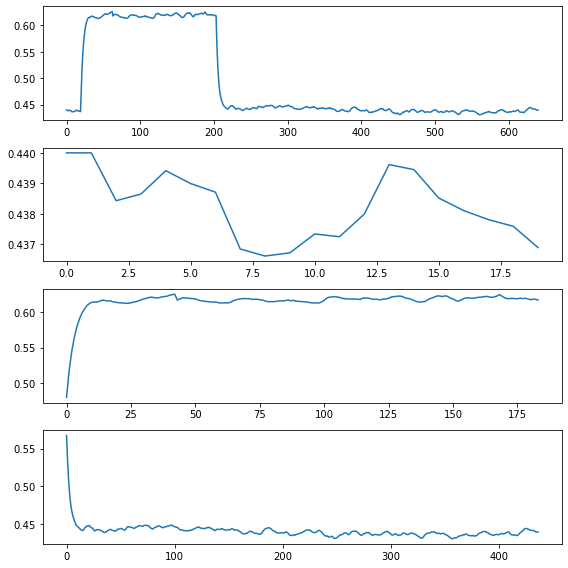

df_len_cnt: 19  H: 10  Total error: 10 Error check:  3182.060703606036 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.43344583852671126
df_len_cnt: 20  H: 10  Total error: 20 Error check:  91.07525939969912 True
******CHANGE TIMES
df_len_cnt: 204  H: 10  Total error: 10 Error check:  3933.9539951070633 True
******CHANGE TIMES
ch_times :  [20, 205] ch_num :  2 Resist :  0.5954442377356881
CHECK TIMES
[None, 20, 205, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.430000       4.44      -20.0
1   2020-02-13 00:29:18     0.432000       4.43      -20.0
2   2020-02-13 12:28:31     0.432524       4.44      -20.0
3   2020-02-14 00:27:44     0.432707       4.44      -20.0
4   2020-02-14 12:27:11     0.433781       4.44      -20.0
5   2020-02-15 00:26:26     0.431755       4.44      -20.0
6   2020-02-15 12:25:37     0.431254       4.43      -20.0
7   2020-02-16 00:24:56     0.430071       4.43      -20.0
8   2020-02-16 12:2

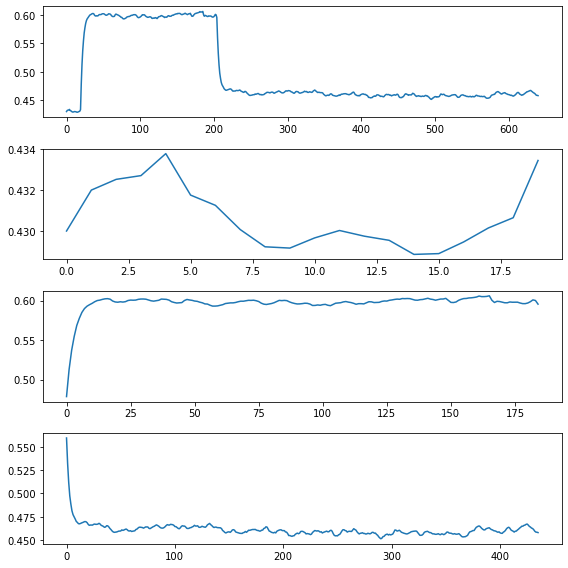

df_len_cnt: 19  H: 10  Total error: 10 Error check:  7065.373748274431 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.40173463055553393
df_len_cnt: 20  H: 10  Total error: 20 Error check:  84.03643334329148 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  16.29286444258643 False
df_len_cnt: 202  H: 10  Total error: 9 Error check:  2688.834707839342 True
******CHANGE TIMES
ch_times :  [20, 203] ch_num :  2 Resist :  0.5985345512118209
df_len_cnt: 203  H: 10  Total error: 20 Error check:  129.5427124742823 True
******CHANGE TIMES
df_len_cnt: 204  H: 10  Total error: 11 Error check:  607.2071544478807 True
******CHANGE TIMES
df_len_cnt: 205  H: 10  Total error: 20 Error check:  117.54831789648004 True
******CHANGE TIMES
CHECK TIMES
[None, 20, 203, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.400000       4.46      -20.0
1   2020-02-13 00:29:18     0.400000       4.45      -20.0
2   2020-

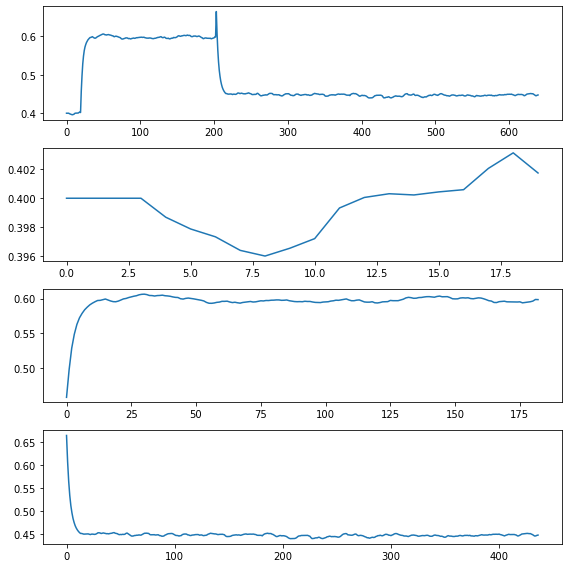

df_len_cnt: 19  H: 10  Total error: 10 Error check:  9603.802304821176 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.406593329099051
df_len_cnt: 20  H: 10  Total error: 20 Error check:  99.3015575122497 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  13.292521232056092 False
df_len_cnt: 202  H: 10  Total error: 10 Error check:  14498.880165102546 True
******CHANGE TIMES
ch_times :  [20, 203] ch_num :  2 Resist :  0.6067964947918603
df_len_cnt: 203  H: 10  Total error: 20 Error check:  72.74207292287899 True
******CHANGE TIMES
CHECK TIMES
[None, 20, 203, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.407000       4.46      -20.0
1   2020-02-13 00:29:18     0.407000       4.45      -20.0
2   2020-02-13 12:28:31     0.406476       4.44      -20.0
3   2020-02-14 00:27:44     0.406677       4.44      -20.0
4   2020-02-14 12:27:11     0.406783       4.44      -20.0
5   2020-02-15 00:26:26  

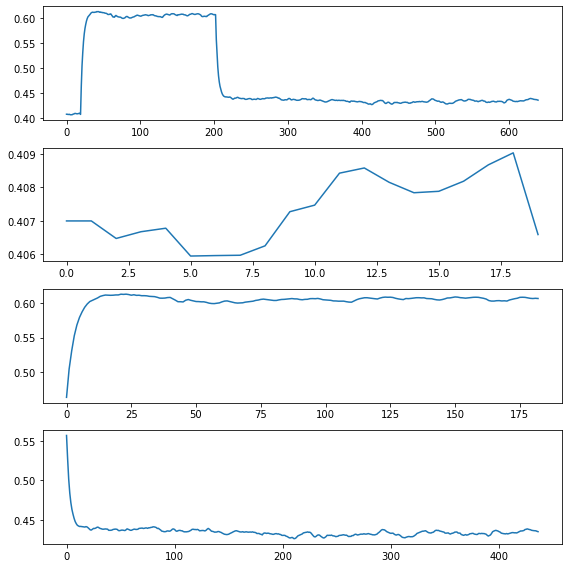

df_len_cnt: 19  H: 10  Total error: 10 Error check:  11660.688700816316 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.4254118195724169
df_len_cnt: 20  H: 10  Total error: 20 Error check:  113.3923168791406 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  8.453989663302691 False
df_len_cnt: 201  H: 10  Total error: 10 Error check:  6717.424934614192 True
******CHANGE TIMES
ch_times :  [20, 202] ch_num :  2 Resist :  0.6068017438099501
df_len_cnt: 202  H: 10  Total error: 20 Error check:  117.50778212896125 True
******CHANGE TIMES
CHECK TIMES
[None, 20, 202, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.428000       4.47      -20.0
1   2020-02-13 00:29:18     0.426000       4.47      -20.0
2   2020-02-13 12:28:31     0.423381       4.47      -20.0
3   2020-02-14 00:27:44     0.421698       4.46      -20.0
4   2020-02-14 12:27:11     0.422449       4.46      -20.0
5   2020-02-15 00:26:26

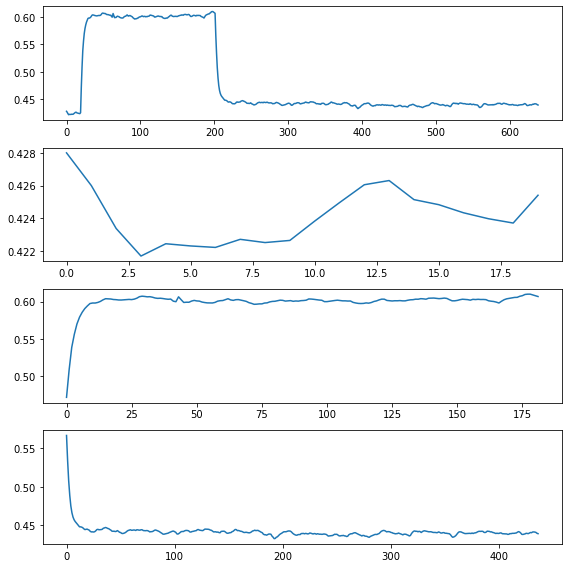

df_len_cnt: 19  H: 10  Total error: 10 Error check:  11451.774126807852 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.4126783223558736
df_len_cnt: 20  H: 10  Total error: 20 Error check:  119.4029075986969 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  11.687959568112609 False
df_len_cnt: 201  H: 10  Total error: 10 Error check:  3068.129687549729 True
******CHANGE TIMES
ch_times :  [20, 202] ch_num :  2 Resist :  0.6097609428024955
CHECK TIMES
[None, 20, 202, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.417000       4.47      -20.0
1   2020-02-13 00:29:18     0.416000       4.47      -20.0
2   2020-02-13 12:28:31     0.415476       4.47      -20.0
3   2020-02-14 00:27:44     0.414909       4.48      -20.0
4   2020-02-14 12:27:11     0.414613       4.48      -20.0
5   2020-02-15 00:26:26     0.413533       4.46      -20.0
6   2020-02-15 12:25:37     0.412526       4.47      -20.0
7

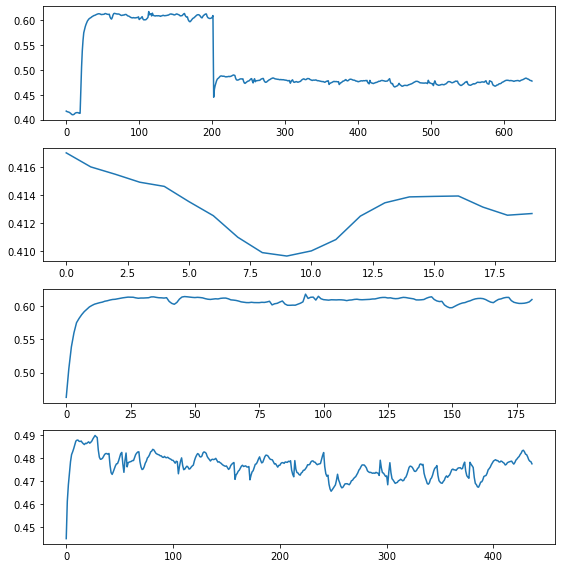

df_len_cnt: 19  H: 10  Total error: 10 Error check:  13937.374718890575 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.3799356851033192
df_len_cnt: 20  H: 10  Total error: 20 Error check:  130.23327727655845 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  8.305636402552636 False
df_len_cnt: 22  H: 10  Total error: 20 Error check:  43.675010076147544 True
******CHANGE TIMES
df_len_cnt: 201  H: 10  Total error: 9 Error check:  4763.9640585853695 True
******CHANGE TIMES
ch_times :  [20, 202] ch_num :  2 Resist :  0.6176456279938666
df_len_cnt: 202  H: 10  Total error: 20 Error check:  89.43883186083842 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 20 Error check:  296.5268749090778 True
******CHANGE TIMES
df_len_cnt: 204  H: 10  Total error: 12 Error check:  209.9605566755701 True
******CHANGE TIMES
df_len_cnt: 205  H: 10  Total error: 20 Error check:  9.153088075836479 False
CHECK TIMES
[None, 20, 202, None]
adf
20
           

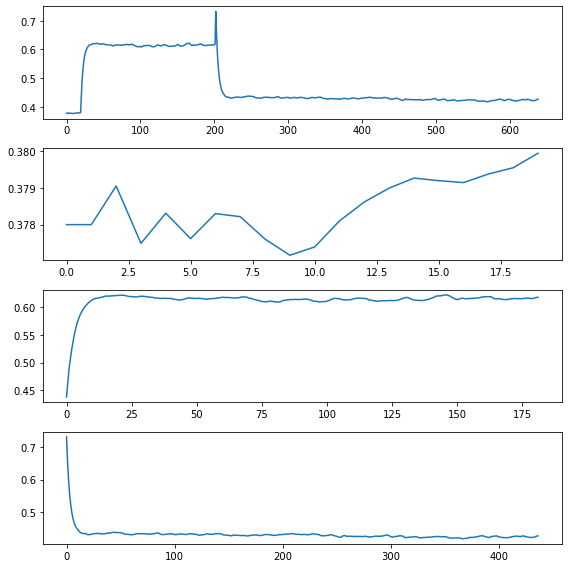

df_len_cnt: 19  H: 10  Total error: 10 Error check:  3733.09811891298 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.40682788590064445
df_len_cnt: 20  H: 10  Total error: 20 Error check:  127.32549610446165 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  4.680999937901402 False
df_len_cnt: 200  H: 10  Total error: 9 Error check:  6147.961668758354 True
******CHANGE TIMES
ch_times :  [20, 201] ch_num :  2 Resist :  0.615510944670472
df_len_cnt: 201  H: 10  Total error: 20 Error check:  60.32090645160088 True
******CHANGE TIMES
df_len_cnt: 202  H: 10  Total error: 20 Error check:  171.4862036964138 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 12 Error check:  458.5800751182382 True
******CHANGE TIMES
df_len_cnt: 204  H: 10  Total error: 20 Error check:  40.58733264064462 True
******CHANGE TIMES
CHECK TIMES
[None, 20, 201, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.411

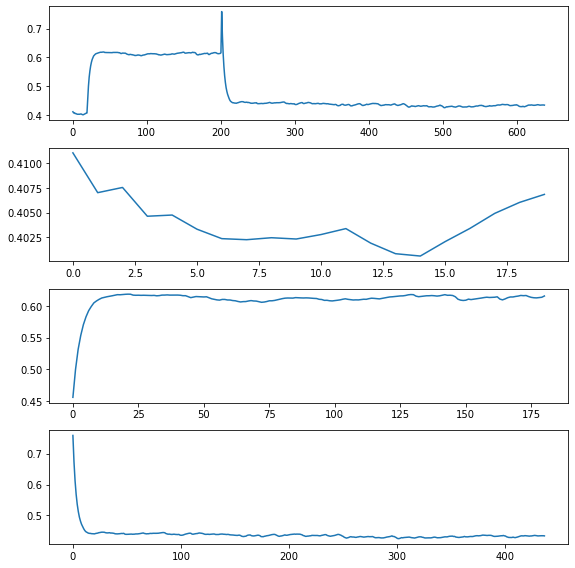

df_len_cnt: 19  H: 10  Total error: 10 Error check:  4316.686680838912 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.40345953375207677
df_len_cnt: 20  H: 10  Total error: 20 Error check:  117.18035127698825 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  8.857341984736339 False
df_len_cnt: 200  H: 10  Total error: 10 Error check:  9355.751818847546 True
******CHANGE TIMES
ch_times :  [20, 201] ch_num :  2 Resist :  0.6195794305808872
df_len_cnt: 201  H: 10  Total error: 20 Error check:  194.47761870887834 True
******CHANGE TIMES
df_len_cnt: 202  H: 10  Total error: 20 Error check:  7.012559247265977 False
CHECK TIMES
[None, 20, 201, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.397000       4.55       19.6
1   2020-02-13 00:29:18     0.396000       4.54       19.7
2   2020-02-13 12:28:31     0.397048       4.55       19.8
3   2020-02-14 00:27:44     0.397029       4.55       19.6
4  

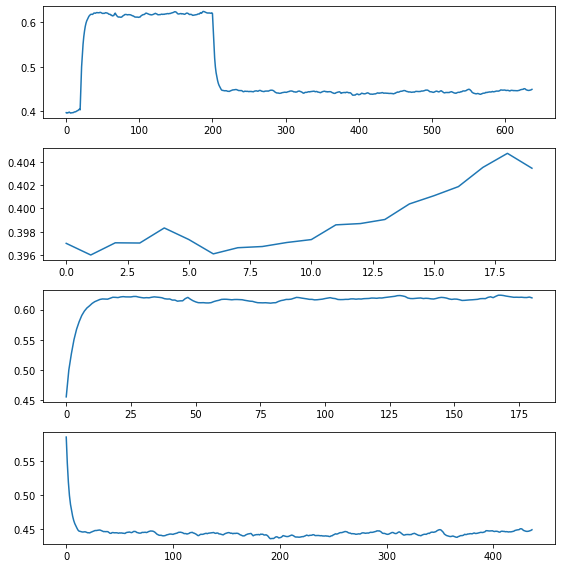

df_len_cnt: 200  H: 10  Total error: 10 Error check:  1938.7068049945206 True
******CHANGE TIMES
ch_times :  [201] ch_num :  1 Resist :  0.6126510242687245
df_len_cnt: 201  H: 10  Total error: 20 Error check:  68.60323006249192 True
******CHANGE TIMES
CHECK TIMES
[None, 201, None]
adf
201
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-12 12:30:08     0.512000       4.58      -20.0
1    2020-02-13 00:29:18     0.513000       4.59      -20.0
2    2020-02-13 12:28:31     0.512476       4.58      -20.0
3    2020-02-14 00:27:44     0.511141       4.58      -20.0
4    2020-02-14 12:27:11     0.510116       4.58      -20.0
..                   ...          ...        ...        ...
196  2020-06-29 17:10:25     0.606103       4.56      -20.0
197  2020-06-30 05:09:58     0.607426       4.57      -20.0
198  2020-06-30 17:09:20     0.608932       4.56      -20.0
199  2020-07-01 05:08:51     0.610301       4.56      -20.0
200  2020-07-01 13:51:14     0.612651       4.54  

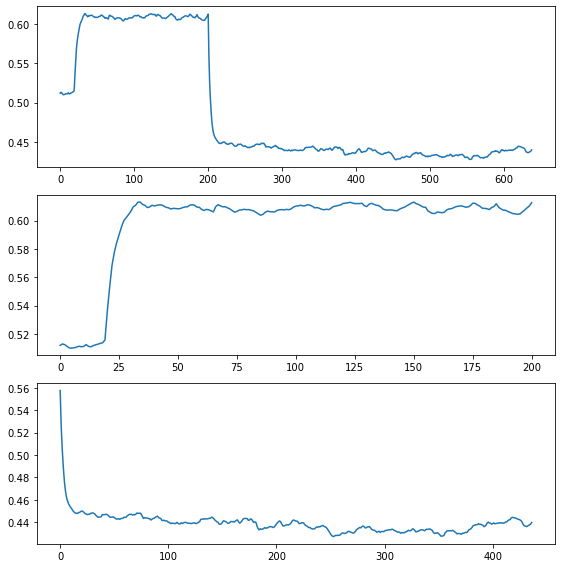

df_len_cnt: 19  H: 10  Total error: 10 Error check:  4177.312265227434 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.44191282069093485
df_len_cnt: 20  H: 10  Total error: 20 Error check:  103.07049339205008 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  9.055972395532622 False
df_len_cnt: 200  H: 10  Total error: 9 Error check:  7863.569371786105 True
******CHANGE TIMES
ch_times :  [20, 201] ch_num :  2 Resist :  0.6050152947054843
df_len_cnt: 201  H: 10  Total error: 20 Error check:  78.75903425590276 True
******CHANGE TIMES
df_len_cnt: 202  H: 10  Total error: 20 Error check:  239.7161761040036 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 12 Error check:  280.43490771762305 True
******CHANGE TIMES
df_len_cnt: 204  H: 10  Total error: 20 Error check:  19.413607053292186 False
CHECK TIMES
[None, 20, 201, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.439000       4.54

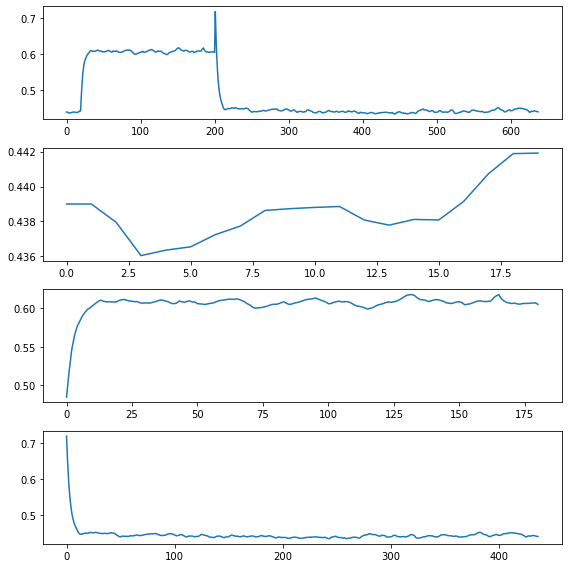

df_len_cnt: 19  H: 10  Total error: 10 Error check:  2554.910285004461 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.4299847964335569
df_len_cnt: 20  H: 10  Total error: 20 Error check:  128.882189689536 True
******CHANGE TIMES
df_len_cnt: 201  H: 10  Total error: 10 Error check:  513.3224571287361 True
******CHANGE TIMES
ch_times :  [20, 202] ch_num :  2 Resist :  0.6450302067754514
df_len_cnt: 202  H: 10  Total error: 20 Error check:  222.42882544898887 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 20 Error check:  17.27184247842423 False
CHECK TIMES
[None, 20, 202, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.426000       4.46      -20.0
1   2020-02-13 00:29:18     0.427000       4.45      -20.0
2   2020-02-13 12:28:31     0.427000       4.45      -20.0
3   2020-02-14 00:27:44     0.425079       4.46      -20.0
4   2020-02-14 12:27:11     0.425706       4.45      -20.0
5   2020-02-15 00:26:26 

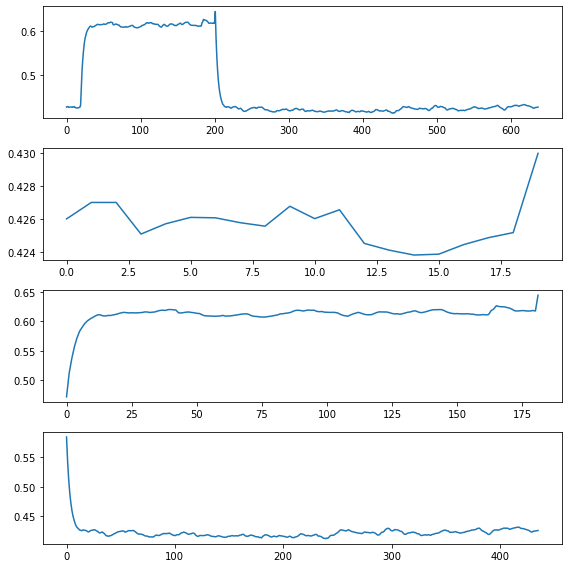

df_len_cnt: 19  H: 10  Total error: 10 Error check:  4998.519156607673 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.4488770025485639
df_len_cnt: 20  H: 10  Total error: 20 Error check:  107.07760581855807 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  4.936234786557503 False
df_len_cnt: 200  H: 10  Total error: 9 Error check:  7582.998354901187 True
******CHANGE TIMES
ch_times :  [20, 201] ch_num :  2 Resist :  0.6065965104196185
df_len_cnt: 201  H: 10  Total error: 20 Error check:  55.08370595837305 True
******CHANGE TIMES
df_len_cnt: 202  H: 10  Total error: 20 Error check:  155.4427641490142 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 12 Error check:  430.6168092595305 True
******CHANGE TIMES
df_len_cnt: 204  H: 10  Total error: 20 Error check:  45.61482280752254 True
******CHANGE TIMES
CHECK TIMES
[None, 20, 201, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.44

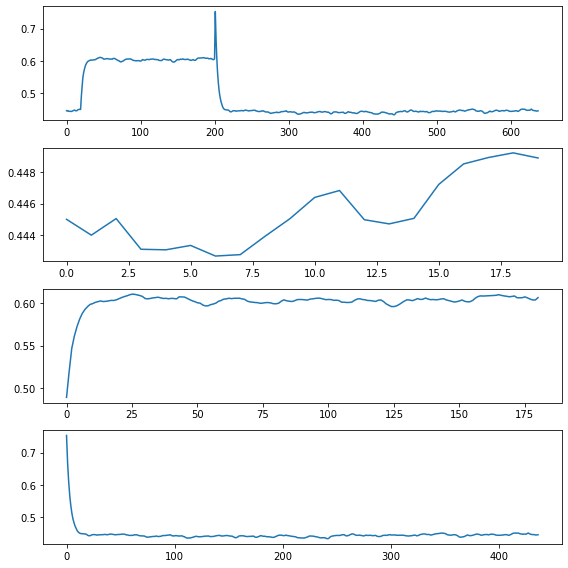

df_len_cnt: 19  H: 10  Total error: 10 Error check:  17500.117509894524 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.4474627664408023
df_len_cnt: 20  H: 10  Total error: 20 Error check:  147.0780347077401 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 10 Error check:  24266.21809048321 True
******CHANGE TIMES
ch_times :  [20, 201] ch_num :  2 Resist :  0.6145053389167736
df_len_cnt: 201  H: 10  Total error: 20 Error check:  190.46476972932322 True
******CHANGE TIMES
CHECK TIMES
[None, 20, 201, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.444000       4.47      -20.0
1   2020-02-13 00:29:18     0.442000       4.48      -20.0
2   2020-02-13 12:28:31     0.441476       4.48      -20.0
3   2020-02-14 00:27:44     0.439757       4.48      -20.0
4   2020-02-14 12:27:11     0.439836       4.48      -20.0
5   2020-02-15 00:26:26     0.440782       4.48      -20.0
6   2020-02-15 12:25:37     0.441984     

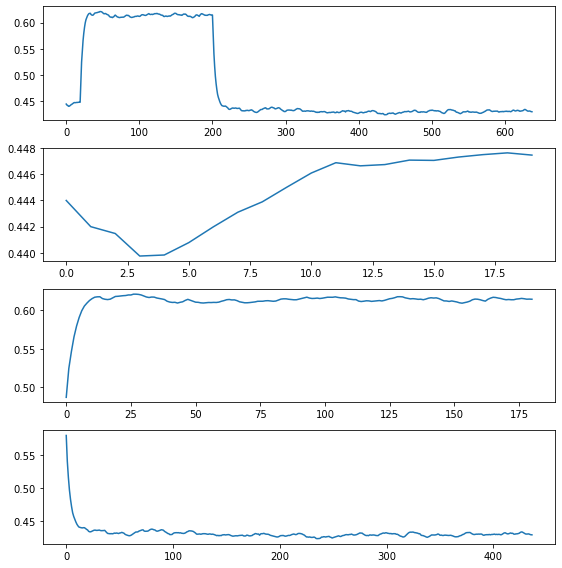

df_len_cnt: 19  H: 10  Total error: 10 Error check:  4206.918043863785 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.4457962679674244
df_len_cnt: 20  H: 10  Total error: 20 Error check:  98.69399258297436 True
******CHANGE TIMES
df_len_cnt: 201  H: 10  Total error: 10 Error check:  296.1111225507798 True
******CHANGE TIMES
ch_times :  [20, 202] ch_num :  2 Resist :  0.5864397520313626
CHECK TIMES
[None, 20, 202, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.443000       4.50      -20.0
1   2020-02-13 00:29:18     0.442000       4.52      -20.0
2   2020-02-13 12:28:31     0.440429       4.50      -20.0
3   2020-02-14 00:27:44     0.438343       4.51      -20.0
4   2020-02-14 12:27:11     0.437579       4.51      -20.0
5   2020-02-15 00:26:26     0.437107       4.51      -20.0
6   2020-02-15 12:25:37     0.437362       4.51      -20.0
7   2020-02-16 00:24:56     0.438095       4.51      -20.0
8   2020-02-16 12:24:

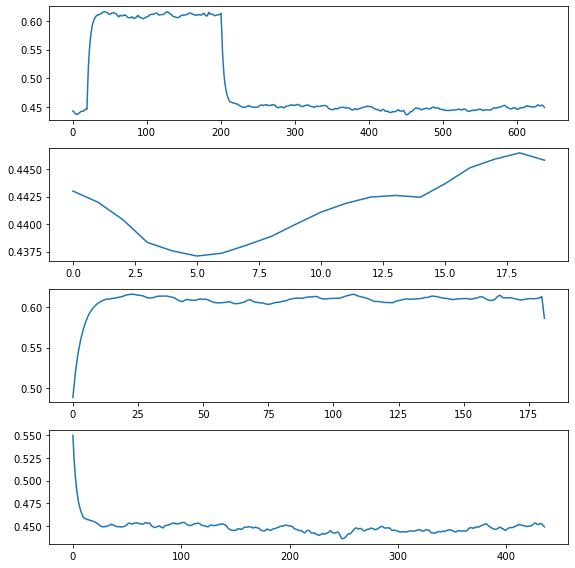

df_len_cnt: 19  H: 10  Total error: 10 Error check:  5296.98302397143 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.4368350636216398
df_len_cnt: 20  H: 10  Total error: 20 Error check:  114.48489720614283 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 8 Error check:  6203.742064499975 True
******CHANGE TIMES
ch_times :  [20, 201] ch_num :  2 Resist :  0.6125011529588639
df_len_cnt: 201  H: 10  Total error: 20 Error check:  41.28295068101158 True
******CHANGE TIMES
df_len_cnt: 202  H: 10  Total error: 20 Error check:  112.08149554545126 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 12 Error check:  251.77985492715845 True
******CHANGE TIMES
df_len_cnt: 204  H: 10  Total error: 14 Error check:  76.11857232956054 True
******CHANGE TIMES
CHECK TIMES
[None, 20, 201, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.426000       4.48      -20.0
1   2020-02-13 00:29:18     0.427000       4.48  

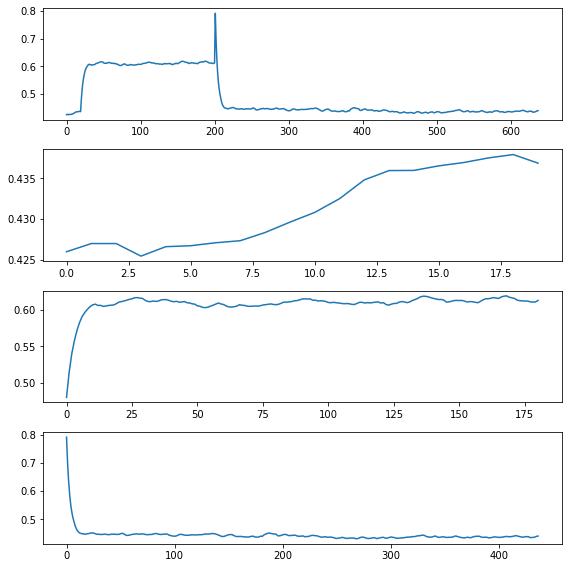

df_len_cnt: 19  H: 10  Total error: 10 Error check:  12468.140865256546 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.37035425147665285
df_len_cnt: 20  H: 10  Total error: 20 Error check:  112.71884825901932 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  4.6204041566667655 False
df_len_cnt: 22  H: 10  Total error: 20 Error check:  42.81512367666949 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 9 Error check:  11472.044630349646 True
******CHANGE TIMES
ch_times :  [20, 201] ch_num :  2 Resist :  0.6080828930285677
df_len_cnt: 201  H: 10  Total error: 20 Error check:  219.0111601655221 True
******CHANGE TIMES
df_len_cnt: 202  H: 10  Total error: 11 Error check:  701.6012295248356 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 20 Error check:  49.14952604222519 True
******CHANGE TIMES
CHECK TIMES
[None, 20, 201, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0

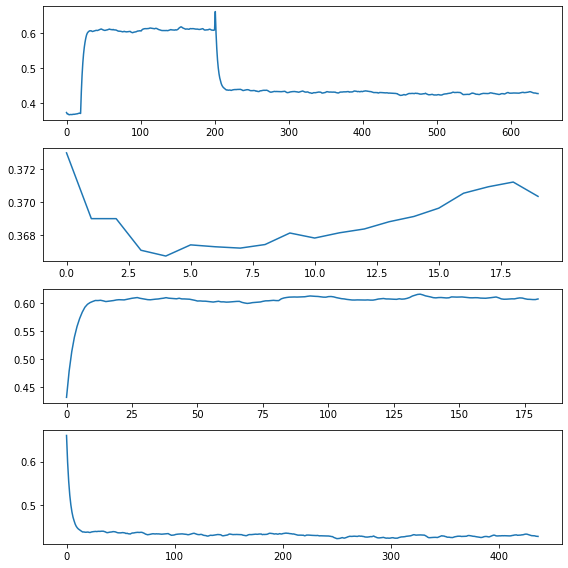

df_len_cnt: 19  H: 10  Total error: 11 Error check:  1116.3029426867718 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.41416560869849517
df_len_cnt: 20  H: 10  Total error: 20 Error check:  98.03626001292135 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  8.798383383101534 False
df_len_cnt: 200  H: 10  Total error: 8 Error check:  2602.608942939582 True
******CHANGE TIMES
ch_times :  [20, 201] ch_num :  2 Resist :  0.6108583689245358
df_len_cnt: 201  H: 10  Total error: 20 Error check:  31.05748420620745 True
******CHANGE TIMES
df_len_cnt: 202  H: 10  Total error: 20 Error check:  84.4776195490814 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 18 Error check:  172.99931417658806 True
******CHANGE TIMES
df_len_cnt: 204  H: 10  Total error: 13 Error check:  106.30457331367103 True
******CHANGE TIMES
CHECK TIMES
[None, 20, 201, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.

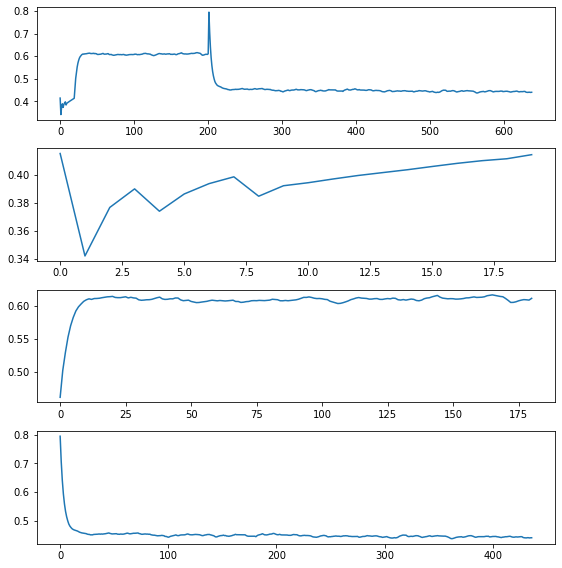

df_len_cnt: 19  H: 10  Total error: 11 Error check:  2375.0172048057793 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.3483033212466213
df_len_cnt: 20  H: 10  Total error: 20 Error check:  126.31709968054676 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  6.111198123183038 False
df_len_cnt: 22  H: 10  Total error: 20 Error check:  47.04223031608351 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 10 Error check:  7584.920919840606 True
******CHANGE TIMES
ch_times :  [20, 201] ch_num :  2 Resist :  0.6030498230483309
df_len_cnt: 201  H: 10  Total error: 20 Error check:  189.3642077721865 True
******CHANGE TIMES
CHECK TIMES
[None, 20, 201, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.346000       4.54      -20.0
1   2020-02-13 00:29:18     0.431986       4.46      -20.0
2   2020-02-13 12:28:31     0.385377       4.53      -20.0
3   2020-02-14 00:27:44     0.368714       4.5

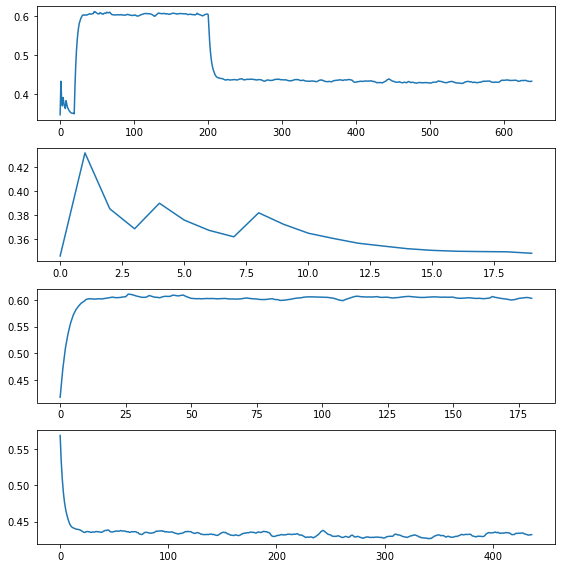

df_len_cnt: 19  H: 10  Total error: 11 Error check:  1376.417984935232 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.433856132542299
df_len_cnt: 20  H: 10  Total error: 20 Error check:  112.86109491236367 True
******CHANGE TIMES
df_len_cnt: 201  H: 10  Total error: 10 Error check:  2138.7273588584526 True
******CHANGE TIMES
ch_times :  [20, 202] ch_num :  2 Resist :  0.6083341038541943
df_len_cnt: 202  H: 10  Total error: 20 Error check:  80.55201482870733 True
******CHANGE TIMES
CHECK TIMES
[None, 20, 202, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.433000       4.47      -20.0
1   2020-02-13 00:29:18     0.411004       4.50       20.4
2   2020-02-13 12:28:31     0.424096       4.46      -20.0
3   2020-02-14 00:27:44     0.428669       4.47      -20.0
4   2020-02-14 12:27:11     0.422905       4.50       20.6
5   2020-02-15 00:26:26     0.427416       4.47      -20.0
6   2020-02-15 12:25:37     0.430149      

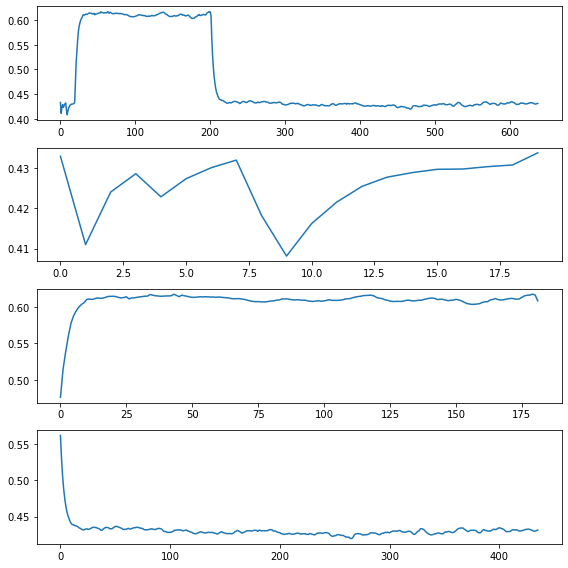

df_len_cnt: 19  H: 10  Total error: 10 Error check:  3979.3519717210124 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.41128137122050634
df_len_cnt: 20  H: 10  Total error: 20 Error check:  158.33921335182302 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  2.095836124019597 False
df_len_cnt: 200  H: 10  Total error: 9 Error check:  1681.3652675767596 True
******CHANGE TIMES
ch_times :  [20, 201] ch_num :  2 Resist :  0.6197639262541836
df_len_cnt: 201  H: 10  Total error: 20 Error check:  27.70901615450782 True
******CHANGE TIMES
df_len_cnt: 202  H: 10  Total error: 20 Error check:  78.58223812787807 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 20 Error check:  161.2045590775291 True
******CHANGE TIMES
df_len_cnt: 204  H: 10  Total error: 13 Error check:  112.79244579621053 True
******CHANGE TIMES
df_len_cnt: 205  H: 10  Total error: 20 Error check:  9.264882973776158 False
CHECK TIMES
[None, 20, 201, None]
adf
20
         

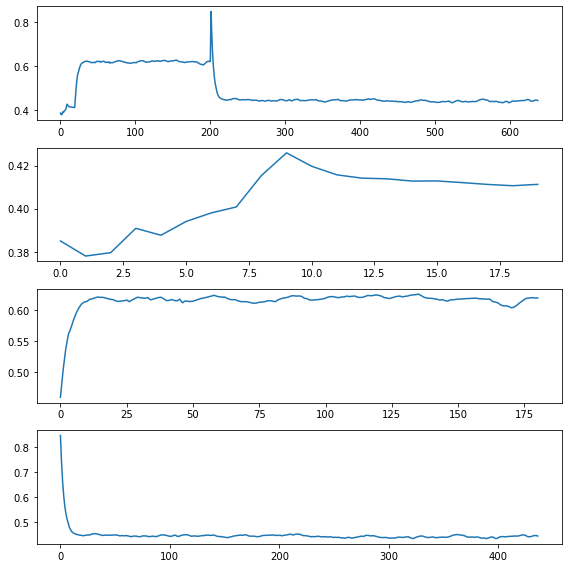

df_len_cnt: 19  H: 10  Total error: 11 Error check:  1795.1700460448312 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.3822276286808041
df_len_cnt: 20  H: 10  Total error: 20 Error check:  133.27285247752357 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  2.2010070152574954 False
df_len_cnt: 200  H: 10  Total error: 9 Error check:  785.4657896544113 True
******CHANGE TIMES
ch_times :  [20, 201] ch_num :  2 Resist :  0.6135067478342922
df_len_cnt: 201  H: 10  Total error: 20 Error check:  23.038482219008518 True
******CHANGE TIMES
df_len_cnt: 202  H: 10  Total error: 20 Error check:  66.09016684161546 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 20 Error check:  127.94220138238978 True
******CHANGE TIMES
df_len_cnt: 204  H: 10  Total error: 13 Error check:  141.9633626956267 True
******CHANGE TIMES
df_len_cnt: 205  H: 10  Total error: 20 Error check:  7.01166468839582 False
CHECK TIMES
[None, 20, 201, None]
adf
20
          

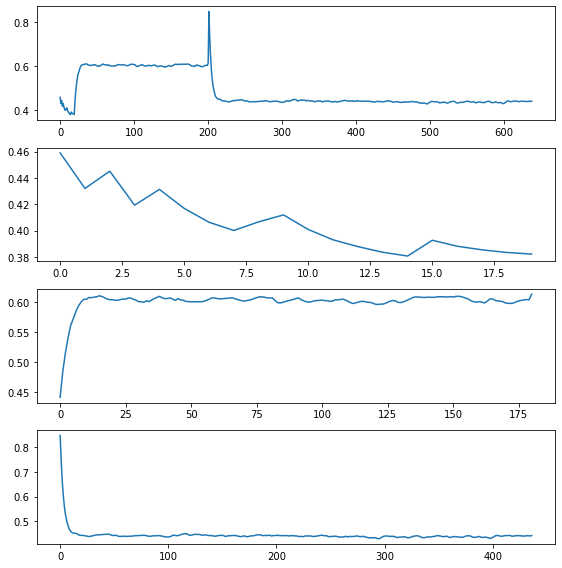

df_len_cnt: 19  H: 10  Total error: 10 Error check:  1491.8389209453069 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.4497819378789064
df_len_cnt: 20  H: 10  Total error: 20 Error check:  83.09410219643065 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 10 Error check:  1716.175265801947 True
******CHANGE TIMES
ch_times :  [20, 201] ch_num :  2 Resist :  0.6111458770906663
df_len_cnt: 201  H: 10  Total error: 20 Error check:  40.26129472369785 True
******CHANGE TIMES
CHECK TIMES
[None, 20, 201, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.426000       4.53      -20.0
1   2020-02-13 00:29:18     0.455995       4.47      -20.0
2   2020-02-13 12:28:31     0.440808       4.53      -20.0
3   2020-02-14 00:27:44     0.446644       4.52      -20.0
4   2020-02-14 12:27:11     0.440236       4.53      -20.0
5   2020-02-15 00:26:26     0.445545       4.52      -20.0
6   2020-02-15 12:25:37     0.449096      

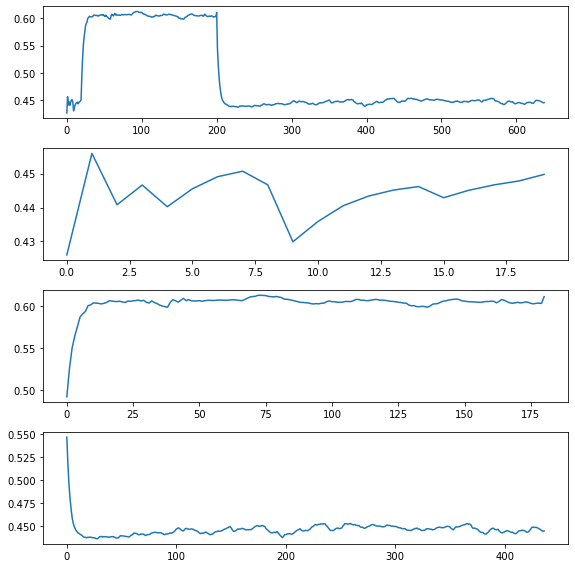

df_len_cnt: 19  H: 10  Total error: 10 Error check:  3134.1173236872983 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.42292542613142914
df_len_cnt: 20  H: 10  Total error: 20 Error check:  130.30998177523833 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  0.26407670430691776 False
df_len_cnt: 200  H: 10  Total error: 10 Error check:  44666.938146189634 True
******CHANGE TIMES
ch_times :  [20, 201] ch_num :  2 Resist :  0.6153610727070331
df_len_cnt: 201  H: 10  Total error: 20 Error check:  143.82924376535854 True
******CHANGE TIMES
CHECK TIMES
[None, 20, 201, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.435000       4.48      -20.0
1   2020-02-13 00:29:18     0.386008       4.48      -20.0
2   2020-02-13 12:28:31     0.412192       4.50      -20.0
3   2020-02-14 00:27:44     0.417881       4.52      -20.0
4   2020-02-14 12:27:11     0.424118       4.49      -20.0
5   2020-02-15 00:

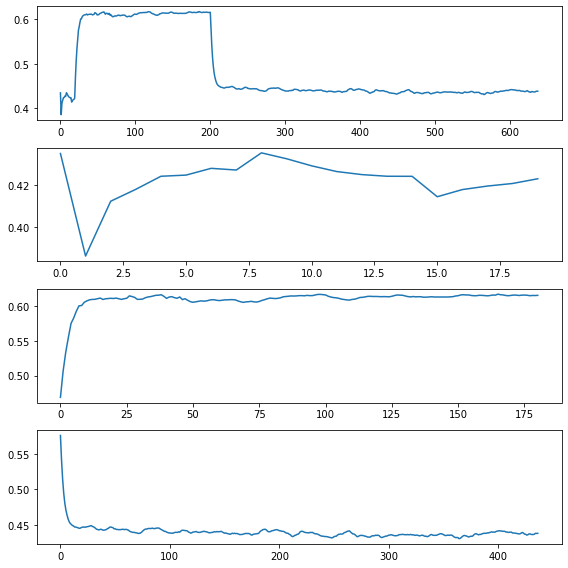

df_len_cnt: 19  H: 10  Total error: 12 Error check:  1182.1833988146705 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.43061220344186557
df_len_cnt: 20  H: 10  Total error: 20 Error check:  75.38862140350396 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 10 Error check:  2380.3940156788117 True
******CHANGE TIMES
ch_times :  [20, 201] ch_num :  2 Resist :  0.5959862686773634
CHECK TIMES
[None, 20, 201, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.454000       4.47      -20.0
1   2020-02-13 00:29:18     0.421005       4.51      -20.0
2   2020-02-13 12:28:31     0.404242       4.48      -20.0
3   2020-02-14 00:27:44     0.416442       4.51      -20.0
4   2020-02-14 12:27:11     0.430325       4.48      -20.0
5   2020-02-15 00:26:26     0.431722       4.50      -20.0
6   2020-02-15 12:25:37     0.440070       4.48      -20.0
7   2020-02-16 00:24:56     0.439216       4.50      -20.0
8   2020-02-16 12:

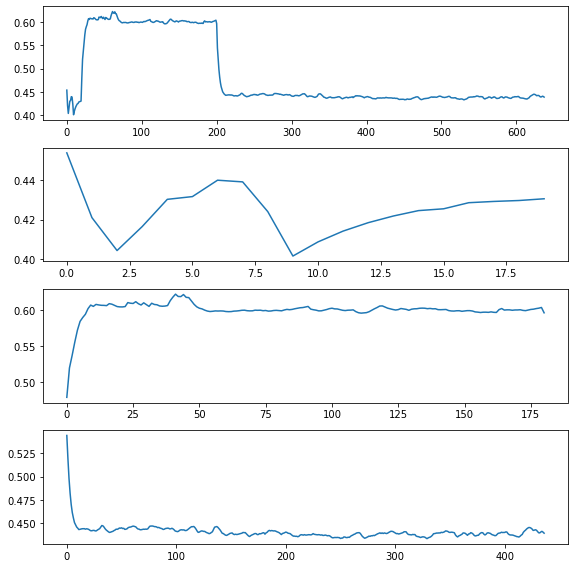

df_len_cnt: 19  H: 10  Total error: 11 Error check:  1355.468720846854 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.4487140311988108
df_len_cnt: 20  H: 10  Total error: 20 Error check:  121.24936537094551 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 10 Error check:  2694.163789803335 True
******CHANGE TIMES
ch_times :  [20, 201] ch_num :  2 Resist :  0.6203717676473043
df_len_cnt: 201  H: 10  Total error: 20 Error check:  86.6575960584802 True
******CHANGE TIMES
CHECK TIMES
[None, 20, 201, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.388000       4.50      -20.0
1   2020-02-13 00:29:18     0.339008       4.54      -20.0
2   2020-02-13 12:28:31     0.383001       4.53      -20.0
3   2020-02-14 00:27:44     0.410659       4.47      -20.0
4   2020-02-14 12:27:11     0.402941       4.50      -20.0
5   2020-02-15 00:26:26     0.420591       4.46      -20.0
6   2020-02-15 12:25:37     0.411013       

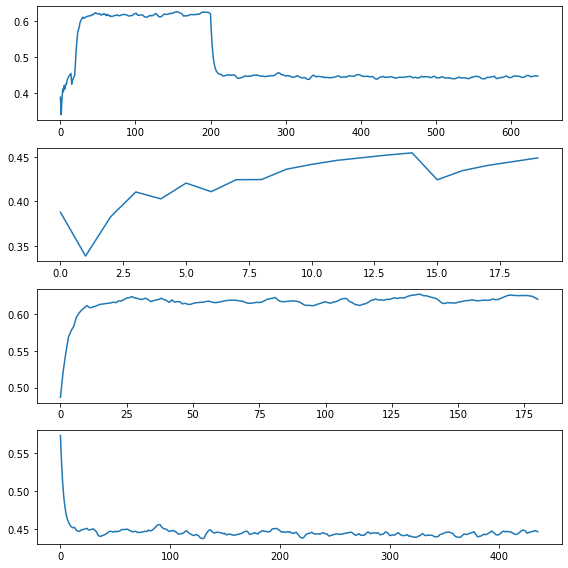

df_len_cnt: 19  H: 10  Total error: 10 Error check:  2101.31930415601 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.3940649385019325
df_len_cnt: 20  H: 10  Total error: 20 Error check:  160.5224099088858 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  10.328844828826366 False
df_len_cnt: 22  H: 10  Total error: 20 Error check:  37.2727419329021 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 10 Error check:  40467.301313607604 True
******CHANGE TIMES
ch_times :  [20, 201] ch_num :  2 Resist :  0.6170179568361882
df_len_cnt: 201  H: 10  Total error: 20 Error check:  93.40810490266111 True
******CHANGE TIMES
CHECK TIMES
[None, 20, 201, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.424000       4.53      -20.0
1   2020-02-13 00:29:18     0.468993       4.60      -20.0
2   2020-02-13 12:28:31     0.402477       4.53      -20.0
3   2020-02-14 00:27:44     0.397300       4.49 

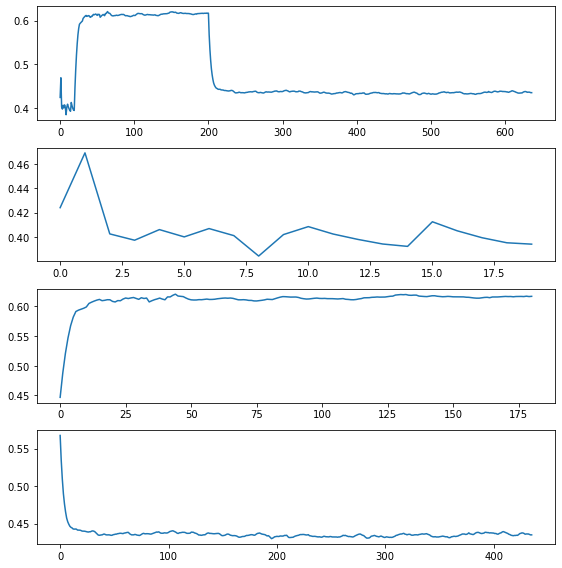

df_len_cnt: 19  H: 10  Total error: 13 Error check:  788.2664836560787 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.4257208161518847
df_len_cnt: 20  H: 10  Total error: 20 Error check:  64.21017870101588 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 10 Error check:  12525.784805179823 True
******CHANGE TIMES
ch_times :  [20, 201] ch_num :  2 Resist :  0.6052806006258523
df_len_cnt: 201  H: 10  Total error: 20 Error check:  115.37927225439908 True
******CHANGE TIMES
CHECK TIMES
[None, 20, 201, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.336000       4.54      -20.0
1   2020-02-13 00:29:18     0.443982       4.47      -20.0
2   2020-02-13 12:28:31     0.457086       4.61      -20.0
3   2020-02-14 00:27:44     0.443608       4.53      -20.0
4   2020-02-14 12:27:11     0.410462       4.54      -20.0
5   2020-02-15 00:26:26     0.414508       4.53      -20.0
6   2020-02-15 12:25:37     0.393834     

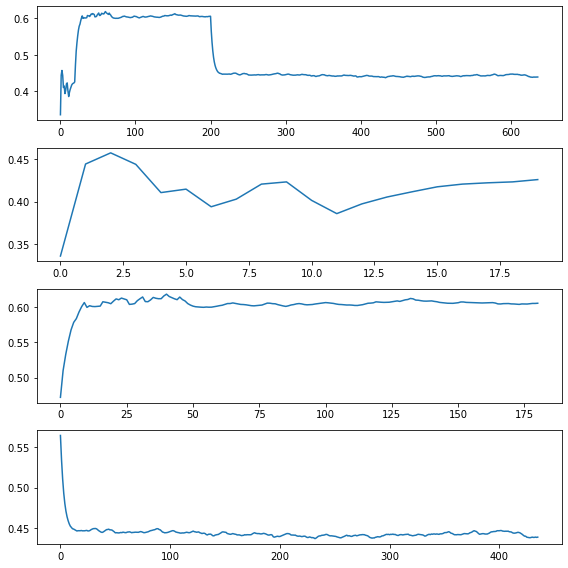

df_len_cnt: 19  H: 10  Total error: 18 Error check:  314.3354920352966 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.35872927980084507
df_len_cnt: 20  H: 10  Total error: 17 Error check:  309.9482881505748 True
******CHANGE TIMES
df_len_cnt: 21  H: 10  Total error: 20 Error check:  29.050765500743562 True
******CHANGE TIMES
df_len_cnt: 22  H: 10  Total error: 20 Error check:  33.07422076676066 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 10 Error check:  7845.825798378504 True
******CHANGE TIMES
ch_times :  [20, 201] ch_num :  2 Resist :  0.6209996739634065
df_len_cnt: 201  H: 10  Total error: 20 Error check:  104.07024226957233 True
******CHANGE TIMES
CHECK TIMES
[None, 20, 201, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.470000       4.62      -20.0
1   2020-02-13 00:29:18     0.432006       4.48      -20.0
2   2020-02-13 12:28:31     0.437241       4.47      -20.0
3   2020-02-14 00:27:44    

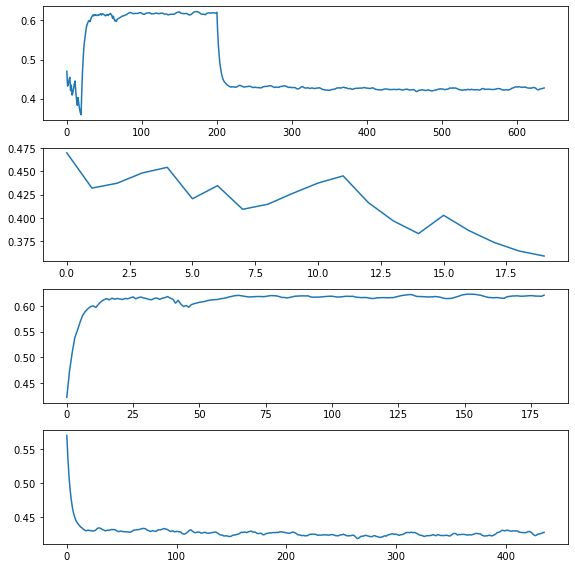

df_len_cnt: 19  H: 10  Total error: 11 Error check:  793.3270294736939 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.4586122294922297
df_len_cnt: 21  H: 10  Total error: 19 Error check:  14.840577975762653 False
df_len_cnt: 200  H: 10  Total error: 10 Error check:  1282.3629505717747 True
******CHANGE TIMES
ch_times :  [20, 201] ch_num :  2 Resist :  0.5985945942282289
df_len_cnt: 201  H: 10  Total error: 20 Error check:  84.17926477329411 True
******CHANGE TIMES
CHECK TIMES
[None, 20, 201, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.444000       4.47      -20.0
1   2020-02-13 00:29:18     0.463997       4.48       23.1
2   2020-02-13 12:28:31     0.448809       4.49      -20.0
3   2020-02-14 00:27:44     0.447730       4.46      -20.0
4   2020-02-14 12:27:11     0.448144       4.46      -20.0
5   2020-02-15 00:26:26     0.454078       4.60      -20.0
6   2020-02-15 12:25:37     0.452630       4.47      -20.0


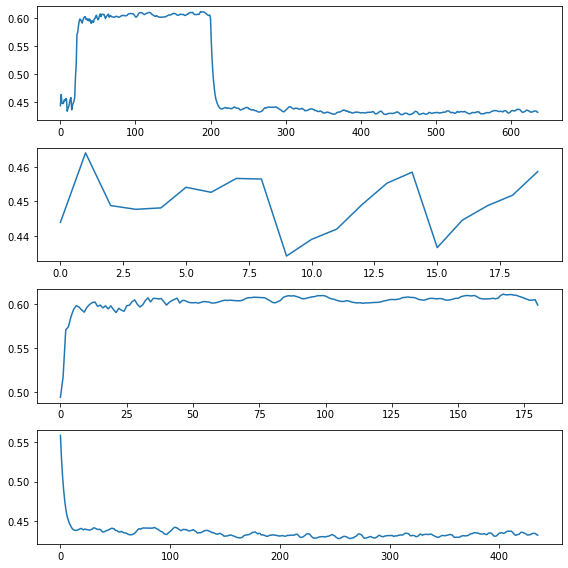

df_len_cnt: 19  H: 10  Total error: 13 Error check:  392.1345896354026 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.4690755711129556
df_len_cnt: 20  H: 10  Total error: 17 Error check:  107.16725883238976 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 10 Error check:  3719.2296537842294 True
******CHANGE TIMES
ch_times :  [20, 201] ch_num :  2 Resist :  0.5878180725198435
df_len_cnt: 201  H: 10  Total error: 20 Error check:  170.40721072883298 True
******CHANGE TIMES
df_len_cnt: 202  H: 10  Total error: 20 Error check:  5.313332667343197 False
CHECK TIMES
[None, 20, 201, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.460000       4.47       22.9
1   2020-02-13 00:29:18     0.373014       4.45      -20.0
2   2020-02-13 12:28:31     0.421718       4.47       23.2
3   2020-02-14 00:27:44     0.426820       4.47      -20.0
4   2020-02-14 12:27:11     0.429488       4.48      -20.0
5   2020-02-15 00:26:

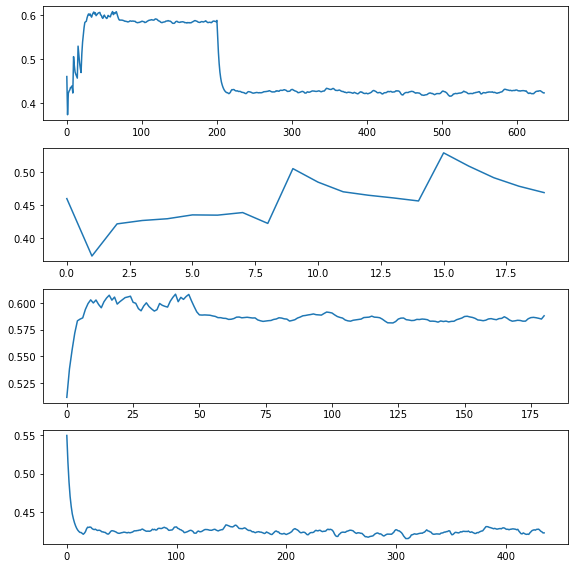

df_len_cnt: 19  H: 10  Total error: 16 Error check:  124.92142022991995 True
******CHANGE TIMES
ch_times :  [20] ch_num :  1 Resist :  0.4561460210374828
df_len_cnt: 20  H: 10  Total error: 15 Error check:  210.62547996430067 True
******CHANGE TIMES
df_len_cnt: 68  H: 10  Total error: 9 Error check:  1127.4145156137572 True
df_len_cnt: 200  H: 10  Total error: 10 Error check:  4976.099307793638 True
******CHANGE TIMES
ch_times :  [20, 201] ch_num :  2 Resist :  0.6073344233834973
df_len_cnt: 201  H: 10  Total error: 20 Error check:  77.26999561511788 True
******CHANGE TIMES
CHECK TIMES
[None, 20, 201, None]
adf
20
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.371000       4.44      -20.0
1   2020-02-13 00:29:18     0.727941       4.49      -20.0
2   2020-02-13 12:28:31     0.543604       4.46      -20.0
3   2020-02-14 00:27:44     0.511488       4.47       23.1
4   2020-02-14 12:27:11     0.495018       4.47       23.2
5   2020-02-15 00:26:26 

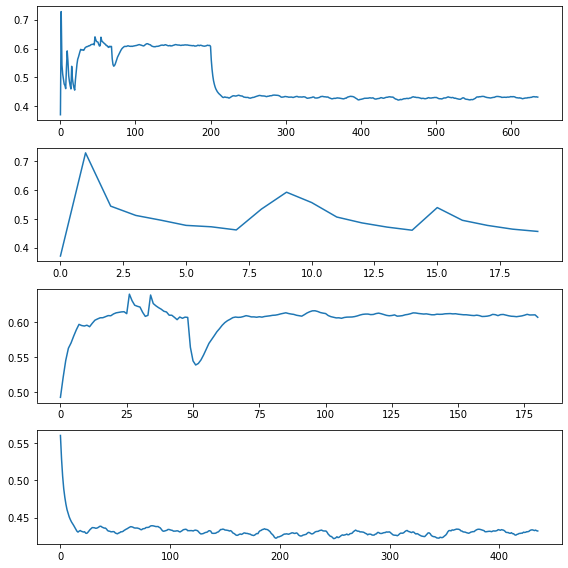

df_len_cnt: 18  H: 10  Total error: 15 Error check:  245.83751055588127 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.504770707628394
df_len_cnt: 24  H: 10  Total error: 11 Error check:  45.14698831036233 True
******CHANGE TIMES
df_len_cnt: 51  H: 10  Total error: 1 Error check:  129.22797836738383 True
df_len_cnt: 206  H: 10  Total error: 10 Error check:  1961.2783152089605 True
******CHANGE TIMES
ch_times :  [19, 207] ch_num :  2 Resist :  0.6019281107909312
df_len_cnt: 207  H: 10  Total error: 20 Error check:  63.313825207699196 True
******CHANGE TIMES
CHECK TIMES
[None, 19, 207, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.723000       4.49      -20.0
1   2020-02-13 00:29:18     0.753995       4.49      -20.0
2   2020-02-13 12:28:31     0.740379       4.48      -20.0
3   2020-02-14 00:27:44     0.598867       4.44      -20.0
4   2020-02-14 12:27:11     0.524860       4.45      -20.0
5   2020-02-15 00:26:26 

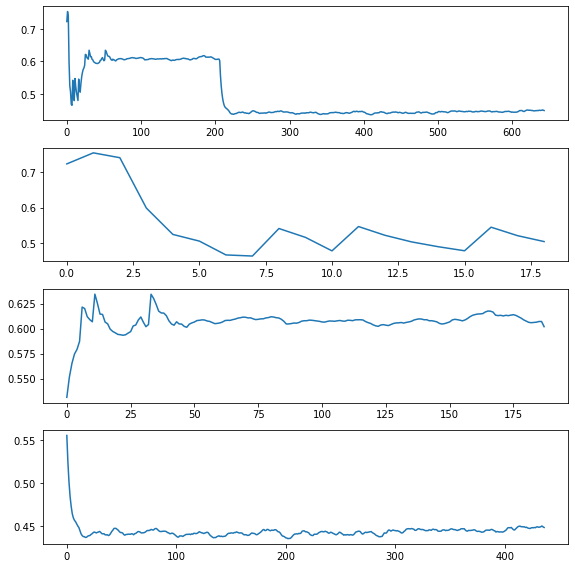

df_len_cnt: 18  H: 10  Total error: 19 Error check:  72.0098910563271 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.41709061126603203
df_len_cnt: 19  H: 10  Total error: 16 Error check:  149.4990142183838 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 18 Error check:  119.02925039196694 True
******CHANGE TIMES
df_len_cnt: 23  H: 10  Total error: 18 Error check:  41.65349653230245 True
******CHANGE TIMES
df_len_cnt: 204  H: 10  Total error: 10 Error check:  1990.8947164841934 True
******CHANGE TIMES
ch_times :  [19, 205] ch_num :  2 Resist :  0.5868124419560962
CHECK TIMES
[None, 19, 205, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.754000       4.50      -20.0
1   2020-02-13 00:29:18     0.447051       4.50      -20.0
2   2020-02-13 12:28:31     0.608346       4.50      -20.0
3   2020-02-14 00:27:44     0.654311       4.49      -20.0
4   2020-02-14 12:27:11     0.679002       4.49      -20.0
5   20

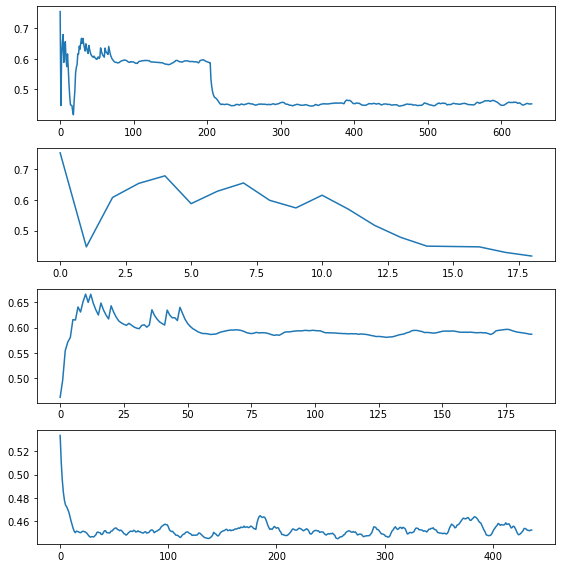

df_len_cnt: 16  H: 10  Total error: 19 Error check:  24.673932884210434 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.5807725027855625
df_len_cnt: 17  H: 10  Total error: 5 Error check:  56.87112022089844 True
df_len_cnt: 58  H: 10  Total error: 12 Error check:  59.54187333040725 True
******CHANGE TIMES
ch_times :  [17, 59] ch_num :  2 Resist :  0.6069921237074799
df_len_cnt: 204  H: 10  Total error: 10 Error check:  2633.302435307496 True
******CHANGE TIMES
ch_times :  [17, 59, 205] ch_num :  3 Resist :  0.5889159265959768
CHECK TIMES
[None, 17, 59, 205, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.446000       4.52      -20.0
1   2020-02-13 00:29:18     0.446000       4.44      -20.0
2   2020-02-13 12:28:31     0.446000       4.51      -20.0
3   2020-02-14 00:27:44     0.563934       4.48      -20.0
4   2020-02-14 12:27:11     0.624305       4.50      -20.0
5   2020-02-15 00:26:26     0.655592       4.48     

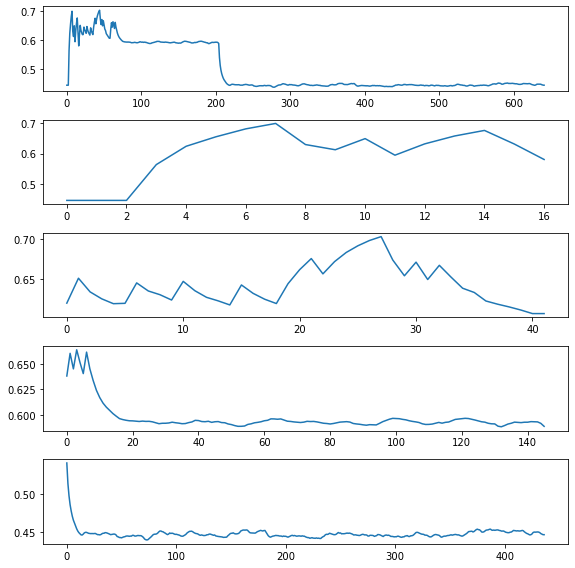

df_len_cnt: 16  H: 10  Total error: 18 Error check:  30.115171025408287 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.5915232561328068
df_len_cnt: 17  H: 10  Total error: 8 Error check:  80.9439253426142 True
******CHANGE TIMES
df_len_cnt: 204  H: 10  Total error: 10 Error check:  6997.042764054902 True
******CHANGE TIMES
ch_times :  [17, 205] ch_num :  2 Resist :  0.7093283484140019
df_len_cnt: 205  H: 10  Total error: 20 Error check:  95.10091955633908 True
******CHANGE TIMES
df_len_cnt: 206  H: 10  Total error: 20 Error check:  15.349470271036953 False
df_len_cnt: 207  H: 10  Total error: 20 Error check:  49.43736546218961 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 205, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.447000       4.43      -20.0
1   2020-02-13 00:29:18     0.573979       4.46      -20.0
2   2020-02-13 12:28:31     0.505376       4.43      -20.0
3   2020-02-14 00:27:44     0.482567       4.5

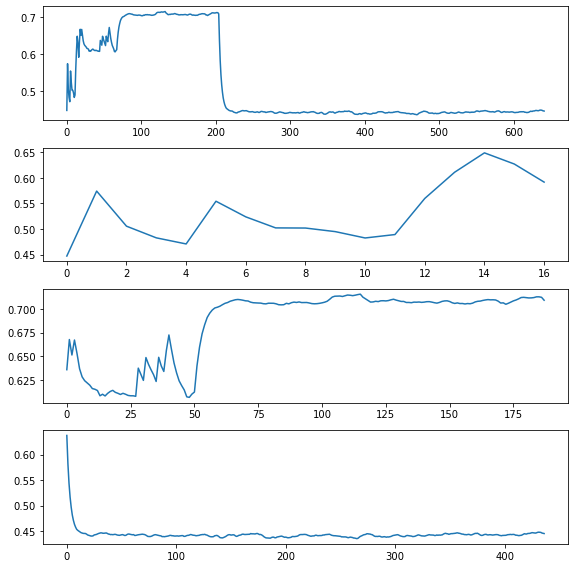

df_len_cnt: 18  H: 10  Total error: 10 Error check:  824.1248700661964 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.4716252709275222
df_len_cnt: 19  H: 10  Total error: 18 Error check:  104.25716710451856 True
******CHANGE TIMES
df_len_cnt: 204  H: 10  Total error: 10 Error check:  14937.666840140588 True
******CHANGE TIMES
ch_times :  [19, 205] ch_num :  2 Resist :  0.6051999286108021
df_len_cnt: 205  H: 10  Total error: 20 Error check:  40.66419039552931 True
******CHANGE TIMES
CHECK TIMES
[None, 19, 205, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.501000       4.47      -20.0
1   2020-02-13 00:29:18     0.473005       4.46      -20.0
2   2020-02-13 12:28:31     0.489763       4.47      -20.0
3   2020-02-14 00:27:44     0.472183       4.43      -20.0
4   2020-02-14 12:27:11     0.463642       4.43      -20.0
5   2020-02-15 00:26:26     0.458967       4.52      -20.0
6   2020-02-15 12:25:37     0.455555     

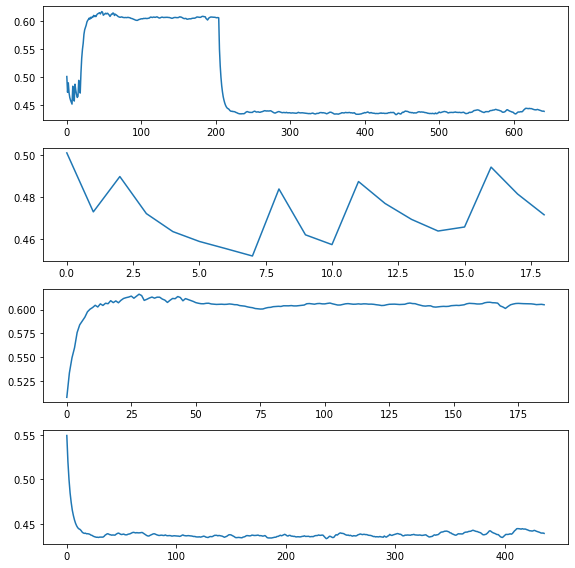

df_len_cnt: 18  H: 10  Total error: 10 Error check:  924.7386111812833 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.45262313137972143
df_len_cnt: 19  H: 10  Total error: 18 Error check:  152.03111272496145 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 10 Error check:  8537.797022296903 True
******CHANGE TIMES
ch_times :  [19, 204] ch_num :  2 Resist :  0.6158845123890396
df_len_cnt: 204  H: 10  Total error: 20 Error check:  133.75414551887897 True
******CHANGE TIMES
CHECK TIMES
[None, 19, 204, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.573000       4.45      -20.0
1   2020-02-13 00:29:18     0.410027       4.46      -20.0
2   2020-02-13 12:28:31     0.495388       4.47      -20.0
3   2020-02-14 00:27:44     0.499080       4.47      -20.0
4   2020-02-14 12:27:11     0.501338       4.47      -20.0
5   2020-02-15 00:26:26     0.484800       4.42      -20.0
6   2020-02-15 12:25:37     0.491985    

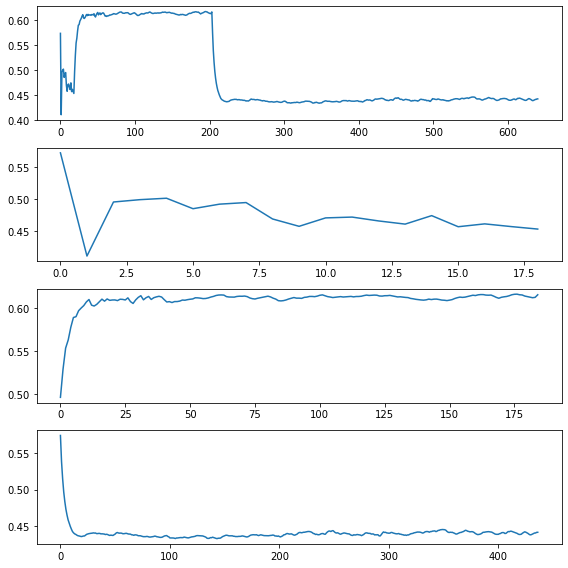

df_len_cnt: 18  H: 10  Total error: 12 Error check:  611.5985171934726 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.48425565489581385
df_len_cnt: 19  H: 10  Total error: 18 Error check:  118.64827455231428 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 9 Error check:  1165.0074227575337 True
******CHANGE TIMES
ch_times :  [19, 204] ch_num :  2 Resist :  0.6013802945269477
df_len_cnt: 204  H: 10  Total error: 20 Error check:  31.01450939186809 True
******CHANGE TIMES
df_len_cnt: 205  H: 10  Total error: 20 Error check:  86.41448952262223 True
******CHANGE TIMES
df_len_cnt: 206  H: 10  Total error: 18 Error check:  179.34269503849777 True
******CHANGE TIMES
df_len_cnt: 207  H: 10  Total error: 13 Error check:  107.80673813016874 True
******CHANGE TIMES
df_len_cnt: 208  H: 10  Total error: 20 Error check:  8.136474865619386 False
CHECK TIMES
[None, 19, 204, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08    

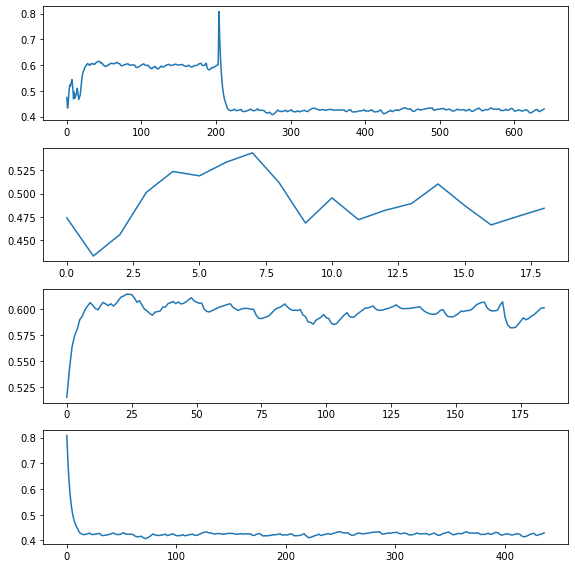

df_len_cnt: 17  H: 10  Total error: 15 Error check:  367.53754907006856 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.4245551992613984
df_len_cnt: 18  H: 10  Total error: 16 Error check:  242.2974485334389 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 18 Error check:  29.726181216209906 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 10 Error check:  5452.4077641790345 True
******CHANGE TIMES
ch_times :  [18, 204] ch_num :  2 Resist :  0.6114122389779024
df_len_cnt: 204  H: 10  Total error: 20 Error check:  34.5487591757304 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 204, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.407000       4.46      -20.0
1   2020-02-13 00:29:18     0.360008       4.45      -20.0
2   2020-02-13 12:28:31     0.385145       4.46      -20.0
3   2020-02-14 00:27:44     0.421199       4.46      -20.0
4   2020-02-14 12:27:11     0.439402       4.46      -20.0
5   2

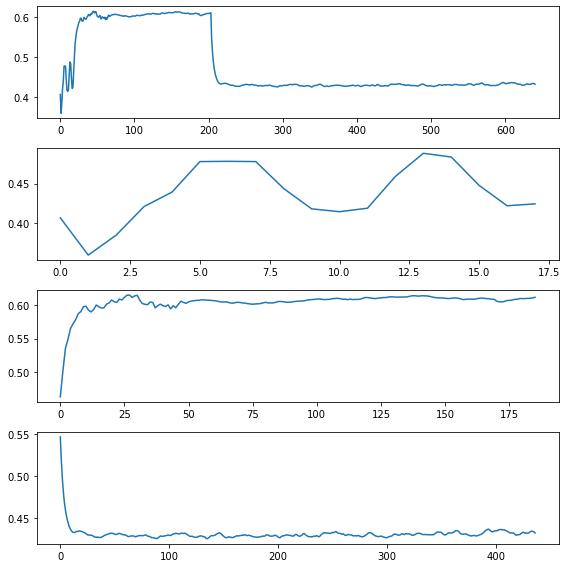

df_len_cnt: 16  H: 10  Total error: 14 Error check:  298.9385027417758 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.44938072522594846
df_len_cnt: 18  H: 10  Total error: 12 Error check:  600.7411443336048 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 19 Error check:  111.51314182677487 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 10 Error check:  5418.6378775939065 True
******CHANGE TIMES
ch_times :  [17, 204] ch_num :  2 Resist :  0.6132041944247659
df_len_cnt: 204  H: 10  Total error: 20 Error check:  93.22995602393902 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 204, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.429000       4.42      -20.0
1   2020-02-13 00:29:18     0.344014       4.46       20.0
2   2020-02-13 12:28:31     0.391670       4.43      -20.0
3   2020-02-14 00:27:44     0.398327       4.46      -20.0
4   2020-02-14 12:27:11     0.401483       4.46      -20.0
5   

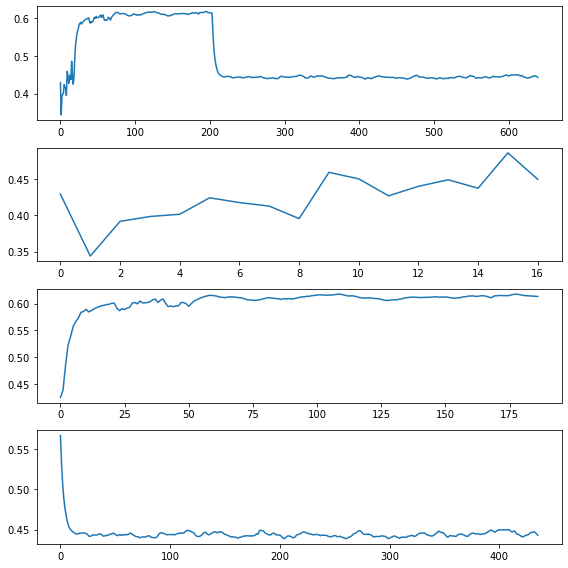

df_len_cnt: 16  H: 10  Total error: 18 Error check:  24.596203019750885 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.47437505649705397
df_len_cnt: 18  H: 10  Total error: 16 Error check:  386.4922285695603 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 19 Error check:  61.16670331358512 True
******CHANGE TIMES
df_len_cnt: 201  H: 10  Total error: 10 Error check:  3003.2590434616095 True
******CHANGE TIMES
ch_times :  [17, 202] ch_num :  2 Resist :  0.5865621524050701
df_len_cnt: 202  H: 10  Total error: 20 Error check:  171.09612942099594 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 202, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.353000       4.45      -20.0
1   2020-02-13 00:29:18     0.622955       4.55      -20.0
2   2020-02-13 12:28:31     0.483655       4.45      -20.0
3   2020-02-14 00:27:44     0.435385       4.44      -20.0
4   2020-02-14 12:27:11     0.435259       4.41      -20.0
5  

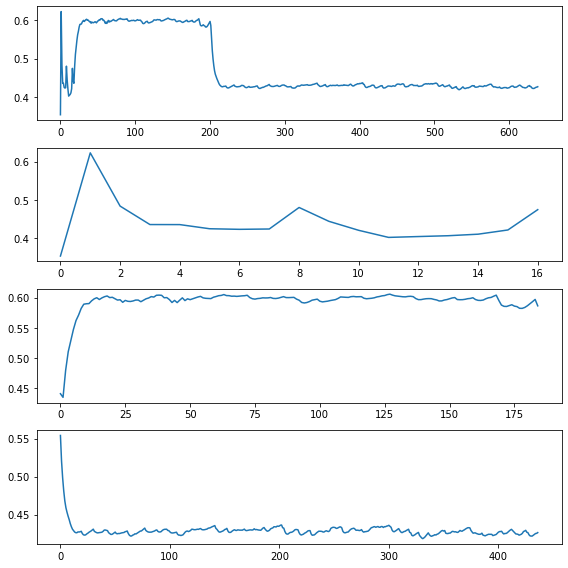

df_len_cnt: 16  H: 10  Total error: 13 Error check:  576.075874179178 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.3976139248356281
df_len_cnt: 18  H: 10  Total error: 17 Error check:  211.89209458386443 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 20 Error check:  18.590162433108194 False
df_len_cnt: 203  H: 10  Total error: 8 Error check:  2028.9162314723853 True
******CHANGE TIMES
ch_times :  [17, 204] ch_num :  2 Resist :  0.5634325466565189
df_len_cnt: 204  H: 10  Total error: 20 Error check:  11.237075152072558 False
df_len_cnt: 205  H: 10  Total error: 20 Error check:  41.95537352457103 True
******CHANGE TIMES
df_len_cnt: 206  H: 10  Total error: 20 Error check:  78.6304426109843 True
******CHANGE TIMES
df_len_cnt: 207  H: 10  Total error: 13 Error check:  104.79083910954321 True
******CHANGE TIMES
df_len_cnt: 208  H: 10  Total error: 15 Error check:  27.19916725507261 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 204, None]
adf
17
           

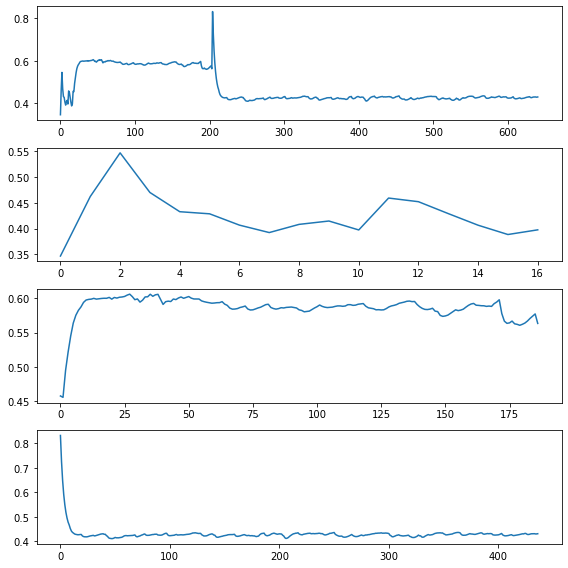

df_len_cnt: 18  H: 10  Total error: 12 Error check:  756.9602945991031 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.41464597685623006
df_len_cnt: 19  H: 10  Total error: 20 Error check:  92.31067350248966 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  9.082951636893615 False
df_len_cnt: 203  H: 10  Total error: 9 Error check:  1387.2563227626265 True
******CHANGE TIMES
ch_times :  [19, 204] ch_num :  2 Resist :  0.5856592739154044
df_len_cnt: 204  H: 10  Total error: 20 Error check:  19.90445884233788 False
df_len_cnt: 205  H: 10  Total error: 20 Error check:  60.53580289290744 True
******CHANGE TIMES
df_len_cnt: 206  H: 10  Total error: 20 Error check:  117.46560747579042 True
******CHANGE TIMES
df_len_cnt: 207  H: 10  Total error: 13 Error check:  147.2794421650593 True
******CHANGE TIMES
df_len_cnt: 208  H: 10  Total error: 20 Error check:  2.09318775235114 False
CHECK TIMES
[None, 19, 204, None]
adf
19
                KeyTime  Resis

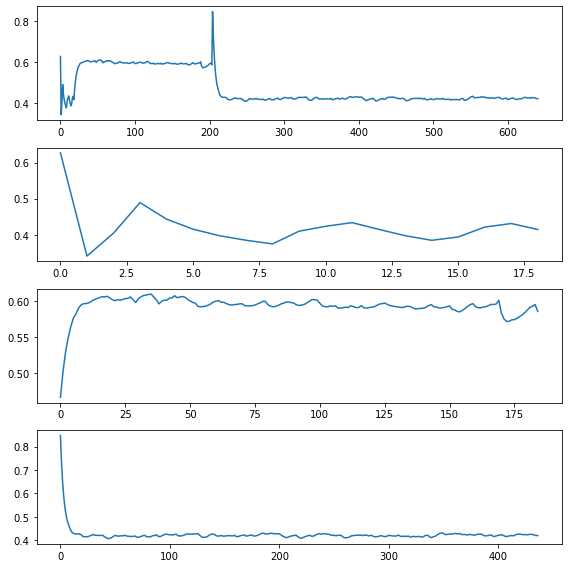

df_len_cnt: 16  H: 10  Total error: 13 Error check:  21.494882877417528 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.532223296121869
df_len_cnt: 17  H: 10  Total error: 16 Error check:  72.72745044186657 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 19 Error check:  97.30701993315796 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 16 Error check:  198.35675384402413 True
******CHANGE TIMES
df_len_cnt: 204  H: 10  Total error: 10 Error check:  2107.118349271066 True
******CHANGE TIMES
ch_times :  [17, 205] ch_num :  2 Resist :  0.5939056857775713
df_len_cnt: 205  H: 10  Total error: 20 Error check:  85.19899893323691 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 205, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.465000       4.44      -20.0
1   2020-02-13 00:29:18     0.435005       4.48      -20.0
2   2020-02-13 12:28:31     0.435002       4.48      -20.0
3   2020-02-14 00:27:44     0

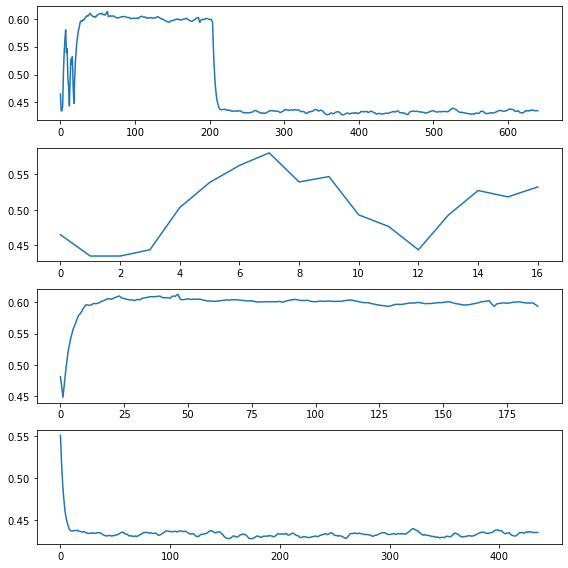

df_len_cnt: 17  H: 10  Total error: 14 Error check:  543.0530344286444 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.4550240907527372
df_len_cnt: 204  H: 10  Total error: 10 Error check:  310.37131739684787 True
******CHANGE TIMES
ch_times :  [18, 205] ch_num :  2 Resist :  0.573794199300154
CHECK TIMES
[None, 18, 205, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.341000       4.43      -20.0
1   2020-02-13 00:29:18     0.502973       4.49      -20.0
2   2020-02-13 12:28:31     0.502463       4.48      -20.0
3   2020-02-14 00:27:44     0.441590       4.42      -20.0
4   2020-02-14 12:27:11     0.447595       4.43      -20.0
5   2020-02-15 00:26:26     0.415142       4.42      -20.0
6   2020-02-15 12:25:37     0.423656       4.43      -20.0
7   2020-02-16 00:24:56     0.430424       4.43      -20.0
8   2020-02-16 12:24:19     0.449786       4.48      -20.0
9   2020-02-17 00:23:33     0.446575       4.51      -20.

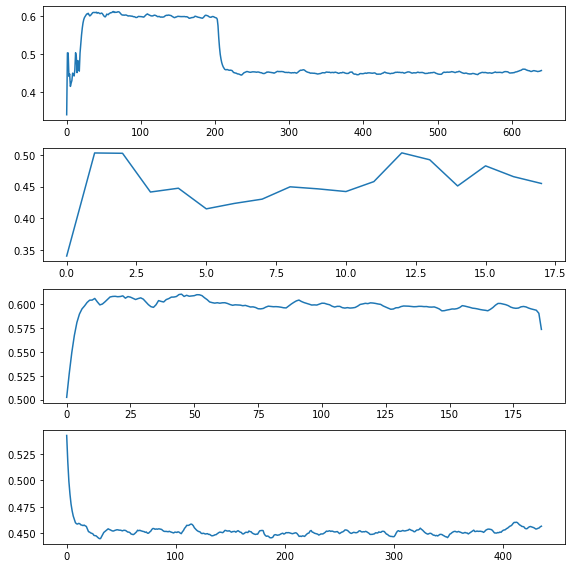

df_len_cnt: 18  H: 10  Total error: 12 Error check:  646.2098669286763 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.4564634327299718
df_len_cnt: 19  H: 10  Total error: 17 Error check:  84.28256756428894 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 8 Error check:  721.2968463554669 True
******CHANGE TIMES
ch_times :  [19, 204] ch_num :  2 Resist :  0.5942515827010038
df_len_cnt: 204  H: 10  Total error: 20 Error check:  18.762299871516095 False
df_len_cnt: 205  H: 10  Total error: 20 Error check:  56.24281666385072 True
******CHANGE TIMES
df_len_cnt: 206  H: 10  Total error: 20 Error check:  105.24963085154195 True
******CHANGE TIMES
df_len_cnt: 207  H: 10  Total error: 13 Error check:  141.87938702994535 True
******CHANGE TIMES
CHECK TIMES
[None, 19, 204, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.433000       4.47      -20.0
1   2020-02-13 00:29:18     0.566978       4.45      -20.0
2   202

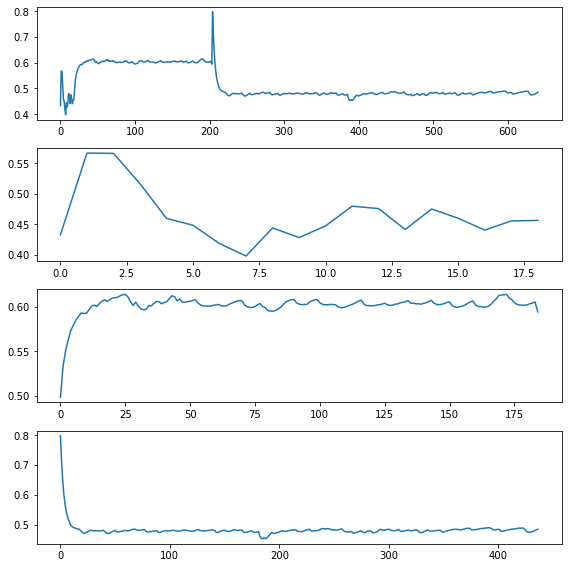

df_len_cnt: 16  H: 10  Total error: 15 Error check:  272.3527208195833 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.43434782250351606
df_len_cnt: 17  H: 10  Total error: 14 Error check:  250.27129926834925 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 15 Error check:  502.9205835717617 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 16 Error check:  137.29849812567983 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 9 Error check:  5160.7726909759685 True
******CHANGE TIMES
ch_times :  [17, 204] ch_num :  2 Resist :  0.6122486384709994
df_len_cnt: 204  H: 10  Total error: 20 Error check:  154.97896894442476 True
******CHANGE TIMES
df_len_cnt: 205  H: 10  Total error: 11 Error check:  1218.1911159536164 True
******CHANGE TIMES
df_len_cnt: 206  H: 10  Total error: 20 Error check:  84.53110645836342 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 204, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-0

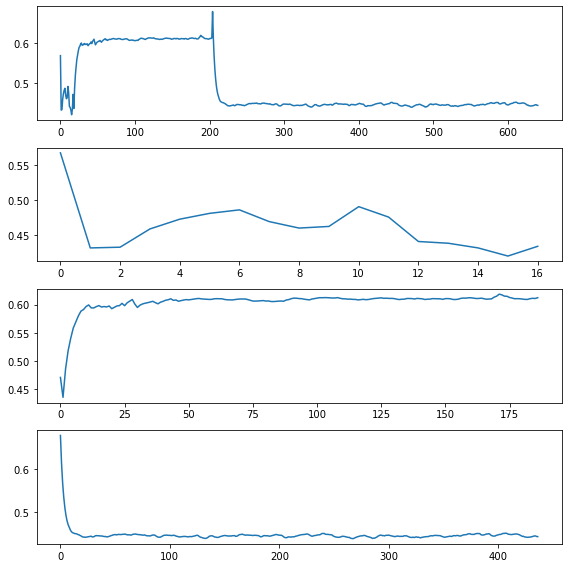

df_len_cnt: 18  H: 10  Total error: 13 Error check:  689.459843293736 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.44724340360614745
df_len_cnt: 19  H: 10  Total error: 18 Error check:  128.08731961797076 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 8 Error check:  586.0096344088153 True
******CHANGE TIMES
ch_times :  [19, 204] ch_num :  2 Resist :  0.6093801369651798
df_len_cnt: 204  H: 10  Total error: 20 Error check:  13.55080667658346 False
df_len_cnt: 205  H: 10  Total error: 20 Error check:  46.497216077106444 True
******CHANGE TIMES
df_len_cnt: 206  H: 10  Total error: 20 Error check:  86.09227387053093 True
******CHANGE TIMES
CHECK TIMES
[None, 19, 204, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.432000       4.51      -20.0
1   2020-02-13 00:29:18     0.470994       4.52      -20.0
2   2020-02-13 12:28:31     0.425429       4.50      -20.0
3   2020-02-14 00:27:44     0.478661       4.

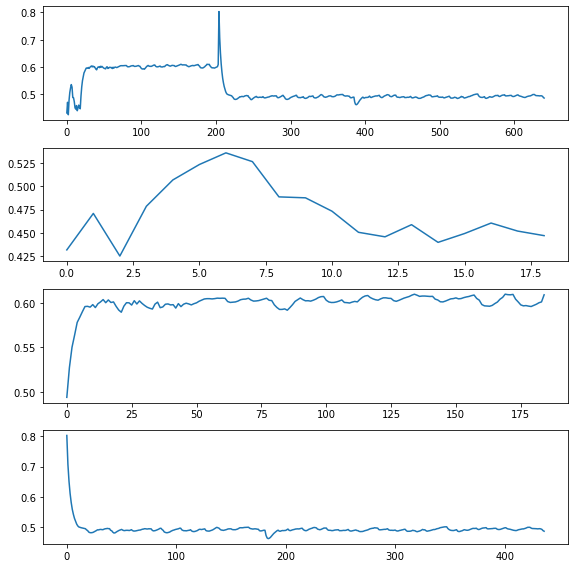

df_len_cnt: 16  H: 10  Total error: 16 Error check:  35.38131497709772 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.5417171318362982
df_len_cnt: 18  H: 10  Total error: 13 Error check:  411.3240309087777 True
******CHANGE TIMES
df_len_cnt: 204  H: 10  Total error: 10 Error check:  420.6821869442587 True
******CHANGE TIMES
ch_times :  [17, 205] ch_num :  2 Resist :  0.582231070111806
df_len_cnt: 205  H: 10  Total error: 20 Error check:  34.10946052337629 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 205, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.383000       4.50      -20.0
1   2020-02-13 00:29:18     0.486983       4.52      -20.0
2   2020-02-13 12:28:31     0.477564       4.51      -20.0
3   2020-02-14 00:27:44     0.454298       4.51      -20.0
4   2020-02-14 12:27:11     0.443762       4.51      -20.0
5   2020-02-15 00:26:26     0.439052       4.51      -20.0
6   2020-02-15 12:25:37     0.437041       4

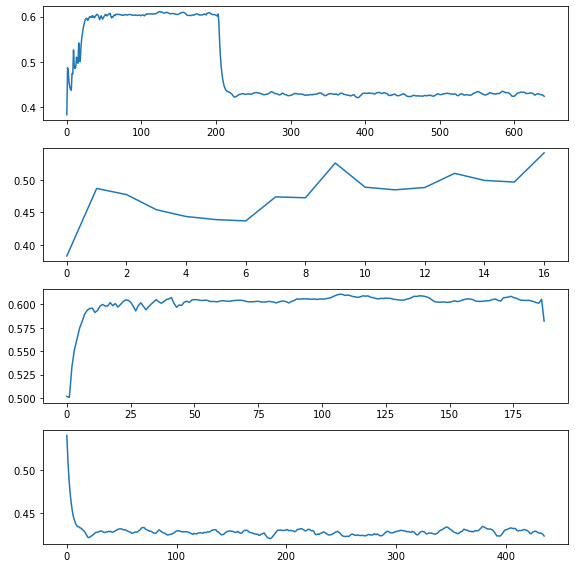

df_len_cnt: 201  H: 10  Total error: 10 Error check:  3094.7834698261368 True
******CHANGE TIMES
ch_times :  [202] ch_num :  1 Resist :  0.5998205801697026
df_len_cnt: 202  H: 10  Total error: 20 Error check:  211.6613664681879 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 20 Error check:  12.789333649530413 False
CHECK TIMES
[None, 202, None]
adf
202
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-12 12:30:08     0.484000       4.52      -20.0
1    2020-02-13 00:29:18     0.663970       4.49      -20.0
2    2020-02-13 12:28:31     0.570231       4.52      -20.0
3    2020-02-14 00:27:44     0.497154       4.50      -20.0
4    2020-02-14 12:27:11     0.459915       4.50      -20.0
..                   ...          ...        ...        ...
197  2020-06-29 17:10:25     0.596330       4.45      -20.0
198  2020-06-30 05:09:58     0.596241       4.45      -20.0
199  2020-06-30 17:09:20     0.596716       4.45      -20.0
200  2020-07-01 05:08:51     0.

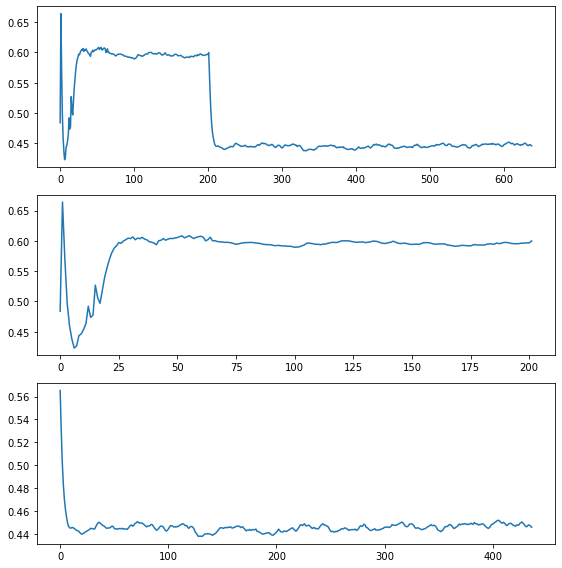

df_len_cnt: 18  H: 10  Total error: 17 Error check:  249.1809421975324 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.4611736436361671
df_len_cnt: 19  H: 10  Total error: 14 Error check:  262.4120636003725 True
******CHANGE TIMES
df_len_cnt: 201  H: 10  Total error: 9 Error check:  5250.142505244162 True
******CHANGE TIMES
ch_times :  [19, 202] ch_num :  2 Resist :  0.5914857164473813
df_len_cnt: 202  H: 10  Total error: 20 Error check:  52.077777598174315 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 20 Error check:  145.20651499387617 True
******CHANGE TIMES
df_len_cnt: 204  H: 10  Total error: 12 Error check:  375.103593671192 True
******CHANGE TIMES
df_len_cnt: 205  H: 10  Total error: 20 Error check:  6.984416267644524 False
CHECK TIMES
[None, 19, 202, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.664000       4.50      -20.0
1   2020-02-13 00:29:18     0.459034       4.48       20.9
2   2020-

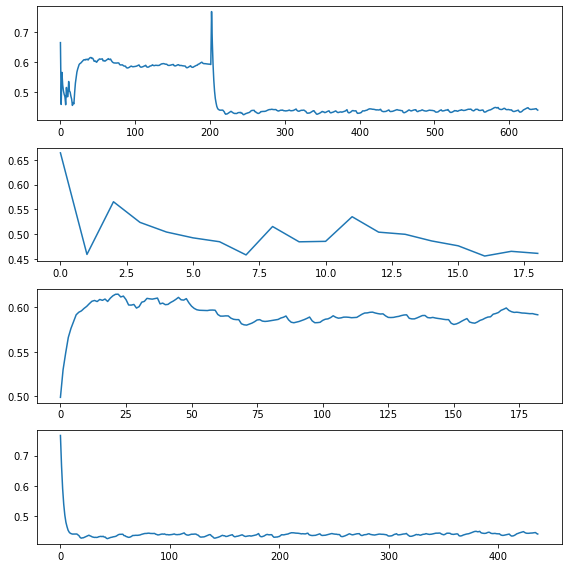

df_len_cnt: 16  H: 10  Total error: 18 Error check:  183.93730877392298 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.4332460459473657
df_len_cnt: 18  H: 10  Total error: 15 Error check:  261.58970829856503 True
******CHANGE TIMES
df_len_cnt: 201  H: 10  Total error: 9 Error check:  2808.530869258522 True
******CHANGE TIMES
ch_times :  [17, 202] ch_num :  2 Resist :  0.6049551059680229
df_len_cnt: 202  H: 10  Total error: 16 Error check:  375.228102012279 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 11 Error check:  345.8837972966139 True
******CHANGE TIMES
df_len_cnt: 204  H: 10  Total error: 20 Error check:  28.035091843950678 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 202, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.457000       4.49       20.7
1   2020-02-13 00:29:18     0.403009       4.46      -20.0
2   2020-02-13 12:28:31     0.431288       4.49       20.9
3   2020-02-14 00:27:44    

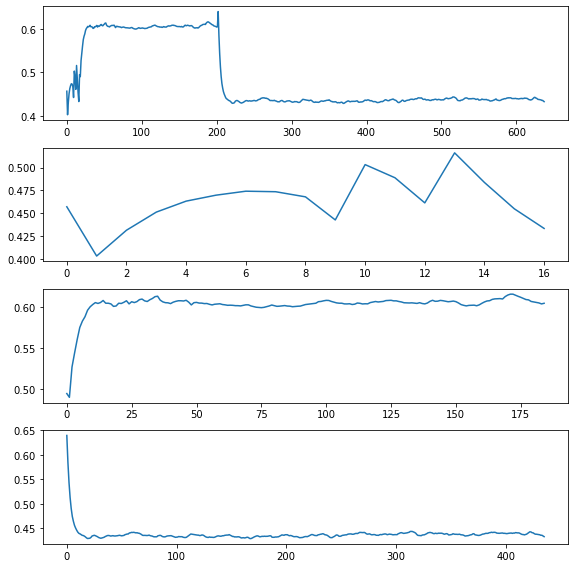

df_len_cnt: 18  H: 10  Total error: 14 Error check:  175.430223690419 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.509468553249394
df_len_cnt: 201  H: 10  Total error: 9 Error check:  6482.704596491254 True
******CHANGE TIMES
ch_times :  [19, 202] ch_num :  2 Resist :  0.5996260801792906
df_len_cnt: 202  H: 10  Total error: 20 Error check:  77.58059897290786 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 20 Error check:  214.8473517594585 True
******CHANGE TIMES
df_len_cnt: 204  H: 10  Total error: 12 Error check:  241.40486955828027 True
******CHANGE TIMES
df_len_cnt: 205  H: 10  Total error: 20 Error check:  1.8643707512501158 False
CHECK TIMES
[None, 19, 202, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.406000       4.47      -20.0
1   2020-02-13 00:29:18     0.378005       4.47      -20.0
2   2020-02-13 12:28:31     0.390573       4.46      -20.0
3   2020-02-14 00:27:44     0.494457       4.4

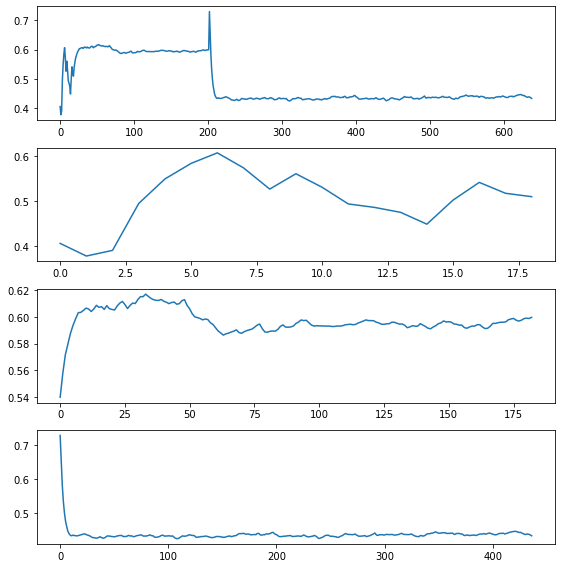

df_len_cnt: 17  H: 10  Total error: 15 Error check:  392.2477472488157 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.45110251644038635
df_len_cnt: 18  H: 10  Total error: 18 Error check:  53.933521673831166 True
******CHANGE TIMES
df_len_cnt: 201  H: 10  Total error: 10 Error check:  5989.246956716473 True
******CHANGE TIMES
ch_times :  [18, 202] ch_num :  2 Resist :  0.609600647699913
df_len_cnt: 202  H: 10  Total error: 20 Error check:  36.84194141761071 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 202, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.377000       4.47      -20.0
1   2020-02-13 00:29:18     0.645955       4.49      -20.0
2   2020-02-13 12:28:31     0.505084       4.47      -20.0
3   2020-02-14 00:27:44     0.481234       4.49       20.9
4   2020-02-14 12:27:11     0.470393       4.50       20.9
5   2020-02-15 00:26:26     0.464299       4.49       21.0
6   2020-02-15 12:25:37     0.460507      

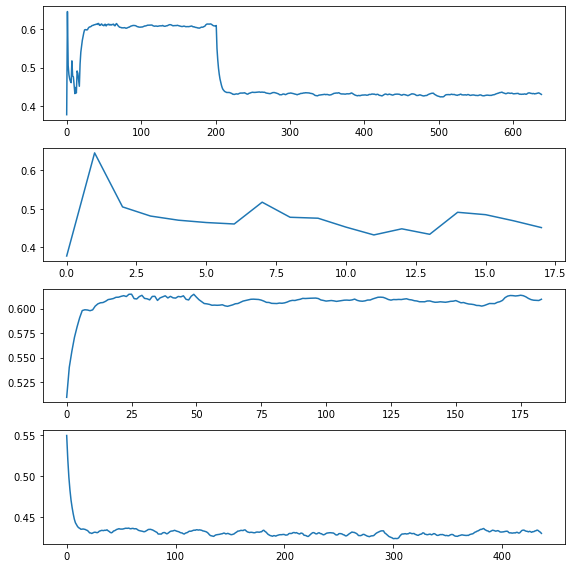

df_len_cnt: 18  H: 10  Total error: 15 Error check:  343.36770250176613 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.4376289846528728
df_len_cnt: 19  H: 10  Total error: 16 Error check:  155.63006621232427 True
******CHANGE TIMES
df_len_cnt: 201  H: 10  Total error: 10 Error check:  555.6595840417741 True
******CHANGE TIMES
ch_times :  [19, 202] ch_num :  2 Resist :  0.5895944580501439
df_len_cnt: 202  H: 10  Total error: 20 Error check:  70.15318659206578 True
******CHANGE TIMES
CHECK TIMES
[None, 19, 202, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.649000       4.49      -20.0
1   2020-02-13 00:29:18     0.469030       4.47      -20.0
2   2020-02-13 12:28:31     0.562769       4.49      -20.0
3   2020-02-14 00:27:44     0.496784       4.48      -20.0
4   2020-02-14 12:27:11     0.463907       4.47      -20.0
5   2020-02-15 00:26:26     0.443912       4.47      -20.0
6   2020-02-15 12:25:37     0.430822     

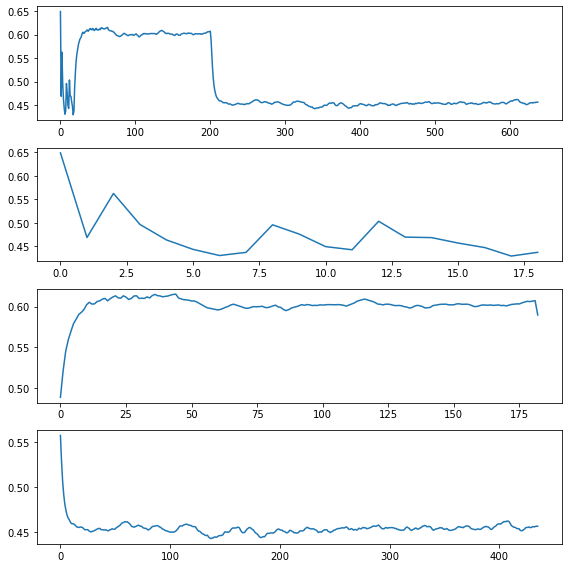

df_len_cnt: 16  H: 10  Total error: 14 Error check:  139.4582389749209 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.47040636301145977
df_len_cnt: 17  H: 10  Total error: 17 Error check:  17.929907587791273 False
df_len_cnt: 18  H: 10  Total error: 15 Error check:  201.42898612616403 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 9 Error check:  4071.714065578857 True
******CHANGE TIMES
ch_times :  [17, 201] ch_num :  2 Resist :  0.6040765672085764
df_len_cnt: 201  H: 10  Total error: 20 Error check:  59.209012071337 True
******CHANGE TIMES
df_len_cnt: 202  H: 10  Total error: 20 Error check:  165.0025059788373 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 12 Error check:  474.6363675110354 True
******CHANGE TIMES
df_len_cnt: 204  H: 10  Total error: 20 Error check:  47.523733218906784 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 201, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.4

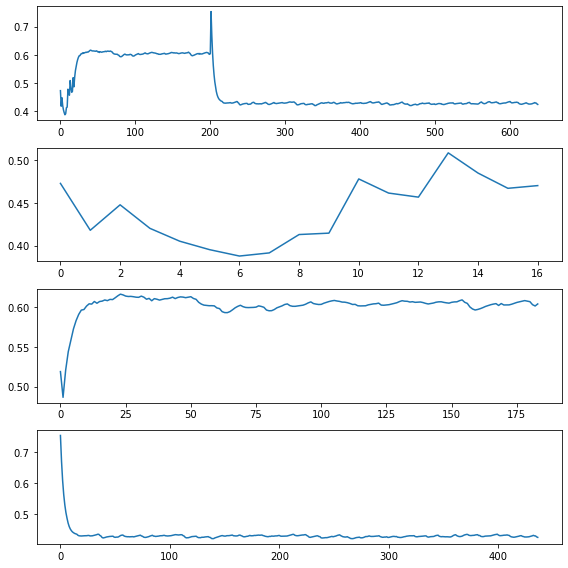

df_len_cnt: 18  H: 10  Total error: 14 Error check:  553.4980879954974 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.4601923714341772
df_len_cnt: 19  H: 10  Total error: 17 Error check:  131.66349685157974 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 9 Error check:  5040.452537409534 True
******CHANGE TIMES
ch_times :  [19, 201] ch_num :  2 Resist :  0.6123795570102929
df_len_cnt: 201  H: 10  Total error: 20 Error check:  68.38690974464747 True
******CHANGE TIMES
df_len_cnt: 202  H: 10  Total error: 20 Error check:  194.44357079400046 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 12 Error check:  399.60157706024177 True
******CHANGE TIMES
df_len_cnt: 204  H: 10  Total error: 20 Error check:  33.04194339147538 True
******CHANGE TIMES
CHECK TIMES
[None, 19, 201, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.419000       4.48      -20.0
1   2020-02-13 00:29:18     0.416000       4.49 

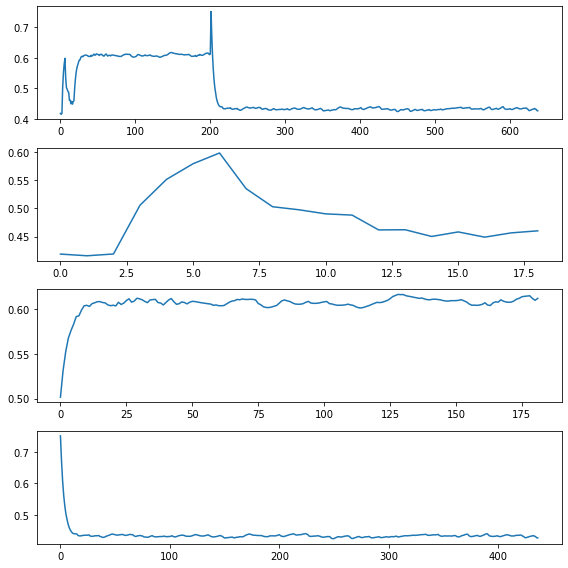

df_len_cnt: 18  H: 10  Total error: 12 Error check:  563.6194701442629 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.43604816566285814
df_len_cnt: 19  H: 10  Total error: 19 Error check:  171.81061515157154 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 10 Error check:  3795.570161441237 True
******CHANGE TIMES
ch_times :  [19, 201] ch_num :  2 Resist :  0.6138080907967939
df_len_cnt: 201  H: 10  Total error: 20 Error check:  85.0764825915349 True
******CHANGE TIMES
CHECK TIMES
[None, 19, 201, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.479000       4.47      -20.0
1   2020-02-13 00:29:18     0.478000       4.48      -20.0
2   2020-02-13 12:28:31     0.447621       4.49      -20.0
3   2020-02-14 00:27:44     0.456986       4.47      -20.0
4   2020-02-14 12:27:11     0.461232       4.47      -20.0
5   2020-02-15 00:26:26     0.463553       4.47      -20.0
6   2020-02-15 12:25:37     0.465106      

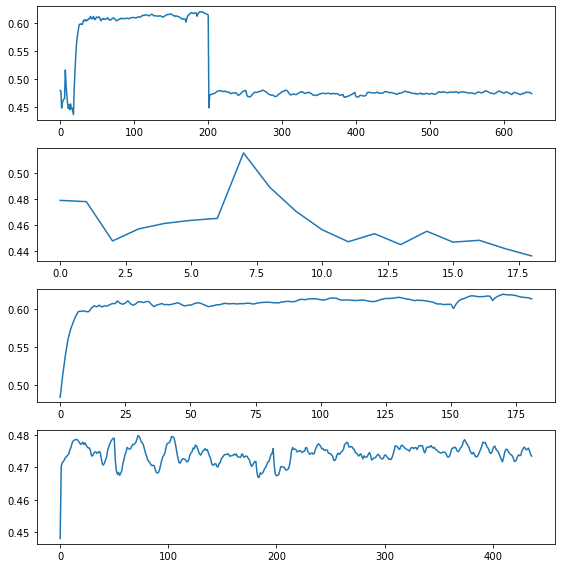

df_len_cnt: 18  H: 10  Total error: 12 Error check:  1087.9127935553092 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.4272312255722783
df_len_cnt: 19  H: 10  Total error: 20 Error check:  118.67722701713785 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 20 Error check:  284.7111063395608 True
******CHANGE TIMES
ch_times :  [19, 201] ch_num :  2 Resist :  0.5866333041548452
df_len_cnt: 201  H: 10  Total error: 20 Error check:  33.02863255461708 True
******CHANGE TIMES
CHECK TIMES
[None, 19, 201, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.423000       4.53      -20.0
1   2020-02-13 00:29:18     0.420000       4.54      -20.0
2   2020-02-13 12:28:31     0.449855       4.47      -20.0
3   2020-02-14 00:27:44     0.438770       4.46      -20.0
4   2020-02-14 12:27:11     0.433300       4.46      -20.0
5   2020-02-15 00:26:26     0.429624       4.46      -20.0
6   2020-02-15 12:25:37     0.427450     

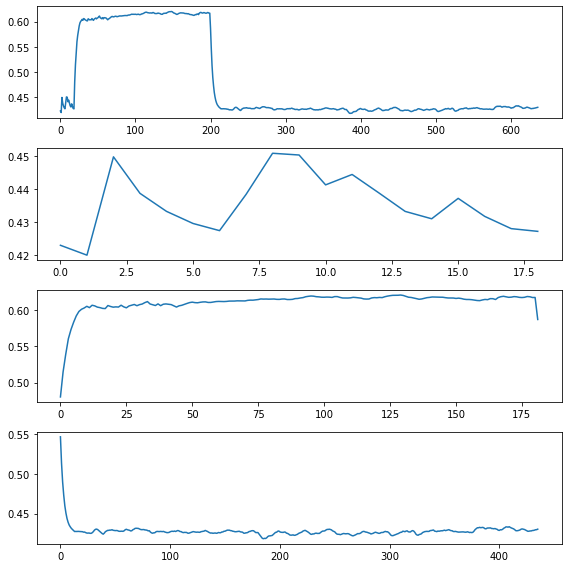

df_len_cnt: 18  H: 10  Total error: 10 Error check:  1313.2209104216254 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.44264126259604475
df_len_cnt: 19  H: 10  Total error: 20 Error check:  67.92560431569397 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  10.0593039110721 False
df_len_cnt: 200  H: 10  Total error: 10 Error check:  6074.307529614405 True
******CHANGE TIMES
ch_times :  [19, 201] ch_num :  2 Resist :  0.6054113813586526
df_len_cnt: 201  H: 10  Total error: 20 Error check:  146.77761550114556 True
******CHANGE TIMES
df_len_cnt: 202  H: 10  Total error: 20 Error check:  10.543821050693495 False
CHECK TIMES
[None, 19, 201, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.450000       4.45      -20.0
1   2020-02-13 00:29:18     0.415006       4.49      -20.0
2   2020-02-13 12:28:31     0.419717       4.54      -20.0
3   2020-02-14 00:27:44     0.420210       4.49      -20.0
4  

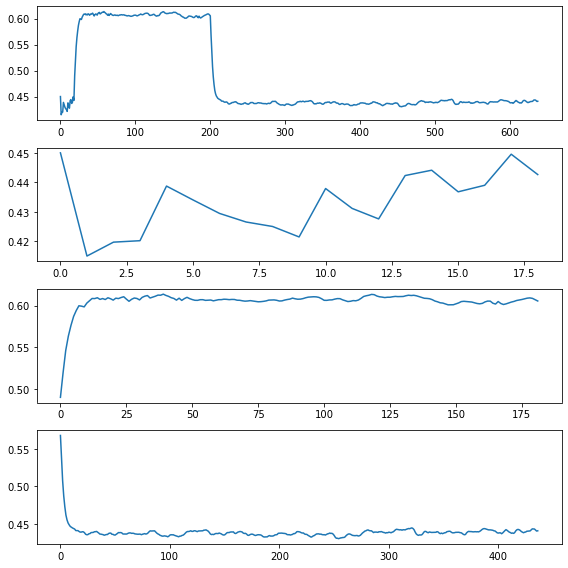

df_len_cnt: 18  H: 10  Total error: 10 Error check:  2315.496469842323 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.4397993338351226
df_len_cnt: 19  H: 10  Total error: 20 Error check:  79.91229467596193 True
******CHANGE TIMES
df_len_cnt: 199  H: 10  Total error: 9 Error check:  2455.215775627876 True
******CHANGE TIMES
ch_times :  [19, 200] ch_num :  2 Resist :  0.6077286486728778
df_len_cnt: 200  H: 10  Total error: 20 Error check:  136.83865749725967 True
******CHANGE TIMES
df_len_cnt: 201  H: 10  Total error: 11 Error check:  650.5665676831559 True
******CHANGE TIMES
df_len_cnt: 202  H: 10  Total error: 20 Error check:  116.87940295117521 True
******CHANGE TIMES
CHECK TIMES
[None, 19, 200, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.418000       4.49      -20.0
1   2020-02-13 00:29:18     0.439996       4.49      -20.0
2   2020-02-13 12:28:31     0.446284       4.45      -20.0
3   2020-02-14 00:27:44    

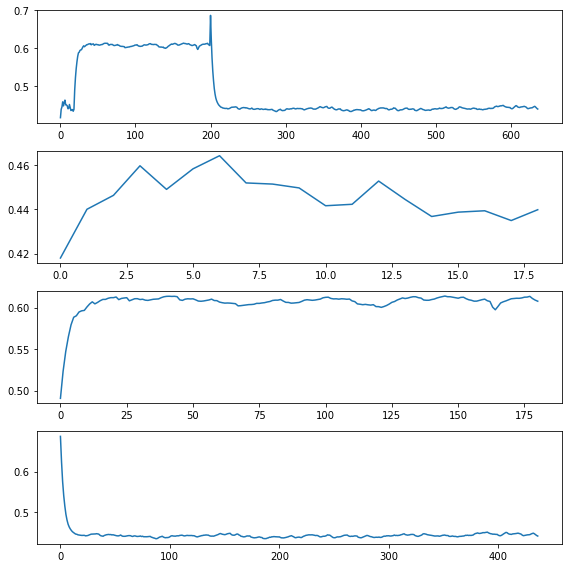

df_len_cnt: 17  H: 10  Total error: 17 Error check:  15.30877854025908 False
df_len_cnt: 18  H: 10  Total error: 19 Error check:  112.5848067401655 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.48882558071767884
df_len_cnt: 201  H: 10  Total error: 10 Error check:  907.5504338332729 True
******CHANGE TIMES
ch_times :  [19, 202] ch_num :  2 Resist :  0.6146133779089006
df_len_cnt: 202  H: 10  Total error: 20 Error check:  192.61886980387496 True
******CHANGE TIMES
CHECK TIMES
[None, 19, 202, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.440000       4.50      -20.0
1   2020-02-13 00:29:18     0.660963       4.44      -20.0
2   2020-02-13 12:28:31     0.532658       4.50      -20.0
3   2020-02-14 00:27:44     0.491686       4.53      -20.0
4   2020-02-14 12:27:11     0.478413       4.45      -20.0
5   2020-02-15 00:26:26     0.462451       4.52      -20.0
6   2020-02-15 12:25:37     0.450632       4.53      -20.0


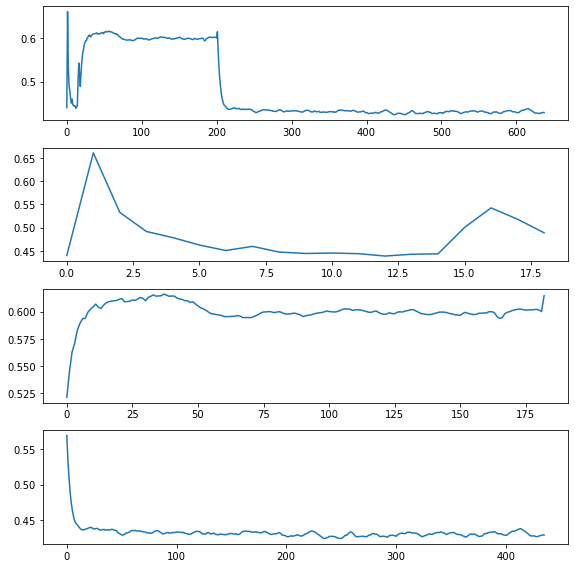

df_len_cnt: 16  H: 10  Total error: 13 Error check:  10.414800046446365 False
df_len_cnt: 18  H: 10  Total error: 16 Error check:  206.14574873311443 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.48260553684113305
df_len_cnt: 200  H: 10  Total error: 13 Error check:  286.2774627977997 True
******CHANGE TIMES
ch_times :  [19, 201] ch_num :  2 Resist :  0.5735826986330941
df_len_cnt: 201  H: 10  Total error: 20 Error check:  30.2991548467397 True
******CHANGE TIMES
CHECK TIMES
[None, 19, 201, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.440000       4.47       22.7
1   2020-02-13 00:29:18     0.522986       4.53      -20.0
2   2020-02-13 12:28:31     0.479520       4.51      -20.0
3   2020-02-14 00:27:44     0.467412       4.45      -20.0
4   2020-02-14 12:27:11     0.451945       4.49      -20.0
5   2020-02-15 00:26:26     0.451364       4.45      -20.0
6   2020-02-15 12:25:37     0.451831       4.46      -20.0


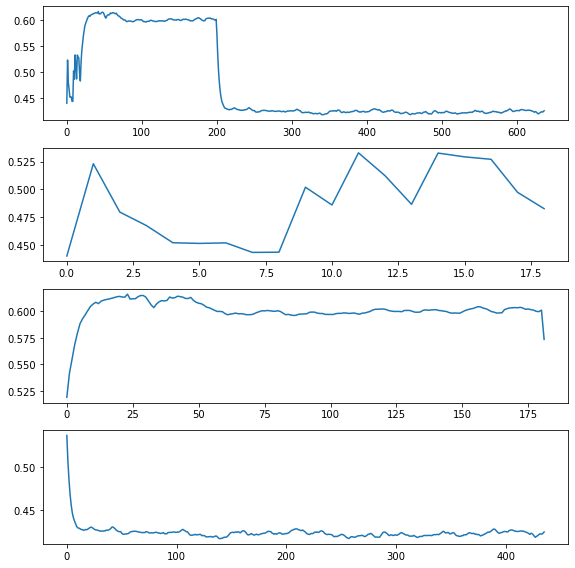

df_len_cnt: 18  H: 10  Total error: 12 Error check:  715.6704502023492 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.4380361315706297
df_len_cnt: 19  H: 10  Total error: 18 Error check:  158.78411824990738 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 10 Error check:  3275.602580581576 True
******CHANGE TIMES
ch_times :  [19, 201] ch_num :  2 Resist :  0.6087803353256173
df_len_cnt: 201  H: 10  Total error: 20 Error check:  59.27649615377697 True
******CHANGE TIMES
CHECK TIMES
[None, 19, 201, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.659000       4.44      -20.0
1   2020-02-13 00:29:18     0.398043       4.52      -20.0
2   2020-02-13 12:28:31     0.420019       4.48       22.8
3   2020-02-14 00:27:44     0.418859       4.48      -20.0
4   2020-02-14 12:27:11     0.426408       4.49      -20.0
5   2020-02-15 00:26:26     0.423895       4.49      -20.0
6   2020-02-15 12:25:37     0.429913      

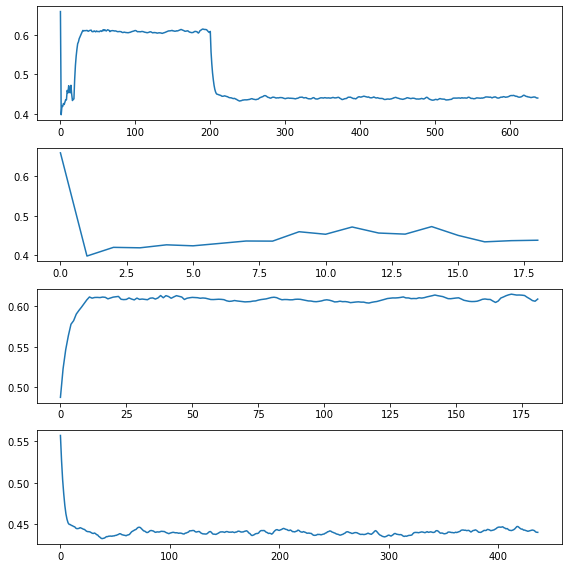

df_len_cnt: 16  H: 10  Total error: 17 Error check:  229.4065362237788 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.4361527916501037
df_len_cnt: 17  H: 10  Total error: 13 Error check:  364.35689545265456 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 17 Error check:  80.16144330254325 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 10 Error check:  5014.109013519101 True
******CHANGE TIMES
ch_times :  [17, 201] ch_num :  2 Resist :  0.6136810514162063
df_len_cnt: 201  H: 10  Total error: 20 Error check:  136.57595412456882 True
******CHANGE TIMES
df_len_cnt: 202  H: 10  Total error: 20 Error check:  4.27794682693069 False
CHECK TIMES
[None, 17, 201, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.519000       4.52      -20.0
1   2020-02-13 00:29:18     0.426015       4.48      -20.0
2   2020-02-13 12:28:31     0.551189       4.42      -20.0
3   2020-02-14 00:27:44     0.508476       4.5

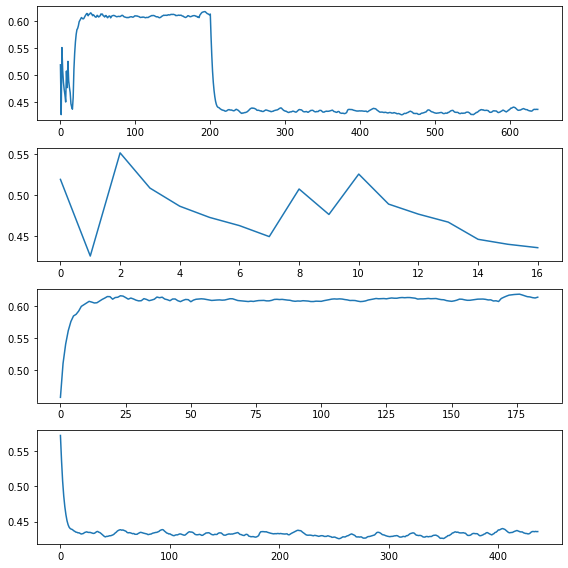

df_len_cnt: 16  H: 10  Total error: 12 Error check:  137.93045524825405 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.505108999417234
df_len_cnt: 18  H: 10  Total error: 13 Error check:  301.08493462988474 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 10 Error check:  12236.750420501225 True
******CHANGE TIMES
ch_times :  [17, 201] ch_num :  2 Resist :  0.6107765626747776
df_len_cnt: 201  H: 10  Total error: 20 Error check:  19.852652653764274 False
CHECK TIMES
[None, 17, 201, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.399000       4.51      -20.0
1   2020-02-13 00:29:18     0.441993       4.47      -20.0
2   2020-02-13 12:28:31     0.419998       4.52      -20.0
3   2020-02-14 00:27:44     0.427298       4.47       22.9
4   2020-02-14 12:27:11     0.504513       4.44      -20.0
5   2020-02-15 00:26:26     0.550382       4.43      -20.0
6   2020-02-15 12:25:37     0.581351       4.43      -20.0

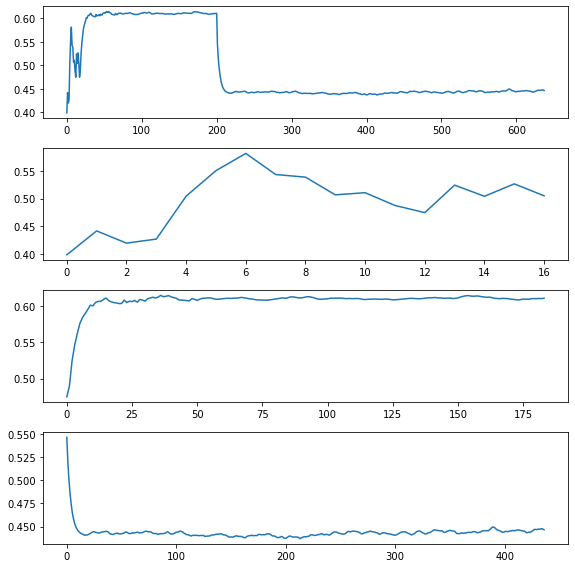

df_len_cnt: 16  H: 10  Total error: 15 Error check:  43.08787397751556 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.5449883601017251
df_len_cnt: 17  H: 10  Total error: 15 Error check:  54.29458385415573 True
******CHANGE TIMES
df_len_cnt: 18  H: 10  Total error: 18 Error check:  158.45450674603748 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 10 Error check:  3705.094936795671 True
******CHANGE TIMES
ch_times :  [17, 201] ch_num :  2 Resist :  0.6093513721549675
df_len_cnt: 201  H: 10  Total error: 20 Error check:  115.70747742449947 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 201, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.427000       4.48      -20.0
1   2020-02-13 00:29:18     0.581974       4.50      -20.0
2   2020-02-13 12:28:31     0.500279       4.48      -20.0
3   2020-02-14 00:27:44     0.563941       4.43      -20.0
4   2020-02-14 12:27:11     0.509156       4.51      -20.0
5   2

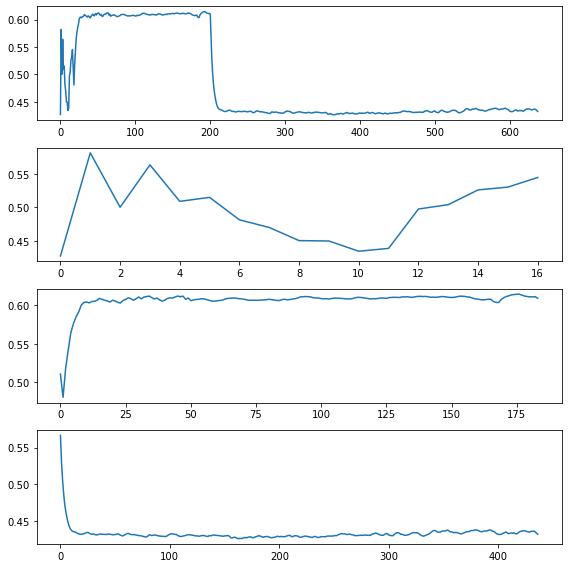

df_len_cnt: 18  H: 10  Total error: 16 Error check:  319.0877929881178 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.47850183122114565
df_len_cnt: 200  H: 10  Total error: 9 Error check:  2800.2812705089787 True
******CHANGE TIMES
ch_times :  [19, 201] ch_num :  2 Resist :  0.6029827796195557
df_len_cnt: 201  H: 10  Total error: 10 Error check:  429.14200057637635 True
******CHANGE TIMES
df_len_cnt: 202  H: 10  Total error: 13 Error check:  256.9443707353458 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 20 Error check:  21.43416979313279 True
******CHANGE TIMES
CHECK TIMES
[None, 19, 201, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.441000       4.47      -20.0
1   2020-02-13 00:29:18     0.537984       4.51      -20.0
2   2020-02-13 12:28:31     0.561038       4.50      -20.0
3   2020-02-14 00:27:44     0.547578       4.53      -20.0
4   2020-02-14 12:27:11     0.508244       4.49      -20.0
5  

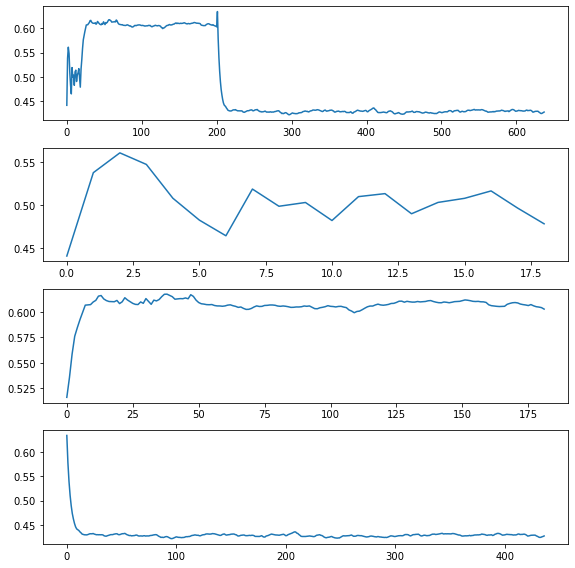

df_len_cnt: 16  H: 10  Total error: 17 Error check:  160.56485647673787 True
******CHANGE TIMES
ch_times :  [17] ch_num :  1 Resist :  0.44885550175558203
df_len_cnt: 18  H: 10  Total error: 14 Error check:  489.9022858232357 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 10 Error check:  2488.8779423513793 True
******CHANGE TIMES
ch_times :  [17, 201] ch_num :  2 Resist :  0.6110408650964945
df_len_cnt: 201  H: 10  Total error: 20 Error check:  52.7572046467504 True
******CHANGE TIMES
CHECK TIMES
[None, 17, 201, None]
adf
17
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.583000       4.49      -20.0
1   2020-02-13 00:29:18     0.512012       4.51      -20.0
2   2020-02-13 12:28:31     0.521957       4.51      -20.0
3   2020-02-14 00:27:44     0.473571       4.52      -20.0
4   2020-02-14 12:27:11     0.464577       4.47      -20.0
5   2020-02-15 00:26:26     0.459623       4.47      -20.0
6   2020-02-15 12:25:37     0.495941     

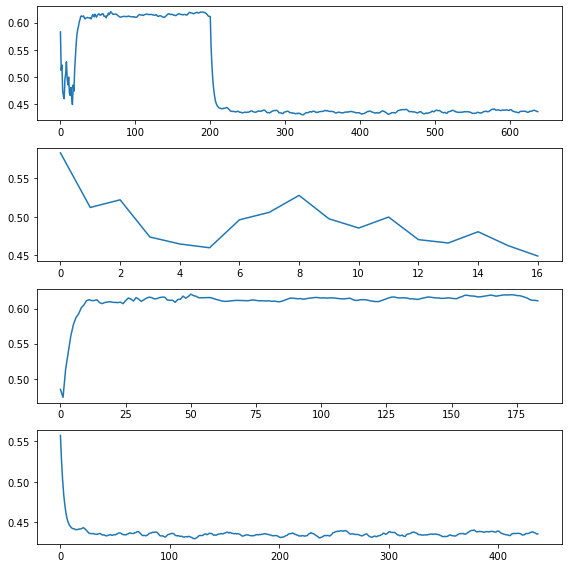

df_len_cnt: 17  H: 10  Total error: 11 Error check:  626.9535453276225 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.4817271290646381
df_len_cnt: 18  H: 10  Total error: 15 Error check:  242.7513977513495 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 10 Error check:  4633.815259968857 True
******CHANGE TIMES
ch_times :  [18, 201] ch_num :  2 Resist :  0.602501887696528
df_len_cnt: 201  H: 10  Total error: 20 Error check:  132.24746655211632 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 201, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.540000       4.51      -20.0
1   2020-02-13 00:29:18     0.407022       4.51      -20.0
2   2020-02-13 12:28:31     0.460959       4.51      -20.0
3   2020-02-14 00:27:44     0.446761       4.48      -20.0
4   2020-02-14 12:27:11     0.491857       4.50      -20.0
5   2020-02-15 00:26:26     0.519991       4.50      -20.0
6   2020-02-15 12:25:37     0.523985       

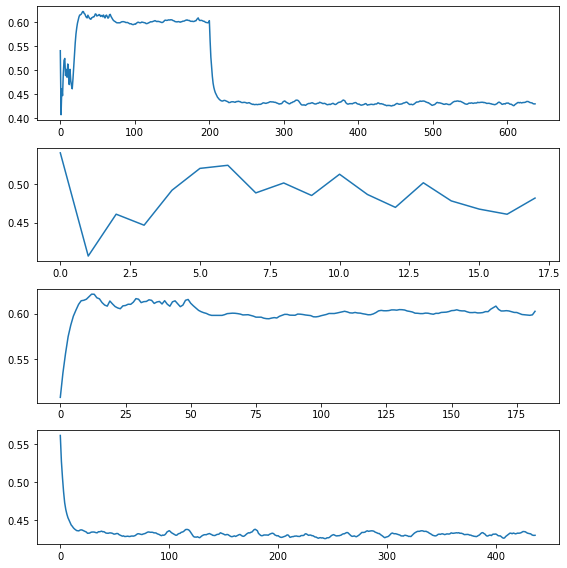

df_len_cnt: 18  H: 10  Total error: 12 Error check:  578.3664901938951 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.47830812873617673
df_len_cnt: 19  H: 10  Total error: 20 Error check:  59.87308680938798 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 10 Error check:  5786.559728593259 True
******CHANGE TIMES
ch_times :  [19, 201] ch_num :  2 Resist :  0.6008466732631996
CHECK TIMES
[None, 19, 201, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.513000       4.52      -20.0
1   2020-02-13 00:29:18     0.445011       4.46      -20.0
2   2020-02-13 12:28:31     0.425626       4.52      -20.0
3   2020-02-14 00:27:44     0.433453       4.47      -20.0
4   2020-02-14 12:27:11     0.468210       4.52      -20.0
5   2020-02-15 00:26:26     0.488767       4.52      -20.0
6   2020-02-15 12:25:37     0.494821       4.52      -20.0
7   2020-02-16 00:24:56     0.473740       4.48      -20.0
8   2020-02-16 12:24

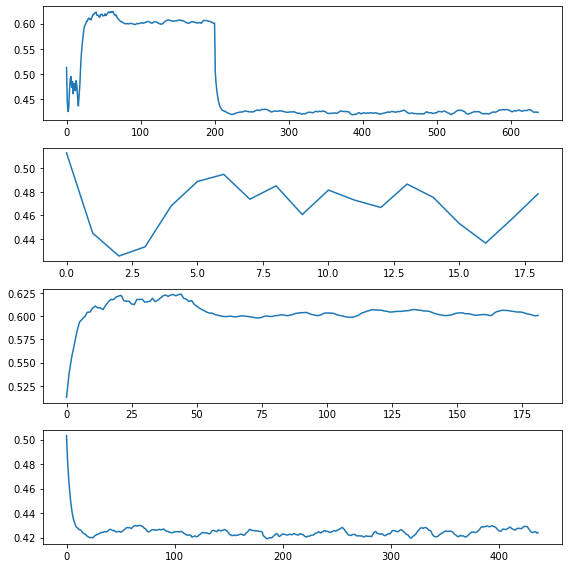

df_len_cnt: 18  H: 10  Total error: 12 Error check:  759.7263856343851 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.4533988594015733
df_len_cnt: 19  H: 10  Total error: 18 Error check:  147.8197230743938 True
******CHANGE TIMES
df_len_cnt: 201  H: 10  Total error: 10 Error check:  504.0809432845806 True
******CHANGE TIMES
ch_times :  [19, 202] ch_num :  2 Resist :  0.6269696349517844
df_len_cnt: 202  H: 10  Total error: 11 Error check:  287.0390016070113 True
******CHANGE TIMES
df_len_cnt: 203  H: 10  Total error: 20 Error check:  26.48600720110062 True
******CHANGE TIMES
CHECK TIMES
[None, 19, 202, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.408000       4.52      -20.0
1   2020-02-13 00:29:18     0.396002       4.44      -20.0
2   2020-02-13 12:28:31     0.421142       4.45      -20.0
3   2020-02-14 00:27:44     0.483320       4.49      -20.0
4   2020-02-14 12:27:11     0.492023       4.52      -20.0
5   20

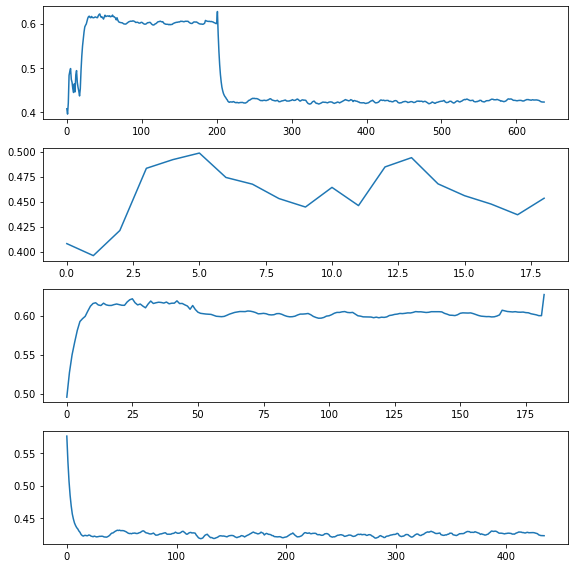

df_len_cnt: 18  H: 10  Total error: 11 Error check:  756.3797583357809 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.43818543596014403
df_len_cnt: 19  H: 10  Total error: 19 Error check:  148.01316249282493 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 10 Error check:  3174.5909628131058 True
******CHANGE TIMES
ch_times :  [19, 201] ch_num :  2 Resist :  0.607428719868504
df_len_cnt: 201  H: 10  Total error: 20 Error check:  109.94718036264133 True
******CHANGE TIMES
CHECK TIMES
[None, 19, 201, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.395000       4.44      -20.0
1   2020-02-13 00:29:18     0.441992       4.48      -20.0
2   2020-02-13 12:28:31     0.416855       4.44      -20.0
3   2020-02-14 00:27:44     0.463009       4.52      -20.0
4   2020-02-14 12:27:11     0.446369       4.51      -20.0
5   2020-02-15 00:26:26     0.436995       4.50      -20.0
6   2020-02-15 12:25:37     0.440133    

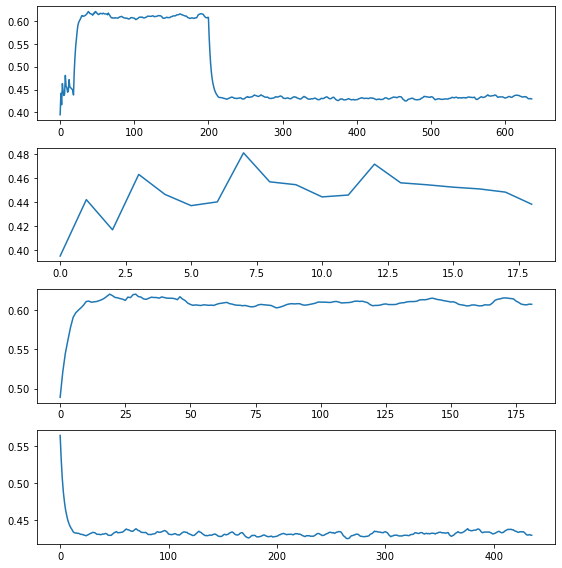

df_len_cnt: 17  H: 10  Total error: 15 Error check:  15.111216273513486 False
df_len_cnt: 200  H: 10  Total error: 10 Error check:  10620.412039935409 True
******CHANGE TIMES
ch_times :  [201] ch_num :  1 Resist :  0.6104135863813022
df_len_cnt: 201  H: 10  Total error: 20 Error check:  112.42482805855806 True
******CHANGE TIMES
CHECK TIMES
[None, 201, None]
adf
201
                 KeyTime  ResistValue  VoltValue  TempValue
0    2020-02-12 12:30:08     0.583000       4.50      -20.0
1    2020-02-13 00:29:18     0.582000       4.50      -20.0
2    2020-02-13 12:28:31     0.582000       4.50      -20.0
3    2020-02-14 00:27:44     0.554725       4.53      -20.0
4    2020-02-14 12:27:11     0.519910       4.45      -20.0
..                   ...          ...        ...        ...
196  2020-06-29 17:10:25     0.608995       4.50      -20.0
197  2020-06-30 05:09:58     0.609537       4.50      -20.0
198  2020-06-30 17:09:20     0.609392       4.49      -20.0
199  2020-07-01 05:08:51     0.

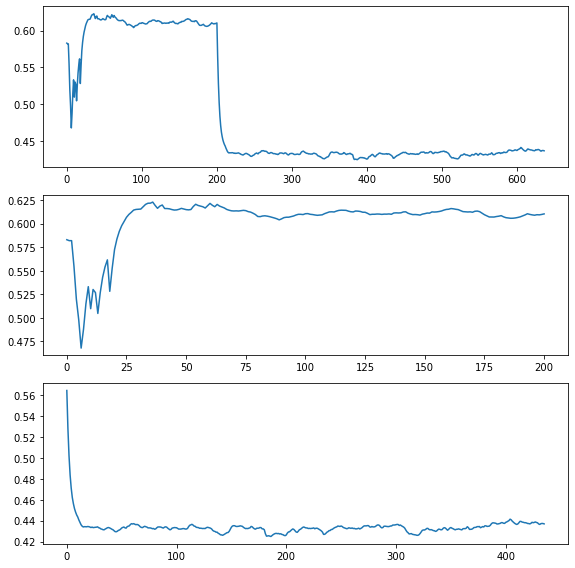

df_len_cnt: 17  H: 10  Total error: 14 Error check:  87.24836159172958 True
******CHANGE TIMES
ch_times :  [18] ch_num :  1 Resist :  0.5146347363026454
df_len_cnt: 18  H: 10  Total error: 14 Error check:  460.961669446226 True
******CHANGE TIMES
df_len_cnt: 19  H: 10  Total error: 15 Error check:  165.58281388219467 True
******CHANGE TIMES
df_len_cnt: 200  H: 10  Total error: 10 Error check:  5901.960787961901 True
******CHANGE TIMES
ch_times :  [18, 201] ch_num :  2 Resist :  0.6025700033418726
df_len_cnt: 201  H: 10  Total error: 20 Error check:  94.60935344865489 True
******CHANGE TIMES
CHECK TIMES
[None, 18, 201, None]
adf
18
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.540000       4.52      -20.0
1   2020-02-13 00:29:18     0.538000       4.51      -20.0
2   2020-02-13 12:28:31     0.534334       4.50      -20.0
3   2020-02-14 00:27:44     0.486187       4.52      -20.0
4   2020-02-14 12:27:11     0.456767       4.44      -20.0
5   202

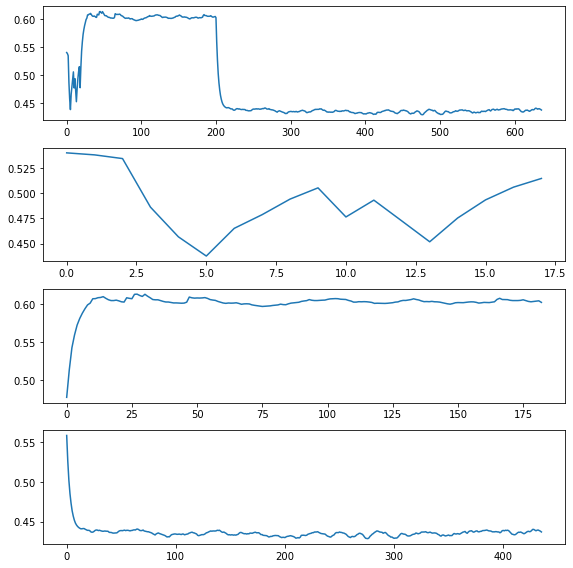

df_len_cnt: 18  H: 10  Total error: 10 Error check:  1043.886717111321 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.5076629677239356
df_len_cnt: 200  H: 10  Total error: 10 Error check:  4844.085548635421 True
******CHANGE TIMES
ch_times :  [19, 201] ch_num :  2 Resist :  0.6198231164271739
df_len_cnt: 201  H: 10  Total error: 20 Error check:  79.86285302980488 True
******CHANGE TIMES
CHECK TIMES
[None, 19, 201, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.513000       4.52      -20.0
1   2020-02-13 00:29:18     0.512000       4.51      -20.0
2   2020-02-13 12:28:31     0.510953       4.52      -20.0
3   2020-02-14 00:27:44     0.486001       4.46      -20.0
4   2020-02-14 12:27:11     0.493830       4.52      -20.0
5   2020-02-15 00:26:26     0.499858       4.52      -20.0
6   2020-02-15 12:25:37     0.502749       4.52      -20.0
7   2020-02-16 00:24:56     0.478351       4.51      -20.0
8   2020-02-16 12:24

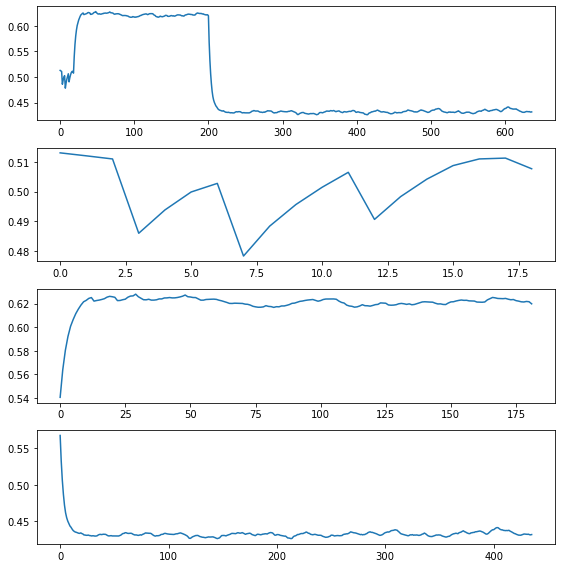

df_len_cnt: 18  H: 10  Total error: 10 Error check:  4810.355454275146 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.41137150156643687
df_len_cnt: 19  H: 10  Total error: 20 Error check:  127.26602075116583 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  7.157180366993203 False
df_len_cnt: 200  H: 10  Total error: 10 Error check:  11901.01620032398 True
******CHANGE TIMES
ch_times :  [19, 201] ch_num :  2 Resist :  0.6088032883545157
df_len_cnt: 201  H: 10  Total error: 20 Error check:  80.44406411550955 True
******CHANGE TIMES
CHECK TIMES
[None, 19, 201, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.408000       4.52      -20.0
1   2020-02-13 00:29:18     0.407000       4.51      -20.0
2   2020-02-13 12:28:31     0.407524       4.52      -20.0
3   2020-02-14 00:27:44     0.401945       4.44      -20.0
4   2020-02-14 12:27:11     0.405225       4.51      -20.0
5   2020-02-15 00:26:26

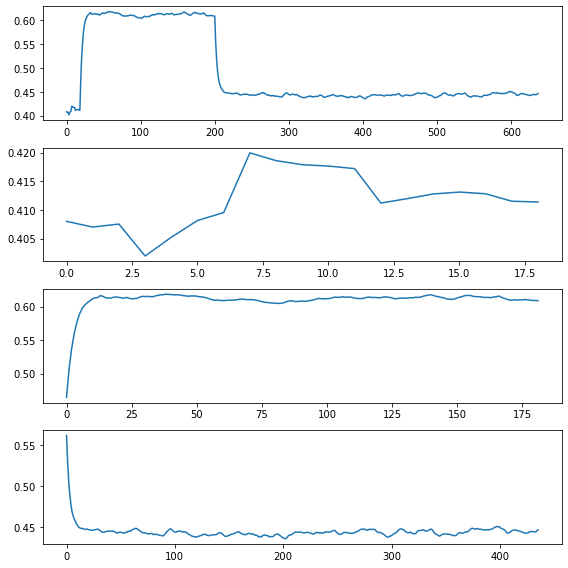

df_len_cnt: 18  H: 10  Total error: 10 Error check:  4799.240466318924 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.44123448362828127
df_len_cnt: 19  H: 10  Total error: 20 Error check:  132.98258929790444 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  5.2265253428236536 False
df_len_cnt: 200  H: 10  Total error: 10 Error check:  24617.35020774205 True
******CHANGE TIMES
ch_times :  [19, 201] ch_num :  2 Resist :  0.6165941998197013
df_len_cnt: 201  H: 10  Total error: 20 Error check:  106.58616770766898 True
******CHANGE TIMES
df_len_cnt: 202  H: 10  Total error: 20 Error check:  11.945071853286827 False
CHECK TIMES
[None, 19, 201, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.447000       4.46      -20.0
1   2020-02-13 00:29:18     0.445000       4.45      -20.0
2   2020-02-13 12:28:31     0.444476       4.46      -20.0
3   2020-02-14 00:27:44     0.445062       4.46      -20.0
4

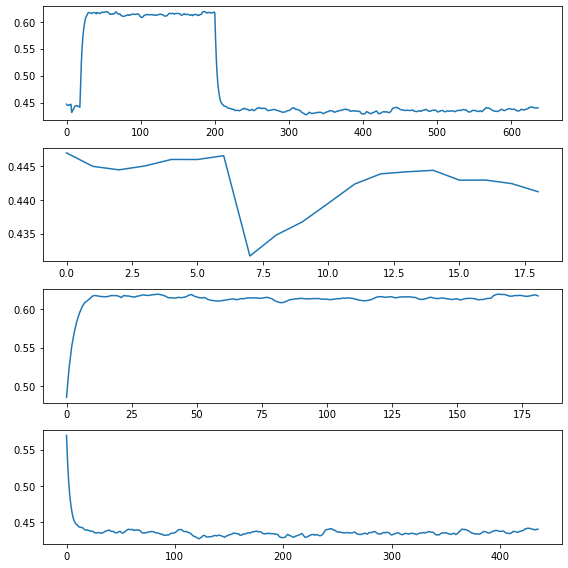

df_len_cnt: 18  H: 10  Total error: 10 Error check:  2790.0827237951075 True
******CHANGE TIMES
ch_times :  [19] ch_num :  1 Resist :  0.3890646765329569
df_len_cnt: 19  H: 10  Total error: 20 Error check:  144.613287705781 True
******CHANGE TIMES
df_len_cnt: 20  H: 10  Total error: 20 Error check:  0.36204147116603697 False
df_len_cnt: 68  H: 10  Total error: 10 Error check:  6847.885532709903 True
df_len_cnt: 200  H: 10  Total error: 10 Error check:  14095.24426682521 True
******CHANGE TIMES
ch_times :  [19, 201] ch_num :  2 Resist :  0.6244005312408758
df_len_cnt: 201  H: 10  Total error: 20 Error check:  117.38200679145159 True
******CHANGE TIMES
df_len_cnt: 202  H: 10  Total error: 20 Error check:  2.7330828598262316 False
CHECK TIMES
[None, 19, 201, None]
adf
19
                KeyTime  ResistValue  VoltValue  TempValue
0   2020-02-12 12:30:08     0.395000       4.44      -20.0
1   2020-02-13 00:29:18     0.396000       4.44      -20.0
2   2020-02-13 12:28:31     0.394952       4

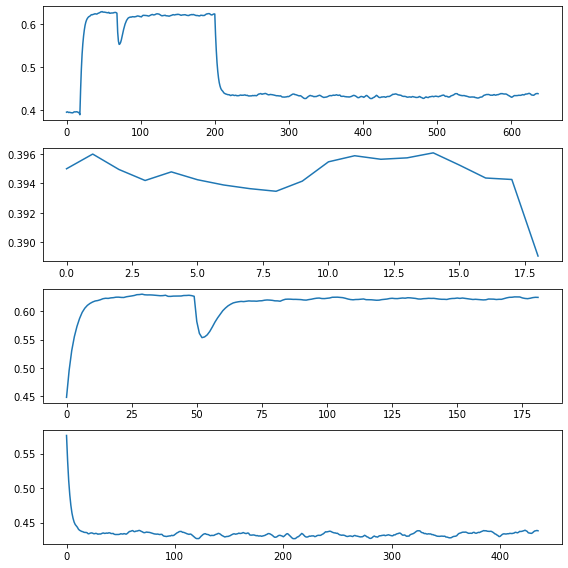

In [12]:
    for i in range(file_count):
        
        file_name = file_list[i]
        delete_csv_name = file_name[:-4]
        print(delete_csv_name)
        
        df = pd.read_csv(file_name, encoding = 'utf8')
        
        max_cell = max(df['CellNo'])
        df_full_len = len(df)
        
        #df = df.interpolate(method='linear', limit_direction='forward')
        
        for cell_cnt in range(max_cell):
            
            ch_times = []
            change_num = 0
            
            #1. 셀 분리
            newf_cell = cell_separate(df, cell_cnt)
            
            #2. 결측치 처리
            newf_cell = newf_cell.interpolate(method='linear', limit_direction='forward')
            
            newf_cell = newf_cell.reset_index(drop=True)
            
            KFOX = 'X'
            if KF == 1:
                newf_cell = kalman_filter(newf_cell, noise_column, _filter)
                KFOX = 'O'
            
            df_len = len(newf_cell)
            
            #plt.plot(newf_cell['ResistValue'])
            #plt.ylabel('y-label')
            #plt.show()
            
            #3. 셀 교체 확인
            for df_len_cnt in range(df_len):
                
                if (df_len_cnt >= (x_offset + 1)) & (df_len_cnt <= (df_len-x_offset)) :
                    
                    total_error_bef = 0
                    total_error_next = 0
                    total_error = 0
                    test_error = abs((newf_cell.loc[df_len_cnt+1, noise_column]-newf_cell.loc[df_len_cnt, noise_column])/newf_cell.loc[df_len_cnt, noise_column]*100)
                    
                    if test_error >= y_offset:
                        for h in range(x_offset): 
                            error_bef = abs((newf_cell.loc[df_len_cnt+(h+1), noise_column]-newf_cell.loc[df_len_cnt, noise_column])/newf_cell.loc[df_len_cnt, noise_column]*100)
                            error_next = abs((newf_cell.loc[df_len_cnt-(h+1), noise_column]-newf_cell.loc[df_len_cnt, noise_column])/newf_cell.loc[df_len_cnt, noise_column]*100)
                            
                            total_error_bef += error_bef
                            total_error_next += error_next
                            
                            if error_bef>=y_offset:
                                total_error += 1
                            if error_next>=y_offset:
                                total_error += 1
                            if h==9:
                                change_check_rate = abs((total_error_bef-total_error_next)/total_error_next*100)
                                if change_check_rate >=diff_offset :
                                    change_check = True
                                else:
                                    change_check = False
                                print('df_len_cnt:', df_len_cnt, ' H:', h+1, ' Total error:', total_error,
                                      'Error check: ', change_check_rate, change_check)
                            
                        #위치 확인
                        if (total_error > total_error_offset)& (change_check==True):
                            print('******CHANGE TIMES')
                            if change_num == 0:
                                change_num += 1
                                ch_times.append(df_len_cnt+1)
                                print('ch_times : ', ch_times, 'ch_num : ', change_num,
                                      'Resist : ', newf_cell.loc[df_len_cnt, noise_column])
                            if (change_num >=1) & (ch_times[change_num-1]+10<=df_len_cnt):
                                change_num += 1
                                ch_times.append(df_len_cnt+1)
                                print('ch_times : ', ch_times, 'ch_num : ', change_num,
                                      'Resist : ', newf_cell.loc[df_len_cnt, noise_column])
                                
            ch_times.insert(0, None)
            ch_times.append(None)
            print('CHECK TIMES')
            print(ch_times)
            
            fig, ax = plt.subplots(change_num+2, 1, figsize=(8,8))
            ax[0].plot(newf_cell[noise_column])
            
            for cell_ch_cnt in range(change_num+1):
                
                ULLOX = 'X'
                print('adf')
                print(ch_times[cell_ch_cnt+1])
                
                newf_ch_cell = newf_cell.iloc[ch_times[cell_ch_cnt]:ch_times[cell_ch_cnt + 1], :]
                
                newf_ch_cell = newf_ch_cell.reset_index(drop=True)
                    
                print(newf_ch_cell)
                
                if ULL == 1:
                    newf_ch_cell = UpperLowerLimit(newf_ch_cell)
                    ULLOX = 'X'
                
                ax[cell_ch_cnt+1].plot(newf_ch_cell[noise_column])
                    
                os.chdir(save_path)
                save_file = delete_csv_name + '_' + str(cell_cnt+1).zfill(2) + '_replace_' + str(cell_ch_cnt+1).zfill(2) + '_KF_' + KFOX + '_ULL_' + ULLOX + '.csv'
                newf_ch_cell.to_csv(save_file, index=False, encoding='utf8')
                os.chdir(current_path)
            
            plt.tight_layout()
            save_plt = delete_csv_name + '_' + str(cell_cnt+1).zfill(2) + '_replace_' + str(cell_ch_cnt+1).zfill(2) + '_KF_' + KFOX + '_ULL_' + ULLOX + '.png'
            plt.savefig(plt_save_path+'\\'+save_plt)
            plt.show()
            